In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

39


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


In [21]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [22]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [23]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [24]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1030875,North America,North America,NaN,2201.0,221.0,17016.0,NaN,1378102,82648.0,264579.0,NaN,NaN
1,782006,Europe,Europe,NaN,NaN,NaN,15843.0,NaN,1524904,146631.0,596267.0,NaN,NaN
2,255711,Asia,Asia,NaN,930.0,21.0,5229.0,NaN,603995,20827.0,327457.0,NaN,NaN
3,150511,South America,South America,NaN,84.0,5.0,9958.0,NaN,251695,12830.0,88354.0,NaN,NaN
4,32412,Africa,Africa,NaN,NaN,NaN,128.0,NaN,52713,2015.0,18286.0,NaN,NaN


In [25]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
224,150511,South America,Total:,NaN,84.0,5.0,9958.0,NaN,251695,12830.0,88354.0,NaN,NaN
225,32412,Africa,Total:,NaN,NaN,NaN,128.0,NaN,52713,2015.0,18286.0,NaN,NaN
226,902,Australia/Oceania,Total:,NaN,20.0,NaN,30.0,NaN,8487,118.0,7467.0,NaN,NaN
227,61,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
228,420214,Europe,European Union,251.204651,0.0,0.0,11232.0,27170.445894,1064763,111849.0,532450.0,12097655.0,2391.379609


In [26]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1030875,North America,North America,NaN,2201.0,221.0,17016.0,NaN,1378102,82648.0,264579.0,NaN,NaN
1,782006,Europe,Europe,NaN,NaN,NaN,15843.0,NaN,1524904,146631.0,596267.0,NaN,NaN
2,255711,Asia,Asia,NaN,930.0,21.0,5229.0,NaN,603995,20827.0,327457.0,NaN,NaN
3,150511,South America,South America,NaN,84.0,5.0,9958.0,NaN,251695,12830.0,88354.0,NaN,NaN
4,32412,Africa,Africa,NaN,NaN,NaN,128.0,NaN,52713,2015.0,18286.0,NaN,NaN


In [27]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
92,662,Europe,Lithuania,18.0,0.0,0.0,17.0,57486.0,1428,48.0,718.0,156493.0,525.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


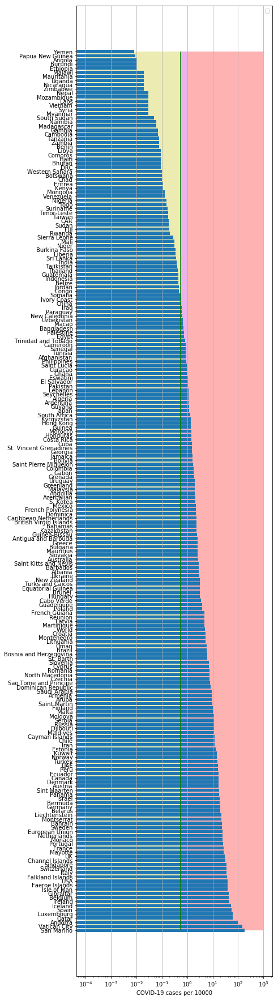

In [28]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


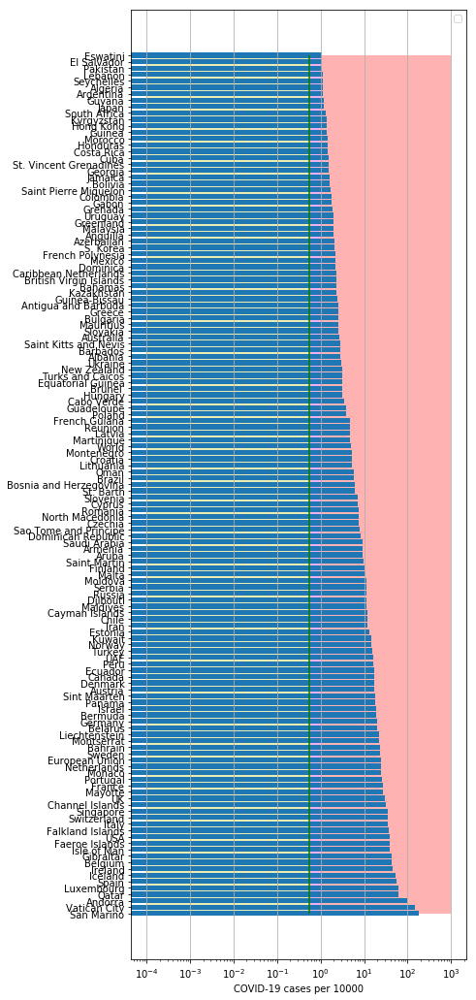

In [29]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

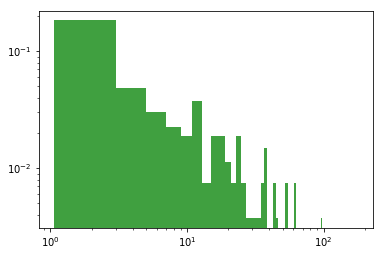

In [30]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [31]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
67 2020-05-02  245567   74234  25100.0
68 2020-05-03  247122   73300  25264.0
69 2020-05-04  248301   71240  25428.0
70 2020-05-05  250561   70230  25613.0
71 2020-05-06  253682   68466  25857.0
GB
          date   cases  active    death
66 2020-05-02  182260  153785  28131.0
67 2020-05-03  186599  157809  28446.0
68 2020-05-04  190584  161506  28734.0
69 2020-05-05  194990  165219  29427.0
70 2020-05-06  201101  170681  30076.0
IT
          date   cases  active    death
69 2020-05-02  209328  100704  28710.0
70 2020-05-03  210717  100179  28884.0
71 2020-05-04  211938   99980  29079.0
72 2020-05-05  213013   98467  29315.0
73 2020-05-06  214457   91528  29684.0
LT
          date  cases  active  death     tests
54 2020-05-02   1410     727   46.0  141678.0
55 2020-05-03   1419     735   46.1  144029.0
56 2020-05-04   1423     678   46.0  149106.0
57 2020-05-05   1428     662   48.0  156493.0
58 2020-05-06   1428     662   48.0       NaN
Ukr
  

IE
          date  cases  active  death
54 2020-05-02  10843  8347.0  831.0
55 2020-05-03  11192  8471.0  845.0
56 2020-05-04  11587  8769.0  864.0
57 2020-05-05  12071  9002.0  872.0
58 2020-05-06  12438  9226.0  895.0
MX
          date  cases  active   death
55 2020-05-02  22088  6580.0  2061.0
56 2020-05-03  23471  7870.0  2154.0
57 2020-05-04  24905  6696.0  2271.0
58 2020-05-05  26025  6708.0  2507.0
59 2020-05-06  27634  7149.0  2704.0
PM
          date  cases  active  death
53 2020-05-02   7090  6252.0  197.0
54 2020-05-03   7197  6356.0  200.0
55 2020-05-04   7387  6458.0  203.0
56 2020-05-05   7523  6490.0  210.0
57 2020-05-06   7731  6654.0  218.0
PU
          date  cases   active   death
56 2020-05-02  42534  28900.0  1200.0
57 2020-05-03  45928  31092.0  1286.0
58 2020-05-04  47372  31601.0  1344.0
59 2020-05-05  51189  34332.0  1444.0
60 2020-05-06  54817  35757.0  1533.0
SB
          date  cases  active  death
53 2020-05-02   9362  7747.0  189.0
54 2020-05-03   9464  7720

In [32]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)

In [33]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.7900514676849618
intercept: -2.8587010216340296
slope: [0.12448403]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


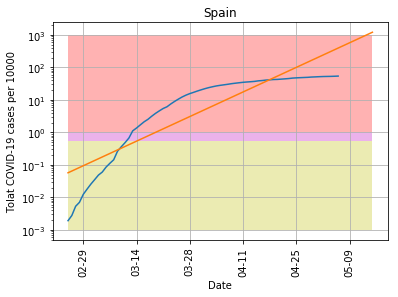

In [34]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-15', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [35]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.8984931374411086
intercept: -4.413185230857038
slope: [0.13561686]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


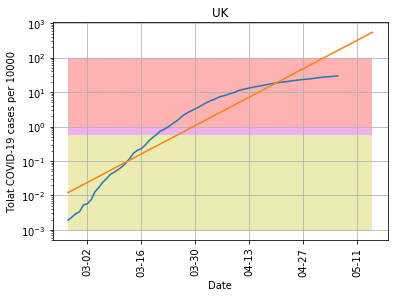

In [36]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-05-15', "pictures/coronaGB.png", model1, 'UK',100)

In [37]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9934890167344269
intercept: 1.9232041886115636
slope: [-0.05108881]


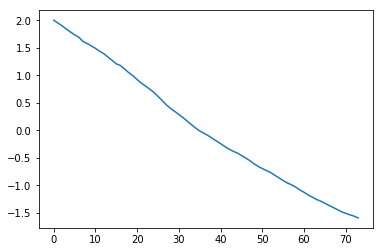

In [38]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


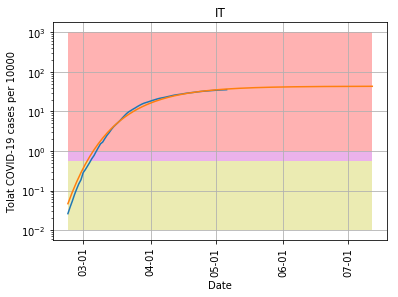

In [39]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [40]:
cs=y_pred11[-1]/10000.*populationIT

In [41]:
cs

261371.96515780318

In [42]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7093686049446289
intercept: -2.5006283091834645
slope: [0.0960142]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


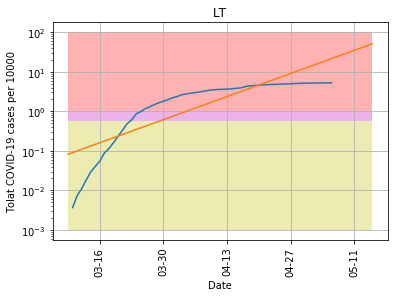

In [43]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-05-15', "pictures/coronaLT.png", model1, 'LT',100)

In [44]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9934890167344269
intercept: -6.2482889042689855
slope: [0.15453301]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


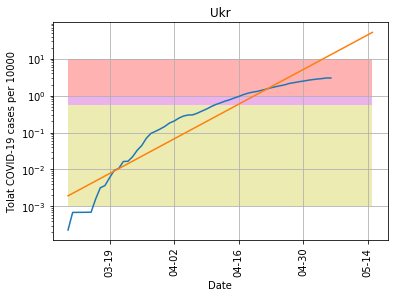

In [45]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-05-15', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


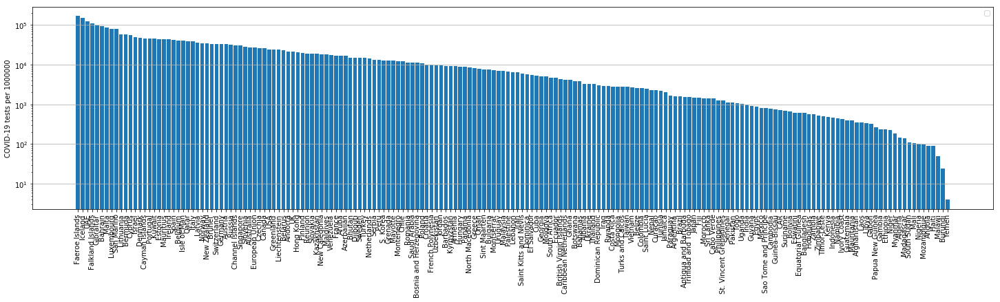

In [46]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [47]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9934890167344269
intercept: -3.99289139305
slope: [0.14356048]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


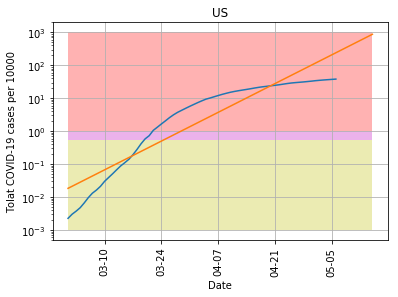

In [48]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-05-15', "pictures/coronaUS.png", model11, 'US',1000)

In [49]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
228  European Union  0.105046


(0, 0.15)

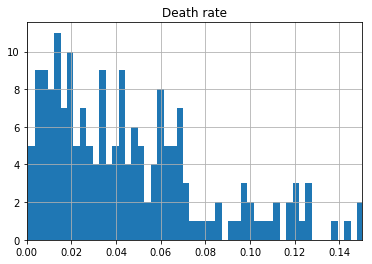

In [50]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

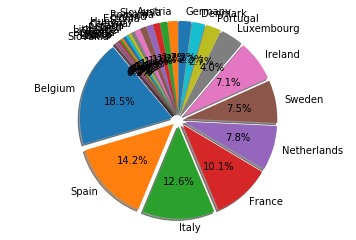

In [51]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [52]:
dfTTh.head()

,Country,Deathsper1Mpop
20,Belgium,720.0
8,Spain,553.0
9,Italy,491.0
11,France,395.0
21,Netherlands,304.0


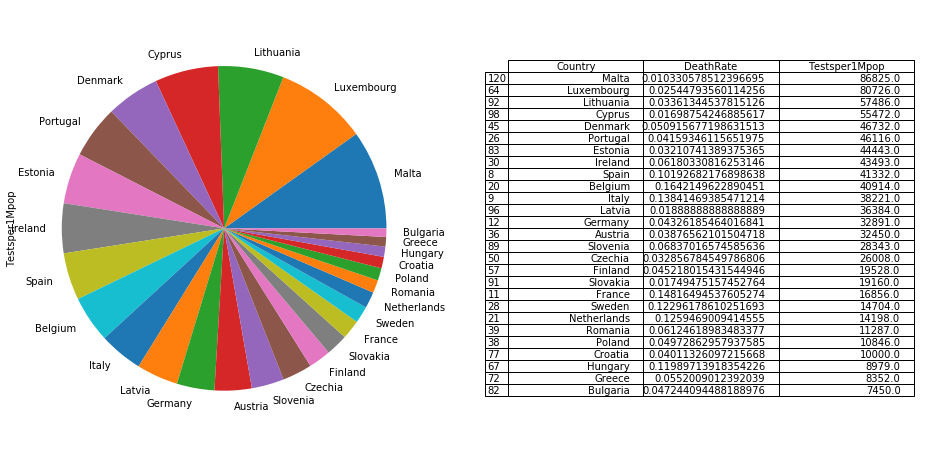

In [53]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

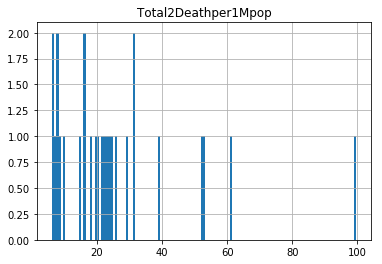

In [54]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [55]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,5426.0,553.0
9,Italy,3547.0,491.0
11,France,2669.0,395.0
12,Germany,2007.0,87.0
20,Belgium,4382.0,720.0


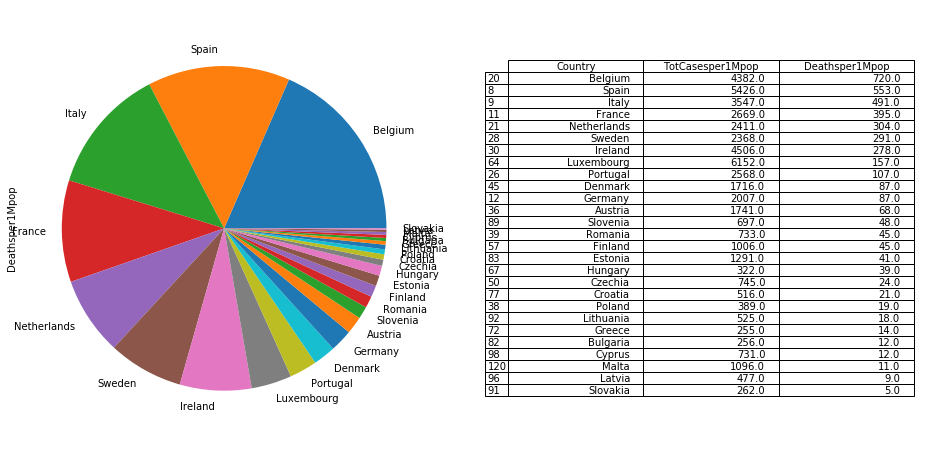

In [56]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [57]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1030875,North America,North America,0.0,2201.0,221.0,17016.0,0.0,1378102,82648.0,264579.0,0.0,0.0
1,782006,Europe,Europe,0.0,0.0,0.0,15843.0,0.0,1524904,146631.0,596267.0,0.0,0.0
2,255711,Asia,Asia,0.0,930.0,21.0,5229.0,0.0,603995,20827.0,327457.0,0.0,0.0
3,150511,South America,South America,0.0,84.0,5.0,9958.0,0.0,251695,12830.0,88354.0,0.0,0.0
4,32412,Africa,Africa,0.0,0.0,0.0,128.0,0.0,52713,2015.0,18286.0,0.0,0.0


In [58]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.131278
9,Italy,0.092802
11,France,0.158341
12,Germany,0.061020
20,Belgium,0.107103


In [59]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

In [60]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))

     Country  Cases2Testsper1Mpop
 Netherlands             0.169813
      Sweden             0.161045
      France             0.158341
       Spain             0.131278
     Belgium             0.107103
     Ireland             0.103603
       Italy             0.092802
  Luxembourg             0.076208
     Romania             0.064942
     Germany             0.061020
    Portugal             0.055686
     Austria             0.053652
     Croatia             0.051600
     Finland             0.051516
     Denmark             0.036720
      Poland             0.035866
     Hungary             0.035861
    Bulgaria             0.034362
      Greece             0.030532
     Estonia             0.029048
     Czechia             0.028645
    Slovenia             0.024592
    Slovakia             0.013674
      Cyprus             0.013178
      Latvia             0.013110
       Malta             0.012623
   Lithuania             0.009133


In [61]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
33,Qatar,0.000668,39209.000000
31,Singapore,0.000990,30016.000000
63,Bahrain,0.002034,94231.000000
93,Djibouti,0.002669,14715.000000
115,Maldives,0.003241,18246.000000
94,Hong Kong,0.003842,20674.000000
123,Guinea-Bissau,0.004211,762.000000
70,Oman,0.004478,7923.000000
75,Uzbekistan,0.004478,9710.000000
132,Palestine,0.005348,6765.000000


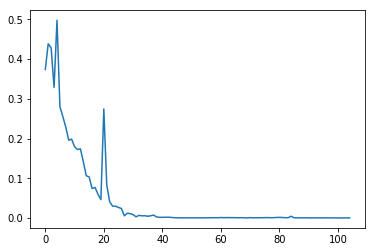

In [62]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [63]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


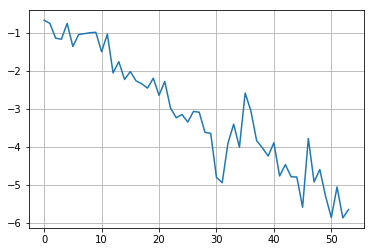

In [64]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


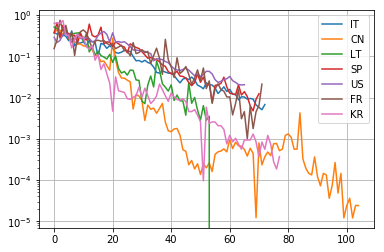

In [65]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

66 66
coefficient of determination: 0.9327762194083257
intercept: -7.582314256211697
slope: [-0.18659307]


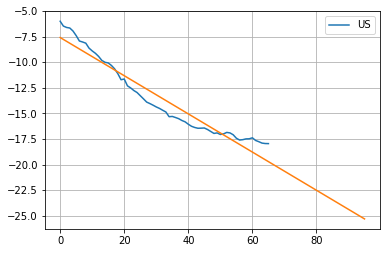

In [66]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

73 73
coefficient of determination: 0.9240447514817962
intercept: -8.866238799530397
slope: [-0.13475698]


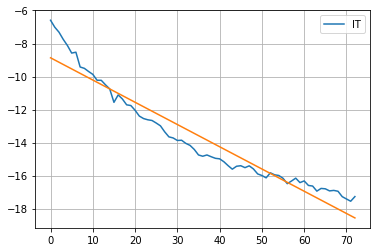

In [67]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [68]:
#model11.coef_

In [69]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

55 55
coefficient of determination: 0.9709535362618829
intercept: -14.443272878316352
slope: [-0.09280286]


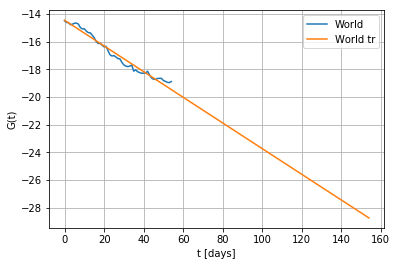

In [70]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

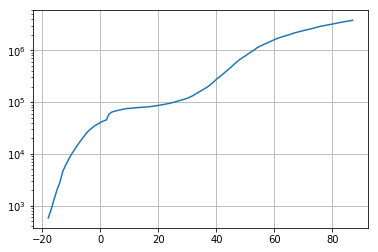

In [71]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [72]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 5.31681862e+06  3.84189003e+00 -3.14809801e+01  1.18872009e-02]


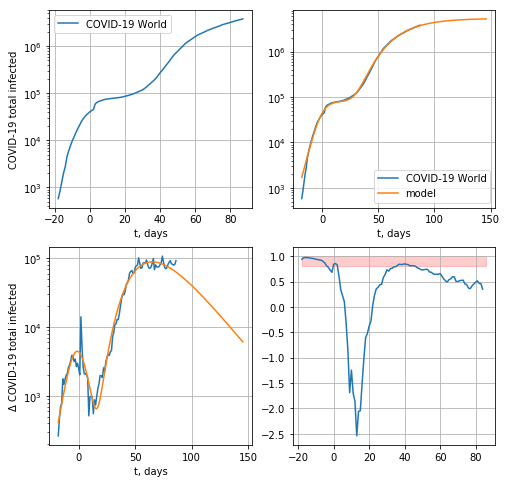

25269.213934604802


In [73]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

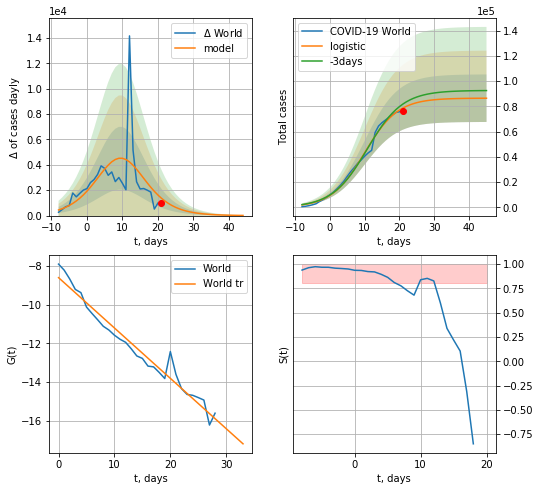

World data at: 2020-05-06
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +24 days
	 deltaDaycases:  13
	 total cases:  86417 ± 18822
	 total death:  5995 ± 3917
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


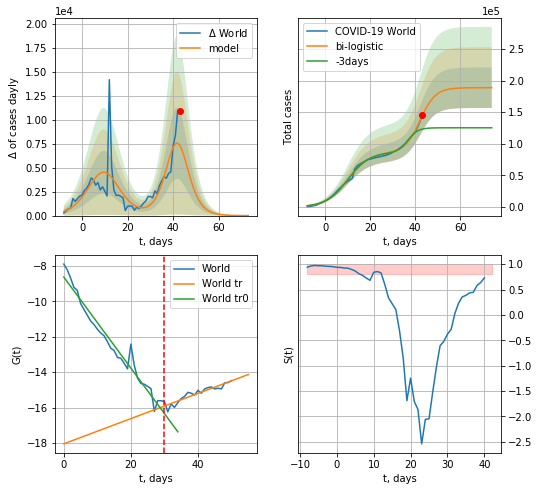

World data at: 2020-05-06
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +31 days
	 deltaDaycases:  2
	 total cases:  188692 ± 32064
	 total death:  13091 ± 6673
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


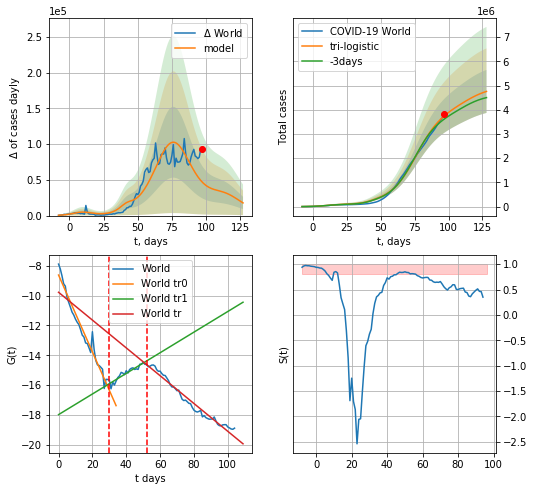

World data at: 2020-05-06
+3 day model MAPE: 0.03778945207712599
model: tri-logistic
coeffs:  [3.81230308e+06 1.05871385e-01 7.61709908e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.18673481278423992
forecast at the end of period: +31 days
	 deltaDaycases:  17738
	 total cases:  4758017 ± 888487
	 total death:  330123 ± 184936
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.967857
 intercept: -9.783718
 slope: -0.093027


In [74]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

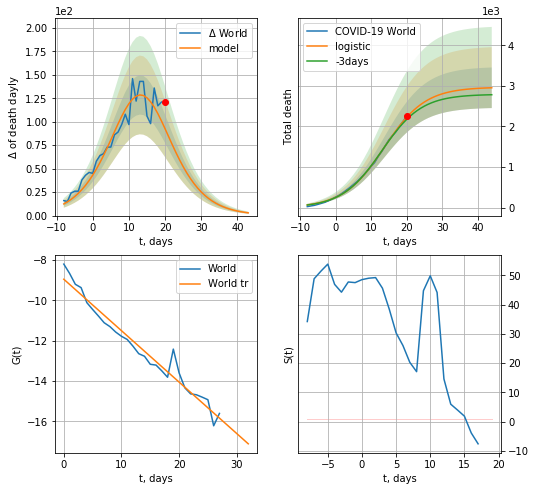

World data at: 2020-05-06
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +24 days
	 total death:  2954 ± 500
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


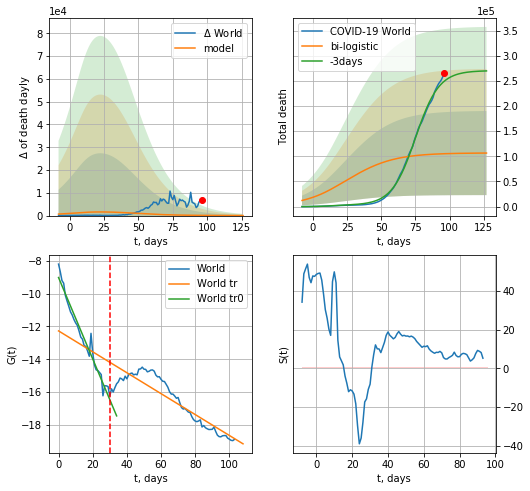

World data at: 2020-05-06
+3 day model MAPE: 0.5811602995880277
model: bi-logistic
coeffs:  [1.03819054e+05 5.94869027e-02 2.59032704e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.7850272743200722
forecast at the end of period: +31 days
	 deltaDaydeath:  15
	 total death:  106535 ± 83633
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.808494
 intercept: -12.273571
 slope: -0.063621


In [75]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [76]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


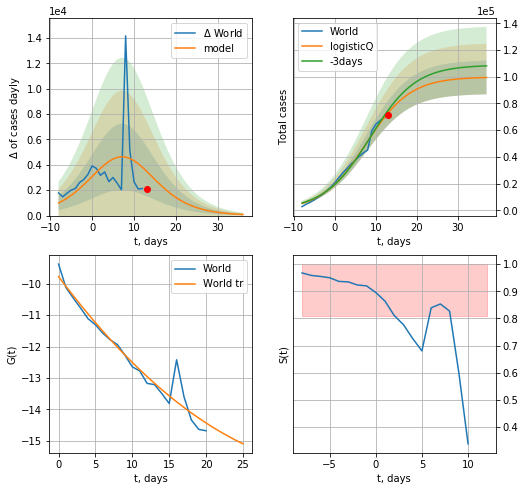

World data at: 2020-05-06
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +24 days
	 deltaDaycases: 85
	 total cases: 99446 ± 12625
	 total death: 6899 ± 2627
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


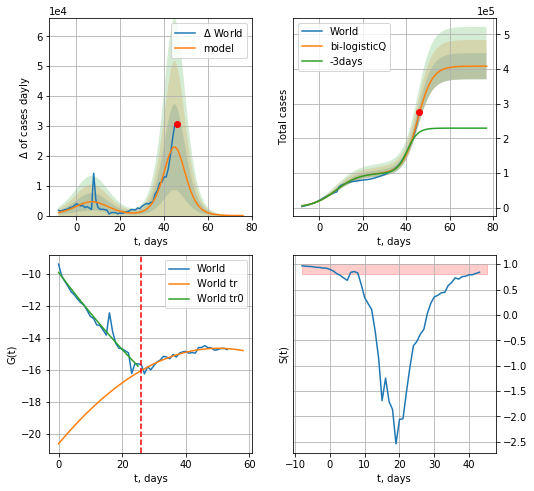

World data at: 2020-05-06
+3 day model MAPE: 0.322399
model: bi-logisticQ
coeffs: [ 3.08550720e+05  9.52088730e-05  4.52981129e+01 -3.08910430e+03]
rational stdev: 0.092561
forecast at the end of period: +31 days
	 deltaDaycases: 7
	 total cases: 408392 ± 37801
	 total death: 28335 ± 7868
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


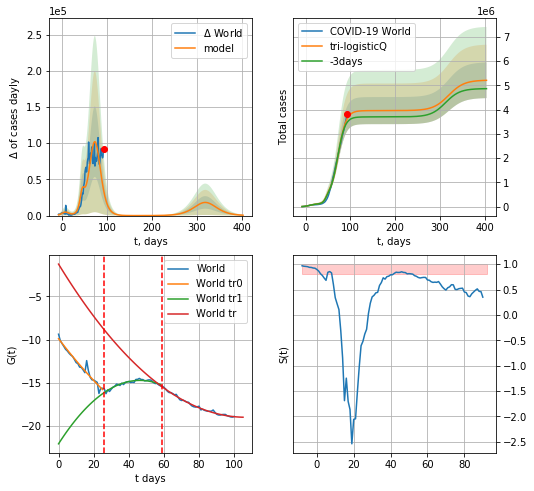

World data at: 2020-05-06
+3 day model MAPE: 0.044176
model: bi-logisticQ
coeffs: [ 3.54833227e+06  1.46729343e-06  7.32618643e+01 -7.83894430e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.140936
forecast at the end of period: +311 days
	 deltaDaycases: 548
	 total cases: 5204186 ± 733454
	 total death: 361079 ± 152666
tri-logisticQ approximation splitting points: 26,59
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.874764
 intercept_: -22.035447570025077
 coeffs_: [ 0.          0.31660897 -0.00341999]
trend coefficient of determination: 0.990354
 intercept_: -1.2748899842411205
 coeffs_: [ 0.         -0.33238291  0.0015612 ]


In [77]:
vL=30 - 4
vL1=59
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


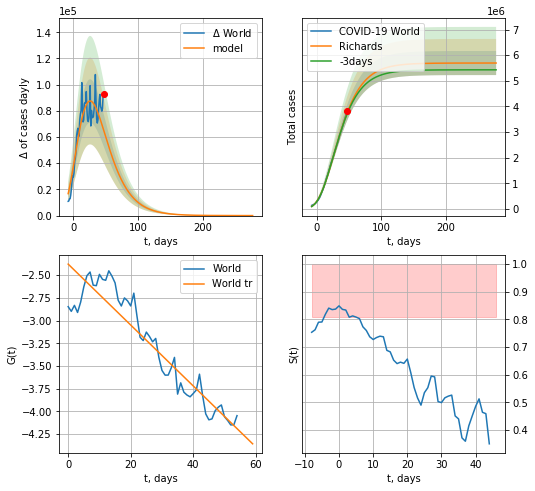

World data at: 2020-05-06
+3 day model MAPE: 0.013206
model: Richards
coeffs: [ 5.69381435e+06  1.96159666e+00 -6.44647896e+01  2.15319764e-02]
rational stdev: 0.082571
forecast at the end of period: +231 days
	 deltaDaycases: 5
	 total cases: 5693676 ± 470130
	 total death: 395041 ± 97856
trend coefficient of determination: 0.875866
 intercept: -2.378478
 slope: -0.033513


In [78]:
x = forecastRR("World",dfW[50:],d1,30*9-dT,1.0,False)

In [79]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


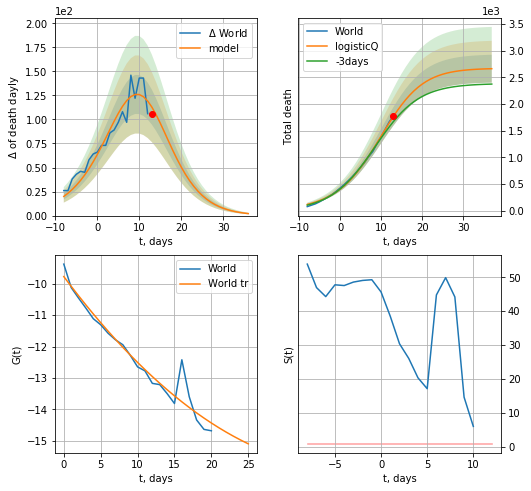

World data at: 2020-05-06
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +24 days
	 total death: 2662 ± 260
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


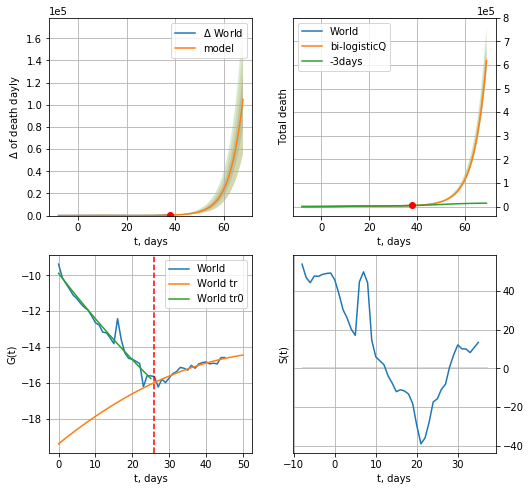

World data at: 2020-05-06
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +31 days
	 total death: 618763 ± 47391
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:432: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


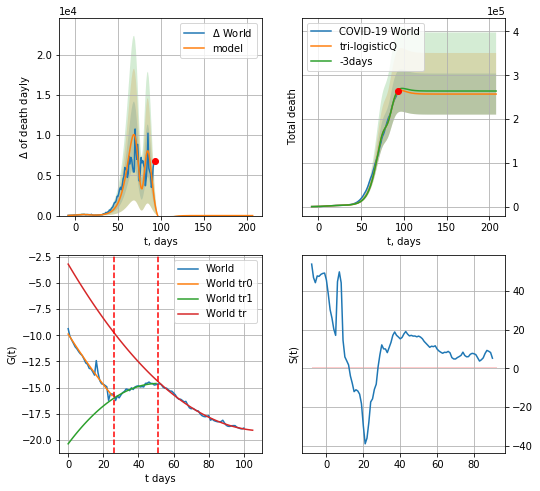

World data at: 2020-05-06
+3 day model MAPE: 0.013408
model: bi-logisticQ
coeffs: [-6.16758911e+06  4.89283293e-05  7.97217961e+01 -4.54608968e+03]
rational stdev: 0.182421
forecast at the end of period: +115 days
	 total death: 257122 ± 46904
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.992929
 intercept_: -3.2008243430081276
 coeffs_: [ 0.         -0.28438594  0.00126799]


In [80]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


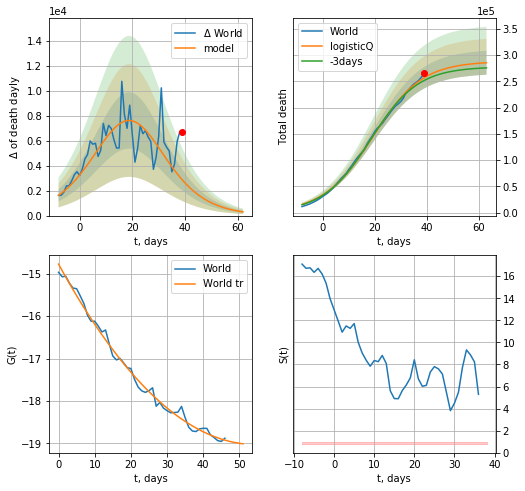

World data at: 2020-05-06
+3 day model MAPE: 0.021695
model: logisticQ
coeffs: [ 2.88173250e+05  1.94432679e-05  1.91801038e+01 -5.42583030e+03]
rational stdev: 0.079768
forecast at the end of period: +24 days
	 total death: 285514 ± 22774
trend coefficient of determination: 0.992631
 intercept_: -14.773022055802171
 coeffs_: [ 0.         -0.15588336  0.00142845]


In [81]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [529]:
#trend(dfSP,'SP',10)

In [531]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

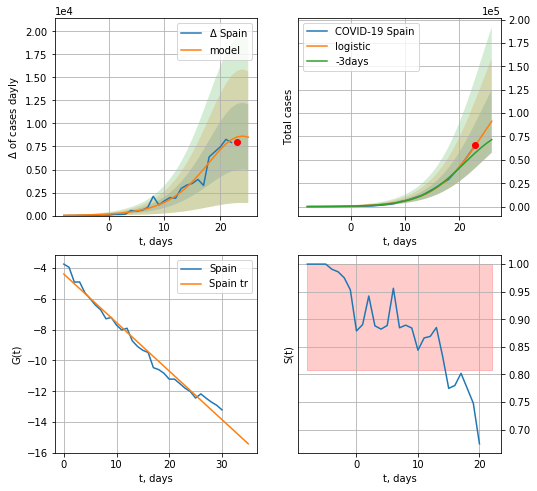

Spain data at: 2020-05-06
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +3 days
	 deltaDaycases:  8510
	 total cases:  91277 ± 33615
	 total death:  9303 ± 10278
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


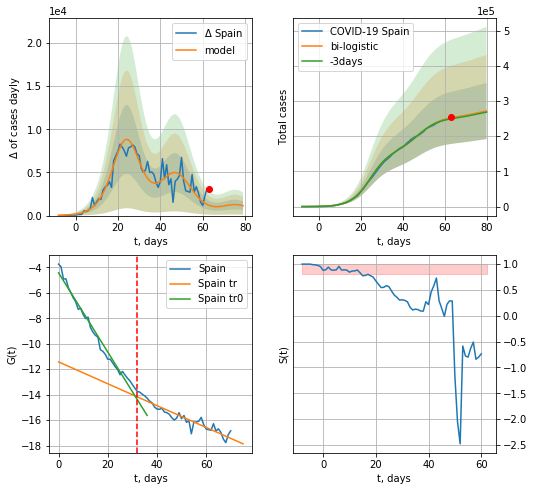

Spain data at: 2020-05-06
+3 day model MAPE: 0.010818597560791801
model: bi-logistic
coeffs:  [9.93637098e+04 1.92279949e-01 4.77756342e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.29340673732515504
forecast at the end of period: +17 days
	 deltaDaycases:  1138
	 total cases:  271469 ± 79650
	 total death:  27669 ± 24354
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.889958
 intercept: -11.427150
 slope: -0.085831


In [82]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,6*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
67 2020-05-02  245567   74234  25100.0
68 2020-05-03  247122   73300  25264.0
69 2020-05-04  248301   71240  25428.0
70 2020-05-05  250561   70230  25613.0
71 2020-05-06  253682   68466  25857.0


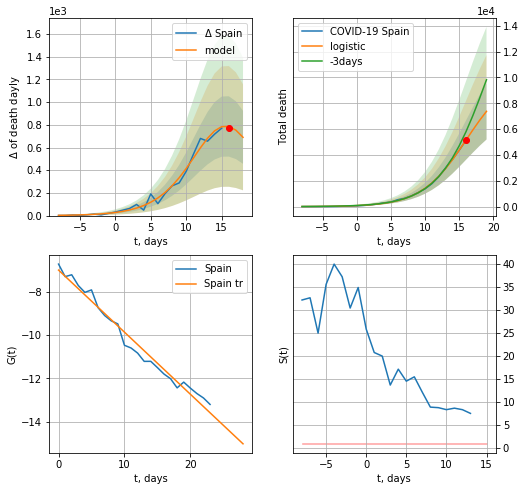

Spain data at: 2020-05-06
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +3 days
	 total death:  7379 ± 2179
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


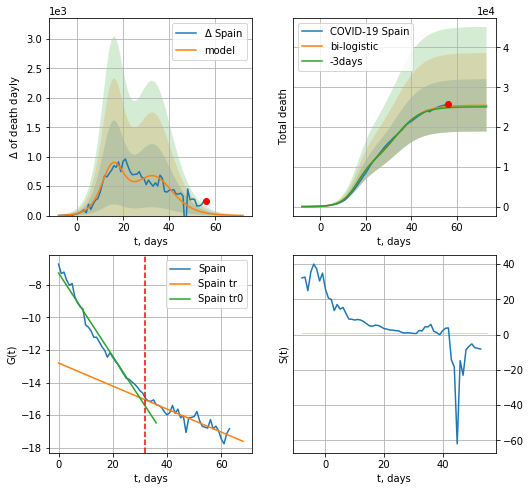

Spain data at: 2020-05-06
+3 day model MAPE: 0.013085321947783777
model: bi-logistic
coeffs:  [1.50714439e+04 1.76157684e-01 3.35560934e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.2584069701475401
forecast at the end of period: +17 days
	 deltaDaydeath:  2
	 total death:  25444 ± 6575
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.818444
 intercept: -12.803145
 slope: -0.070825


In [83]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,6*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


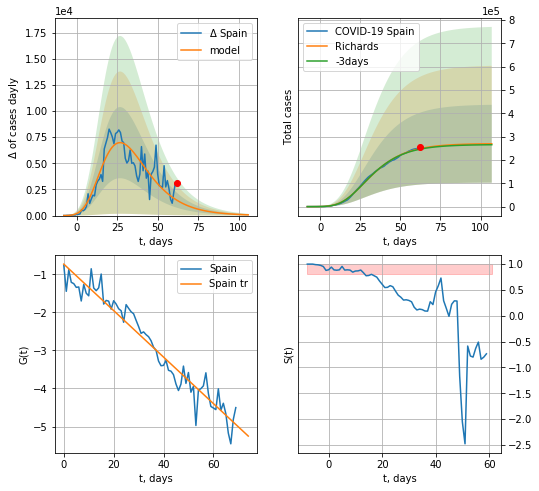

Spain data at: 2020-05-06
+3 day model MAPE: 0.009851
model: Richards
coeffs: [ 2.70364269e+05  8.40823022e+00 -4.05958926e+01  8.38221174e-03]
rational stdev: 0.619575
forecast at the end of period: +45 days
	 deltaDaycases: 71
	 total cases: 269386 ± 166905
	 total death: 27457 ± 51035
trend coefficient of determination: 0.940702
 intercept: -0.730924
 slope: -0.061075


In [84]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:72: RuntimeWarning: divide by zero encountered in true_divide


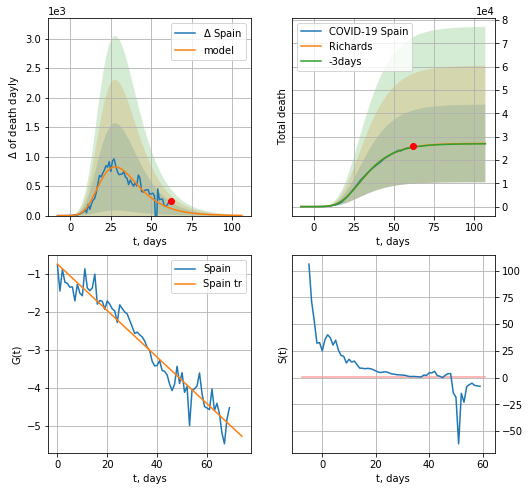

Spain data at: 2020-05-06
+3 day model MAPE: 0.004379
model: Richards
coeffs: [ 2.71297014e+04  8.08545999e+00 -2.68243548e+01  1.02893353e-02]
rational stdev: 0.614891
forecast at the end of period: +45 days
	 total death: 27091 ± 16658
trend coefficient of determination: 0.941368
 intercept: -0.742783
 slope: -0.061297


In [85]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


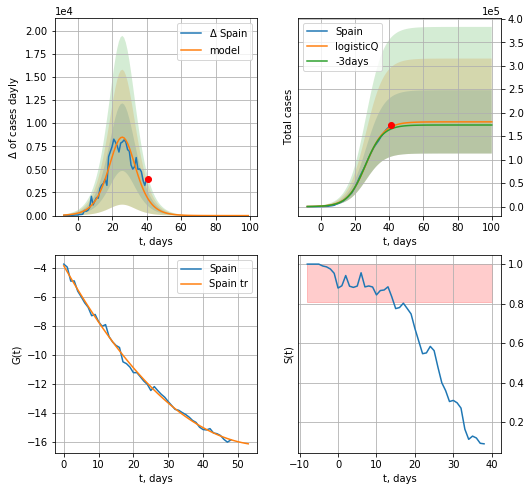

Spain data at: 2020-05-06
+3 day model MAPE: 0.028157
model: logisticQ
coeffs: [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev: 0.373397
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 180489 ± 67394
	 total death: 18396 ± 20607
trend coefficient of determination: 0.997432
 intercept_: -3.859009253100683
 coeffs_: [ 0.         -0.42385579  0.00363487]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


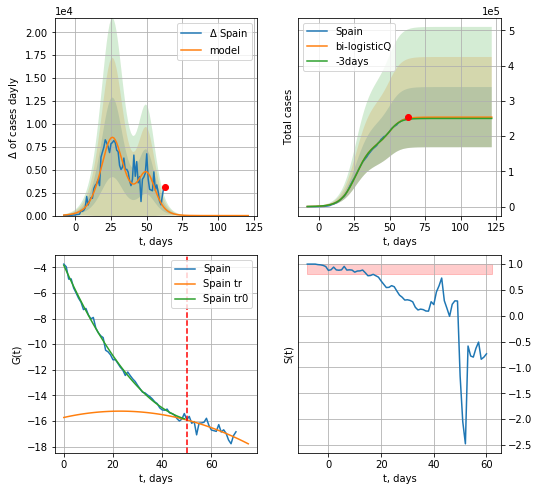

Spain data at: 2020-05-06
+3 day model MAPE: 0.011343
model: bi-logisticQ
coeffs: [ 7.34800526e+04  3.37625624e-06  5.03713026e+01 -7.13101280e+04]
rational stdev: 0.336215
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 253969 ± 85388
	 total death: 25886 ± 26109
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997202
 intercept_: -3.834231460165485
 coeffs_: [ 0.         -0.42809872  0.00374483]
trend coefficient of determination: 0.591734
 intercept_: -15.72253322366293
 coeffs_: [ 0.          0.04318831 -0.00094144]


In [86]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


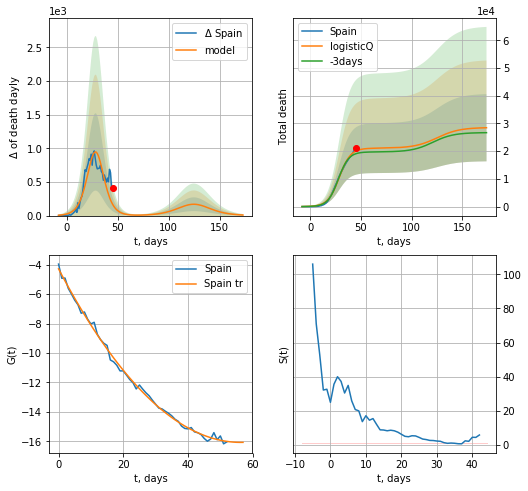

Spain data at: 2020-05-06
+3 day model MAPE: 0.052146
model: logisticQ
coeffs: [ 2.10785072e+04  2.45976331e-06  2.87220026e+01 -7.30294753e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.426167
forecast at the end of period: +129 days
	 total death: 28454 ± 12126
trend coefficient of determination: 0.997093
 intercept_: -4.2745317106494545
 coeffs_: [ 0.         -0.41935329  0.00372528]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:344: RuntimeWarning: divide by zero encountered in true_divide


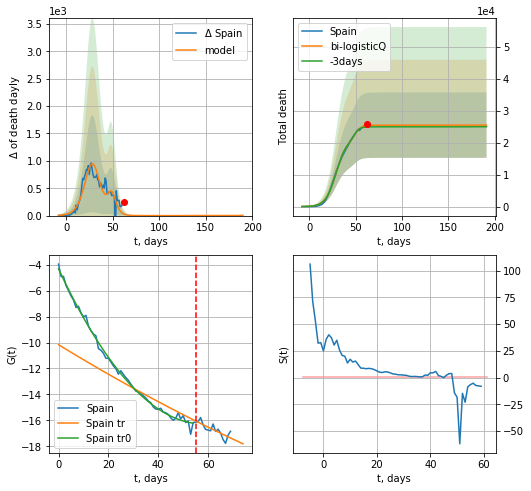

Spain data at: 2020-05-06
+3 day model MAPE: 0.018615
model: bi-logisticQ
coeffs: [ 4.42247216e+03  4.34749362e-06  4.95442348e+01 -7.47512009e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.401439
forecast at the end of period: +129 days
	 total death: 25527 ± 10247
bi-logisticQ approximation splitting point: 55
trend coefficient of determination: 0.995977
 intercept_: -4.321307017900119
 coeffs_: [ 0.         -0.41196694  0.00354831]
trend coefficient of determination: 0.636815
 intercept_: -10.167377345095169
 coeffs_: [ 0.         -0.11756822  0.00019304]


In [87]:
x = forecastRRR('Spain',dfSP[1:55],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=55)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


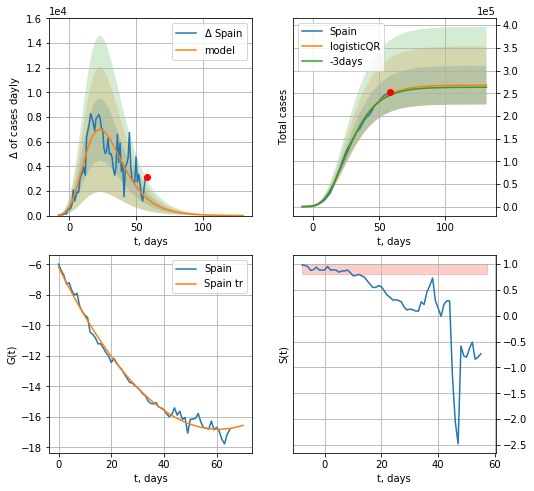

Spain data at: 2020-05-06
+3 day model MAPE: 0.01067608623491249
model: logisticQR
coeffs:  [ 2.67977592e+05  4.16241638e-02 -1.12769649e+03 -7.82619071e+01
  1.35952912e-03]
rational stdev:  0.15966822401049025
forecast at the end of period: +73 days
	 deltaDaycases:  5
	 total cases:  267911 ± 42776
	 total death:  27307 ± 13080
trend coefficient of determination: 0.990931
 intercept_: -6.184870185452503
 coeffs_: [ 0.         -0.35032895  0.00288658]


In [88]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

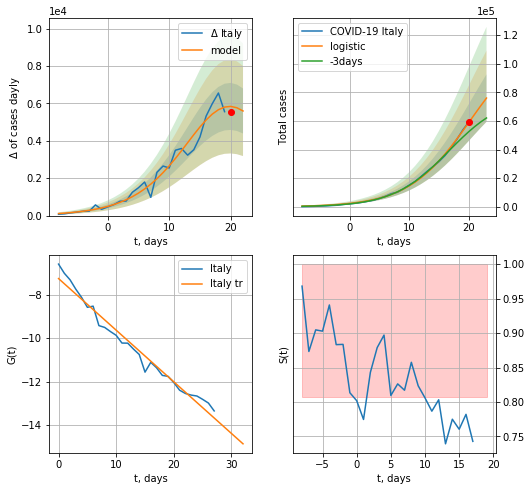

Italy data at: 2020-05-06
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +3 days
	 deltaDaycases:  5596
	 total cases:  75999 ± 16568
	 total death:  10519 ± 6879
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


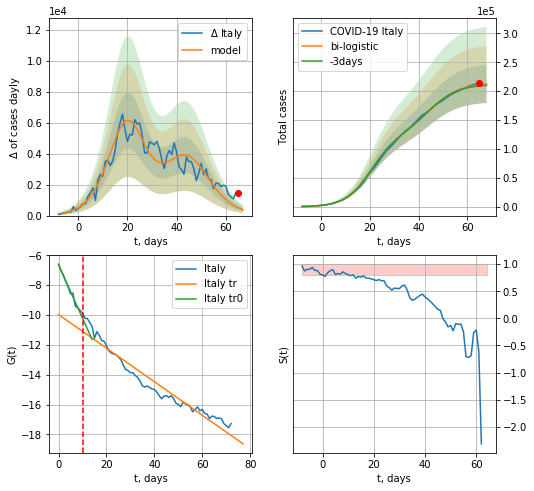

Italy data at: 2020-05-06
+3 day model MAPE: 0.010763459691271716
model: bi-logistic
coeffs:  [9.32832617e+04 1.58399645e-01 4.46698616e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.15480906598896643
forecast at the end of period: +3 days
	 deltaDaycases:  379
	 total cases:  212502 ± 32897
	 total death:  29413 ± 13660
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.940879
 intercept: -9.972460
 slope: -0.112500


In [89]:
x = forecast('Italy',dfIT[:-6-dT],d1,6*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,6*7-dT,x,1.0)

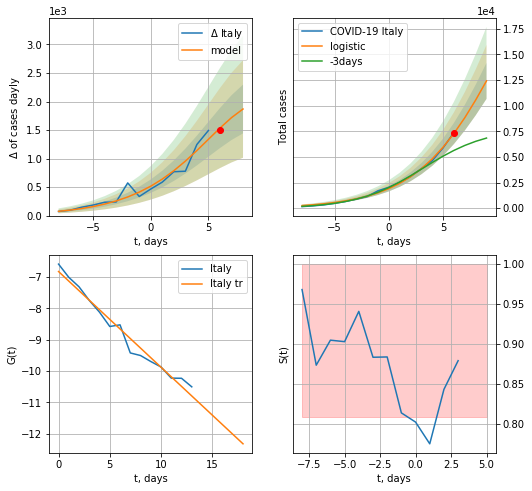

Italy data at: 2020-05-06
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +3 days
	 deltaDaycases:  1868
	 total cases:  12405 ± 1753
	 total death:  1717 ± 727
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


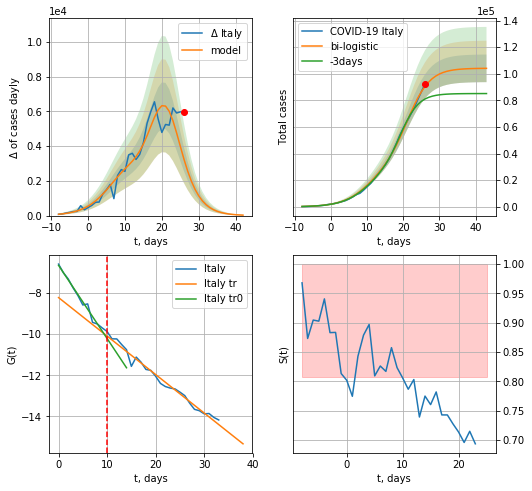

Italy data at: 2020-05-06
+3 day model MAPE: 0.1396868970300245
model: bi-logistic
coeffs:  [7.26693885e+04 3.23703466e-01 2.12981095e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.09972560756251159
forecast at the end of period: +17 days
	 deltaDaycases:  26
	 total cases:  104107 ± 10382
	 total death:  14409 ± 4310
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.981847
 intercept: -8.219306
 slope: -0.187258


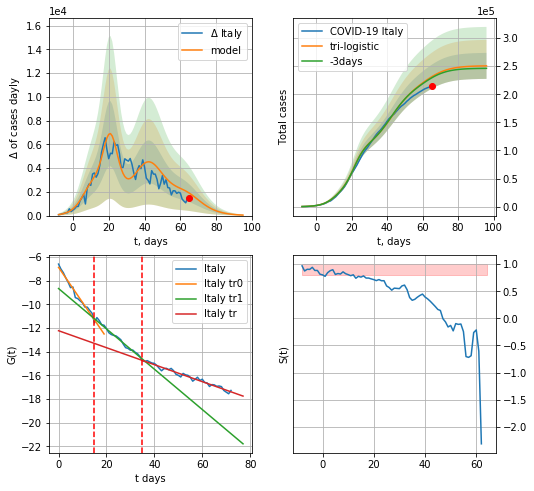

Italy data at: 2020-05-06
+3 day model MAPE: 0.008796303892922705
model: tri-logistic
coeffs:  [1.08563822e+05 1.58623052e-01 4.23912915e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.26693885e+04
 3.23703466e-01 2.12981095e+01]
scenario coeffs:  [0.35, 1.0, 1.5]
forecast rational stdev:  0.09227872696043715
forecast at the end of period: +31 days
	 deltaDaycases:  41
	 total cases:  250497 ± 23115
	 total death:  34672 ± 9598
tri-logistic approximation splitting points: 15,35
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.978019
 intercept: -8.656402
 slope: -0.170599
trend coefficient of determination: 0.970416
 intercept: -12.224366
 slope: -0.071825


In [90]:
vL = 15#len(dfSP[:])-11-dT
vL1=35
x = forecast('Italy',dfIT[:vL],d1,6*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.35,1.,1.5],vL=[vL,vL1])

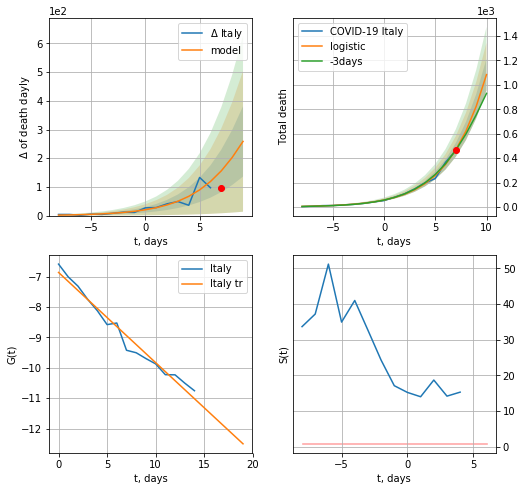

Italy data at: 2020-05-06
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +3 days
	 total death:  1083 ± 130
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


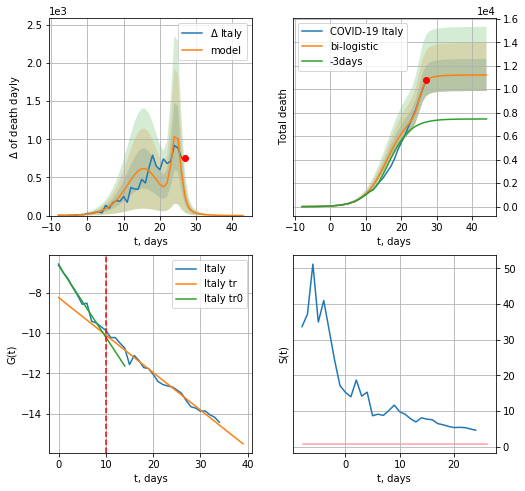

Italy data at: 2020-05-06
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +17 days
	 deltaDaydeath:  0
	 total death:  11210 ± 1364
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


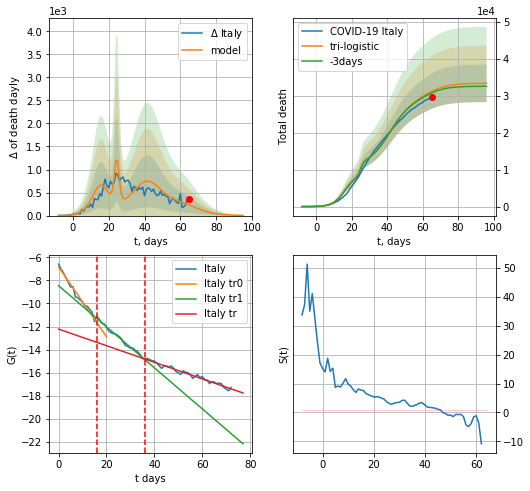

Italy data at: 2020-05-06
+3 day model MAPE: 0.01461100896567924
model: tri-logistic
coeffs:  [1.77676558e+04 1.62870669e-01 4.17775980e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.15245036280267651
forecast at the end of period: +31 days
	 deltaDaydeath:  3
	 total death:  33399 ± 5091
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.968102
 intercept: -12.220141
 slope: -0.071895


In [91]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,6*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


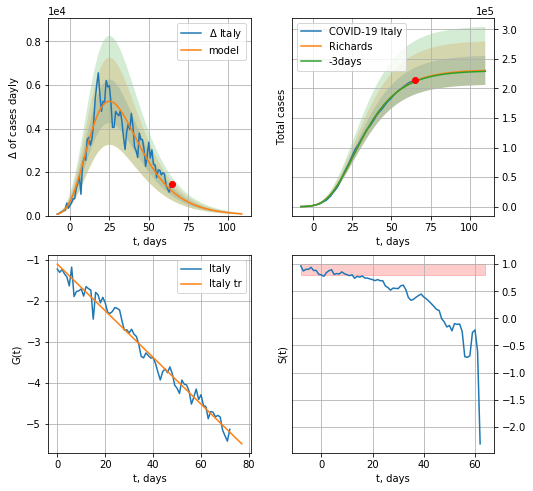

Italy data at: 2020-05-06
+3 day model MAPE: 0.004276
model: Richards
coeffs: [ 2.31606238e+05  5.74021246e+00 -4.74925315e+01  1.07976955e-02]
rational stdev: 0.106508
forecast at the end of period: +45 days
	 deltaDaycases: 78
	 total cases: 230373 ± 24536
	 total death: 31887 ± 10188
trend coefficient of determination: 0.978191
 intercept: -1.095299
 slope: -0.057040


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


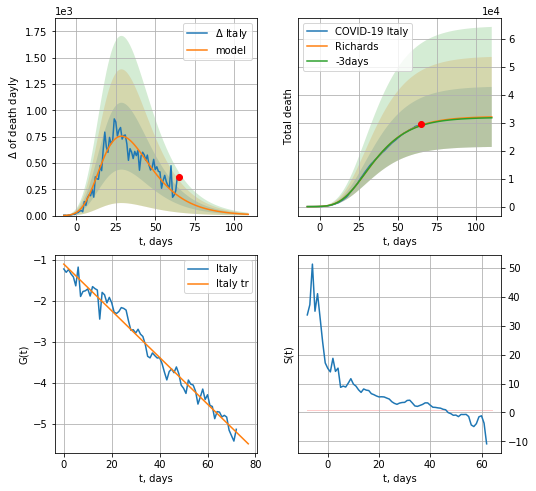

Italy data at: 2020-05-06
+3 day model MAPE: 0.005928
model: Richards
coeffs: [ 3.23253931e+04  5.65600680e+00 -4.11647894e+01  1.12876634e-02]
rational stdev: 0.334596
forecast at the end of period: +45 days
	 total death: 32141 ± 10754
trend coefficient of determination: 0.978243
 intercept: -1.099148
 slope: -0.057079


In [92]:
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


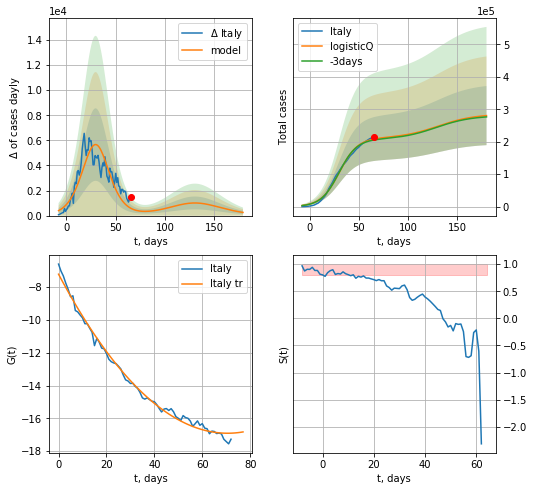

Italy data at: 2020-05-06
+3 day model MAPE: 0.014219
model: logisticQ
coeffs: [ 2.10914327e+05  7.12634178e-07  2.99874429e+01 -1.50339882e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324615
forecast at the end of period: +115 days
	 deltaDaycases: 252
	 total cases: 280718 ± 91125
	 total death: 38855 ± 37838
trend coefficient of determination: 0.992708
 intercept_: -7.206919873064125
 coeffs_: [ 0.         -0.27499845  0.00194792]


In [93]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


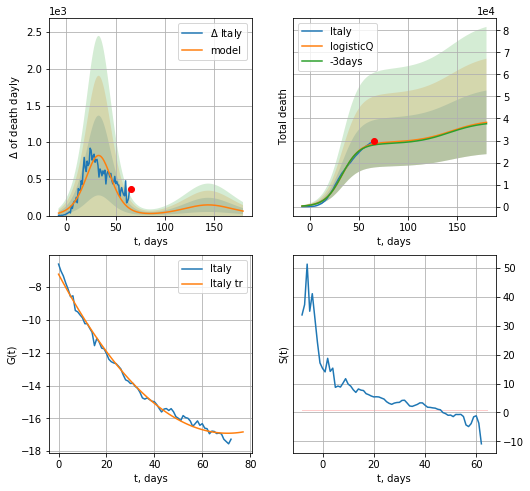

Italy data at: 2020-05-06
+3 day model MAPE: 0.017722
model: logisticQ
coeffs: [ 2.91270692e+04  8.19763814e-07  3.30915423e+01 -1.37083124e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377538
forecast at the end of period: +115 days
	 total death: 38237 ± 14436
trend coefficient of determination: 0.992708
 intercept_: -7.206919873064125
 coeffs_: [ 0.         -0.27499845  0.00194792]


In [94]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [95]:
dT

39

FR
          date     cases  active    death
77 2020-05-02  168396.0   93074  24760.0
78 2020-05-03  168693.0   93014  24895.0
79 2020-05-04  169462.0   92890  25201.0
80 2020-05-05  170551.0   92284  25531.0
81 2020-05-06  174191.0   94410  25809.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


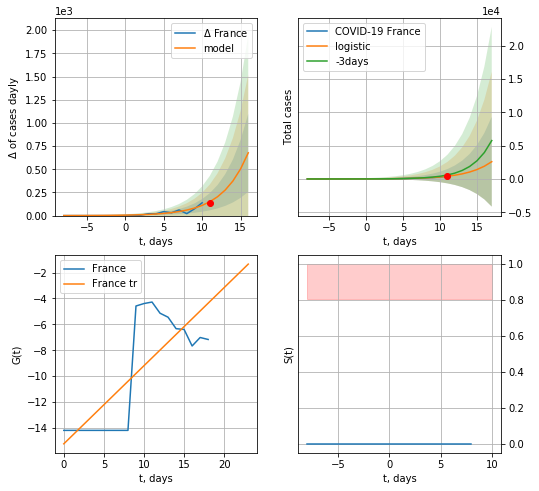

France data at: 2020-05-06
+3 day model MAPE: 0.3579011645535763
model: logistic
coeffs:  [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  2.5989080654975822
forecast at the end of period: +6 days
	 deltaDaycases:  677
	 total cases:  2596 ± 6746
	 total death:  384 ± 2993
trend coefficient of determination: 0.603781
 intercept: -15.217380
 slope: 0.602806


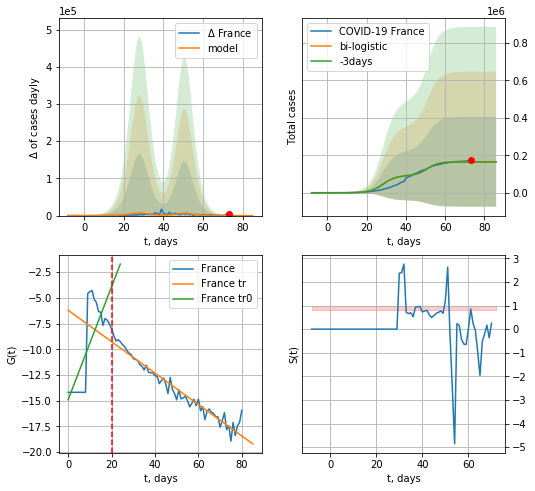

France data at: 2020-05-06
+3 day model MAPE: 0.01237514825503381
model: bi-logistic
coeffs:  [7.41949319e+04 3.37705454e-01 5.10980558e+01] [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  1.4470982785609539
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  165570 ± 239596
	 total death:  24531 ± 106496
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.576236
 intercept: -14.895009
 slope: 0.549077
trend coefficient of determination: 0.948789
 intercept: -6.203737
 slope: -0.152765


In [96]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,7*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [97]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

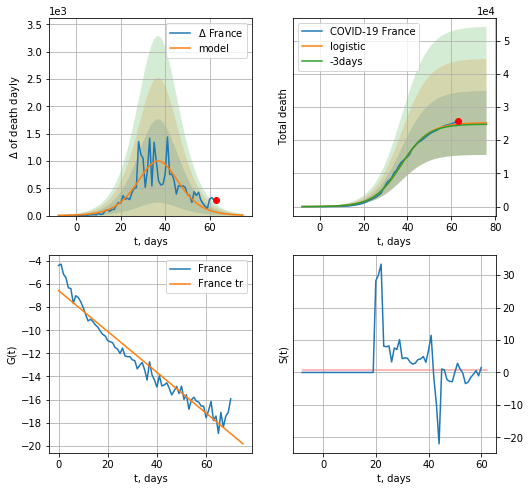

France data at: 2020-05-06
+3 day model MAPE: 0.015486946434180523
model: logistic
coeffs:  [2.52776986e+04 1.58164562e-01 3.72797963e+01]
rational stdev:  0.38207100464589694
forecast at the end of period: +13 days
	 total death:  25222 ± 9636
trend coefficient of determination: 0.941758
 intercept: -6.570005
 slope: -0.176764


In [98]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


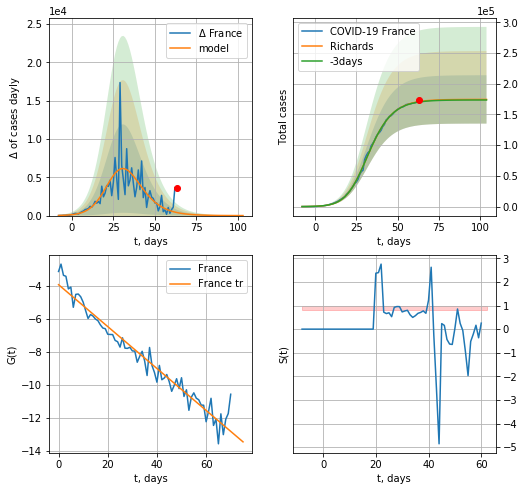

France data at: 2020-05-06
+3 day model MAPE: 0.003898
model: Richards
coeffs: [1.74457608e+05 2.18247285e-01 2.63358615e+01 5.55634347e-01]
rational stdev: 0.225469
forecast at the end of period: +41 days
	 deltaDaycases: 3
	 total cases: 174432 ± 39328
	 total death: 25844 ± 17481
trend coefficient of determination: 0.953298
 intercept: -3.912650
 slope: -0.127402


In [99]:
x = forecastRR('France',dfFR[10:],d1,12*7-dT-4,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


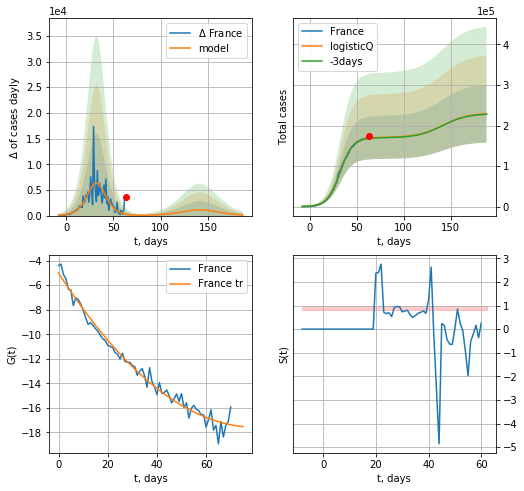

France data at: 2020-05-06
+3 day model MAPE: 0.006449
model: logisticQ
coeffs: [ 1.70588447e+05  2.36352175e-06  3.24781513e+01 -6.28631972e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311278
forecast at the end of period: +125 days
	 deltaDaycases: 136
	 total cases: 229186 ± 71340
	 total death: 33957 ± 31710
trend coefficient of determination: 0.980262
 intercept_: -5.002026917391758
 coeffs_: [ 0.         -0.3131316   0.00194825]


In [100]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


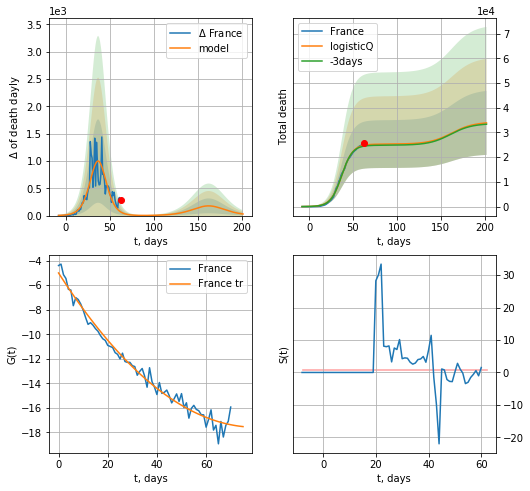

France data at: 2020-05-06
+3 day model MAPE: 0.015512
model: logisticQ
coeffs: [ 2.52762599e+04  2.00662995e-06  3.72794189e+01 -7.87646662e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.382269
forecast at the end of period: +139 days
	 total death: 33857 ± 12942
trend coefficient of determination: 0.980262
 intercept_: -5.002026917391758
 coeffs_: [ 0.         -0.3131316   0.00194825]


In [101]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [102]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [103]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


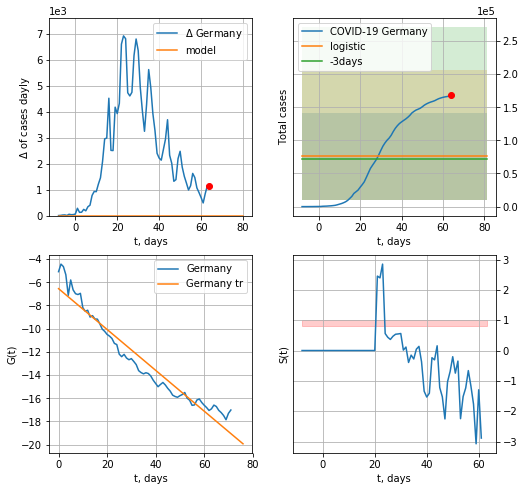

Germany data at: 2020-05-06
+3 day model MAPE: 0.054465015567718655
model: logistic
coeffs:  [ 7.57783150e+04 -3.46479420e+00  1.12053358e+02]
rational stdev:  0.8599937946200947
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  75778 ± 65168
	 total death:  3278 ± 8457
trend coefficient of determination: 0.938115
 intercept: -6.550936
 slope: -0.176016


In [104]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


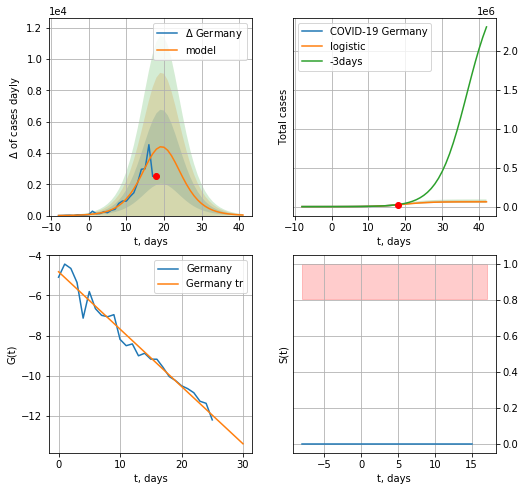

Germany data at: 2020-05-06
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +24 days
	 deltaDaycases:  35
	 total cases:  61531 ± 10494
	 total death:  2661 ± 1361
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


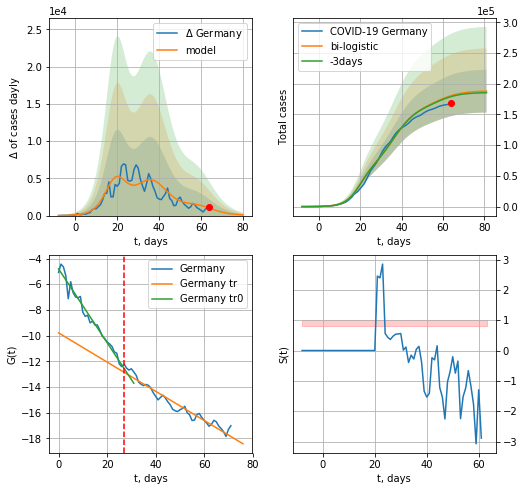

Germany data at: 2020-05-06
+3 day model MAPE: 0.009675385754970485
model: bi-logistic
coeffs:  [1.01421350e+05 1.80954525e-01 3.66031475e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.18540407292396813
forecast at the end of period: +17 days
	 deltaDaycases:  90
	 total cases:  187953 ± 34847
	 total death:  8131 ± 4522
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.944255
 intercept: -9.788219
 slope: -0.113622


In [105]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
68 2020-05-02  164967   27555  6812.0
69 2020-05-03  165664   28198  6866.0
70 2020-05-04  166152   24059  6993.0
71 2020-05-05  167007   24914  6993.5
72 2020-05-06  168162   20987  7275.0


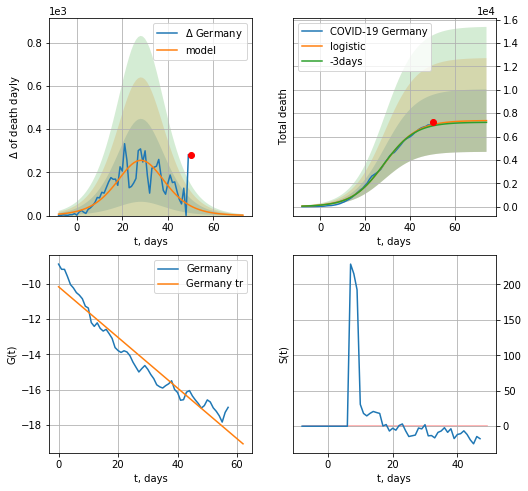

Germany data at: 2020-05-06
+3 day model MAPE: 0.01553611132756816
model: logistic
coeffs:  [7.37554509e+03 1.38891608e-01 2.86517848e+01]
rational stdev:  0.36331294914121265
forecast at the end of period: +24 days
	 total death:  7362 ± 2674
trend coefficient of determination: 0.939482
 intercept: -10.163885
 slope: -0.143880


In [106]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


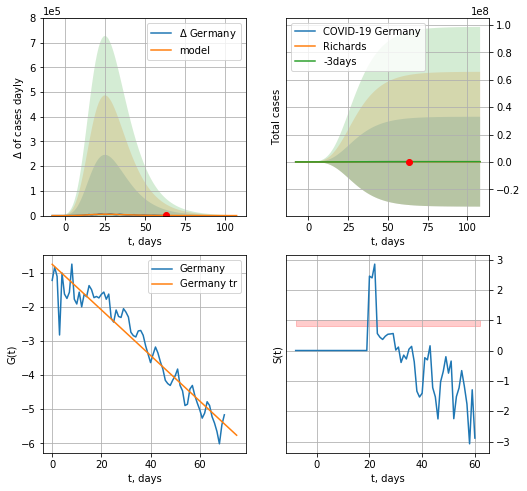

Germany data at: 2020-05-06
+3 day model MAPE: 0.003153
model: Richards
coeffs: [ 1.72788334e+05  5.75992977e+00 -2.23414128e+01  1.52136152e-02]
rational stdev: 189.904860
forecast at the end of period: +45 days
	 deltaDaycases: 11
	 total cases: 172663 ± 32789725
	 total death: 7469 ± 4255198
trend coefficient of determination: 0.919719
 intercept: -0.756630
 slope: -0.066739


In [108]:
x = forecastRR('Germany',dfGR[1:],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,5.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


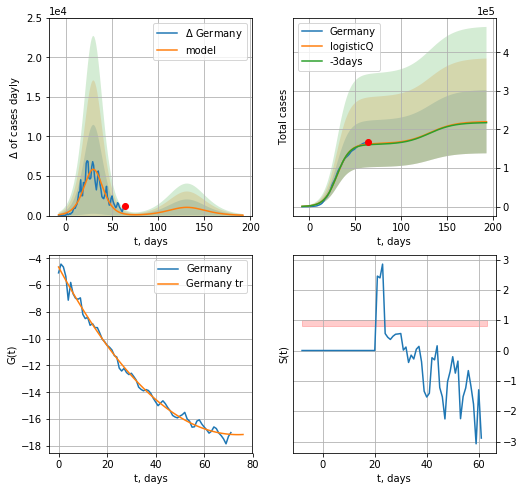

Germany data at: 2020-05-06
+3 day model MAPE: 0.011111
model: logisticQ
coeffs: [ 1.62934750e+05  1.08867864e-06  3.02035177e+01 -1.31866677e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372367
forecast at the end of period: +129 days
	 deltaDaycases: 50
	 total cases: 219963 ± 81907
	 total death: 9516 ± 10630
trend coefficient of determination: 0.993227
 intercept_: -4.651514571663748
 coeffs_: [ 0.         -0.33884574  0.00229353]


In [109]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


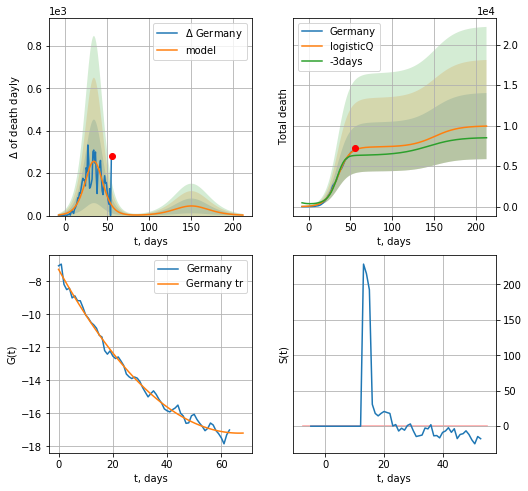

Germany data at: 2020-05-06
+3 day model MAPE: 0.115785
model: logisticQ
coeffs: [ 7.36422781e+03  2.11726483e-05  3.46314128e+01 -6.53784037e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410640
forecast at the end of period: +157 days
	 total death: 9938 ± 4081
trend coefficient of determination: 0.992480
 intercept_: -7.273487190989851
 coeffs_: [ 0.         -0.2979956   0.00223568]


In [110]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

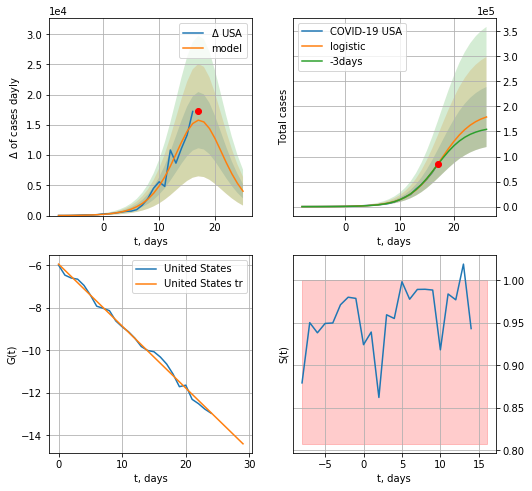

USA data at: 2020-05-06
+3 day model MAPE: 0.02944277425803263
model: logistic
coeffs:  [1.89999777e+05 3.33354123e-01 1.76550850e+01]
rational stdev:  0.3349926957690878
forecast at the end of period: +9 days
	 deltaDaycases:  4034
	 total cases:  178919 ± 59936
	 total death:  10595 ± 10647
trend coefficient of determination: 0.994747
 intercept: -5.944308
 slope: -0.291379


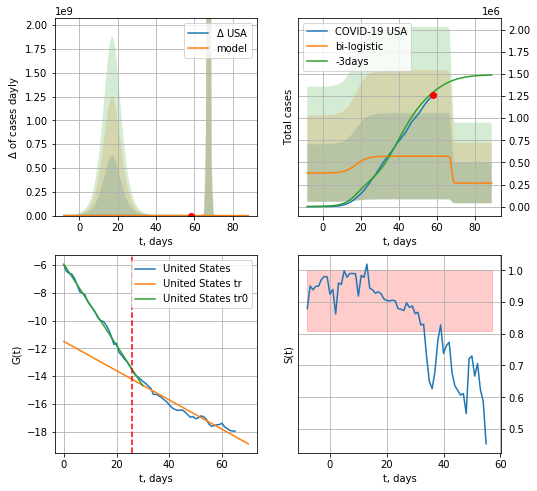

USA data at: 2020-05-06
+3 day model MAPE: 0.5645181659933293
model: bi-logistic
coeffs:  [ 3.03857989e+05 -3.44163219e+00  6.79185979e+01] [1.89999777e+05 3.33354123e-01 1.76550850e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.8554935605029171
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  265964 ± 227530
	 total death:  15750 ± 40422
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.995329
 intercept: -5.941731
 slope: -0.291701
trend coefficient of determination: 0.944959
 intercept: -11.500031
 slope: -0.105157


In [111]:
x = forecast('USA',dfUS[:26],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=26)

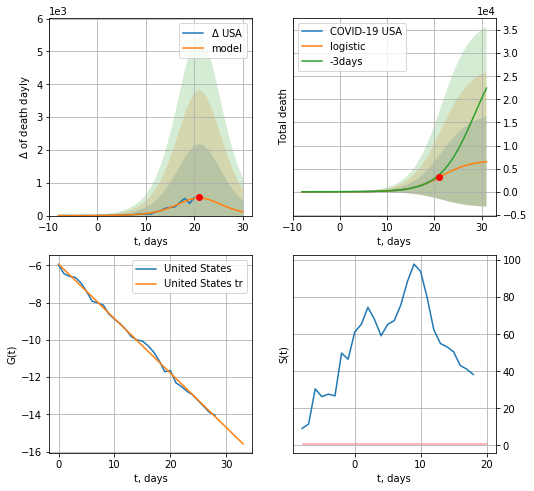

USA data at: 2020-05-06
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +10 days
	 total death:  6512 ± 9721
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


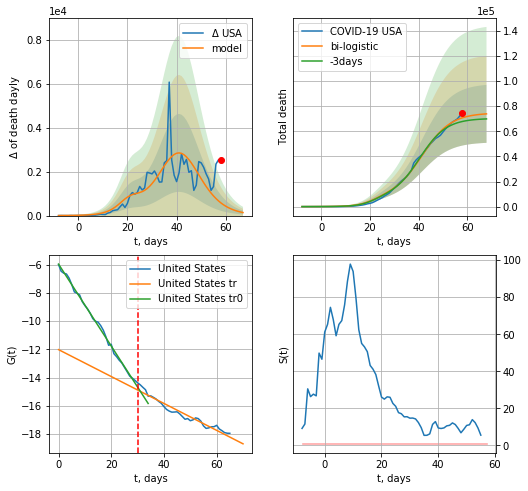

USA data at: 2020-05-06
+3 day model MAPE: 0.04551835947822716
model: bi-logistic
coeffs:  [6.78359501e+04 1.68504084e-01 4.14605287e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.31253468638926
forecast at the end of period: +10 days
	 deltaDaydeath:  138
	 total death:  73903 ± 23097
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.945529
 intercept: -12.015331
 slope: -0.095403


In [112]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


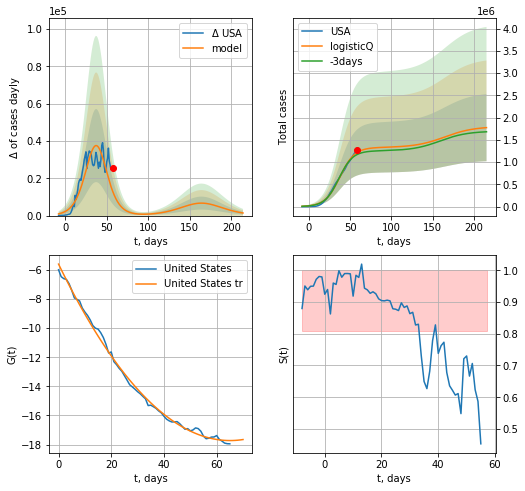

USA data at: 2020-05-06
+3 day model MAPE: 0.038808
model: logisticQ
coeffs: [ 1.32967530e+06  1.11375892e-06  3.77198338e+01 -1.01305854e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.425200
forecast at the end of period: +157 days
	 deltaDaycases: 1389
	 total cases: 1775396 ± 754897
	 total death: 105140 ± 134116
trend coefficient of determination: 0.996622
 intercept_: -5.598151048675762
 coeffs_: [ 0.         -0.37264022  0.0028625 ]


In [113]:
x = forecastRRR('USA',dfUS[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


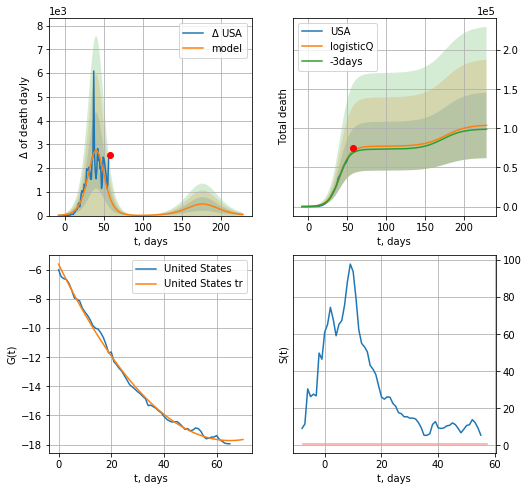

USA data at: 2020-05-06
+3 day model MAPE: 0.035158
model: logisticQ
coeffs: [ 7.71919481e+04  3.27685929e-06  4.05202437e+01 -4.33931108e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.403678
forecast at the end of period: +171 days
	 total death: 103902 ± 41943
trend coefficient of determination: 0.996622
 intercept_: -5.598151048675762
 coeffs_: [ 0.         -0.37264022  0.0028625 ]


In [114]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


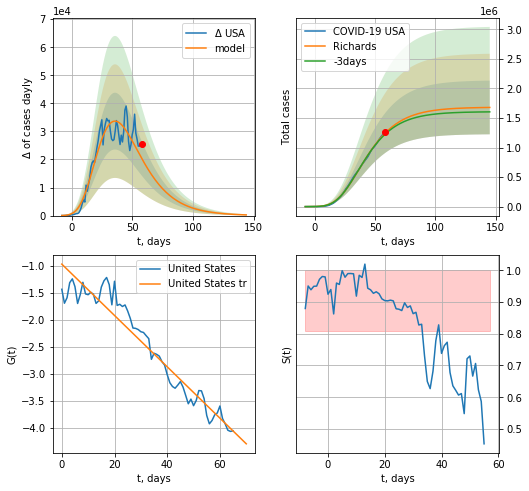

USA data at: 2020-05-06
+3 day model MAPE: 0.016383
model: Richards
coeffs: [ 1.68337803e+06  4.94259826e+00 -4.60321512e+01  1.10648388e-02]
rational stdev: 0.270796
forecast at the end of period: +87 days
	 deltaDaycases: 247
	 total cases: 1678968 ± 454657
	 total death: 99430 ± 80775
trend coefficient of determination: 0.929532
 intercept: -0.971232
 slope: -0.047521


In [115]:
x = forecastRR('USA',dfUS[:],d1,7*18-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


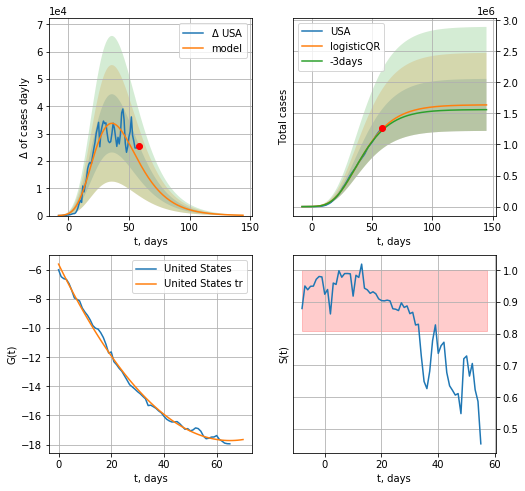

USA data at: 2020-05-06
+3 day model MAPE: 0.017504143718794808
model: logisticQR
coeffs:  [ 1.63866343e+06  1.90754022e-02 -8.19762271e+01 -8.52636937e+02
  2.92397749e-03]
rational stdev:  0.25569610100866835
forecast at the end of period: +87 days
	 deltaDaycases:  129
	 total cases:  1636830 ± 418531
	 total death:  96934 ± 74356
trend coefficient of determination: 0.996622
 intercept_: -5.598151048675762
 coeffs_: [ 0.         -0.37264022  0.0028625 ]


In [116]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
66 2020-05-02  182260  153785  28131.0
67 2020-05-03  186599  157809  28446.0
68 2020-05-04  190584  161506  28734.0
69 2020-05-05  194990  165219  29427.0
70 2020-05-06  201101  170681  30076.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


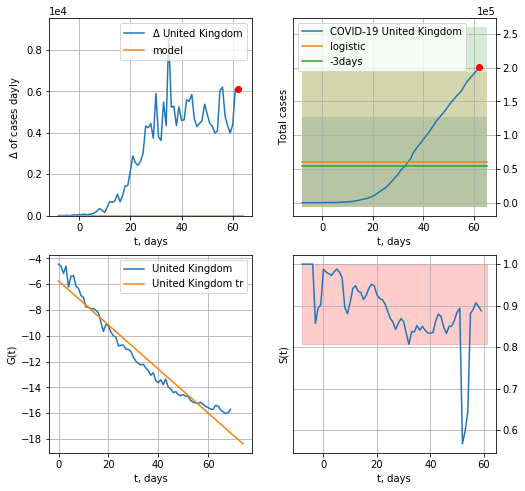

United Kingdom data at: 2020-05-06
+3 day model MAPE: 0.10864974753258323
model: logistic
coeffs:  [ 6.07064648e+04 -4.23120607e+00  1.21335685e+02]
rational stdev:  1.0948464621853848
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  60706 ± 66464
	 total death:  9079 ± 29820
trend coefficient of determination: 0.951913
 intercept: -5.757858
 slope: -0.170530


In [117]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


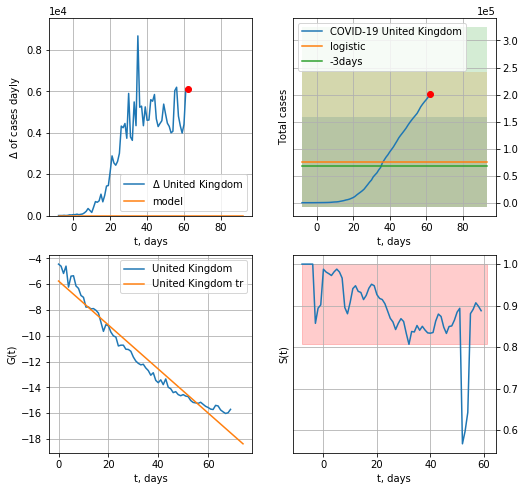

United Kingdom data at: 2020-05-06
+3 day model MAPE: 0.10864974753258337
model: logistic
coeffs:  [ 6.07064648e+04 -4.23120607e+00  1.21335685e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0948464621853848
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  75883 ± 83080
	 total death:  11348 ± 37272
trend coefficient of determination: 0.951913
 intercept: -5.757858
 slope: -0.170530


In [118]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: divide by zero encountered in true_divide


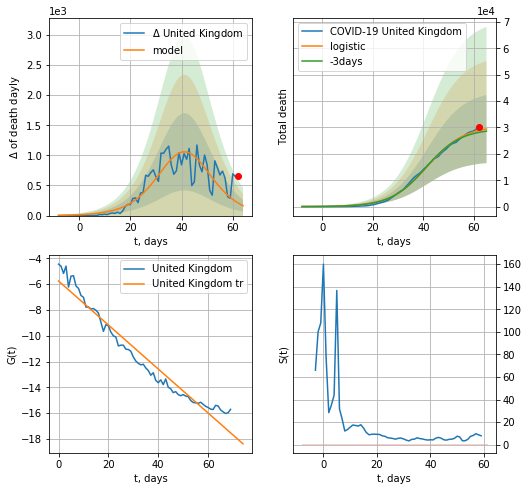

United Kingdom data at: 2020-05-06
+3 day model MAPE: 0.0268278543562521
model: logistic
coeffs:  [3.05774376e+04 1.38589548e-01 4.16170043e+01]
rational stdev:  0.4386134536072527
forecast at the end of period: +3 days
	 total death:  29425 ± 12906
trend coefficient of determination: 0.951913
 intercept: -5.757858
 slope: -0.170530


In [119]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


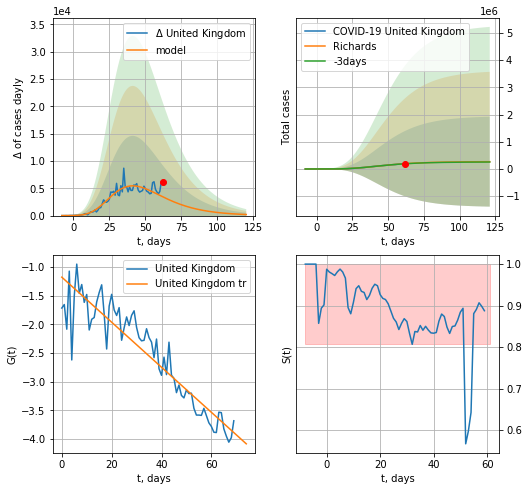

United Kingdom data at: 2020-05-06
+3 day model MAPE: 0.016968
model: Richards
coeffs: [ 2.72293546e+05  3.58511622e+00 -3.45434282e+01  1.53027199e-02]
rational stdev: 6.145269
forecast at the end of period: +59 days
	 deltaDaycases: 194
	 total cases: 268814 ± 1651939
	 total death: 40203 ± 741174
trend coefficient of determination: 0.857619
 intercept: -1.178176
 slope: -0.039246


In [120]:
x = forecastRR('United Kingdom',dfGB[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


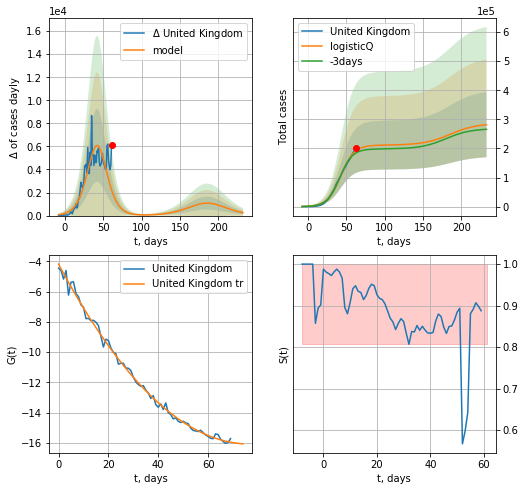

United Kingdom data at: 2020-05-06
+3 day model MAPE: 0.041479
model: logisticQ
coeffs: [ 2.11281348e+05  1.41479334e-06  4.25826579e+01 -8.13881153e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397965
forecast at the end of period: +171 days
	 deltaDaycases: 251
	 total cases: 281599 ± 112066
	 total death: 42115 ± 50280
trend coefficient of determination: 0.995450
 intercept_: -4.1814589428697735
 coeffs_: [ 0.         -0.30964669  0.00201633]


In [121]:
x = forecastRRR('United Kingdom',dfGB[:],d1,30*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


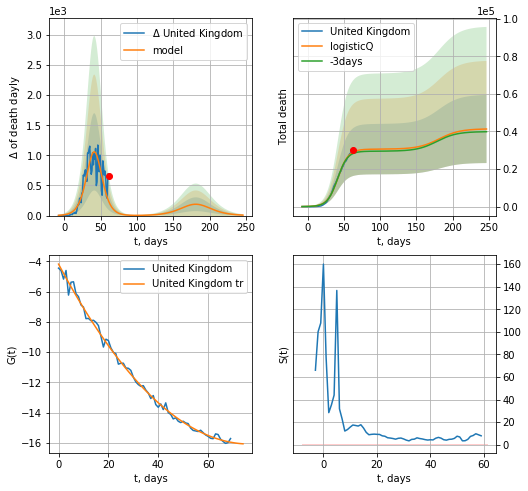

United Kingdom data at: 2020-05-06
+3 day model MAPE: 0.026850
model: logisticQ
coeffs: [ 3.05729211e+04  2.06124088e-06  4.16150994e+01 -6.71910007e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.438650
forecast at the end of period: +185 days
	 total death: 41290 ± 18111
trend coefficient of determination: 0.995450
 intercept_: -4.1814589428697735
 coeffs_: [ 0.         -0.30964669  0.00201633]


In [122]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [134]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [169]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [170]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [171]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [172]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [123]:
dT

39

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


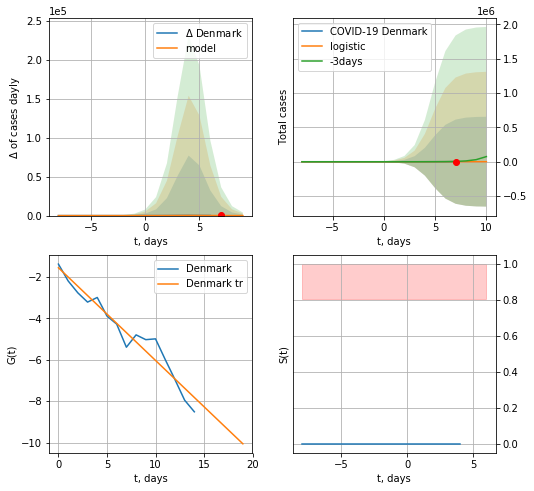

Denmark data at: 2020-05-06
+3 day model MAPE: 0.9299494930201694
model: logistic
coeffs:  [849.15572285   1.15642837   4.69716859]
rational stdev:  772.2918388633376
forecast at the end of period: +3 days
	 deltaDaycases:  3
	 total cases:  847 ± 654375
	 total death:  43 ± 99625
trend coefficient of determination: 0.941867
 intercept: -1.561623
 slope: -0.447087


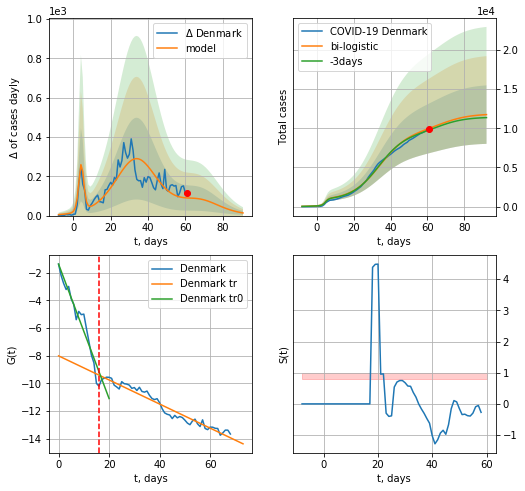

Denmark data at: 2020-05-06
+3 day model MAPE: 0.02113218233362224
model: bi-logistic
coeffs:  [8.79551444e+03 1.30292556e-01 3.41841182e+01] [849.15572285   1.15642837   4.69716859]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3177117762930129
forecast at the end of period: +31 days
	 deltaDaycases:  13
	 total cases:  11742 ± 3730
	 total death:  597 ± 569
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.932975
 intercept: -1.384195
 slope: -0.485107
trend coefficient of determination: 0.947758
 intercept: -8.005292
 slope: -0.086960


In [124]:
vL = 16
x = forecast('Denmark',dfDK[:vL],d1,6*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


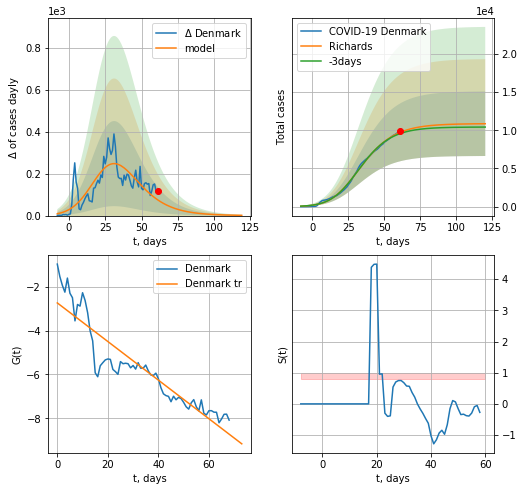

Denmark data at: 2020-05-06
+3 day model MAPE: 0.017817
model: Richards
coeffs: [1.08777839e+04 1.87125948e-01 1.90547804e+01 3.95466328e-01]
rational stdev: 0.389392
forecast at the end of period: +59 days
	 deltaDaycases: 1
	 total cases: 10862 ± 4229
	 total death: 553 ± 646
trend coefficient of determination: 0.854255
 intercept: -2.736879
 slope: -0.088016


In [125]:
x = forecastRR('Denmark',dfDK[:],d1,14*7-dT,1.0)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


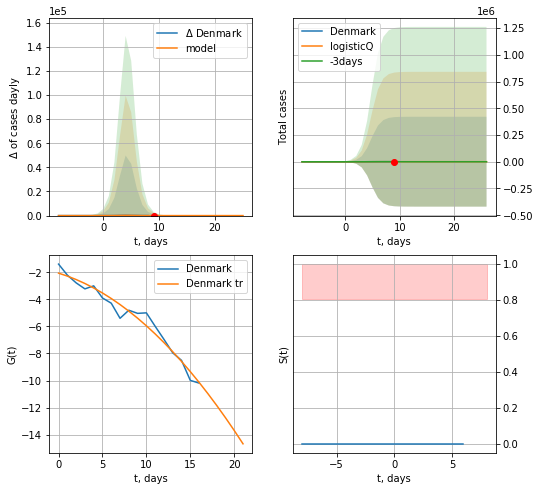

Denmark data at: 2020-05-06
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 43 ± 62857
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


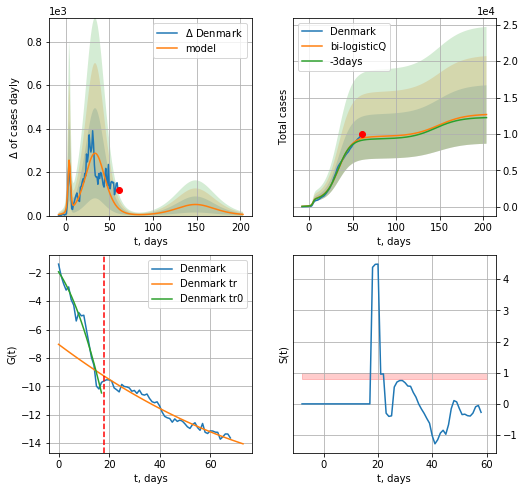

Denmark data at: 2020-05-06
+3 day model MAPE: 0.029338
model: bi-logisticQ
coeffs: [ 8.77684938e+03  8.87893746e-07  3.42025547e+01 -1.47150172e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317184
forecast at the end of period: +143 days
	 deltaDaycases: 5
	 total cases: 12666 ± 4017
	 total death: 644 ± 612
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.958226
 intercept_: -7.0426265479788075
 coeffs_: [ 0.         -0.1334543   0.00051164]


In [126]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
66 2020-05-02   7809    7566  211.0
67 2020-05-03   7847    7604  211.0
68 2020-05-04   7904    7658  214.0
69 2020-05-05   7955    7708  215.0
70 2020-05-06   7996    7748  216.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


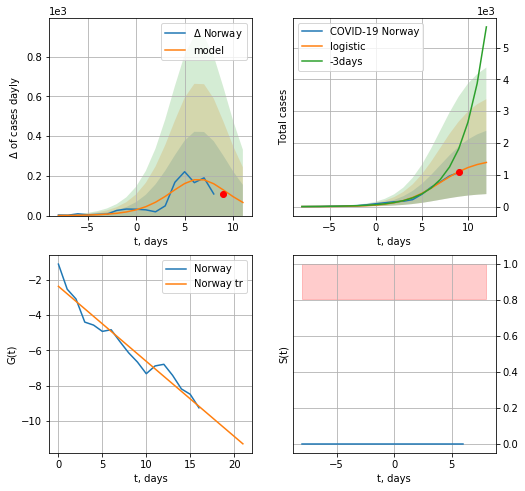

Norway data at: 2020-05-06
+3 day model MAPE: 0.5371818041233266
model: logistic
coeffs:  [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.7165081035353225
forecast at the end of period: +3 days
	 deltaDaycases:  66
	 total cases:  1388 ± 995
	 total death:  37 ± 79
trend coefficient of determination: 0.944117
 intercept: -2.361427
 slope: -0.426195


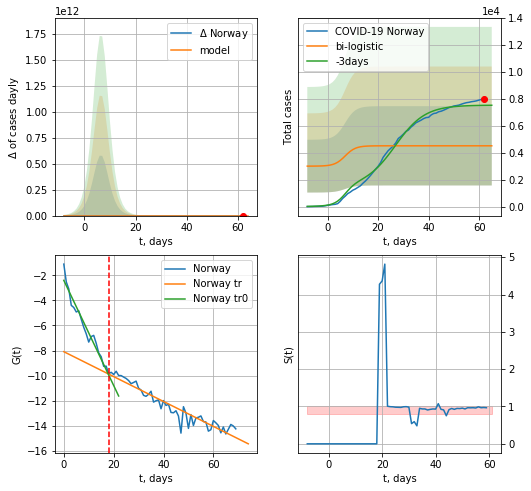

Norway data at: 2020-05-06
+3 day model MAPE: 0.399740186240928
model: bi-logistic
coeffs:  [ 3.00155090e+03 -2.01605658e+00  7.72441877e+01] [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.6518058149560734
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  4510 ± 2939
	 total death:  121 ± 236
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.950087
 intercept: -2.394883
 slope: -0.419922
trend coefficient of determination: 0.906461
 intercept: -8.093786
 slope: -0.099472


In [127]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=18
x = forecast('Norway',dfNG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,6*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

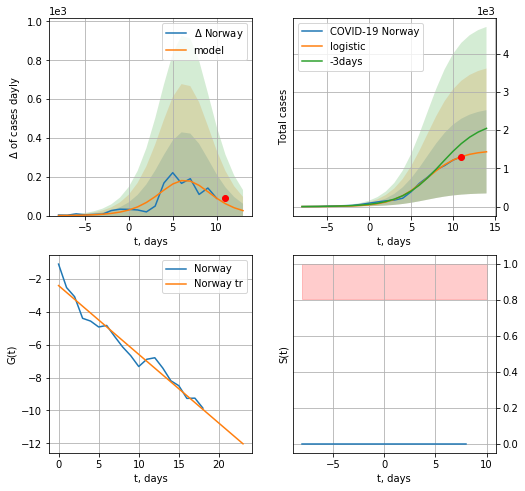

Norway data at: 2020-05-06
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +3 days
	 deltaDaycases:  25
	 total cases:  1432 ± 1088
	 total death:  38 ± 86
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


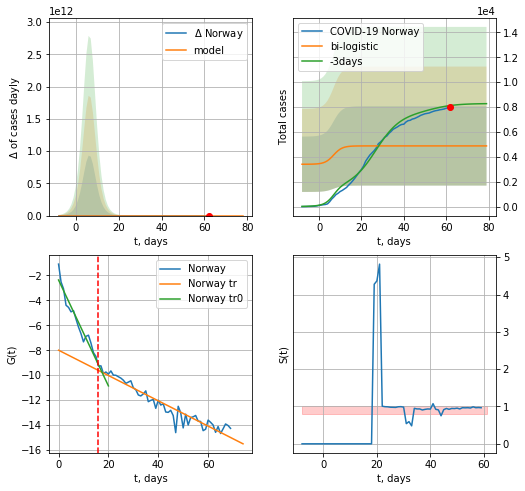

Norway data at: 2020-05-06
+3 day model MAPE: 0.40104675436684023
model: bi-logistic
coeffs:  [ 3.02606577e+03 -2.01574581e+00  2.69459461e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.6534503524197335
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  4879 ± 3188
	 total death:  131 ± 256
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.933194
 intercept: -2.371994
 slope: -0.424081
trend coefficient of determination: 0.915999
 intercept: -7.995746
 slope: -0.101363


In [128]:
vL = 16#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


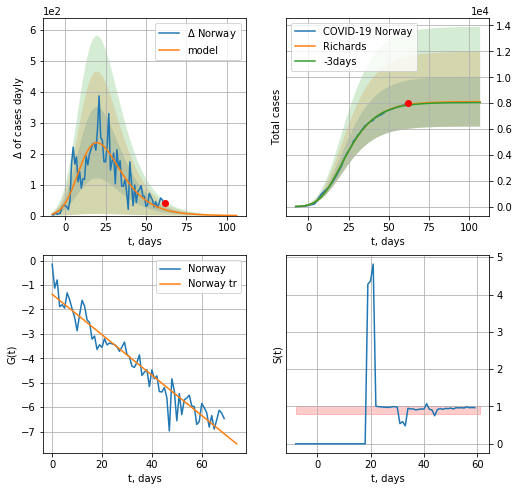

Norway data at: 2020-05-06
+3 day model MAPE: 0.005699
model: Richards
coeffs: [ 8.11682193e+03  6.32399846e-01 -3.79551879e+00  1.33048050e-01]
rational stdev: 0.237503
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 8111 ± 1926
	 total death: 219 ± 156
trend coefficient of determination: 0.928972
 intercept: -1.382715
 slope: -0.082661


In [129]:
x = forecastRR('Norway',dfNG[:],d1,12*7-dT,1.0)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


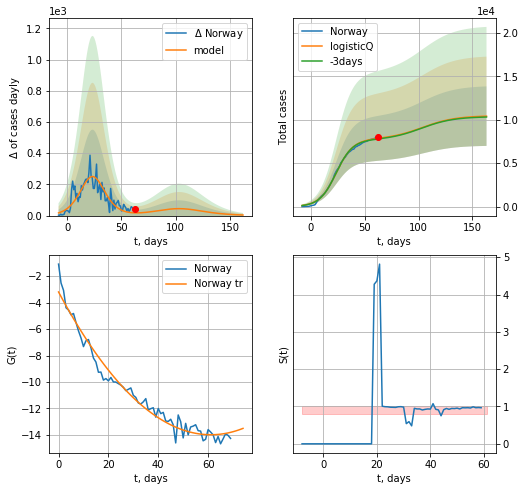

Norway data at: 2020-05-06
+3 day model MAPE: 0.009247
model: logisticQ
coeffs: [ 7.73478586e+03  1.05219117e-06  2.37264795e+01 -1.22622127e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328904
forecast at the end of period: +101 days
	 deltaDaycases: 3
	 total cases: 10418 ± 3426
	 total death: 281 ± 277
trend coefficient of determination: 0.970507
 intercept_: -3.203295305051004
 coeffs_: [ 0.         -0.35281154  0.00288692]


In [130]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

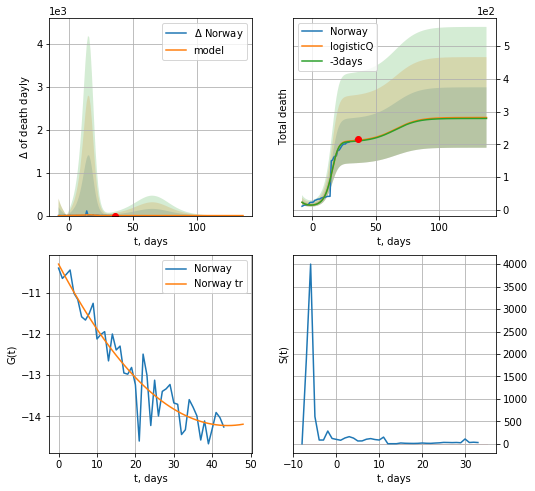

Norway data at: 2020-05-06
+3 day model MAPE: 0.009894
model: logisticQ
coeffs: [ 2.08253399e+02  1.02089179e-02  1.48458493e+01 -1.70377271e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327234
forecast at the end of period: +101 days
	 total death: 282 ± 92
trend coefficient of determination: 0.903008
 intercept_: -10.303378799370517
 coeffs_: [ 0.         -0.17812242  0.00202298]


In [131]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

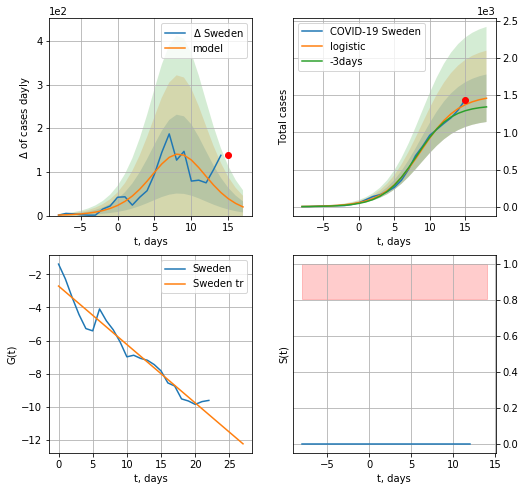

Sweden data at: 2020-05-06
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +3 days
	 deltaDaycases:  19
	 total cases:  1459 ± 319
	 total death:  179 ± 117
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


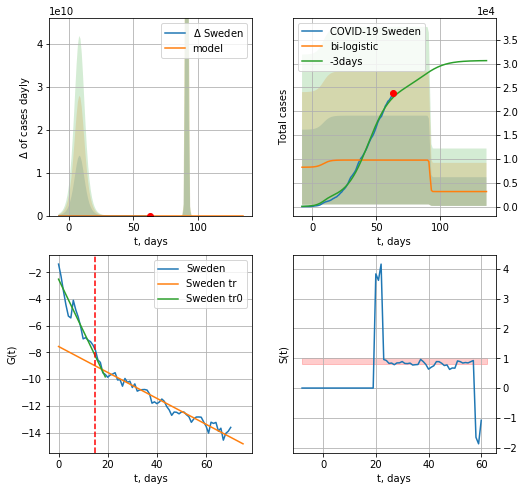

Sweden data at: 2020-05-06
+3 day model MAPE: 0.5780603644295373
model: bi-logistic
coeffs:  [ 6.60742543e+03 -3.13631207e+00  9.19603338e+01] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9533489812997432
forecast at the end of period: +73 days
	 deltaDaycases:  0
	 total cases:  3156 ± 3009
	 total death:  388 ± 1109
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.953796
 intercept: -7.554888
 slope: -0.097155


In [132]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,6*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
67 2020-05-02  22082   18408  2669.0
68 2020-05-03  22317   18633  2679.0
69 2020-05-04  22721   15878  2769.0
70 2020-05-05  23216   16288  2854.0
71 2020-05-06  23918   16903  2941.0


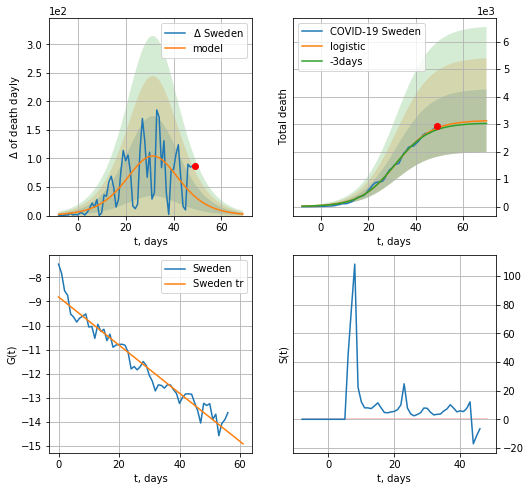

Sweden data at: 2020-05-06
+3 day model MAPE: 0.020935480714538657
model: logistic
coeffs:  [3.13732803e+03 1.33205919e-01 3.18144240e+01]
rational stdev:  0.3648543380917978
forecast at the end of period: +21 days
	 total death:  3118 ± 1137
trend coefficient of determination: 0.946528
 intercept: -8.815082
 slope: -0.099810


In [133]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


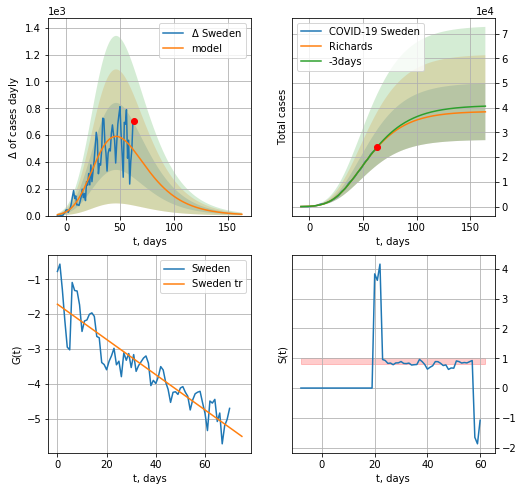

Sweden data at: 2020-05-06
+3 day model MAPE: 0.008299
model: Richards
coeffs: [ 3.85471997e+04  3.77413437e-01 -1.88775427e+00  1.16703221e-01]
rational stdev: 0.298732
forecast at the end of period: +101 days
	 deltaDaycases: 9
	 total cases: 38326 ± 11449
	 total death: 4712 ± 4222
trend coefficient of determination: 0.839879
 intercept: -1.714528
 slope: -0.050584


In [134]:
x = forecastRR('Sweden',dfSW[:],d1,20*7-dT,1.0)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


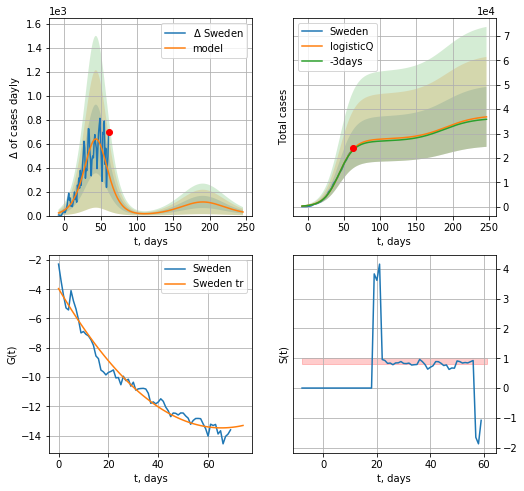

Sweden data at: 2020-05-06
+3 day model MAPE: 0.015662
model: logisticQ
coeffs: [ 2.77036282e+04  1.78969110e-06  4.38368320e+01 -5.15677234e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334140
forecast at the end of period: +185 days
	 deltaDaycases: 29
	 total cases: 36835 ± 12308
	 total death: 4529 ± 4539
trend coefficient of determination: 0.966546
 intercept_: -3.9560763165772173
 coeffs_: [ 0.         -0.29123149  0.00222704]


In [135]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


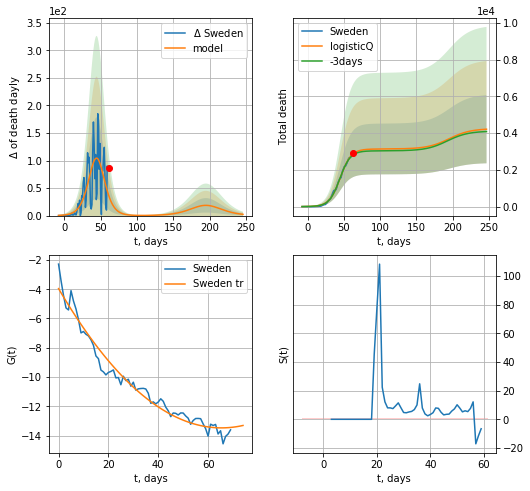

Sweden data at: 2020-05-06
+3 day model MAPE: 0.021103
model: logisticQ
coeffs: [ 3.13522429e+03  2.77416484e-06  4.48027106e+01 -4.80187291e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.440469
forecast at the end of period: +185 days
	 total death: 4212 ± 1855
trend coefficient of determination: 0.966546
 intercept_: -3.9560763165772173
 coeffs_: [ 0.         -0.29123149  0.00222704]


In [136]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

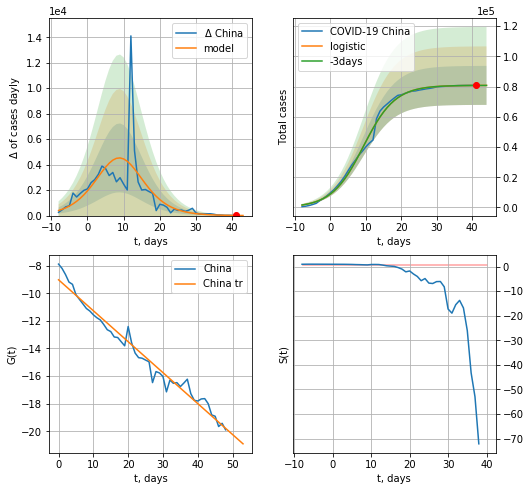

China data at: 2020-05-06
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  80776 ± 12901
	 total death:  4515 ± 2163
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


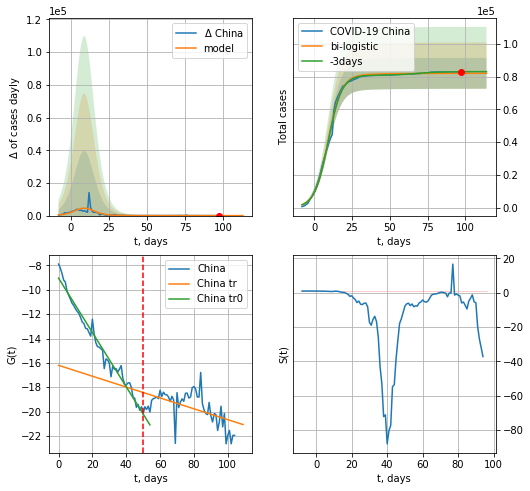

China data at: 2020-05-06
+3 day model MAPE: 0.011851157353928915
model: bi-logistic
coeffs:  [1.21631890e+03 5.69457716e-02 3.19347377e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11519025655376486
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  82015 ± 9447
	 total death:  4584 ± 1584
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.296003
 intercept: -16.202490
 slope: -0.044636


In [137]:
x = forecast('China',dfCN[:50],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [138]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

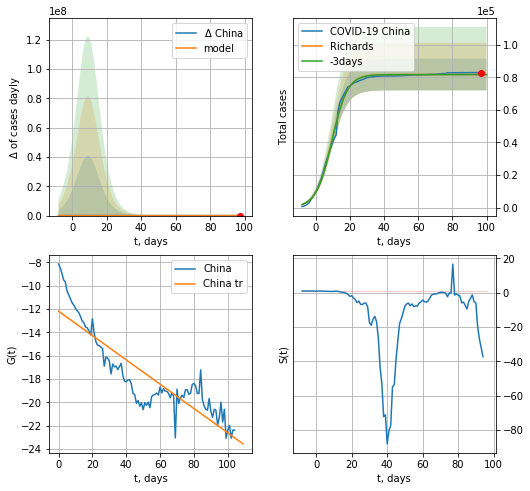

China data at: 2020-05-06
+3 day model MAPE: 0.000695
model: Richards
coeffs: [8.17045682e+04 2.13735554e-01 9.69545360e+00 1.03810535e+00]
rational stdev: 0.119317
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 81704 ± 9748
	 total death: 4567 ± 1634
trend coefficient of determination: 0.785783
 intercept: -12.182066
 slope: -0.104414


In [139]:
x = forecastRR('China',dfCN[:],d1,6*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

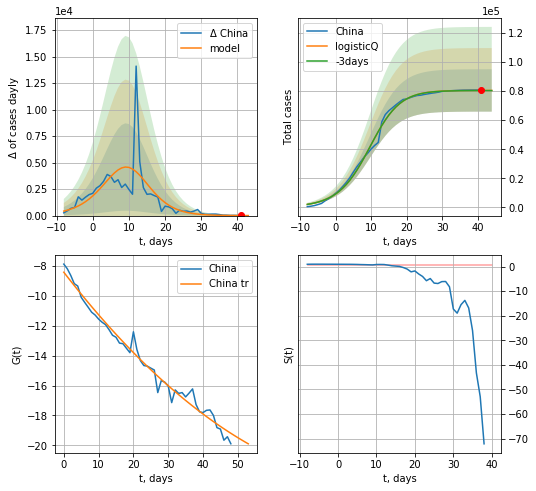

China data at: 2020-05-06
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +3 days
	 deltaDaycases: 2
	 total cases: 80409 ± 14555
	 total death: 4494 ± 2440
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


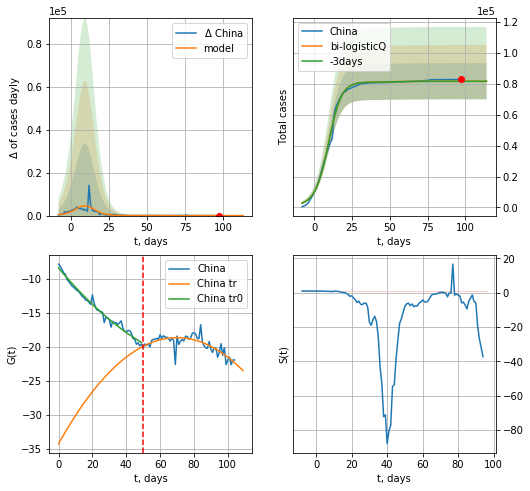

China data at: 2020-05-06
+3 day model MAPE: 0.000827
model: bi-logisticQ
coeffs: [ 1.37313125e+03  7.91832572e-04  2.50341246e+01 -1.01079994e-02]
rational stdev: 0.143240
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 81790 ± 11715
	 total death: 4571 ± 1964
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.603496
 intercept_: -34.26007225400171
 coeffs_: [ 0.          0.44524687 -0.00318127]


In [140]:
x = forecastRRR('China',dfCN[:50],d1,6*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [141]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date  cases  active  death
77 2020-05-02  10793  1360.0  250.0
78 2020-05-03  10801  1332.0  252.0
79 2020-05-04  10804  1267.0  254.0
80 2020-05-05  10806  1218.0  255.0
81 2020-05-06  10810  1135.0  256.0


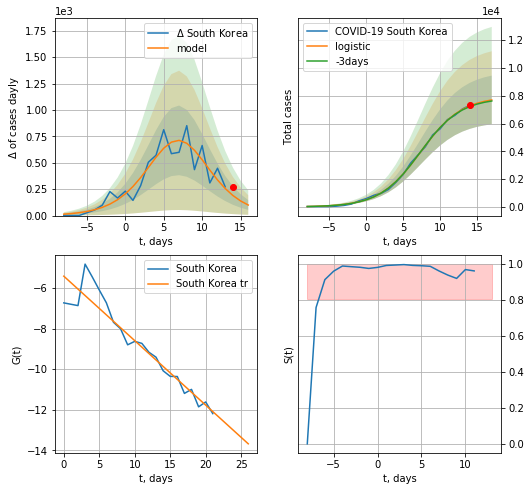

South Korea data at: 2020-05-06
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +3 days
	 deltaDaycases:  99
	 total cases:  7699 ± 1752
	 total death:  182 ± 124
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


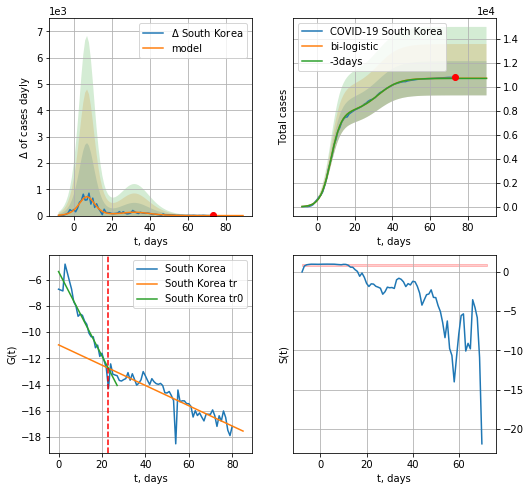

South Korea data at: 2020-05-06
+3 day model MAPE: 0.0011902037371798123
model: bi-logistic
coeffs:  [2.79111551e+03 1.80364379e-01 3.24020420e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.1330173041055756
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  10732 ± 1427
	 total death:  254 ± 101
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.800303
 intercept: -10.973916
 slope: -0.077235


In [143]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,6*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=23)

In [144]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

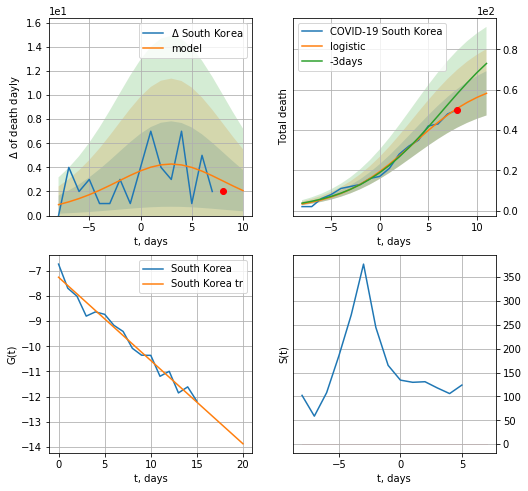

South Korea data at: 2020-05-06
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +3 days
	 total death:  58 ± 10
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


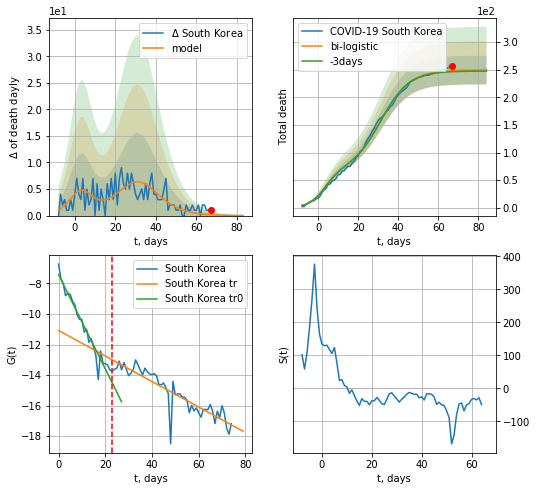

South Korea data at: 2020-05-06
+3 day model MAPE: 0.007837181332871226
model: bi-logistic
coeffs:  [1.83083562e+02 1.38732061e-01 3.14244218e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10431720631329942
forecast at the end of period: +17 days
	 deltaDaydeath:  0
	 total death:  249 ± 26
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.799867
 intercept: -11.077727
 slope: -0.083643


In [145]:
x = forecast('South Korea',dfKR[6:23],d1,6*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


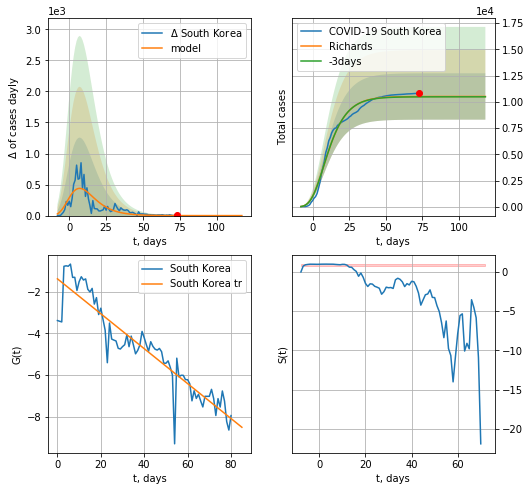

South Korea data at: 2020-05-06
+3 day model MAPE: 0.003117
model: Richards
coeffs: [ 1.05176058e+04  3.04634366e+01 -4.16774933e+01  3.73030115e-03]
rational stdev: 0.209983
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 10517 ± 2208
	 total death: 249 ± 156
trend coefficient of determination: 0.858932
 intercept: -1.380678
 slope: -0.083712


In [146]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


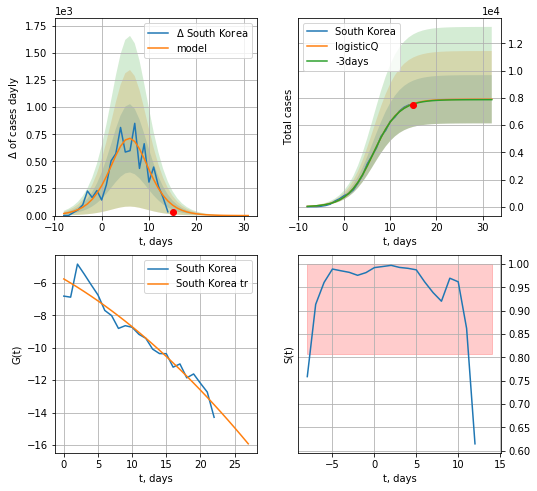

South Korea data at: 2020-05-06
+3 day model MAPE: 0.003444
model: logisticQ
coeffs: [ 7.90024888e+03  7.99722084e-05  6.33808286e+00 -4.52403663e+03]
rational stdev: 0.223765
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 7899 ± 1767
	 total death: 187 ± 125
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


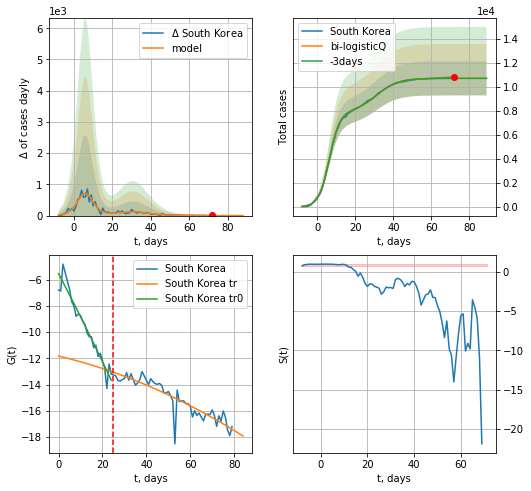

South Korea data at: 2020-05-06
+3 day model MAPE: 0.001161
model: bi-logisticQ
coeffs: [ 2.83447621e+03  1.61923604e-06  3.12096409e+01 -1.09268911e+05]
rational stdev: 0.132894
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 10734 ± 1426
	 total death: 254 ± 101
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936575
 intercept_: -5.550309986859278
 coeffs_: [ 0.         -0.32029791 -0.00074495]
trend coefficient of determination: 0.810903
 intercept_: -11.8291296210105
 coeffs_: [ 0.         -0.03939227 -0.00039366]


In [147]:
vL=25
x = forecastRRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


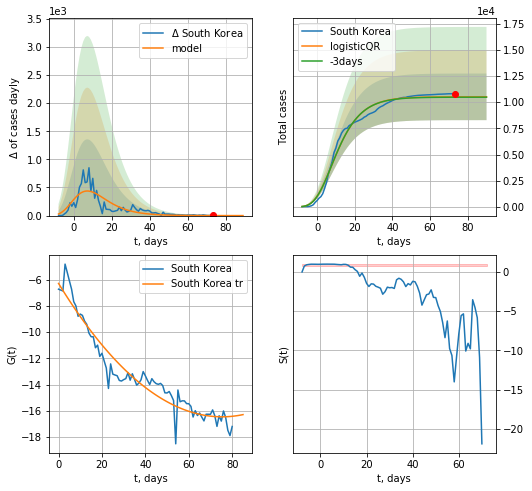

South Korea data at: 2020-05-06
+3 day model MAPE: 0.003083328305009679
model: logisticQR
coeffs:  [ 1.05094642e+04  1.52311650e-01 -6.53929152e+01 -2.10682924e+03
  3.40101496e-04]
rational stdev:  0.2117975817311612
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  10508 ± 2225
	 total death:  248 ± 157
trend coefficient of determination: 0.924572
 intercept_: -6.298229311179115
 coeffs_: [ 0.         -0.26959495  0.00178944]


In [148]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
           date  cases  active  death
100 2020-05-02  17548   16184   17.0
101 2020-05-03  18205   16779   18.0
102 2020-05-04  18778   17303   18.0
103 2020-05-05  19410   17873   18.0
104 2020-05-06  20198   18544   20.0


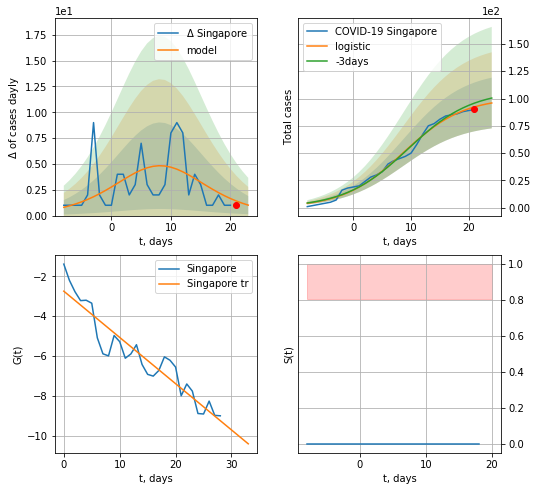

Singapore data at: 2020-05-06
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +3 days
	 deltaDaycases:  1
	 total cases:  95 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


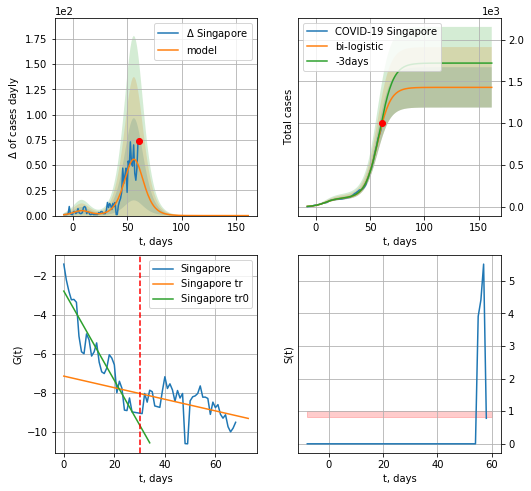

Singapore data at: 2020-05-06
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +101 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


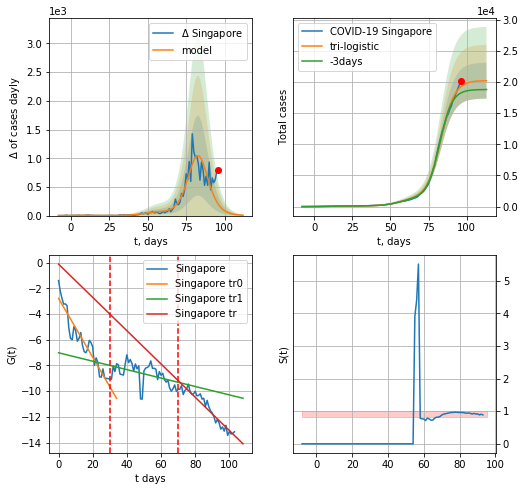

Singapore data at: 2020-05-06
+3 day model MAPE: 0.058146154530947375
model: tri-logistic
coeffs:  [1.87958987e+04 2.22235019e-01 8.31555840e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.14235580493496372
forecast at the end of period: +17 days
	 deltaDaycases:  6
	 total cases:  20199 ± 2875
	 total death:  20 ± 8
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.922073
 intercept: -0.104680
 slope: -0.129577


In [149]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


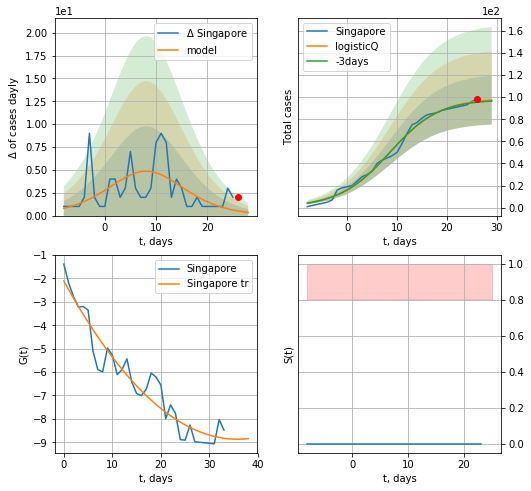

Singapore data at: 2020-05-06
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


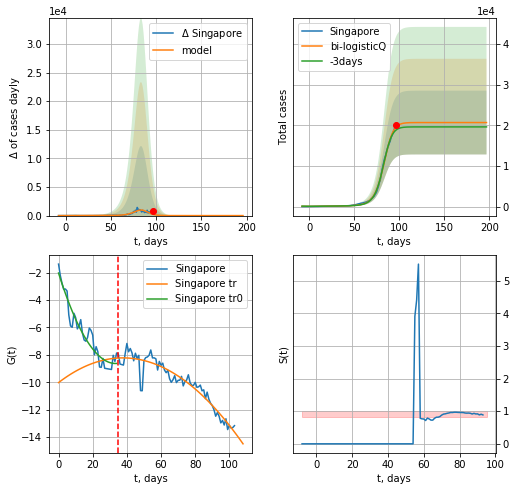

Singapore data at: 2020-05-06
+3 day model MAPE: 0.039295
model: bi-logisticQ
coeffs: [ 2.06043053e+04  1.38937671e-03  8.28096387e+01 -5.33921684e+01]
S.Korea scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.379253
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 20703 ± 7851
	 total death: 20 ± 22
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.899777
 intercept_: -10.021560283856326
 coeffs_: [ 0.          0.09556079 -0.00126722]


In [150]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=[0.35,.5,4.,1.],vL=vL)

In [151]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


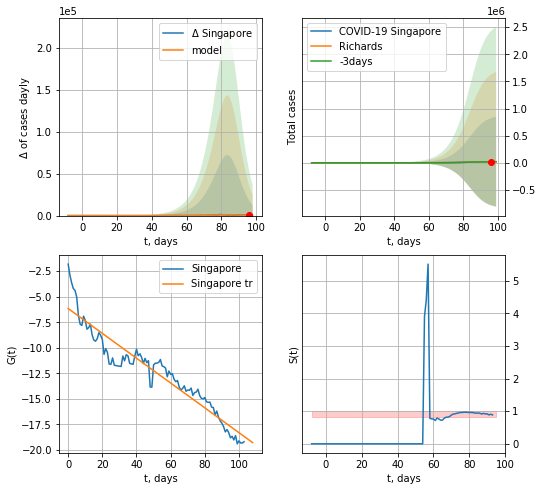

Singapore data at: 2020-05-06
+3 day model MAPE: 0.075624
model: Richards
coeffs: [2.07780741e+04 1.38024321e-01 8.60756563e+01 1.60997120e+00]
rational stdev: 41.262069
forecast at the end of period: +3 days
	 deltaDaycases: 164
	 total cases: 20079 ± 828529
	 total death: 19 ± 2351
trend coefficient of determination: 0.901768
 intercept: -6.159420
 slope: -0.121542


In [152]:
x = forecastRR('Singapore',dfSG[:],d1,6*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


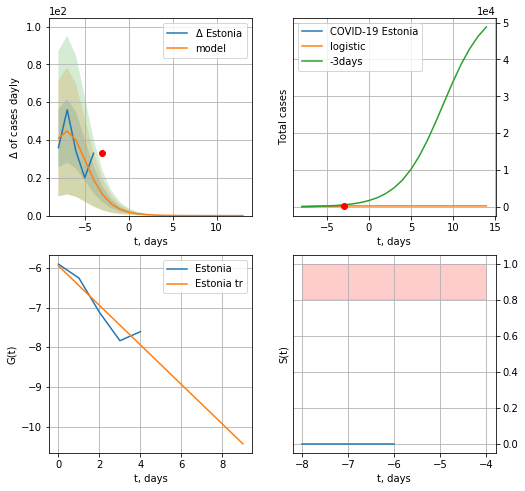

Estonia data at: 2020-05-06
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  8 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


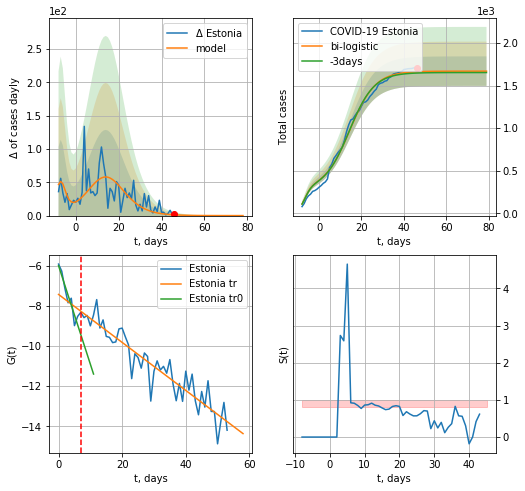

Estonia data at: 2020-05-06
+3 day model MAPE: 0.00940553578234175
model: bi-logistic
coeffs:  [1.39266555e+03 1.66891490e-01 1.44696496e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.1037255089726566
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  1670 ± 173
	 total death:  53 ± 16
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.864276
 intercept: -7.420232
 slope: -0.119773


In [155]:
shift = 1.0
x = forecast('Estonia',dfES[1:7],d1,17,1.)
xx = forecast2('Estonia',dfES[1:],d1,12*6-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


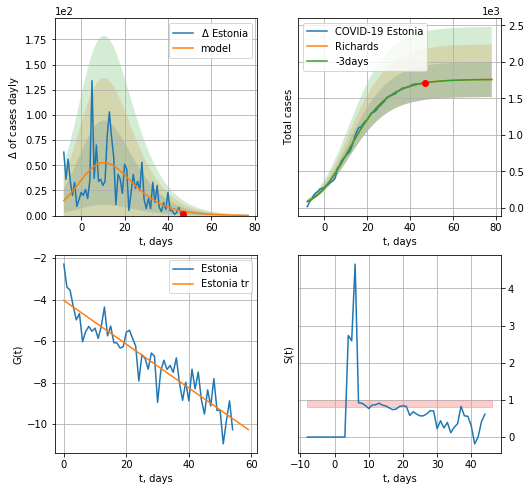

Estonia data at: 2020-05-06
+3 day model MAPE: 0.000331
model: Richards
coeffs: [1.76061070e+03 2.11523265e-01 3.47157143e+00 4.71760311e-01]
rational stdev: 0.136612
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 1758 ± 240
	 total death: 56 ± 22
trend coefficient of determination: 0.851538
 intercept: -4.038144
 slope: -0.105445


In [156]:
x = forecastRR('Estonia',dfES[:],d1,7*10-dT,1.)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


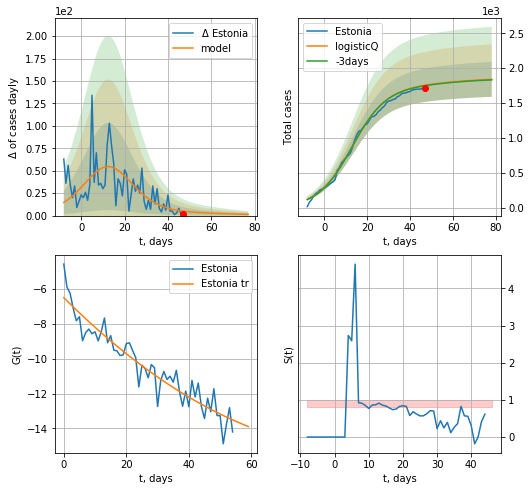

Estonia data at: 2020-05-06
+3 day model MAPE: 0.003806
model: logisticQ
coeffs: [ 1.71429238e+03  2.12993299e-06  1.28454534e+01 -5.90997800e+04]
S.Korea scenario coeffs: [0.0875, 0.5, 4.0, 1]
rational stdev: 0.136140
forecast at the end of period: +31 days
	 deltaDaycases: 1
	 total cases: 1840 ± 250
	 total death: 59 ± 24
trend coefficient of determination: 0.893093
 intercept_: -6.515221061520053
 coeffs_: [ 0.         -0.17853829  0.00090842]


In [157]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/4,.5,4.,1])

LV
          date  cases  active  death
56 2020-05-02  871.0     507   16.0
57 2020-05-03  879.0     515   16.0
58 2020-05-04  896.0     532   16.0
59 2020-05-05  900.0     419   17.0
60 2020-05-06  900.0     419   17.0


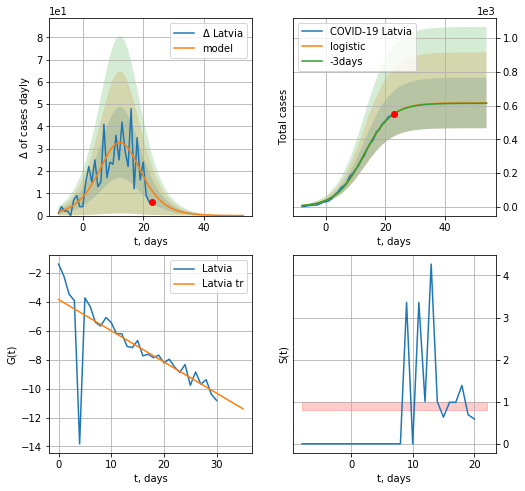

Latvia data at: 2020-05-06
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  615 ± 150
	 total death:  11 ± 8
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

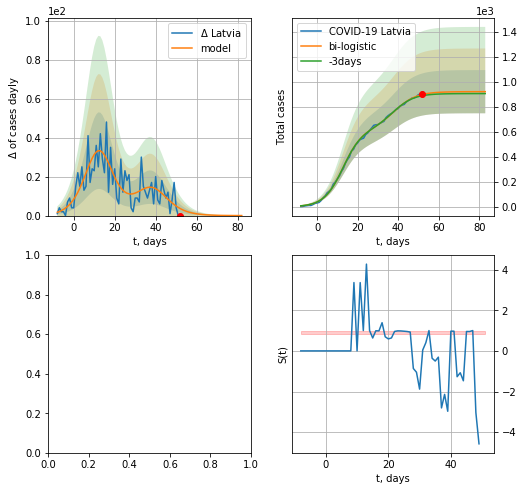

In [158]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


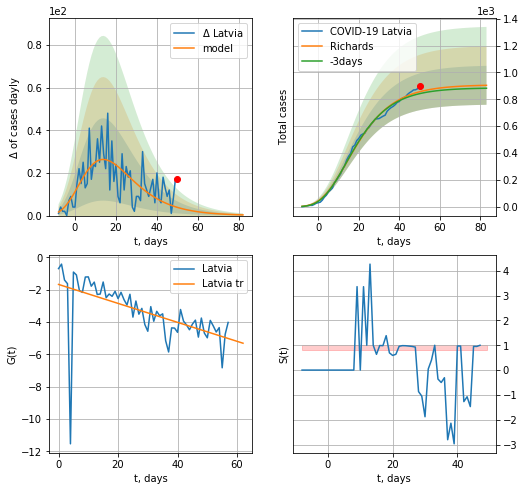

Latvia data at: 2020-05-04
+3 day model MAPE: 0.017238
model: Richards
coeffs: [ 9.08378031e+02  8.26960684e+00 -4.45165842e+01  9.57062727e-03]
rational stdev: 0.160344
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 904 ± 145
	 total death: 16 ± 7
trend coefficient of determination: 0.315137
 intercept: -1.679170
 slope: -0.058631


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


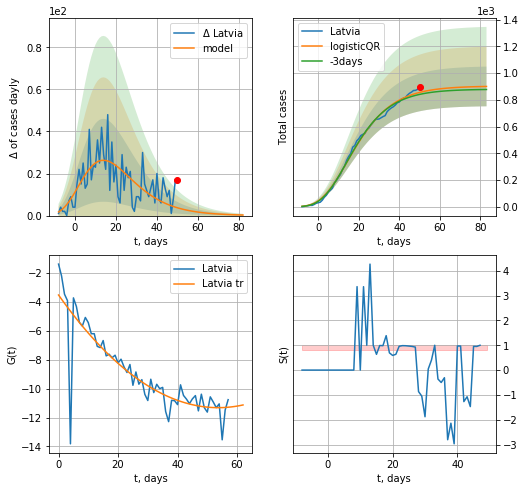

Latvia data at: 2020-05-04
+3 day model MAPE: 0.018056873704357886
model: logisticQR
coeffs:  [ 9.03213647e+02  4.65023304e-02 -7.66670123e+01 -1.33267460e+03
  1.18502841e-03]
rational stdev:  0.16500634436457115
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  900 ± 148
	 total death:  16 ± 7
trend coefficient of determination: 0.743096
 intercept_: -3.523642027031876
 coeffs_: [ 0.         -0.29028393  0.00270374]


In [605]:
x = forecastRR('Latvia',dfLV[:],d1,7*10-dT,1.)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


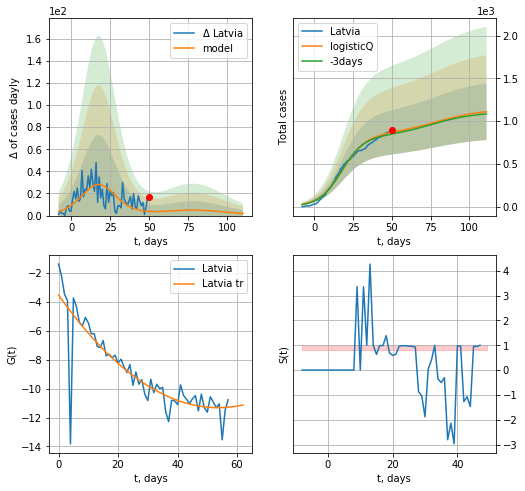

Latvia data at: 2020-05-04
+3 day model MAPE: 0.022842
model: logisticQ
coeffs: [ 8.42870727e+02  7.38741173e-07  1.80367360e+01 -1.78624895e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297975
forecast at the end of period: +61 days
	 deltaDaycases: 1
	 total cases: 1110 ± 330
	 total death: 19 ± 16
trend coefficient of determination: 0.743096
 intercept_: -3.523642027031876
 coeffs_: [ 0.         -0.29028393  0.00270374]


In [606]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*14-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


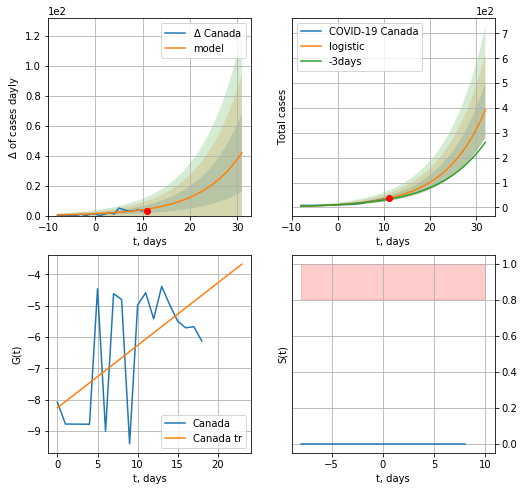

Canada data at: 2020-05-06
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  26 ± 22
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


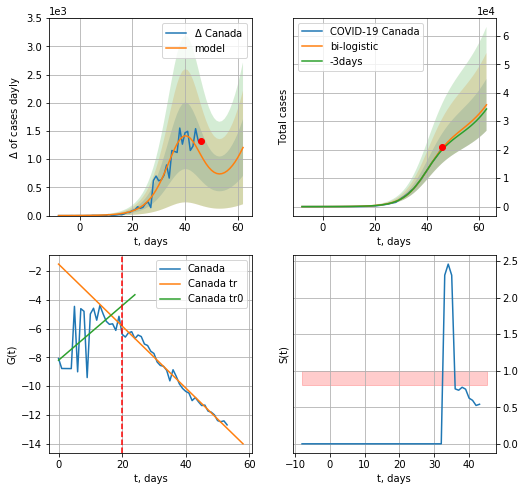

Canada data at: 2020-05-06
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +17 days
	 deltaDaycases:  1207
	 total cases:  35758 ± 9116
	 total death:  2383 ± 1822
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


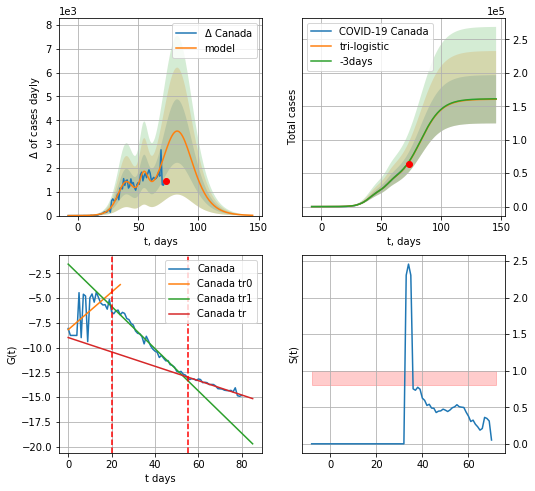

Canada data at: 2020-05-06
+3 day model MAPE: 0.009177708178967387
model: tri-logistic
coeffs:  [1.11508212e+04 3.96670663e-01 5.52875417e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.22476863436961955
forecast at the end of period: +73 days
	 deltaDaycases:  11
	 total cases:  160407 ± 36054
	 total death:  10691 ± 7209
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.933561
 intercept: -8.988559
 slope: -0.072567


In [159]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
77 2020-05-02  56714.0   29347  3566.0
78 2020-05-03  59474.0   30884  3682.0
79 2020-05-04  60772.0   30901  3854.0
80 2020-05-05  62046.0   31010  4043.0
81 2020-05-06  63496.0   31093  4232.0


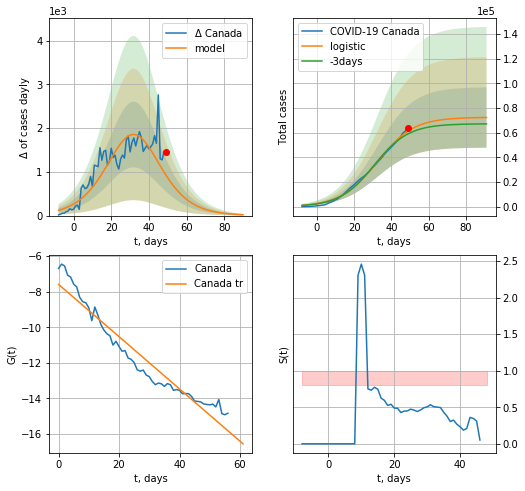

Canada data at: 2020-05-06
+3 day model MAPE: 0.04100804733649699
model: logistic
coeffs:  [7.24556780e+04 1.02452296e-01 3.23201192e+01]
rational stdev:  0.33844929592970363
forecast at the end of period: +42 days
	 deltaDaycases:  19
	 total cases:  72278 ± 24462
	 total death:  4817 ± 4890
trend coefficient of determination: 0.932104
 intercept: -7.586060
 slope: -0.147079


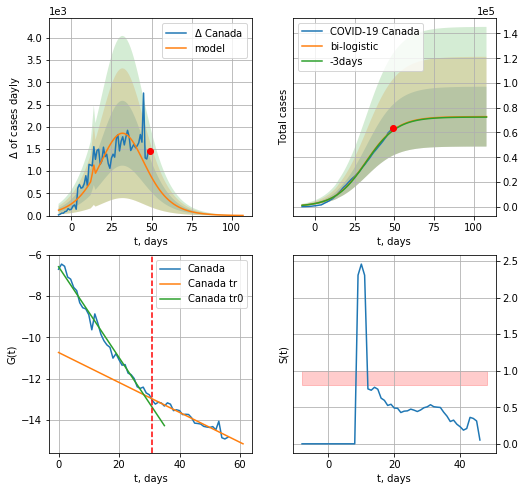

Canada data at: 2020-05-06
+3 day model MAPE: 0.005865330258406999
model: bi-logistic
coeffs:  [365.27760193  17.35896876  14.04569012] [7.24556780e+04 1.02452296e-01 3.23201192e+01]
rational stdev:  0.33212122673546235
forecast at the end of period: +59 days
	 deltaDaycases:  3
	 total cases:  72789 ± 24175
	 total death:  4851 ± 4833
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.933561
 intercept: -10.730177
 slope: -0.072567


In [160]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31,cases='cases')

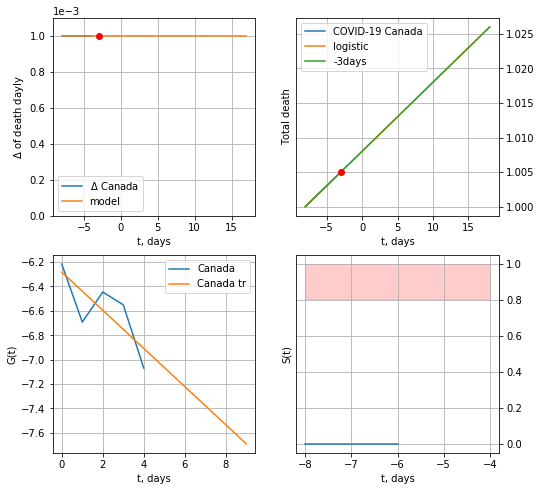

Canada data at: 2020-05-06
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


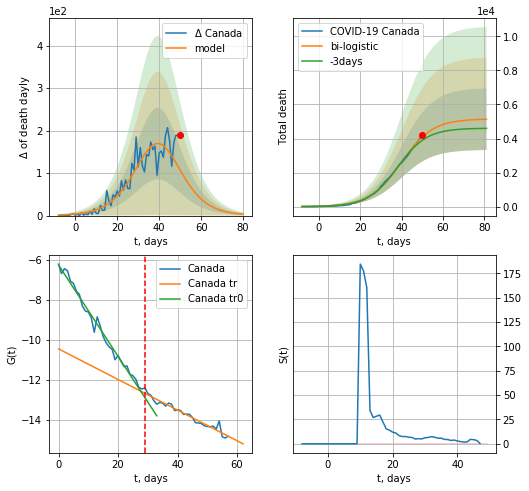

Canada data at: 2020-05-06
+3 day model MAPE: 0.05616571383337093
model: bi-logistic
coeffs:  [5.15633476e+03 1.31627945e-01 3.97996586e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.35211014479137137
forecast at the end of period: +31 days
	 deltaDaydeath:  3
	 total death:  5134 ± 1808
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.947476
 intercept: -10.459593
 slope: -0.076672


In [161]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


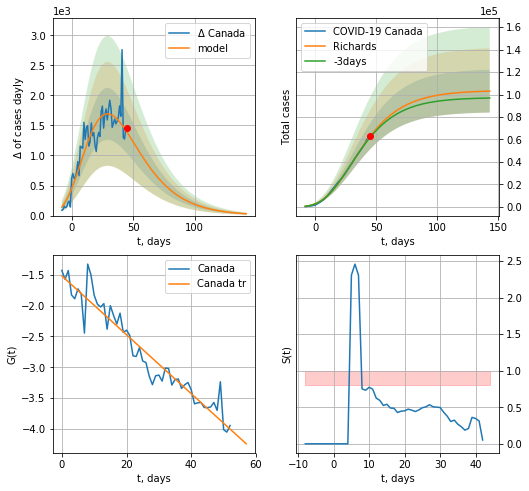

Canada data at: 2020-05-06
+3 day model MAPE: 0.016474
model: Richards
coeffs: [ 1.03734449e+05  2.99180448e+00 -6.43657422e+01  1.49383723e-02]
rational stdev: 0.184829
forecast at the end of period: +98 days
	 deltaDaycases: 29
	 total cases: 103080 ± 19052
	 total death: 6870 ± 3809
trend coefficient of determination: 0.922854
 intercept: -1.517560
 slope: -0.047766


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


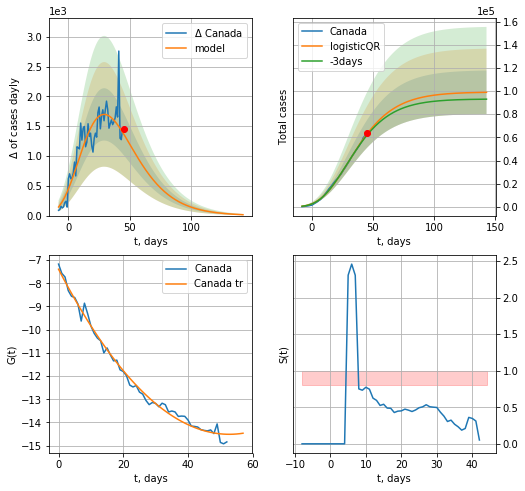

Canada data at: 2020-05-06
+3 day model MAPE: 0.017421789163697306
model: logisticQR
coeffs:  [ 9.91479147e+04  1.01267433e-02 -1.04373608e+02 -7.95927201e+02
  4.80808997e-03]
rational stdev:  0.1903151018143908
forecast at the end of period: +98 days
	 deltaDaycases:  14
	 total cases:  98895 ± 18821
	 total death:  6591 ± 3763
trend coefficient of determination: 0.990923
 intercept_: -7.396026586946654
 coeffs_: [ 0.         -0.26972287  0.00255618]


In [162]:
x = forecastRR('Canada',dfCA[28:],d1,14*7,1.)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


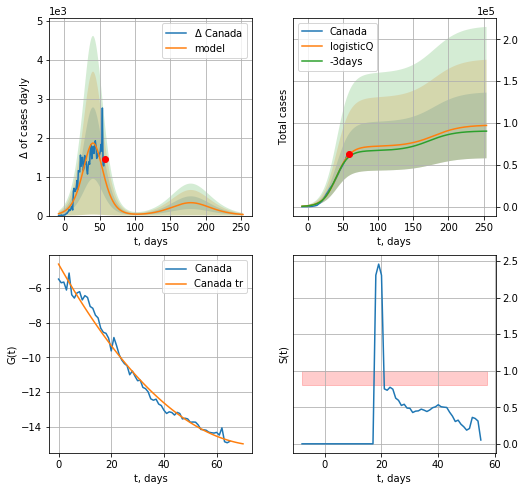

Canada data at: 2020-05-06
+3 day model MAPE: 0.041548
model: logisticQ
coeffs: [ 7.20922804e+04  1.36886953e-06  4.12015824e+01 -7.53334160e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.404530
forecast at the end of period: +196 days
	 deltaDaycases: 27
	 total cases: 97099 ± 39279
	 total death: 6471 ± 7853
trend coefficient of determination: 0.986186
 intercept_: -4.6306807314191785
 coeffs_: [ 0.         -0.26927088  0.00173432]


In [163]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
61 2020-05-02  25190   22496  1023.0
62 2020-05-03  25282   22550  1043.0
63 2020-05-04  25524   22749  1063.0
64 2020-05-05  25702   22885  1074.0
65 2020-05-06  26182   23017  1089.0


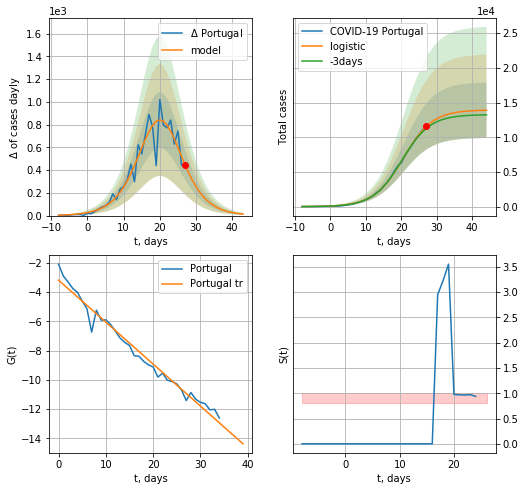

Portugal data at: 2020-05-06
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +17 days
	 deltaDaycases:  12
	 total cases:  13895 ± 4002
	 total death:  577 ± 498
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


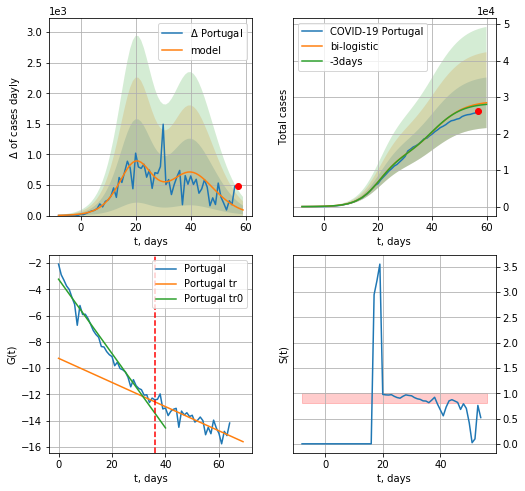

Portugal data at: 2020-05-06
+3 day model MAPE: 0.014411473621459607
model: bi-logistic
coeffs:  [1.19753999e+04 1.99724561e-01 3.97679748e+01] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.24345698555081327
forecast at the end of period: +3 days
	 deltaDaycases:  92
	 total cases:  28467 ± 6930
	 total death:  1184 ± 864
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.742543
 intercept: -9.247304
 slope: -0.091953


In [164]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,6*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


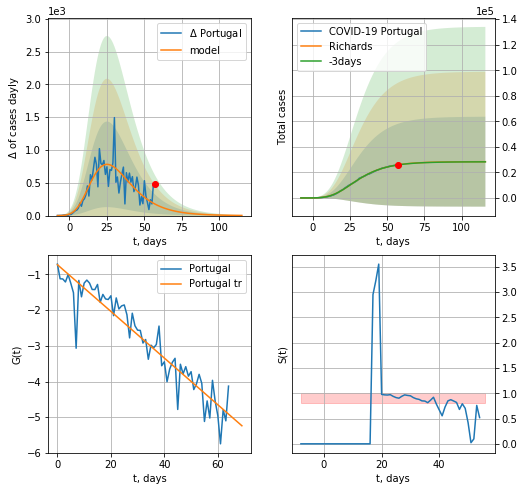

Portugal data at: 2020-05-06
+3 day model MAPE: 0.002820
model: Richards
coeffs: [ 2.84234090e+04  5.87518998e+00 -3.23547899e+01  1.28090589e-02]
rational stdev: 1.239257
forecast at the end of period: +59 days
	 deltaDaycases: 2
	 total cases: 28391 ± 35184
	 total death: 1180 ± 4386
trend coefficient of determination: 0.888152
 intercept: -0.727894
 slope: -0.065396


In [165]:
x = forecastRR('Portugal',dfPT[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


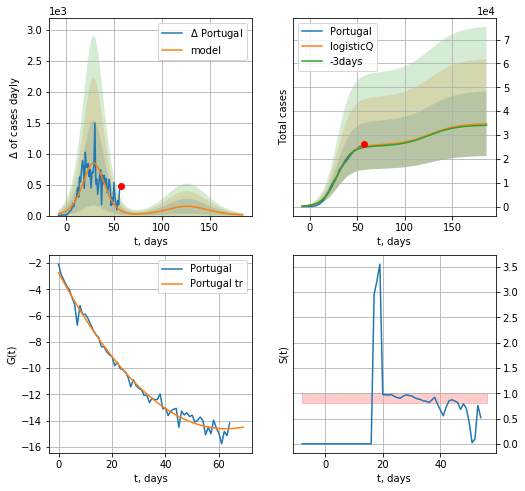

Portugal data at: 2020-05-06
+3 day model MAPE: 0.016266
model: logisticQ
coeffs: [ 2.57455339e+04  1.06364179e-06  2.90749567e+01 -1.23755088e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.390075
forecast at the end of period: +129 days
	 deltaDaycases: 11
	 total cases: 34687 ± 13530
	 total death: 1442 ± 1687
trend coefficient of determination: 0.987054
 intercept_: -2.7315133490627073
 coeffs_: [ 0.         -0.37972765  0.00303526]


In [166]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

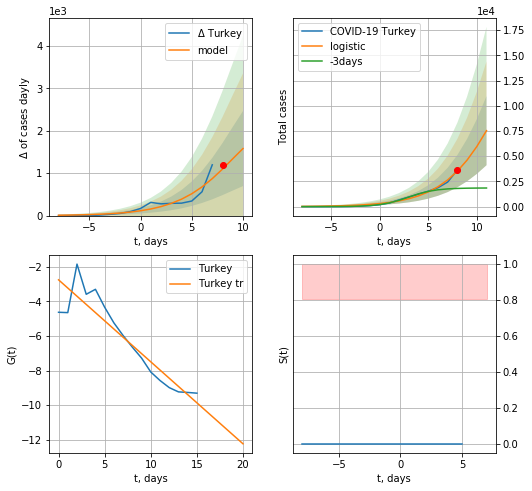

Turkey data at: 2020-05-06
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +3 days
	 deltaDaycases:  1579
	 total cases:  7530 ± 3427
	 total death:  204 ± 278
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


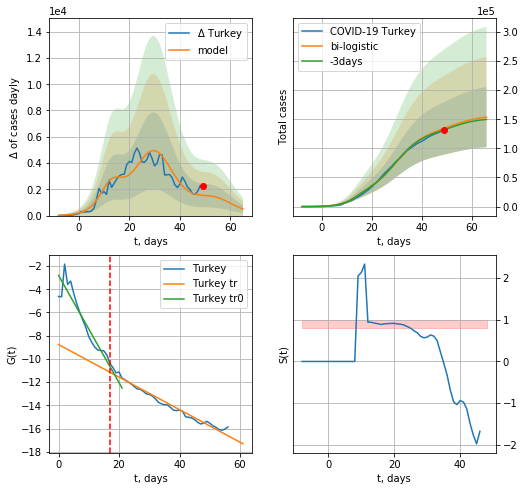

Turkey data at: 2020-05-06
+3 day model MAPE: 0.0189559839226602
model: bi-logistic
coeffs:  [1.05787493e+05 1.84026755e-01 3.00468391e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.33601561166979166
forecast at the end of period: +17 days
	 deltaDaycases:  501
	 total cases:  153704 ± 51647
	 total death:  4181 ± 4214
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.971422
 intercept: -8.758579
 slope: -0.140029


In [167]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,6*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


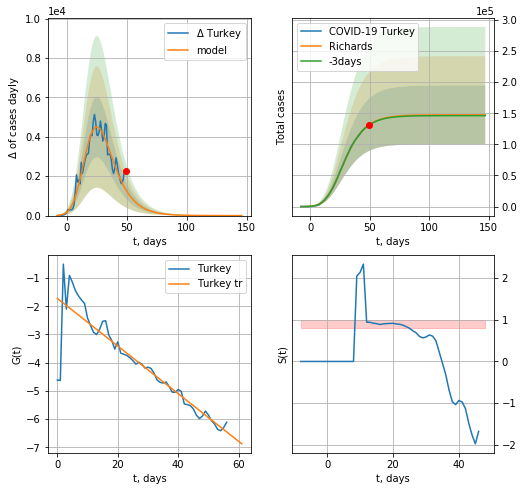

Turkey data at: 2020-05-06
+3 day model MAPE: 0.003366
model: Richards
coeffs: [1.47443057e+05 5.18717060e-01 6.05757097e+00 1.73617378e-01]
rational stdev: 0.319489
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 147440 ± 47105
	 total death: 4011 ± 3844
trend coefficient of determination: 0.822863
 intercept: -1.720707
 slope: -0.084516


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app


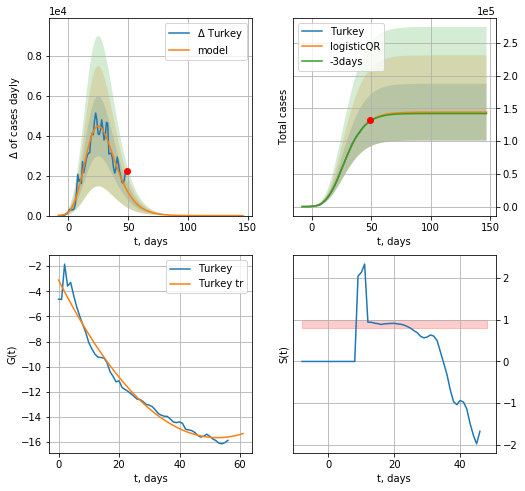

Turkey data at: 2020-05-06
+3 day model MAPE: 0.00563780511776651
model: logisticQR
coeffs:  [ 1.44159317e+05  2.02492059e-02 -4.26084612e+01 -1.30896687e+02
  1.88554047e-02]
rational stdev:  0.3008511125212722
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  144159 ± 43370
	 total death:  3921 ± 3538
trend coefficient of determination: 0.976711
 intercept_: -3.101785936083756
 coeffs_: [ 0.         -0.47705914  0.00453876]


In [168]:
x = forecastRR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


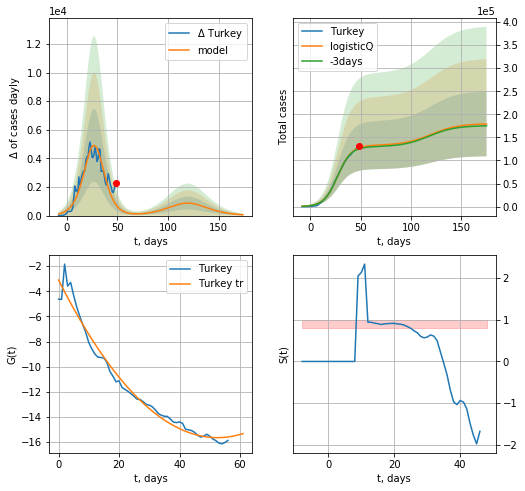

Turkey data at: 2020-05-06
+3 day model MAPE: 0.018775
model: logisticQ
coeffs: [ 1.32834071e+05  2.16263784e-06  2.74955976e+01 -6.82747032e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391508
forecast at the end of period: +126 days
	 deltaDaycases: 58
	 total cases: 179111 ± 70123
	 total death: 4872 ± 5722
trend coefficient of determination: 0.976711
 intercept_: -3.101785936083756
 coeffs_: [ 0.         -0.47705914  0.00453876]


In [169]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [170]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.01888888888888889

In [171]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

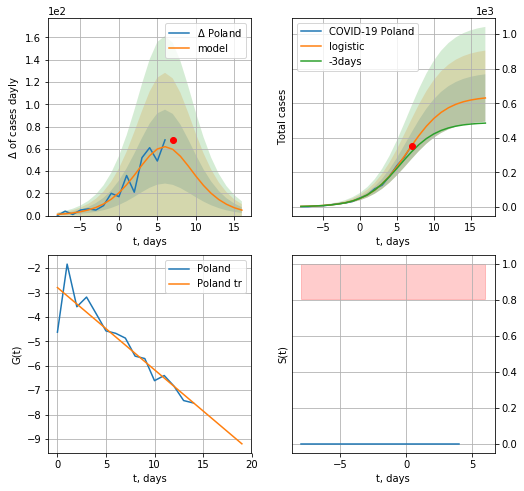

Poland data at: 2020-05-06
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +10 days
	 deltaDaycases:  4
	 total cases:  630 ± 137
	 total death:  31 ± 20
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


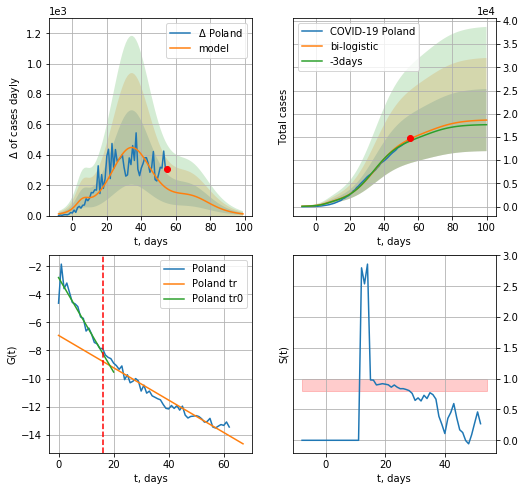

Poland data at: 2020-05-06
+3 day model MAPE: 0.0321939653349517
model: bi-logistic
coeffs:  [1.44733737e+04 1.22373528e-01 3.46963919e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35888132803648715
forecast at the end of period: +45 days
	 deltaDaycases:  11
	 total cases:  18644 ± 6691
	 total death:  927 ± 998
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.941056
 intercept: -6.923392
 slope: -0.115498


In [172]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


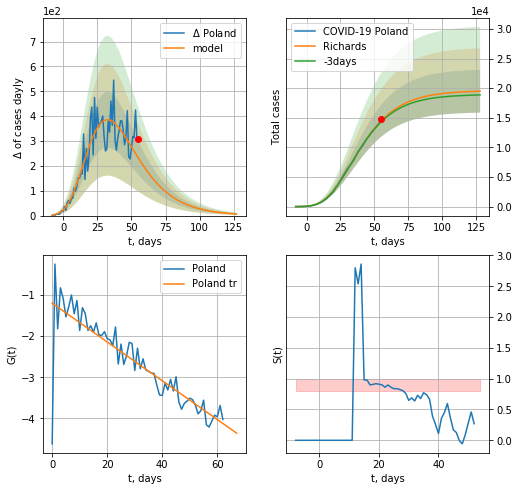

Poland data at: 2020-05-06
+3 day model MAPE: 0.012126
model: Richards
coeffs: [ 1.96150030e+04  3.24492269e+00 -4.30690204e+01  1.66105356e-02]
rational stdev: 0.185612
forecast at the end of period: +73 days
	 deltaDaycases: 6
	 total cases: 19498 ± 3619
	 total death: 969 ± 539
trend coefficient of determination: 0.736780
 intercept: -1.201431
 slope: -0.047087


In [173]:
x =  forecastRR('Poland',dfPL[:],d1,16*7-dT)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


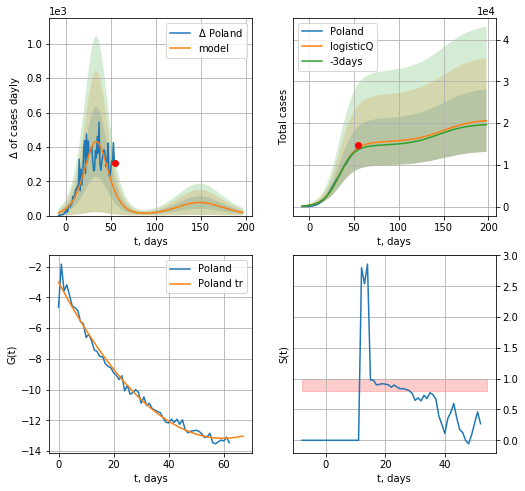

Poland data at: 2020-05-06
+3 day model MAPE: 0.034369
model: logisticQ
coeffs: [ 1.54610512e+04  1.53975044e-06  3.42524430e+01 -7.22929089e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363150
forecast at the end of period: +143 days
	 deltaDaycases: 18
	 total cases: 20601 ± 7481
	 total death: 1024 ± 1115
trend coefficient of determination: 0.984452
 intercept_: -3.0131682136957423
 coeffs_: [ 0.         -0.33993464  0.00284404]


In [174]:
x =  forecastRRR('Poland',dfPL[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
70 2020-05-02  16185.0    6363  229.0
71 2020-05-03  16208.0    6227  232.0
72 2020-05-04  16246.0    5947  235.0
73 2020-05-05  16289.0    5586  238.0
74 2020-05-06  16310.0    5434  239.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


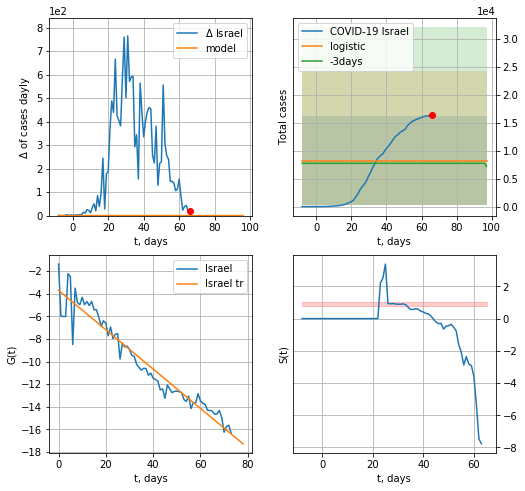

Israel data at: 2020-05-06
+3 day model MAPE: 0.06510703932267628
model: logistic
coeffs:  [ 6.59964093e+03 -3.41431123e+00  1.01181884e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9659947391596179
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  8249 ± 7969
	 total death:  120 ± 347
trend coefficient of determination: 0.931546
 intercept: -3.710107
 slope: -0.173967


In [187]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


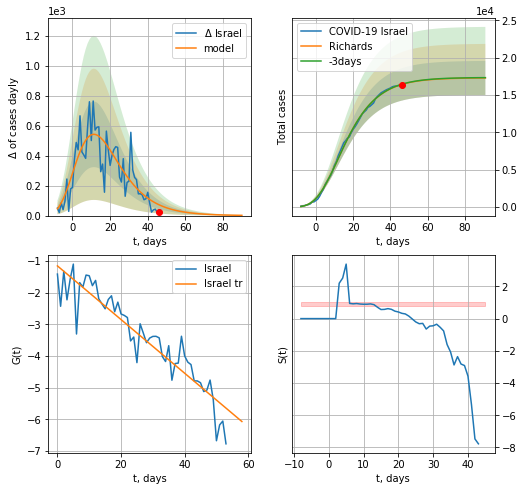

Israel data at: 2020-05-06
+3 day model MAPE: 0.001690
model: Richards
coeffs: [ 1.73146044e+04  7.20554737e+00 -3.98465138e+01  1.19002534e-02]
rational stdev: 0.131701
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 17295 ± 2277
	 total death: 253 ± 99
trend coefficient of determination: 0.864259
 intercept: -1.154210
 slope: -0.084695


In [188]:
x = forecastRR('Israel',dfIS[20:],d1,12*7-dT)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


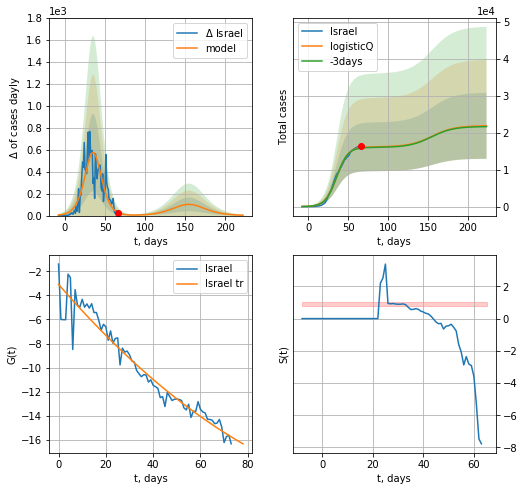

Israel data at: 2020-05-06
+3 day model MAPE: 0.009137
model: logisticQ
coeffs: [ 1.61648141e+04  1.01107530e-06  3.55225955e+01 -1.40666801e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408047
forecast at the end of period: +157 days
	 deltaDaycases: 3
	 total cases: 21846 ± 8914
	 total death: 320 ± 391
trend coefficient of determination: 0.937541
 intercept_: -3.0714858880311535
 coeffs_: [ 0.        -0.227199   0.0007293]


In [189]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


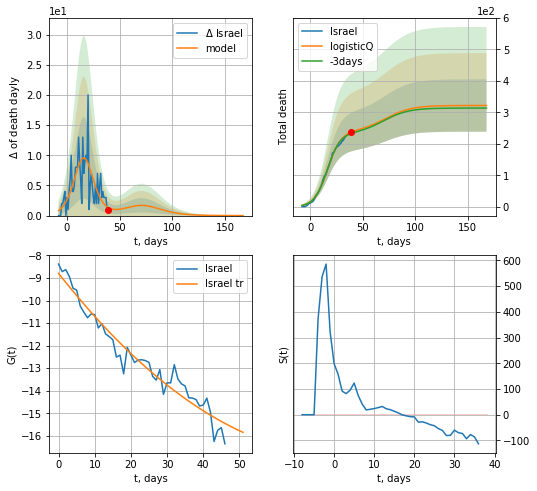

Israel data at: 2020-05-06
+3 day model MAPE: 0.019678
model: logisticQ
coeffs: [ 2.37579547e+02  5.69204124e-06  1.63628563e+01 -2.80548964e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258188
forecast at the end of period: +129 days
	 total death: 321 ± 83
trend coefficient of determination: 0.948007
 intercept_: -8.795657775424033
 coeffs_: [ 0.         -0.20327111  0.00127502]


In [190]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


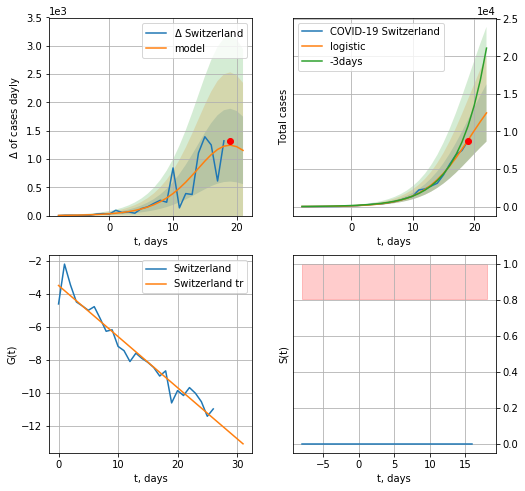

Switzerland data at: 2020-05-06
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +3 days
	 deltaDaycases:  1152
	 total cases:  12470 ± 3816
	 total death:  748 ± 686
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


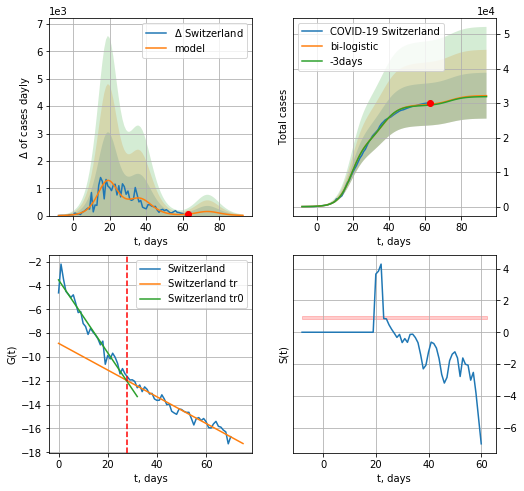

Switzerland data at: 2020-05-06
+3 day model MAPE: 0.007383499838991299
model: bi-logistic
coeffs:  [1.07743734e+04 2.21718038e-01 3.70341560e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.20667133440998903
forecast at the end of period: +31 days
	 deltaDaycases:  7
	 total cases:  32141 ± 6642
	 total death:  1930 ± 1196
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.954012
 intercept: -8.859300
 slope: -0.112046


In [191]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*6-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


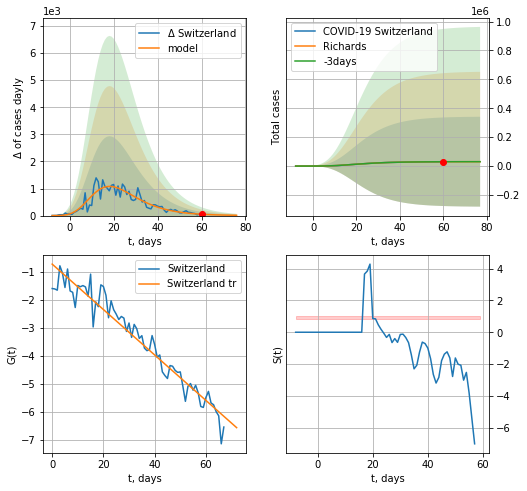

Switzerland data at: 2020-05-06
+3 day model MAPE: 0.001490
model: Richards
coeffs: [ 3.04787582e+04  5.99642608e+00 -2.39177592e+01  1.61708806e-02]
rational stdev: 10.233642
forecast at the end of period: +17 days
	 deltaDaycases: 10
	 total cases: 30372 ± 310825
	 total death: 1823 ± 55967
trend coefficient of determination: 0.937854
 intercept: -0.734907
 slope: -0.081002


In [192]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*8-dT)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


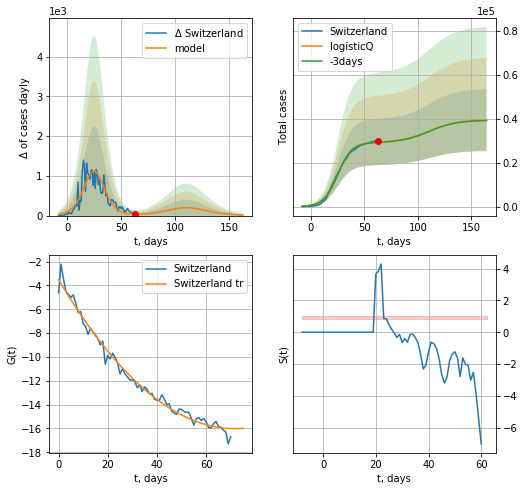

Switzerland data at: 2020-05-06
+3 day model MAPE: 0.006850
model: logisticQ
coeffs: [ 2.92762657e+04  1.06268377e-06  2.54071711e+01 -1.43815538e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358384
forecast at the end of period: +101 days
	 deltaDaycases: 13
	 total cases: 39475 ± 14147
	 total death: 2370 ± 2548
trend coefficient of determination: 0.985297
 intercept_: -3.5087721059475587
 coeffs_: [ 0.         -0.34857428  0.00242889]


In [193]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [194]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
53 2020-05-02  11913.0   10077  288.0
54 2020-05-03  12331.0   10409  303.0
55 2020-05-04  12697.0   10506  316.0
56 2020-05-05  13184.0   10760  327.0
57 2020-05-06  13184.0   10760  327.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

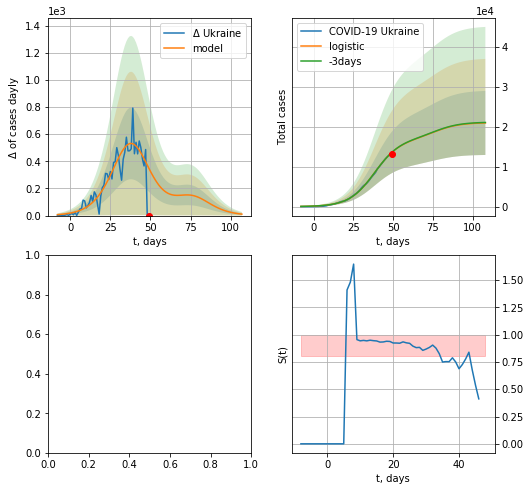

In [195]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in true_divide


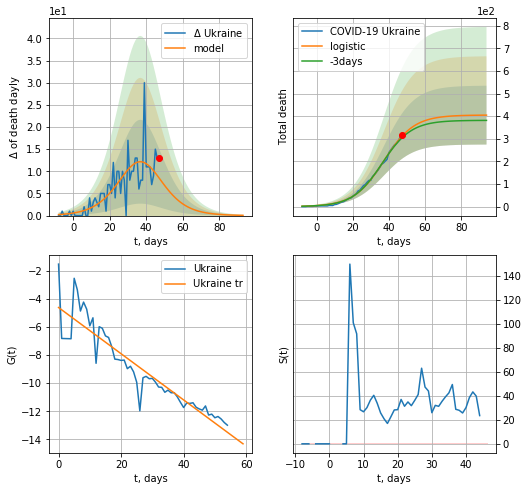

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.02593666550775386
model: logistic
coeffs:  [4.05256236e+02 1.20139382e-01 3.72634727e+01]
rational stdev:  0.321485960917471
forecast at the end of period: +47 days
	 total death:  404 ± 130
trend coefficient of determination: 0.850672
 intercept: -4.600276
 slope: -0.164821


In [634]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


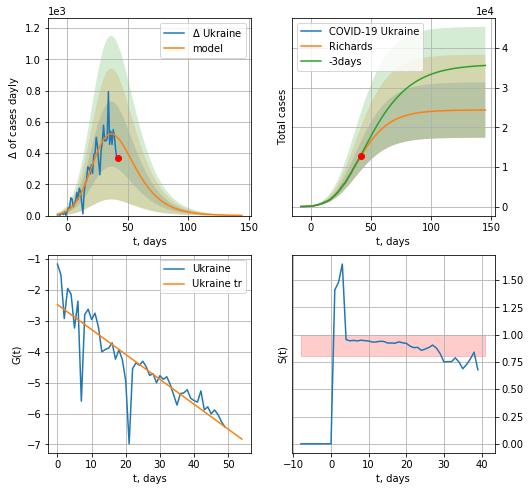

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.029871
model: Richards
coeffs: [2.43704221e+04 2.19216592e-01 1.90562741e+01 3.05241956e-01]
rational stdev: 0.287003
forecast at the end of period: +103 days
	 deltaDaycases: 1
	 total cases: 24352 ± 6989
	 total death: 598 ± 514
trend coefficient of determination: 0.751325
 intercept: -2.474217
 slope: -0.080654


In [635]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*20-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


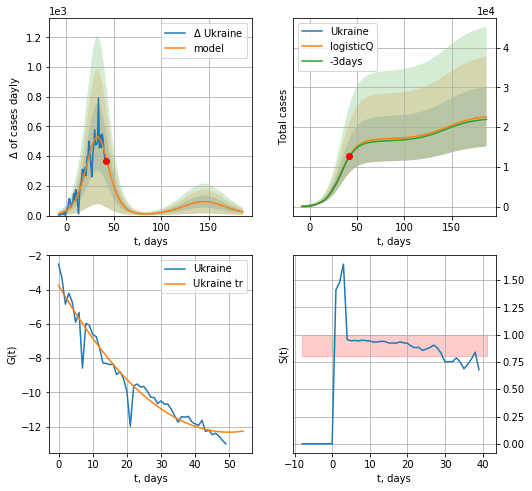

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.013859
model: logisticQ
coeffs: [ 1.70017450e+04  6.73529045e-06  3.33744741e+01 -1.84650694e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333034
forecast at the end of period: +145 days
	 deltaDaycases: 24
	 total cases: 22607 ± 7528
	 total death: 555 ± 554
trend coefficient of determination: 0.940979
 intercept_: -3.7464061957209216
 coeffs_: [ 0.         -0.34359632  0.00344419]


In [636]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*26-dT,addpred=True,xcoef=koreaCoeffs)

In [637]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

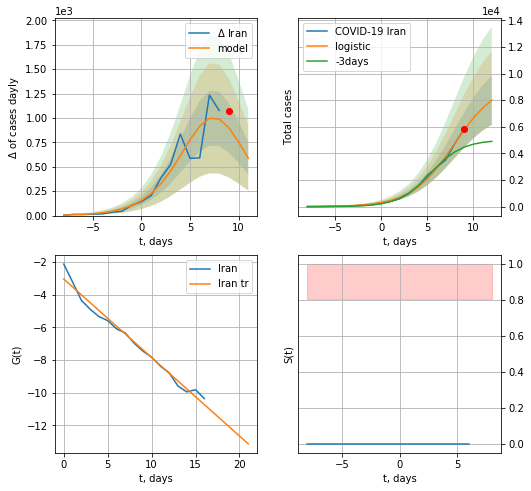

Iran data at: 2020-05-06
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +3 days
	 deltaDaycases:  589
	 total cases:  7994 ± 1836
	 total death:  504 ± 347
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


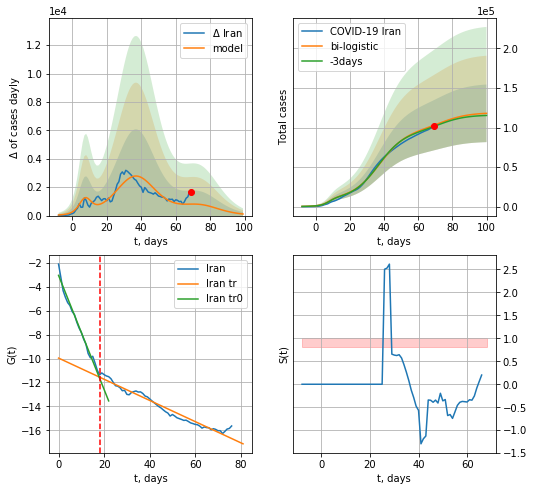

Iran data at: 2020-05-06
+3 day model MAPE: 0.014942735136163612
model: bi-logistic
coeffs:  [8.75474035e+04 1.26239591e-01 3.72228921e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.308796068264169
forecast at the end of period: +31 days
	 deltaDaycases:  111
	 total cases:  117952 ± 36423
	 total death:  7447 ± 6898
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.959280
 intercept: -9.964452
 slope: -0.088346


In [196]:
x = forecast('Iran',dfIN[:18],d1,6*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


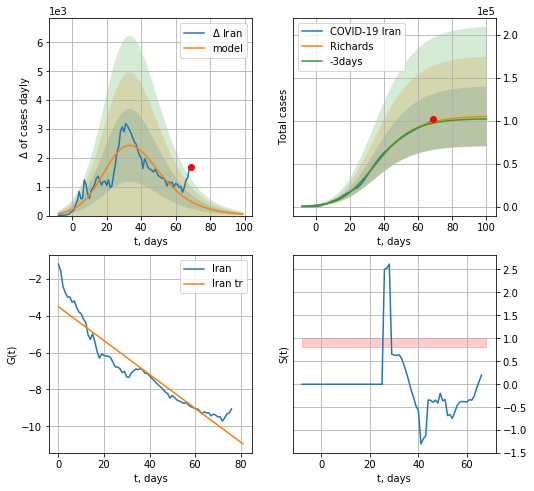

Iran data at: 2020-05-06
+3 day model MAPE: 0.015658
model: Richards
coeffs: [1.05633927e+05 1.76202076e-01 2.26081738e+01 4.29426948e-01]
rational stdev: 0.330735
forecast at the end of period: +31 days
	 deltaDaycases: 54
	 total cases: 104933 ± 34705
	 total death: 6625 ± 6573
trend coefficient of determination: 0.896608
 intercept: -3.516766
 slope: -0.091726


In [197]:
x = forecastRR('Iran',dfIN[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


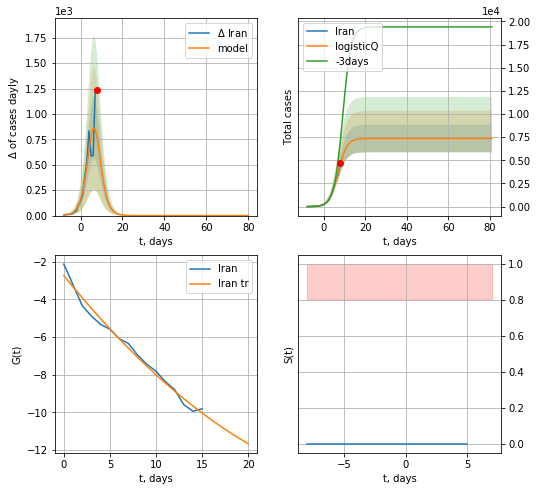

Iran data at: 2020-05-06
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +73 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 465 ± 283
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


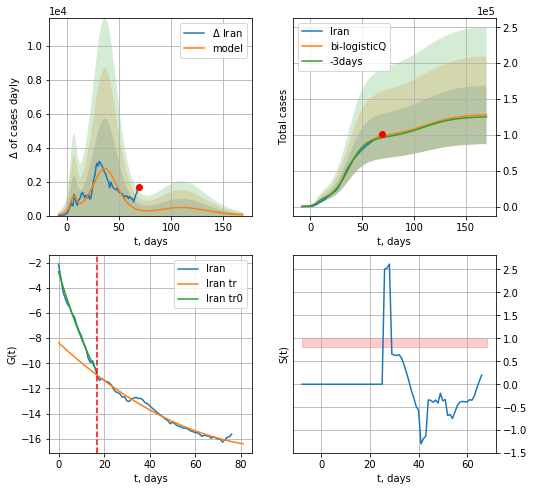

Iran data at: 2020-05-06
+3 day model MAPE: 0.020328
model: bi-logisticQ
coeffs: [ 9.00243167e+04  8.70104423e-07  3.68643313e+01 -1.39462033e+05]
S.Korea scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.318782
forecast at the end of period: +101 days
	 deltaDaycases: 50
	 total cases: 128070 ± 40826
	 total death: 8086 ± 7733
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.980586
 intercept_: -8.37009758776474
 coeffs_: [ 0.         -0.1664835   0.00083151]


In [198]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date     cases  active   death
63 2020-05-02  124054.0  107819  1222.0
64 2020-05-03  134687.0  116768  1280.0
65 2020-05-04  145268.0  125817  1356.0
66 2020-05-05  155370.0  134054  1451.0
67 2020-05-06  165929.0  143065  1537.0


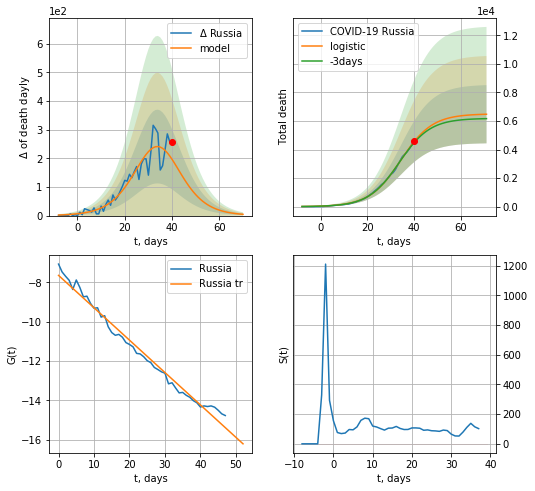

Russia data at: 2020-05-06
+3 day model MAPE: 0.018513107044871583
model: logistic
coeffs:  [6.49770697e+03 1.48380816e-01 3.42794648e+01]
rational stdev:  0.31499318242661933
forecast at the end of period: +31 days
	 total death:  6469 ± 2037
trend coefficient of determination: 0.982961
 intercept: -7.651090
 slope: -0.164624


In [199]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

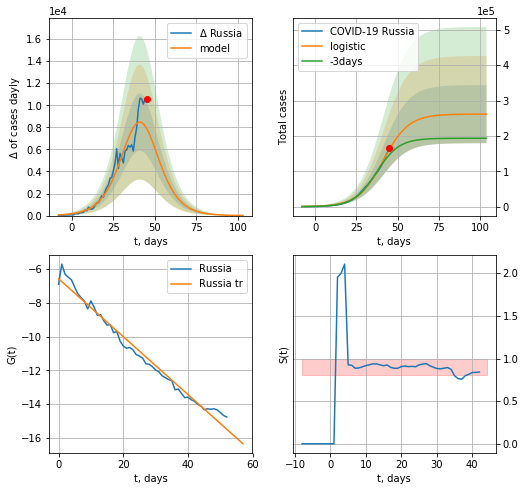

Russia data at: 2020-05-06
+3 day model MAPE: 0.11451858296968065
model: logistic
coeffs:  [2.61661231e+05 1.29658823e-01 4.13599634e+01]
rational stdev:  0.31429664632518994
forecast at the end of period: +59 days
	 deltaDaycases:  10
	 total cases:  261583 ± 82214
	 total death:  2423 ± 2284
trend coefficient of determination: 0.980561
 intercept: -6.570196
 slope: -0.171804


In [200]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


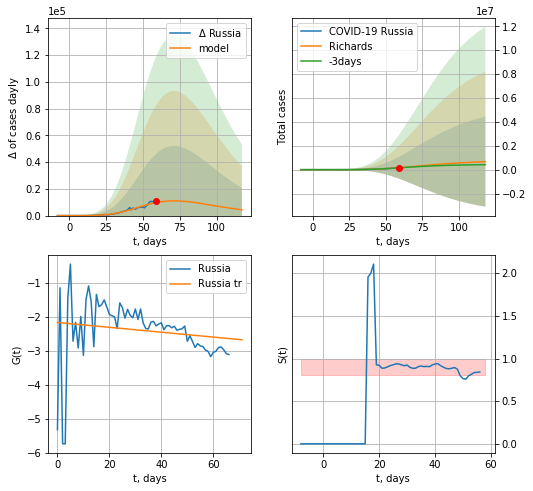

Russia data at: 2020-05-06
+3 day model MAPE: 0.059101
model: Richards
coeffs: [ 7.90666905e+05  1.30540084e+00 -2.03729657e+01  2.94088196e-02]
rational stdev: 5.622346
forecast at the end of period: +59 days
	 deltaDaycases: 4353
	 total cases: 668885 ± 3760703
	 total death: 6195 ± 104491
trend coefficient of determination: 0.023942
 intercept: -2.163713
 slope: -0.007191


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


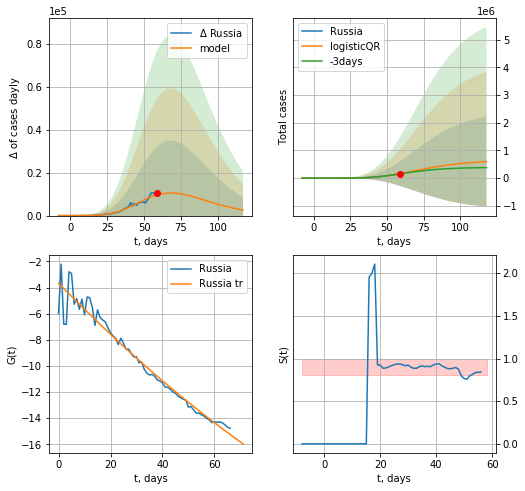

Russia data at: 2020-05-06
+3 day model MAPE: 0.06026435042656741
model: logisticQR
coeffs:  [ 6.44152210e+05  1.43229119e-02 -1.17198308e+02 -2.34527163e+02
  6.38757942e-03]
rational stdev:  2.727017720944515
forecast at the end of period: +59 days
	 deltaDaycases:  2600
	 total cases:  594950 ± 1622439
	 total death:  5511 ± 45085
trend coefficient of determination: 0.954057
 intercept_: -3.6648768782941836
 coeffs_: [ 0.         -0.20424305  0.00043674]


In [201]:
x = forecastRR('Russia',dfRS[:],d1,14*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[:],d1,14*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


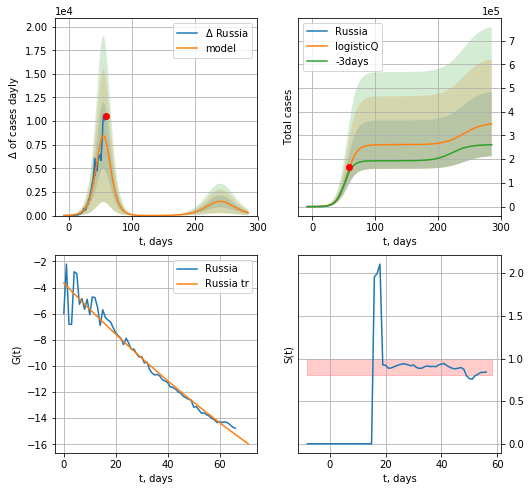

Russia data at: 2020-05-06
+3 day model MAPE: 0.114764
model: logisticQ
coeffs: [ 2.61027636e+05  5.84020844e-06  5.53216968e+01 -2.21833005e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.390622
forecast at the end of period: +227 days
	 deltaDaycases: 299
	 total cases: 348776 ± 136239
	 total death: 3230 ± 3785
trend coefficient of determination: 0.954057
 intercept_: -3.6648768782941836
 coeffs_: [ 0.         -0.20424305  0.00043674]


In [202]:
x = forecastRRR('Russia',dfRS[:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

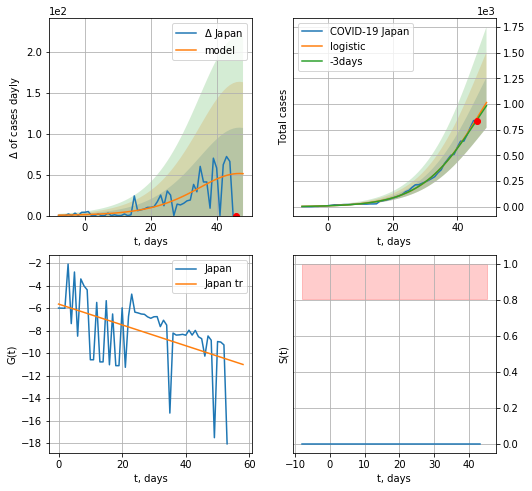

Japan data at: 2020-05-06
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +3 days
	 deltaDaycases:  51
	 total cases:  1014 ± 245
	 total death:  36 ± 26
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

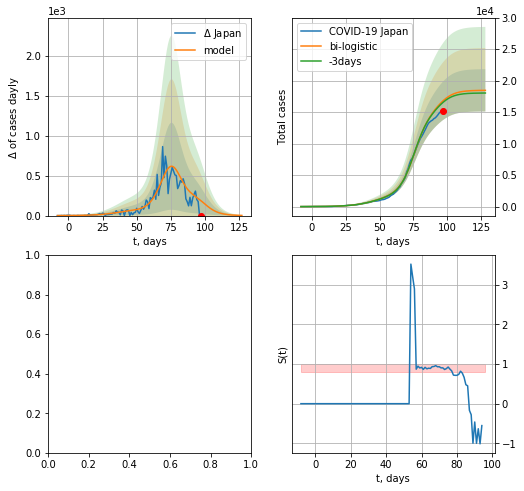

In [203]:
x = forecast('Japan',dfJP[:55],d1,6*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:644: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

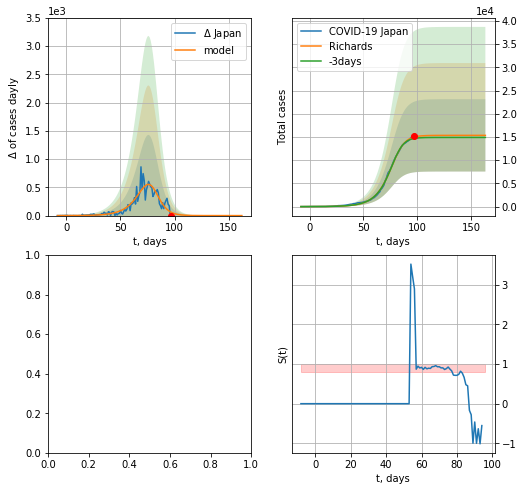

In [204]:
x = forecastRR('Japan',dfJP[:],d1,15*7-dT)

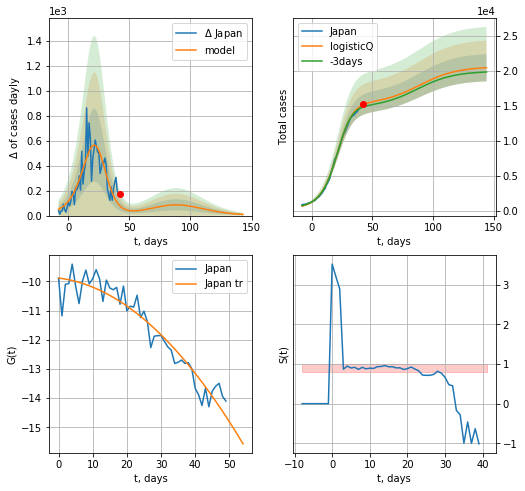

Japan data at: 2020-05-05
+3 day model MAPE: 0.022423
model: logisticQ
coeffs: [ 1.52176113e+04  1.15837760e-03  2.02548211e+01 -1.05375524e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.095258
forecast at the end of period: +102 days
	 deltaDaycases: 9
	 total cases: 20472 ± 1950
	 total death: 746 ± 213
trend coefficient of determination: 0.918489
 intercept_: -9.886611161935987
 coeffs_: [ 0.         -0.01437823 -0.00168034]


In [200]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


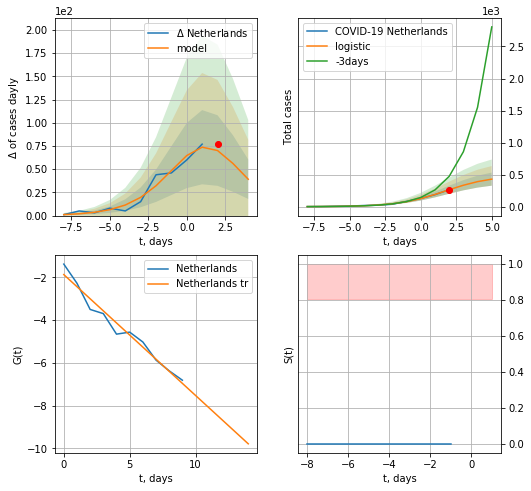

Netherlands data at: 2020-05-06
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +3 days
	 deltaDaycases:  39
	 total cases:  429 ± 102
	 total death:  54 ± 38
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:230: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


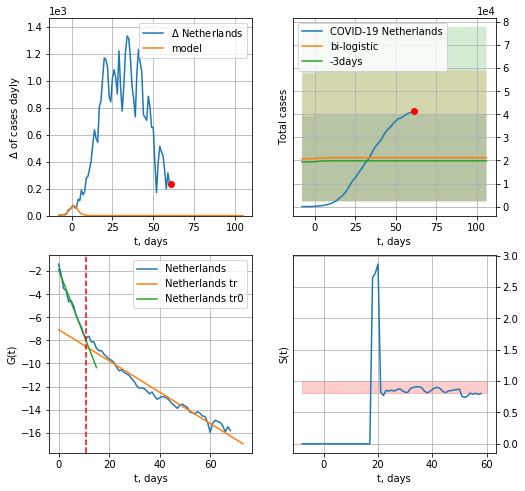

Netherlands data at: 2020-05-06
+3 day model MAPE: 0.06773609328121766
model: bi-logistic
coeffs:  [ 1.65582671e+04 -3.79080528e+00  1.22288577e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8922909749850803
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  21185 ± 18903
	 total death:  2668 ± 7141
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.962737
 intercept: -7.057189
 slope: -0.135694


In [205]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
65 2020-05-02  40236   34999  4987.0
66 2020-05-03  40571   35265  5056.0
67 2020-05-04  40770   35438  5082.0
68 2020-05-05  41087   35669  5168.0
69 2020-05-06  41319   35865  5204.0


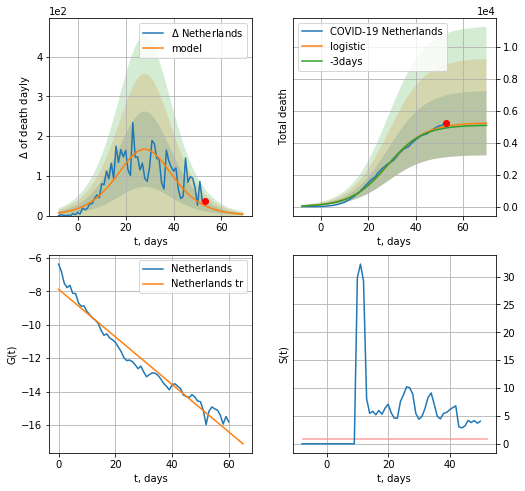

Netherlands data at: 2020-05-06
+3 day model MAPE: 0.021233844784755575
model: logistic
coeffs:  [5.24606406e+03 1.27608445e-01 2.84446476e+01]
rational stdev:  0.38490615931802336
forecast at the end of period: +17 days
	 total death:  5220 ± 2009
trend coefficient of determination: 0.958331
 intercept: -7.884049
 slope: -0.142064


In [206]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,8*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


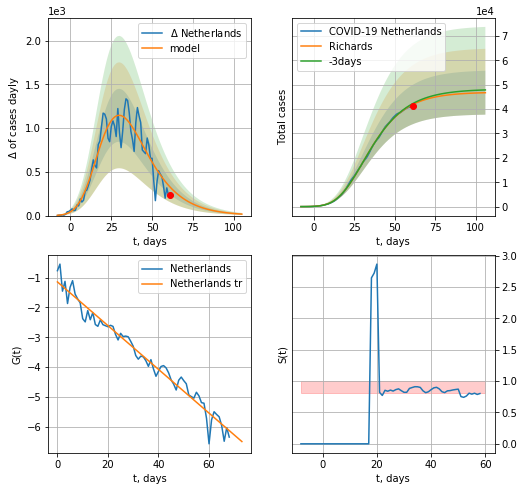

Netherlands data at: 2020-05-06
+3 day model MAPE: 0.009661
model: Richards
coeffs: [ 4.69534352e+04  6.41784483e-01 -1.36086977e+00  1.09084552e-01]
rational stdev: 0.192564
forecast at the end of period: +45 days
	 deltaDaycases: 16
	 total cases: 46719 ± 8996
	 total death: 5884 ± 3399
trend coefficient of determination: 0.967587
 intercept: -1.144400
 slope: -0.073232


In [207]:
x = forecastRR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


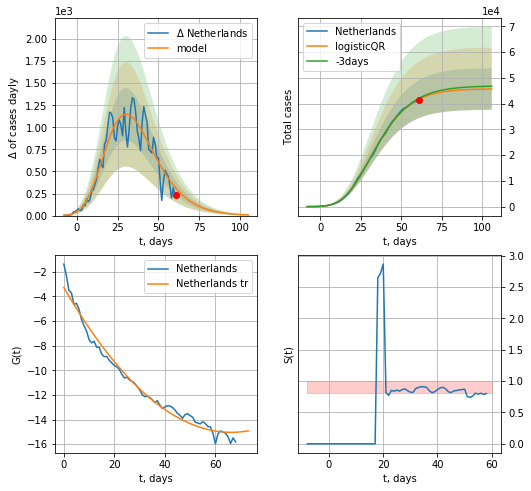

Netherlands data at: 2020-05-06
+3 day model MAPE: 0.00858858214615257
model: logisticQR
coeffs:  [ 4.57176100e+04  3.14272365e-02 -8.77952022e+01 -1.63558654e+02
  7.00096611e-03]
rational stdev:  0.17614552200000078
forecast at the end of period: +45 days
	 deltaDaycases:  7
	 total cases:  45651 ± 8041
	 total death:  5749 ± 3037
trend coefficient of determination: 0.979915
 intercept_: -3.282972647998113
 coeffs_: [ 0.         -0.35457448  0.00267369]


In [208]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


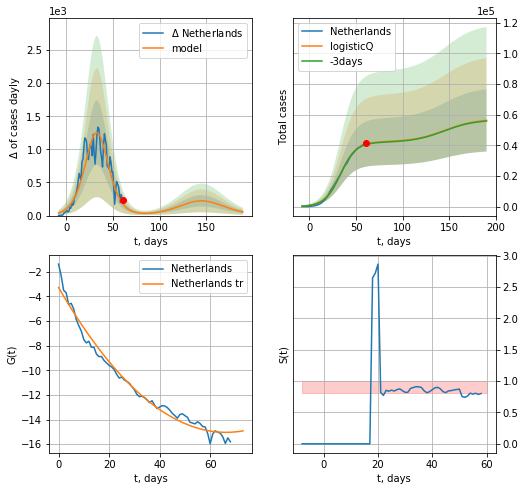

Netherlands data at: 2020-05-06
+3 day model MAPE: 0.007113
model: logisticQ
coeffs: [ 4.22421328e+04  1.36580458e-06  3.32845528e+01 -8.67395145e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361262
forecast at the end of period: +129 days
	 deltaDaycases: 55
	 total cases: 56241 ± 20317
	 total death: 7083 ± 7676
trend coefficient of determination: 0.979915
 intercept_: -3.282972647998113
 coeffs_: [ 0.         -0.35457448  0.00267369]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


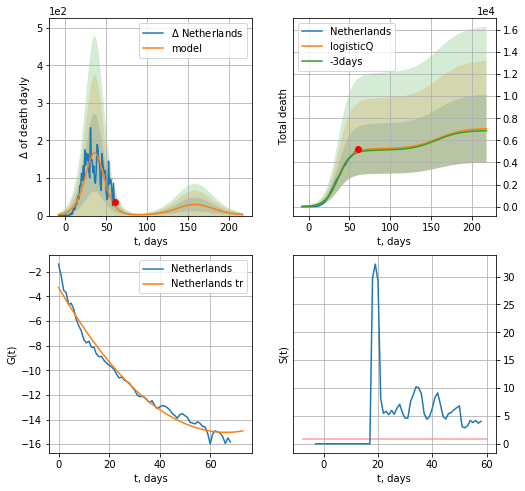

Netherlands data at: 2020-05-06
+3 day model MAPE: 0.021356
model: logisticQ
coeffs: [ 5.24264272e+03  1.35845583e-06  3.64320521e+01 -9.40492410e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434958
forecast at the end of period: +157 days
	 total death: 7059 ± 3070
trend coefficient of determination: 0.979915
 intercept_: -3.282972647998113
 coeffs_: [ 0.         -0.35457448  0.00267369]


In [209]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [210]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


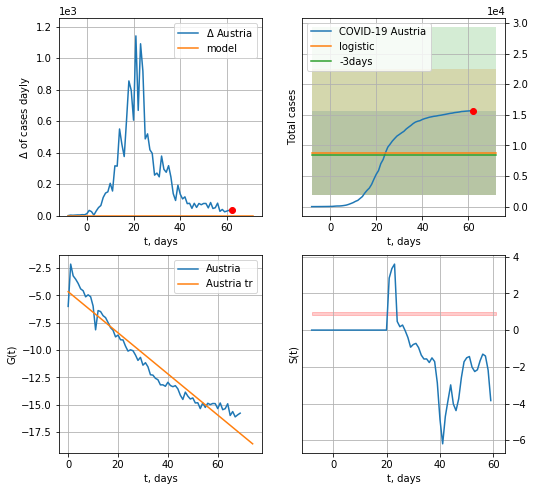

Austria data at: 2020-05-06
+3 day model MAPE: 0.040723982696297435
model: logistic
coeffs:  [ 8.29466212e+03 -2.90088396e+00  1.07797780e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.7767728322015179
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  8813 ± 6845
	 total death:  341 ± 794
trend coefficient of determination: 0.932364
 intercept: -4.654512
 slope: -0.188532


In [211]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


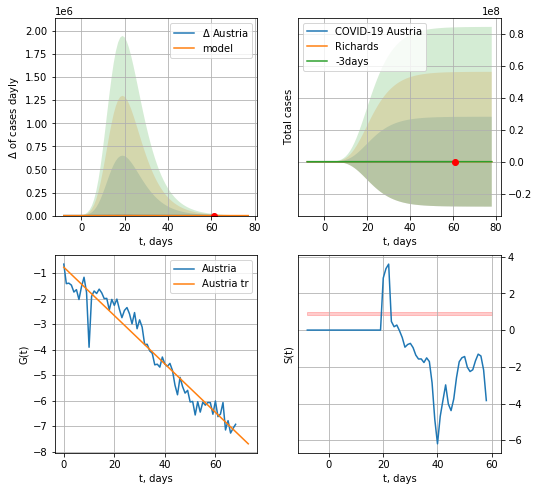

Austria data at: 2020-05-06
+3 day model MAPE: 0.005202
model: Richards
coeffs: [1.54357451e+04 1.65866446e+00 1.25236387e+00 8.23340465e-02]
rational stdev: 1821.029799
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 15430 ± 28099372
	 total death: 598 ± 3266927
trend coefficient of determination: 0.939142
 intercept: -0.767265
 slope: -0.094898


In [212]:
x = forecastRR('Austria',dfAT[1:],d1,8*7-dT,addpred=False,xcoef=[0.25,1.,2.2,1.])
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


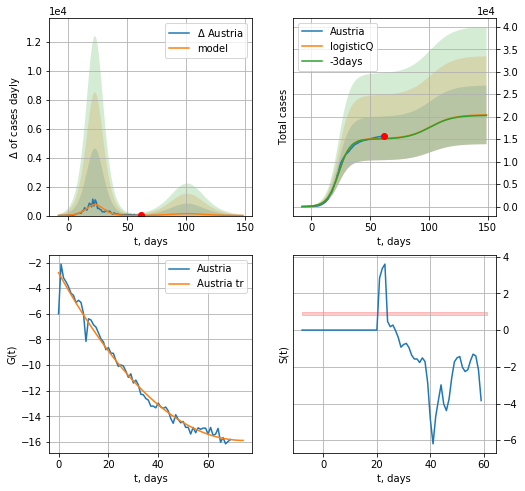

Austria data at: 2020-05-06
+3 day model MAPE: 0.006560
model: logisticQ
coeffs: [ 1.50982534e+04  1.37460043e-06  2.32352627e+01 -1.46999319e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319599
forecast at the end of period: +87 days
	 deltaDaycases: 4
	 total cases: 20404 ± 6521
	 total death: 790 ± 757
trend coefficient of determination: 0.980789
 intercept_: -2.797209121522714
 coeffs_: [ 0.         -0.3524372   0.00237561]


In [213]:
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


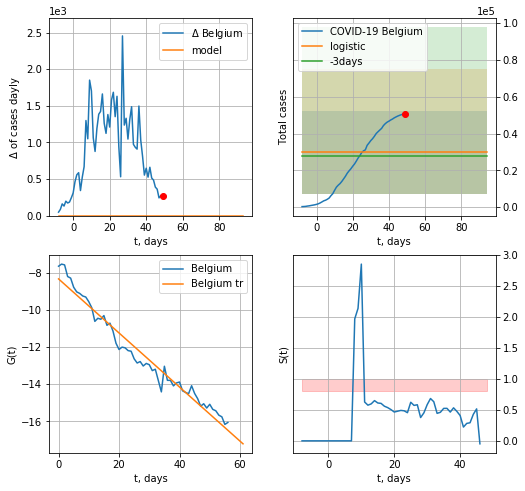

Belgium data at: 2020-05-06
+3 day model MAPE: 0.06508649498065809
model: logistic
coeffs:  [ 2.38259655e+04 -4.94819585e+00  1.87649243e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.7629150220033916
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  29782 ± 22721
	 total death:  4890 ± 11191
trend coefficient of determination: 0.963391
 intercept: -8.331586
 slope: -0.145651


In [214]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
62 2020-05-02  49517   29541  7765.0
63 2020-05-03  49906   29753  7844.0
64 2020-05-04  50267   29965  7924.0
65 2020-05-05  50509   30052  8016.0
66 2020-05-06  50781   29711  8339.0


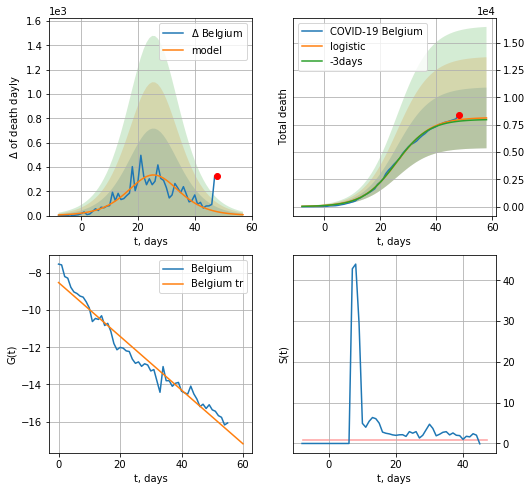

Belgium data at: 2020-05-06
+3 day model MAPE: 0.017386942473851853
model: logistic
coeffs:  [8.15103234e+03 1.64217887e-01 2.59266538e+01]
rational stdev:  0.3420546468974136
forecast at the end of period: +10 days
	 total death:  8109 ± 2773
trend coefficient of determination: 0.962305
 intercept: -8.526019
 slope: -0.144320


In [215]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


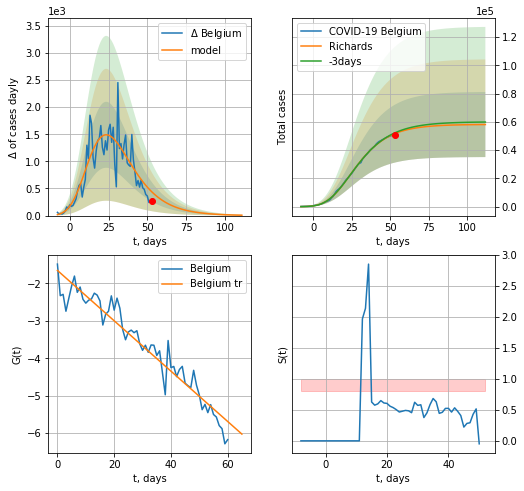

Belgium data at: 2020-05-06
+3 day model MAPE: 0.011493
model: Richards
coeffs: [ 5.81637214e+04  8.33953316e-01 -9.60351289e+00  8.71699205e-02]
rational stdev: 0.396393
forecast at the end of period: +59 days
	 deltaDaycases: 7
	 total cases: 58067 ± 23017
	 total death: 9535 ± 11338
trend coefficient of determination: 0.928064
 intercept: -1.651443
 slope: -0.067287


In [216]:
x = forecastRR('Belgium',dfBG[5:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


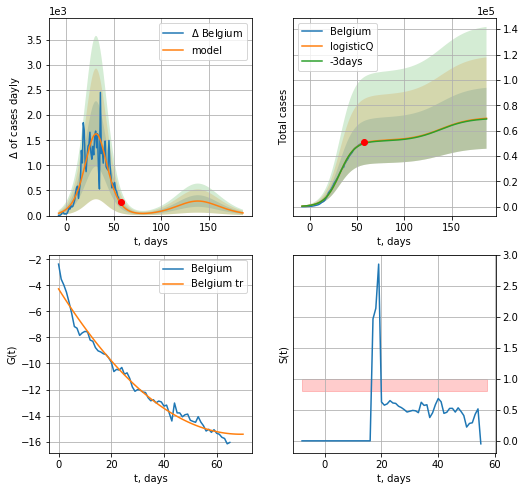

Belgium data at: 2020-05-06
+3 day model MAPE: 0.007028
model: logisticQ
coeffs: [ 5.20994750e+04  1.65403120e-06  3.18901408e+01 -7.55308329e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.344945
forecast at the end of period: +129 days
	 deltaDaycases: 53
	 total cases: 69691 ± 24039
	 total death: 11444 ± 11842
trend coefficient of determination: 0.978138
 intercept_: -4.269812922821853
 coeffs_: [ 0.         -0.32259807  0.00233035]


In [217]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

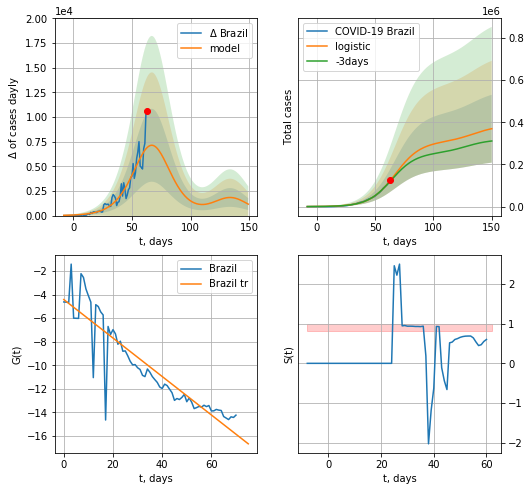

Brazil data at: 2020-05-06
+3 day model MAPE: 0.032615380254379614
model: logistic
coeffs:  [3.07744980e+05 9.26034903e-02 6.73336714e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.43567866538024336
forecast at the end of period: +87 days
	 deltaDaycases:  1162
	 total cases:  369557 ± 161008
	 total death:  25067 ± 32763
trend coefficient of determination: 0.830217
 intercept: -4.422744
 slope: -0.163119


In [218]:
x = forecast('Brazil',dfBZ[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


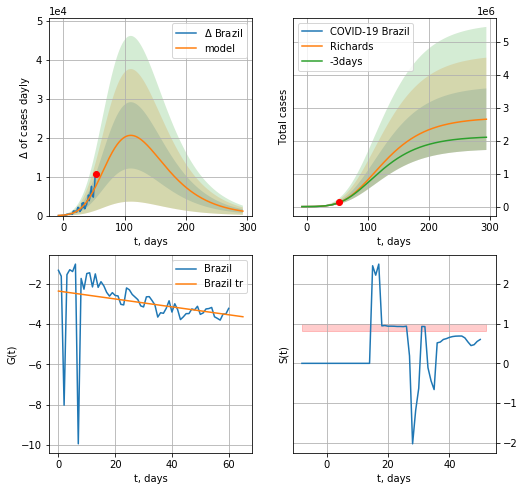

Brazil data at: 2020-05-06
+3 day model MAPE: 0.014280
model: Richards
coeffs: [ 2.70554299e+06  3.31604819e-01 -1.81365889e+01  6.43068797e-02]
rational stdev: 0.352075
forecast at the end of period: +241 days
	 deltaDaycases: 1141
	 total cases: 2652005 ± 933704
	 total death: 179885 ± 189999
trend coefficient of determination: 0.065783
 intercept: -2.372569
 slope: -0.019576


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


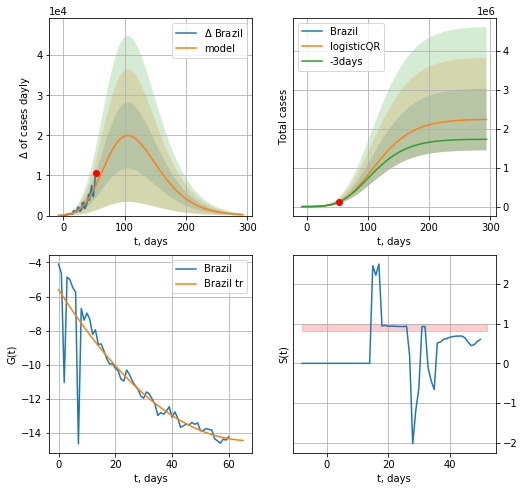

Brazil data at: 2020-05-06
+3 day model MAPE: 0.012586930148744263
model: logisticQR
coeffs:  [ 2.24459499e+06  2.84662274e-03 -2.66406134e+02 -2.71113522e+02
  1.14903815e-02]
rational stdev:  0.3541584027211251
forecast at the end of period: +241 days
	 deltaDaycases:  231
	 total cases:  2238407 ± 792750
	 total death:  151830 ± 161315
trend coefficient of determination: 0.813449
 intercept_: -5.588099530268223
 coeffs_: [ 0.         -0.2623553   0.00194148]


In [219]:
x = forecastRR('Brazil',dfBZ[10:],d1,40*7-dT)
x = forecastQR('Brazil',dfBZ[10:],d1,40*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


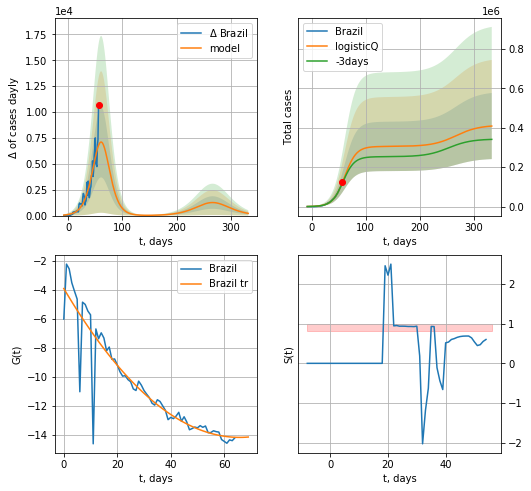

Brazil data at: 2020-05-06
+3 day model MAPE: 0.032933
model: logisticQ
coeffs: [ 3.05393560e+05  8.62432138e-06  6.11764353e+01 -1.07281489e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410168
forecast at the end of period: +276 days
	 deltaDaycases: 213
	 total cases: 408865 ± 167703
	 total death: 27733 ± 34125
trend coefficient of determination: 0.848352
 intercept_: -3.91285535158518
 coeffs_: [ 0.        -0.312529   0.0023747]


In [220]:
x = forecastRRR('Brazil',dfBZ[6:],d1,45*7-dT,addpred=True,xcoef=koreaCoeffs)

In [221]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

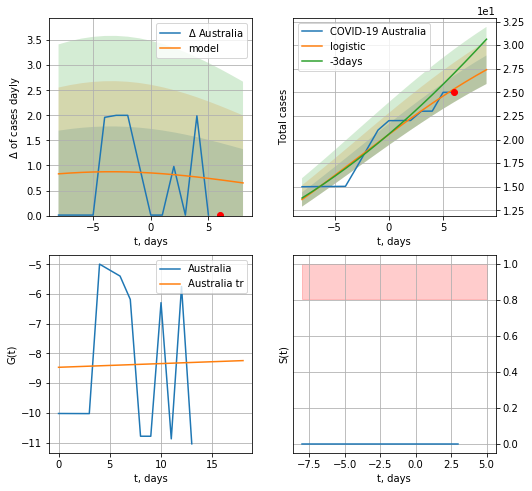

Australia data at: 2020-05-06
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  27 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


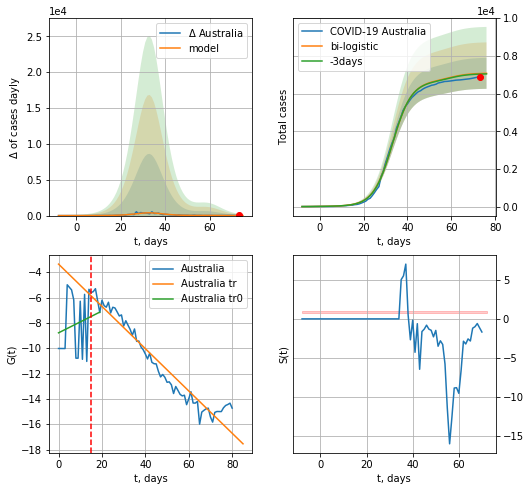

Australia data at: 2020-05-06
+3 day model MAPE: 0.004324072643213304
model: bi-logistic
coeffs:  [6.63178427e+03 2.30706943e-01 3.32065207e+01] [35.98153551  0.09728993 -2.93367767]
scenario coeffs:  [0.0625, 1.0, 1.8]
rational stdev:  0.11594011508502804
forecast at the end of period: +3 days
	 deltaDaycases:  2
	 total cases:  7072 ± 819
	 total death:  99 ± 34
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.937700
 intercept: -3.361860
 slope: -0.166895


In [222]:
x = forecast('Australia',dfAS[:15],d1,6*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,6*7-dT,x,vL=15,addpred=True,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


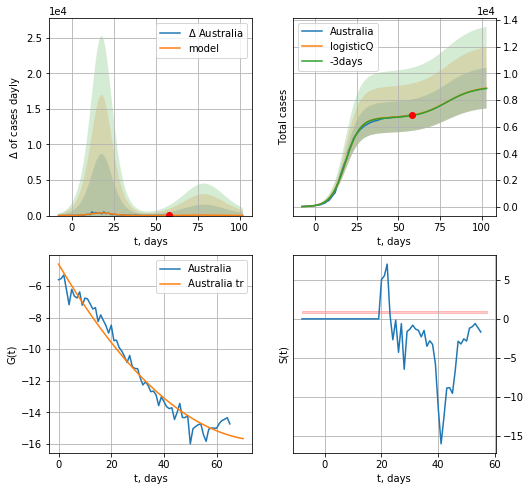

Australia data at: 2020-05-06
+3 day model MAPE: 0.004250
model: logisticQ
coeffs: [ 6.67152050e+03  2.60299660e-06  1.81527199e+01 -8.75261420e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.171797
forecast at the end of period: +45 days
	 deltaDaycases: 16
	 total cases: 8890 ± 1527
	 total death: 125 ± 64
trend coefficient of determination: 0.969532
 intercept_: -4.615836664453186
 coeffs_: [ 0.         -0.28405413  0.00180264]


In [223]:
x = forecastRRR('Australia',dfAS[15:],d1,12*7-dT,addpred=True,xcoef=koreaCoeffs)

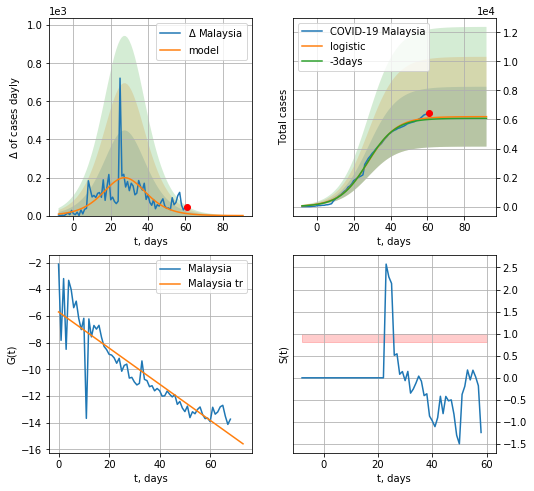

Malaysia data at: 2020-05-06
+3 day model MAPE: 0.01708116880551476
model: logistic
coeffs:  [6.19300944e+03 1.28560426e-01 2.79092171e+01]
rational stdev:  0.3326804409508849
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  6191 ± 2059
	 total death:  103 ± 102
trend coefficient of determination: 0.803279
 intercept: -5.700163
 slope: -0.135275


In [224]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

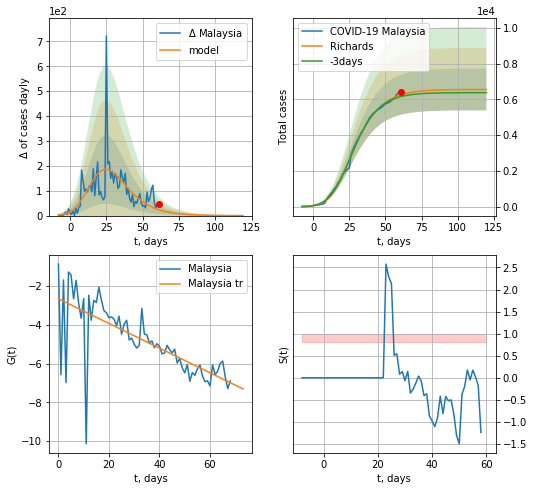

Malaysia data at: 2020-05-06
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 6555 ± 1166
	 total death: 109 ± 58
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


In [225]:
x = forecastRR('Malaysia',dfML[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


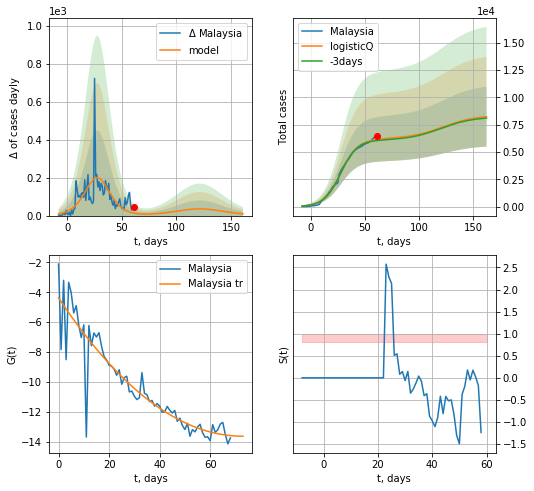

Malaysia data at: 2020-05-06
+3 day model MAPE: 0.017147
model: logisticQ
coeffs: [ 6.19268433e+03  1.27935329e-06  2.79088945e+01 -1.00443590e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332777
forecast at the end of period: +101 days
	 deltaDaycases: 9
	 total cases: 8235 ± 2740
	 total death: 137 ± 136
trend coefficient of determination: 0.845786
 intercept_: -4.375118545571758
 coeffs_: [ 0.         -0.253955    0.00174543]


In [226]:
x = forecastRRR('Malaysia',dfML[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date   cases  active  death
64 2020-05-02  1487.0     201   20.0
65 2020-05-03  1487.5     191   20.0
66 2020-05-04  1487.8     164   20.0
67 2020-05-05  1488.0     151   21.0
68 2020-05-06  1489.0     136   21.0


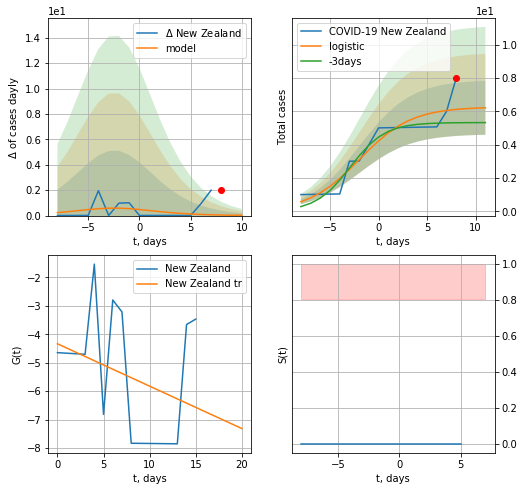

New Zealand data at: 2020-05-06
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


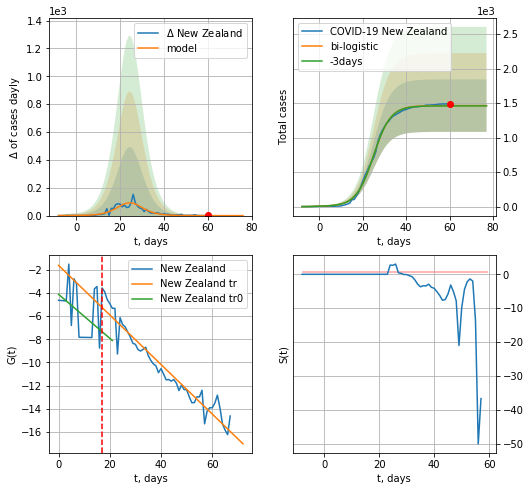

New Zealand data at: 2020-05-06
+3 day model MAPE: 0.0028130648516262336
model: bi-logistic
coeffs:  [1.45767840e+03 2.52368222e-01 2.48983718e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.25970903078635477
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  1463 ± 380
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.931312
 intercept: -1.638422
 slope: -0.213414


In [228]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

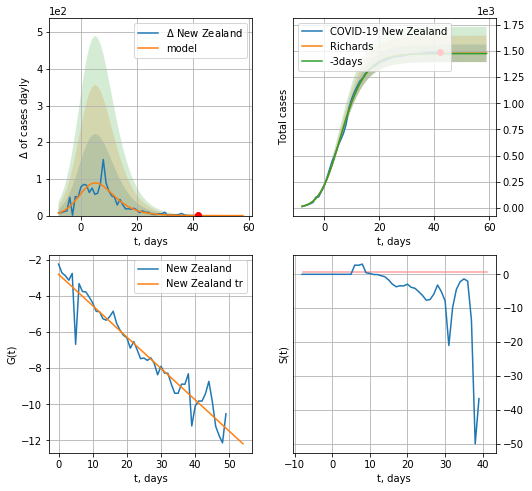

New Zealand data at: 2020-05-06
+3 day model MAPE: 0.001937
model: Richards
coeffs: [1.47793296e+03 4.52800453e-01 1.51625048e+00 4.40491217e-01]
rational stdev: 0.056850
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 1477 ± 84
	 total death: 20 ± 3
trend coefficient of determination: 0.928810
 intercept: -2.800444
 slope: -0.173815


In [229]:
x = forecastRR('New Zealand',dfZL[18:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


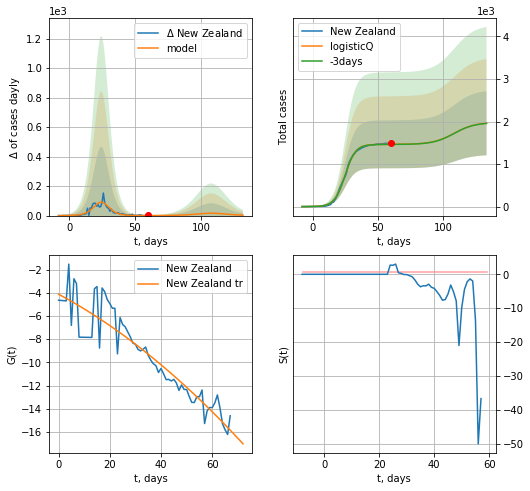

New Zealand data at: 2020-05-06
+3 day model MAPE: 0.002765
model: logisticQ
coeffs: [ 1.46465199e+03  3.93717516e-06  2.48555516e+01 -6.34066356e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384761
forecast at the end of period: +73 days
	 deltaDaycases: 2
	 total cases: 1960 ± 754
	 total death: 27 ± 31
trend coefficient of determination: 0.862050
 intercept_: -4.125360689125544
 coeffs_: [ 0.         -0.1182627  -0.00084629]


In [230]:
x = forecastRRR('New Zealand',dfZL[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
64 2020-05-02  15828.0   12614   97.0
65 2020-05-03  16705.0   13410   99.0
66 2020-05-04  17489.0   14127  103.0
67 2020-05-05  18350.0   14472  107.0
68 2020-05-06  19255.0   14755  112.0


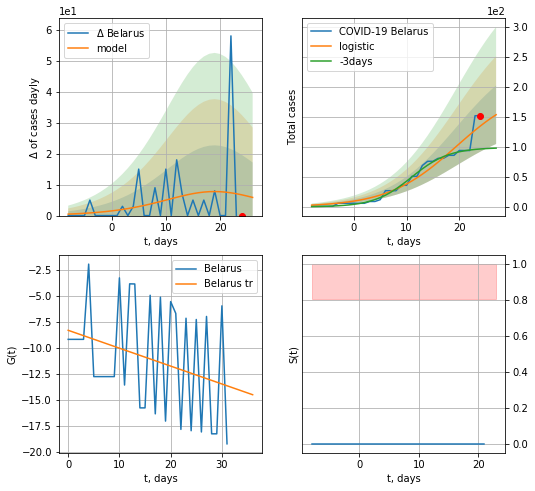

Belarus data at: 2020-05-06
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +3 days
	 deltaDaycases:  5
	 total cases:  153 ± 48
	 total death:  0 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


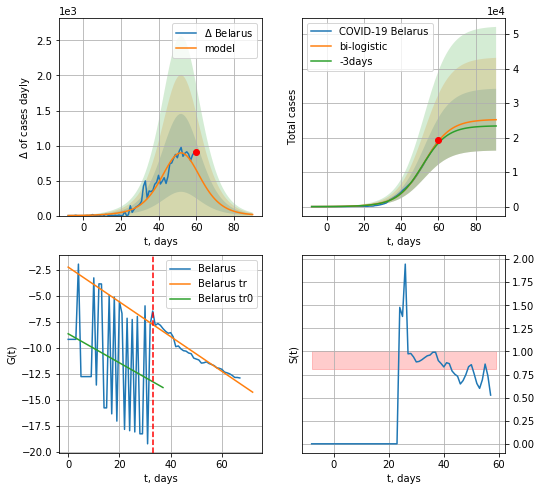

Belarus data at: 2020-05-06
+3 day model MAPE: 0.03394475898048606
model: bi-logistic
coeffs:  [2.50846692e+04 1.42931708e-01 5.24117540e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.35594185035155446
forecast at the end of period: +31 days
	 deltaDaycases:  15
	 total cases:  25185 ± 8964
	 total death:  146 ± 155
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.945407
 intercept: -2.263364
 slope: -0.167052


In [231]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,6*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
64 2020-05-02  15828.0   12614   97.0
65 2020-05-03  16705.0   13410   99.0
66 2020-05-04  17489.0   14127  103.0
67 2020-05-05  18350.0   14472  107.0
68 2020-05-06  19255.0   14755  112.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in true_divide


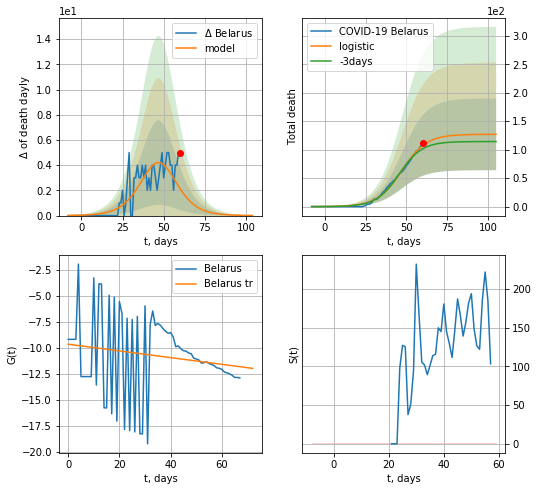

Belarus data at: 2020-05-06
+3 day model MAPE: 0.060069479549227915
model: logistic
coeffs:  [126.97008273   0.13261604  47.32311927]
rational stdev:  0.49567858401683484
forecast at the end of period: +45 days
	 total death:  126 ± 62
trend coefficient of determination: 0.026804
 intercept: -9.678483
 slope: -0.032242


In [234]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,12*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


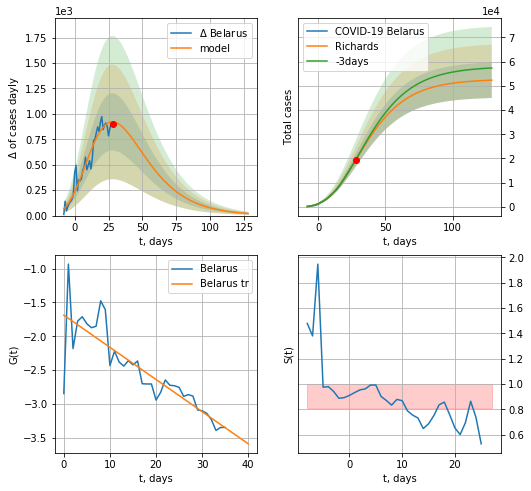

Belarus data at: 2020-05-06
+3 day model MAPE: 0.012747
model: Richards
coeffs: [ 5.26986968e+04  1.65385032e+00 -4.49339871e+01  2.91650566e-02]
rational stdev: 0.140150
forecast at the end of period: +101 days
	 deltaDaycases: 20
	 total cases: 52289 ± 7328
	 total death: 304 ± 127
trend coefficient of determination: 0.731134
 intercept: -1.688335
 slope: -0.047472


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


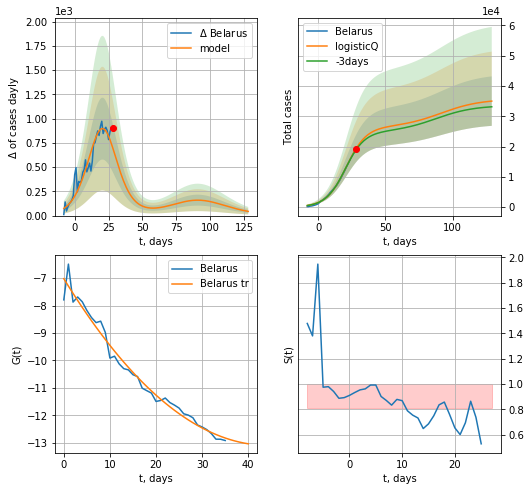

Belarus data at: 2020-05-06
+3 day model MAPE: 0.023365
model: logisticQ
coeffs: [ 2.63296775e+04  6.66710461e-06  2.09385426e+01 -2.03150271e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.233441
forecast at the end of period: +101 days
	 deltaDaycases: 43
	 total cases: 34993 ± 8168
	 total death: 203 ± 142
trend coefficient of determination: 0.977753
 intercept_: -7.015664885345779
 coeffs_: [ 0.         -0.27449264  0.003095  ]


In [235]:
x = forecastRR('Belarus',dfBR[32:],d1,20*7-dT)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


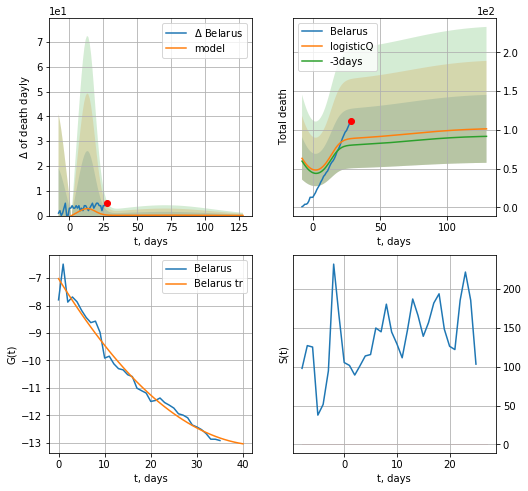

Belarus data at: 2020-05-06
+3 day model MAPE: 0.105922
model: logisticQ
coeffs: [ 7.54038464e+01  8.09387720e-03  5.68021183e+00 -1.44404792e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.432651
forecast at the end of period: +101 days
	 total death: 101 ± 43
trend coefficient of determination: 0.977753
 intercept_: -7.015664885345779
 coeffs_: [ 0.         -0.27449264  0.003095  ]


In [242]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

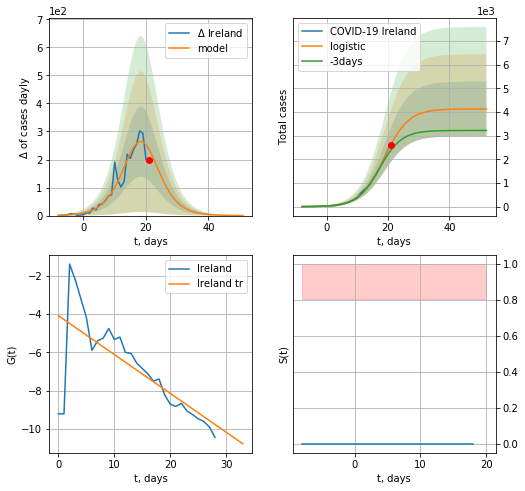

Ireland data at: 2020-05-06
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  4126 ± 1154
	 total death:  255 ± 214
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


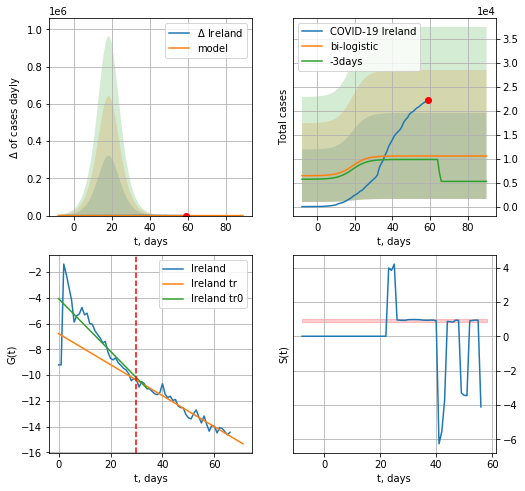

Ireland data at: 2020-05-06
+3 day model MAPE: 0.07447189404688823
model: bi-logistic
coeffs:  [5162.66484668   -5.76055247  153.03365109] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8493993285745964
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  10580 ± 8987
	 total death:  653 ± 1663
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.949637
 intercept: -6.783859
 slope: -0.120526


In [243]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


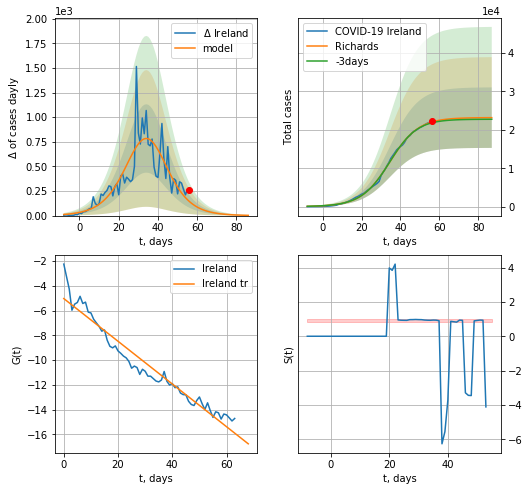

Ireland data at: 2020-05-06
+3 day model MAPE: 0.010755
model: Richards
coeffs: [2.31949701e+04 1.32744835e-01 3.47227466e+01 1.02728354e+00]
rational stdev: 0.340023
forecast at the end of period: +31 days
	 deltaDaycases: 2
	 total cases: 23176 ± 7880
	 total death: 1432 ± 1460
trend coefficient of determination: 0.942271
 intercept: -5.030108
 slope: -0.172523


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


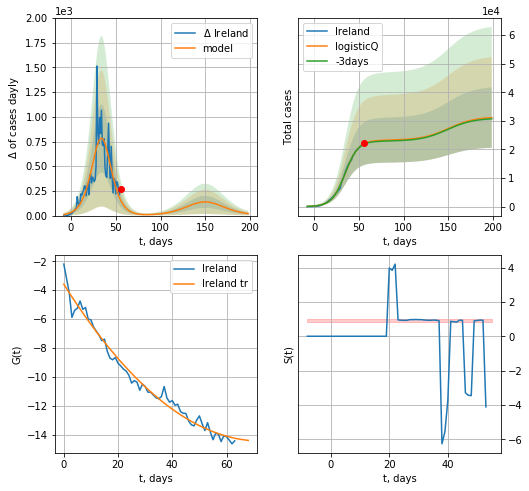

Ireland data at: 2020-05-06
+3 day model MAPE: 0.008266
model: logisticQ
coeffs: [ 2.32291101e+04  1.72770402e-05  3.44650109e+01 -7.76566930e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339323
forecast at the end of period: +143 days
	 deltaDaycases: 19
	 total cases: 31162 ± 10574
	 total death: 1925 ± 1959
trend coefficient of determination: 0.980611
 intercept_: -3.5908300218265694
 coeffs_: [ 0.         -0.29816548  0.00204593]


In [245]:
x = forecastRR('Ireland',dfIR[3:],d1,10*7-dT)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

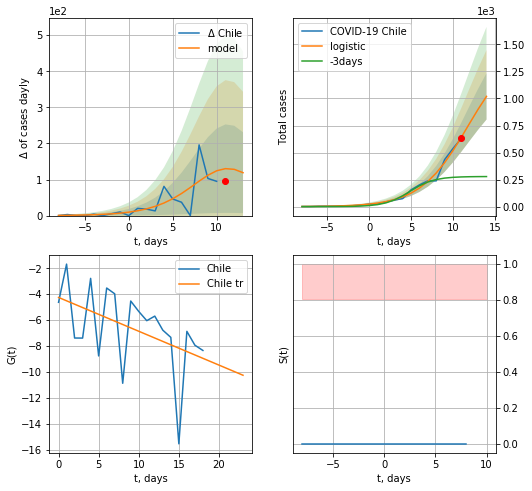

Chile data at: 2020-05-06
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +3 days
	 deltaDaycases:  118
	 total cases:  1019 ± 214
	 total death:  12 ± 7
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


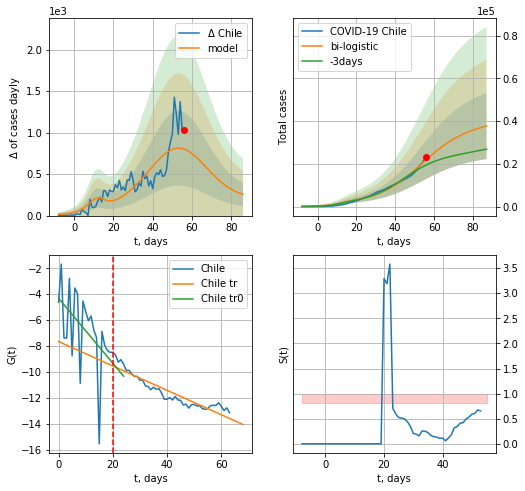

Chile data at: 2020-05-06
+3 day model MAPE: 0.1423568959168972
model: bi-logistic
coeffs:  [3.67263359e+04 8.77769843e-02 5.34899307e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4097748895862452
forecast at the end of period: +31 days
	 deltaDaycases:  258
	 total cases:  37721 ± 15457
	 total death:  459 ± 564
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.868244
 intercept: -7.652669
 slope: -0.094225


In [246]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,6*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


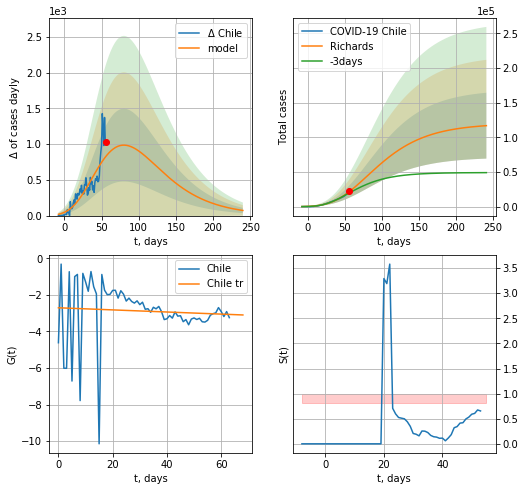

Chile data at: 2020-05-06
+3 day model MAPE: 0.104700
model: Richards
coeffs: [ 1.19999393e+05  1.66003476e+00 -1.10860038e+02  1.35466685e-02]
rational stdev: 0.406693
forecast at the end of period: +185 days
	 deltaDaycases: 71
	 total cases: 116800 ± 47501
	 total death: 1424 ± 1737
trend coefficient of determination: 0.004377
 intercept: -2.701453
 slope: -0.005777


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


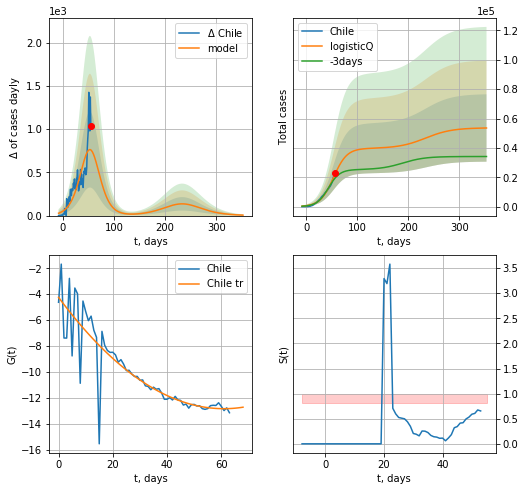

Chile data at: 2020-05-06
+3 day model MAPE: 0.144838
model: logisticQ
coeffs: [ 3.96392047e+04  1.54776824e-06  5.36027639e+01 -4.97265233e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428693
forecast at the end of period: +297 days
	 deltaDaycases: 5
	 total cases: 53541 ± 22952
	 total death: 652 ± 838
trend coefficient of determination: 0.757917
 intercept_: -4.24014822245268
 coeffs_: [ 0.         -0.28216831  0.00231494]


In [248]:
x = forecastRR('Chile',dfCL[:],d1,32*7-dT)
x = forecastRRR('Chile',dfCL[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

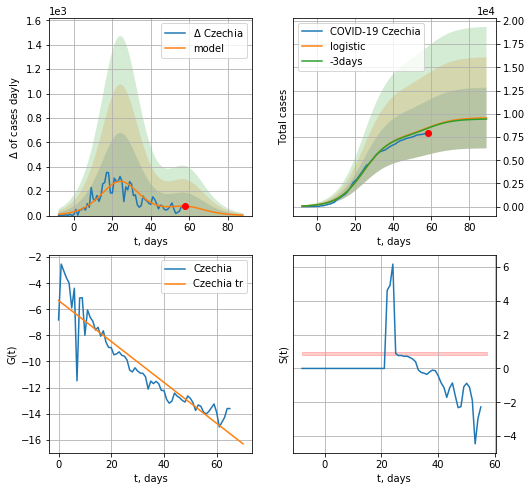

Czechia data at: 2020-05-06
+3 day model MAPE: 0.007177780256987888
model: logistic
coeffs:  [7.66313407e+03 1.45359035e-01 2.45571557e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.3421742201487099
forecast at the end of period: +31 days
	 deltaDaycases:  3
	 total cases:  9554 ± 3269
	 total death:  313 ± 321
trend coefficient of determination: 0.866802
 intercept: -5.326454
 slope: -0.156959


In [249]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


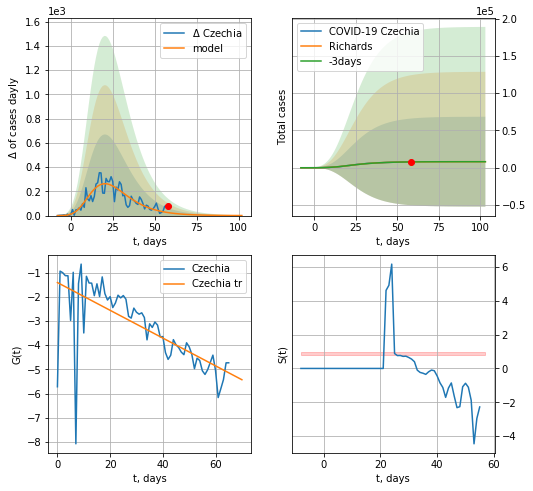

Czechia data at: 2020-05-06
+3 day model MAPE: 0.005041
model: Richards
coeffs: [ 8.13178383e+03  7.85358139e+00 -2.99235647e+01  1.12597427e-02]
rational stdev: 7.412267
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 8126 ± 60232
	 total death: 266 ± 5914
trend coefficient of determination: 0.495292
 intercept: -1.411937
 slope: -0.057384


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


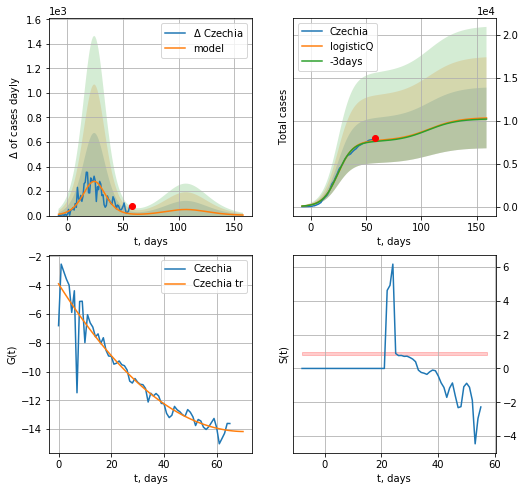

Czechia data at: 2020-05-06
+3 day model MAPE: 0.012820
model: logisticQ
coeffs: [ 7.66293681e+03  1.06855549e-06  2.45572709e+01 -1.35975669e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342270
forecast at the end of period: +101 days
	 deltaDaycases: 4
	 total cases: 10317 ± 3531
	 total death: 338 ± 347
trend coefficient of determination: 0.910067
 intercept_: -3.9013609396421414
 coeffs_: [ 0.         -0.29058579  0.00205599]


In [252]:
x = forecastRR('Czechia',dfCH[:],d1,12*7-dT)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

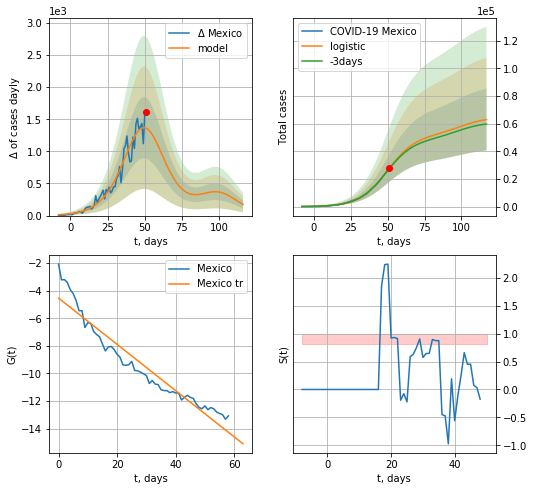

Mexico data at: 2020-05-06
+3 day model MAPE: 0.013988696200248422
model: logistic
coeffs:  [5.18017993e+04 1.05231084e-01 4.98461444e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3548744710950513
forecast at the end of period: +66 days
	 deltaDaycases:  174
	 total cases:  62904 ± 22323
	 total death:  6155 ± 6552
trend coefficient of determination: 0.924779
 intercept: -4.541374
 slope: -0.167482


In [253]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


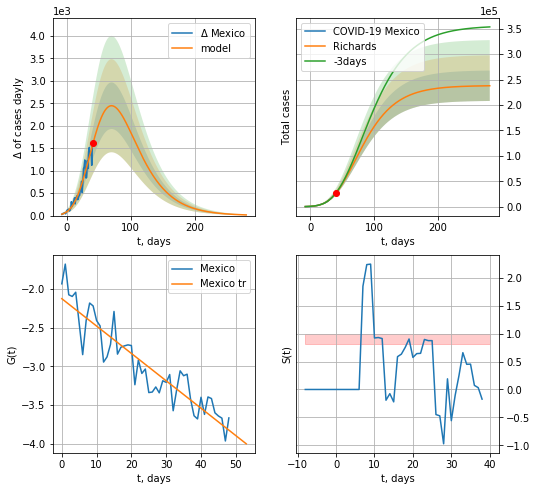

Mexico data at: 2020-05-06
+3 day model MAPE: 0.015011
model: Richards
coeffs: [ 2.38414844e+05  3.60947665e-01 -1.65478671e+01  8.03543952e-02]
rational stdev: 0.125810
forecast at the end of period: +241 days
	 deltaDaycases: 15
	 total cases: 237900 ± 29930
	 total death: 23278 ± 8785
trend coefficient of determination: 0.848076
 intercept: -2.126938
 slope: -0.035327


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


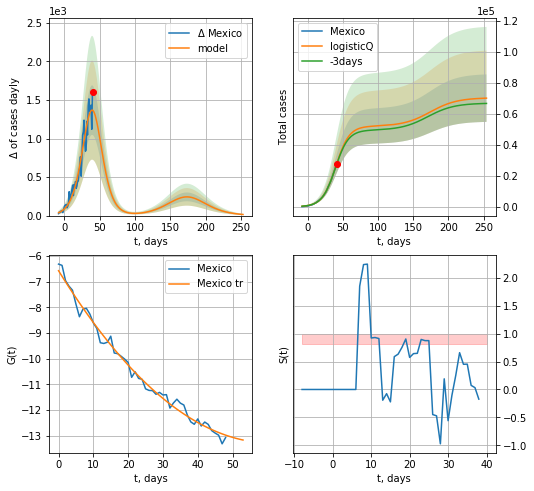

Mexico data at: 2020-05-06
+3 day model MAPE: 0.012421
model: logisticQ
coeffs: [ 5.20399835e+04  1.33453938e-05  3.99265714e+01 -7.84312630e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.218677
forecast at the end of period: +213 days
	 deltaDaycases: 14
	 total cases: 70203 ± 15351
	 total death: 6869 ± 4506
trend coefficient of determination: 0.988376
 intercept_: -6.578759171766179
 coeffs_: [ 0.         -0.21948004  0.00179646]


In [254]:
x = forecastRR('Mexico',dfMX[10:],d1,40*7-dT,addpred=False,xcoef=[.25,1.,2.])#
x = forecastRRR('Mexico',dfMX[10:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date  cases  active  death     tests
54 2020-05-02   1410     727   46.0  141678.0
55 2020-05-03   1419     735   46.1  144029.0
56 2020-05-04   1423     678   46.0  149106.0
57 2020-05-05   1428     662   48.0  156493.0
58 2020-05-06   1428     662   48.0       NaN


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

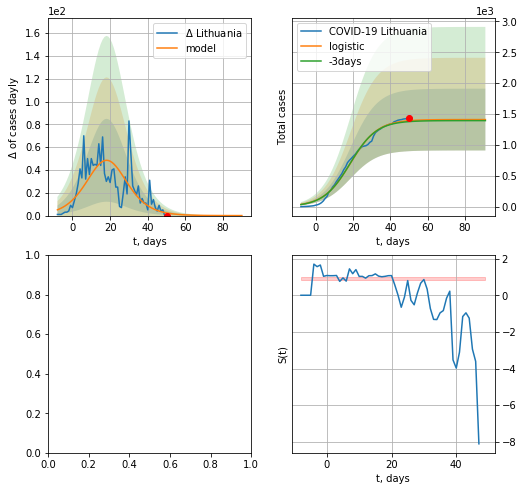

In [255]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [688]:
#np.diff(dfLT["cases"])

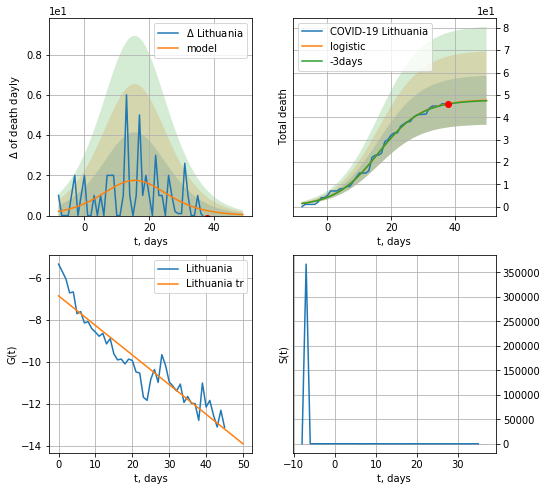

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.004004333972352032
model: logistic
coeffs:  [47.92107226  0.14617652 16.01940865]
rational stdev:  0.2299972810777542
forecast at the end of period: +12 days
	 total death:  47 ± 10
trend coefficient of determination: 0.885619
 intercept: -6.856146
 slope: -0.141263


In [689]:
x = forecast('Lithuania',dfLT[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


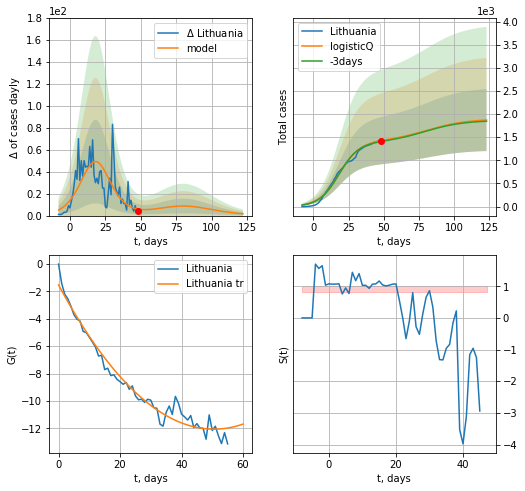

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.012957
model: logisticQ
coeffs: [ 1.40003854e+03  9.08424793e-07  1.84600545e+01 -1.53455362e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358347
forecast at the end of period: +75 days
	 deltaDaycases: 1
	 total cases: 1872 ± 670
	 total death: 60 ± 64
trend coefficient of determination: 0.968183
 intercept_: -1.519874676099799
 coeffs_: [ 0.         -0.41748067  0.00413237]


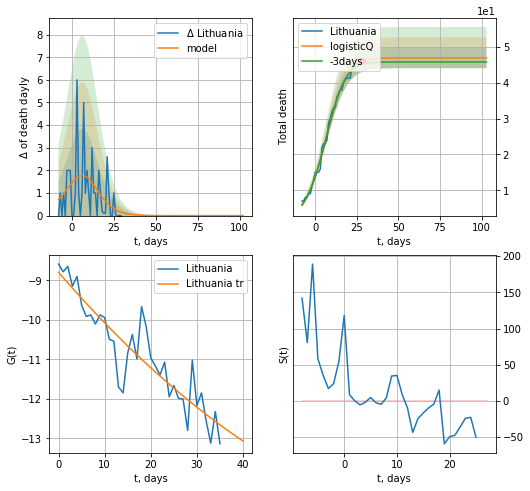

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.016827
model: logisticQ
coeffs: [ 4.69732079e+01  6.70586950e-04  5.86143217e+00 -2.18843043e+02]
rational stdev: 0.061239
forecast at the end of period: +75 days
	 total death: 46 ± 2
trend coefficient of determination: 0.823734
 intercept_: -8.798304973670938
 coeffs_: [ 0.         -0.13470927  0.00070129]


In [690]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


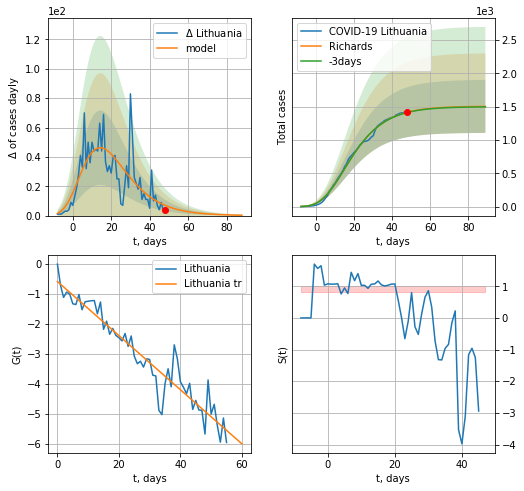

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.003356
model: Richards
coeffs: [ 1.50539456e+03  9.04150925e+00 -4.09913899e+01  9.28453030e-03]
rational stdev: 0.264476
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 1502 ± 397
	 total death: 48 ± 38
trend coefficient of determination: 0.908498
 intercept: -0.579530
 slope: -0.090127


In [691]:
x = forecastRR('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


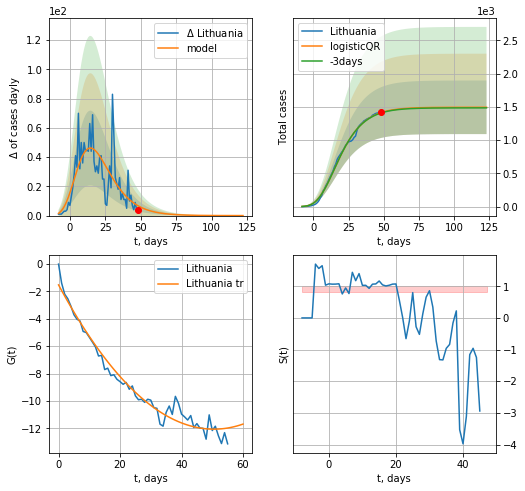

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.004044052770565358
model: logisticQR
coeffs:  [ 1.49502256e+03  4.82069735e-02 -6.84550610e+01 -1.04523337e+03
  1.52714186e-03]
rational stdev:  0.26971961262427513
forecast at the end of period: +75 days
	 deltaDaycases:  0
	 total cases:  1494 ± 403
	 total death:  48 ± 38
trend coefficient of determination: 0.968183
 intercept_: -1.519874676099799
 coeffs_: [ 0.         -0.41748067  0.00413237]


In [692]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
56 2020-05-02  3812.0     402   92.0
57 2020-05-03  3824.0     349   96.0
58 2020-05-04  3828.0     327   96.0
59 2020-05-05  3840.0     332   96.0
60 2020-05-06  3851.0     301   98.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


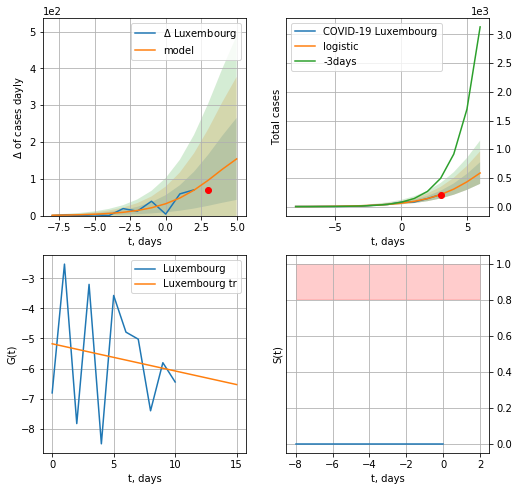

Luxembourg data at: 2020-05-06
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +3 days
	 deltaDaycases:  154
	 total cases:  585 ± 188
	 total death:  14 ± 13
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


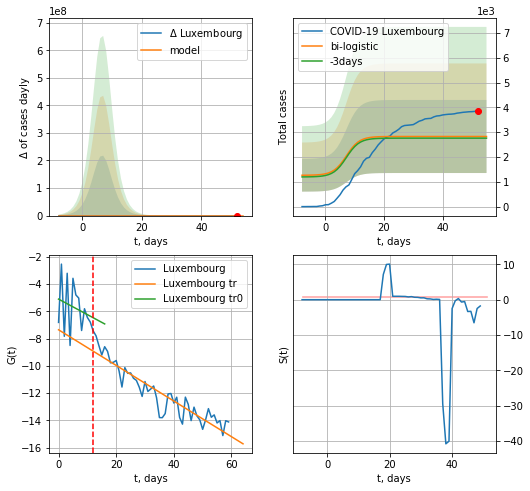

Luxembourg data at: 2020-05-06
+3 day model MAPE: 0.024289313194660593
model: bi-logistic
coeffs:  [1124.29707585   -5.13037682  209.98208849] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5203862904764056
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  2827 ± 1471
	 total death:  71 ± 110
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.852222
 intercept: -7.350052
 slope: -0.130760


In [258]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,6*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,6*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


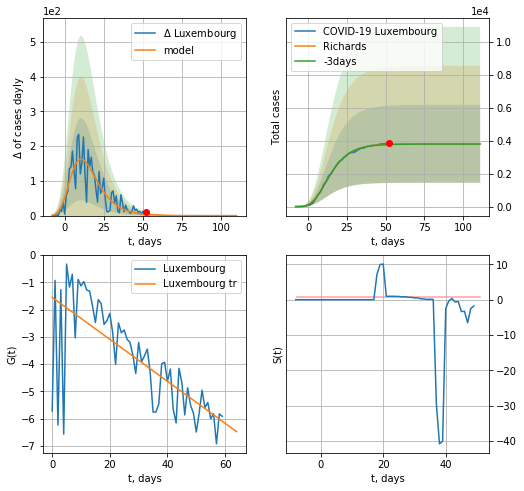

Luxembourg data at: 2020-05-06
+3 day model MAPE: 0.004150
model: Richards
coeffs: [ 3.81636488e+03  1.80170060e+01 -3.23920265e+01  6.44989053e-03]
rational stdev: 0.620073
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 3816 ± 2366
	 total death: 97 ± 180
trend coefficient of determination: 0.524228
 intercept: -1.554188
 slope: -0.076839


In [259]:
x = forecastRR("Luxembourg",dfLX[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


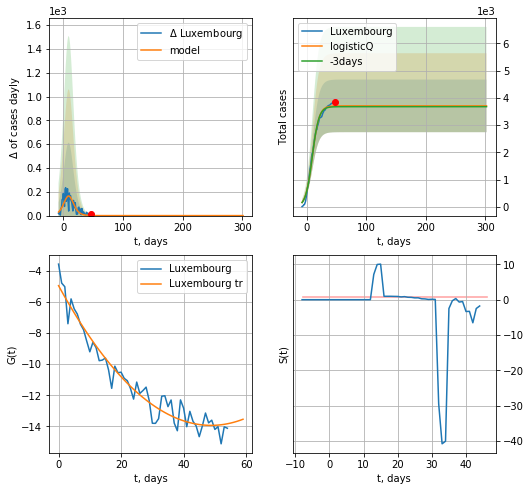

Luxembourg data at: 2020-05-06
+3 day model MAPE: 0.007886
model: logisticQ
coeffs: [ 3.70632566e+03  1.12789783e-06  9.36769952e+00 -1.57636490e+05]
rational stdev: 0.260747
forecast at the end of period: +255 days
	 deltaDaycases: 0
	 total cases: 3706 ± 966
	 total death: 94 ± 73
trend coefficient of determination: 0.945170
 intercept_: -4.956280216220291
 coeffs_: [ 0.         -0.36783724  0.00376969]


In [261]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,42*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
          date    cases   active   death
63 2020-05-02  22231.0  23961.0  1371.0
64 2020-05-03  23910.0  24674.0  1564.0
65 2020-05-04  24118.0  26879.0  1569.0
66 2020-05-05  25807.0  26879.0  1569.0
67 2020-05-06  29420.0  24369.0  1618.0


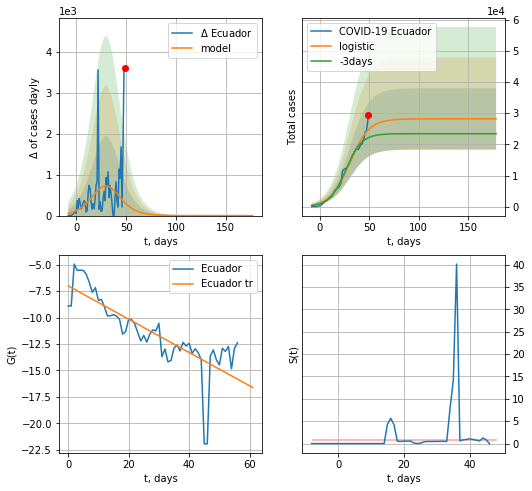

Ecuador data at: 2020-05-06
+3 day model MAPE: 0.11852265895093576
model: logistic
coeffs:  [2.81665222e+04 1.03046150e-01 3.03900684e+01]
rational stdev:  0.34897200964401964
forecast at the end of period: +129 days
	 deltaDaycases:  0
	 total cases:  28166 ± 9829
	 total death:  1549 ± 1621
trend coefficient of determination: 0.635603
 intercept: -6.998498
 slope: -0.157574


In [266]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


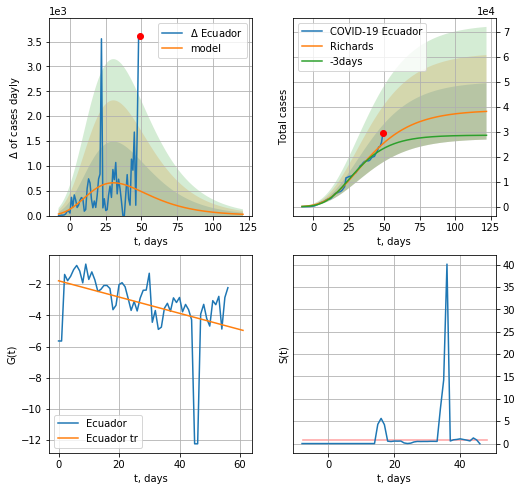

Ecuador data at: 2020-05-06
+3 day model MAPE: 0.095093
model: Richards
coeffs: [ 3.87783261e+04  3.75049820e+00 -6.35187384e+01  1.24031652e-02]
rational stdev: 0.295630
forecast at the end of period: +73 days
	 deltaDaycases: 26
	 total cases: 38223 ± 11300
	 total death: 2102 ± 1864
trend coefficient of determination: 0.170426
 intercept: -1.780879
 slope: -0.052179


In [267]:
x = forecastRR("Ecuador",dfED[10:],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


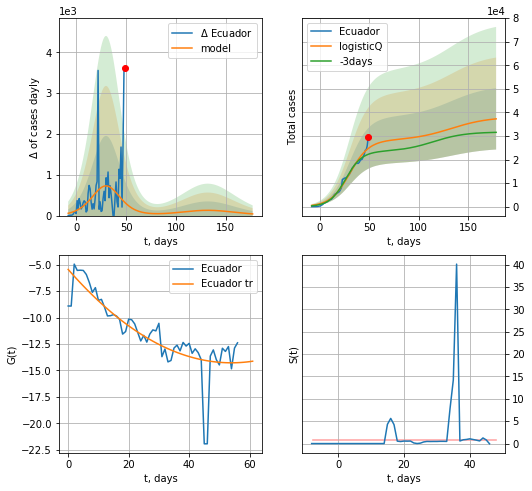

Ecuador data at: 2020-05-06
+3 day model MAPE: 0.117329
model: logisticQ
coeffs: [ 2.81605413e+04  9.71692664e-07  3.03857643e+01 -1.06017982e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348994
forecast at the end of period: +129 days
	 deltaDaycases: 41
	 total cases: 37274 ± 13008
	 total death: 2049 ± 2145
trend coefficient of determination: 0.686752
 intercept_: -5.441820866925347
 coeffs_: [ 0.         -0.32743663  0.00303364]


In [268]:
x = forecastRRR("Ecuador",dfED[10:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
67 2020-05-02  5176.0    1956  220.0
68 2020-05-03  5254.0    2024  230.0
69 2020-05-04  5327.0    1587  240.0
70 2020-05-05  5412.0    1666  246.0
71 2020-05-06  5573.0    1821  252.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


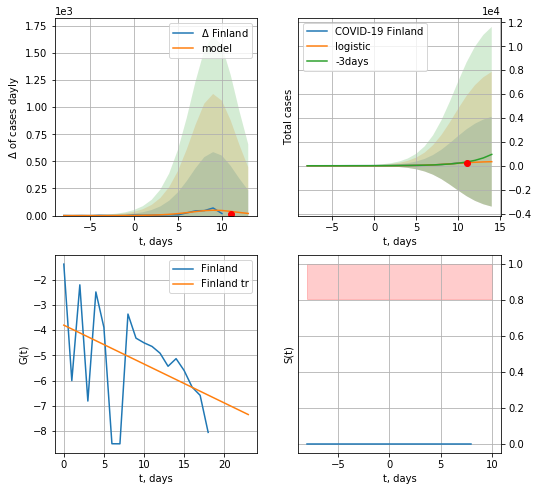

Finland data at: 2020-05-06
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +3 days
	 deltaDaycases:  19
	 total cases:  340 ± 3759
	 total death:  15 ± 496
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


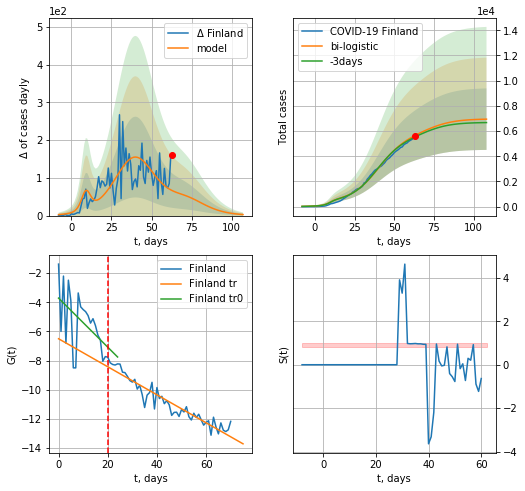

Finland data at: 2020-05-06
+3 day model MAPE: 0.021439243737917366
model: bi-logistic
coeffs:  [5.27504468e+03 1.14736158e-01 3.99706280e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3515560794417977
forecast at the end of period: +45 days
	 deltaDaycases:  2
	 total cases:  6944 ± 2441
	 total death:  313 ± 330
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.902102
 intercept: -6.504510
 slope: -0.096077


In [269]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,6*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


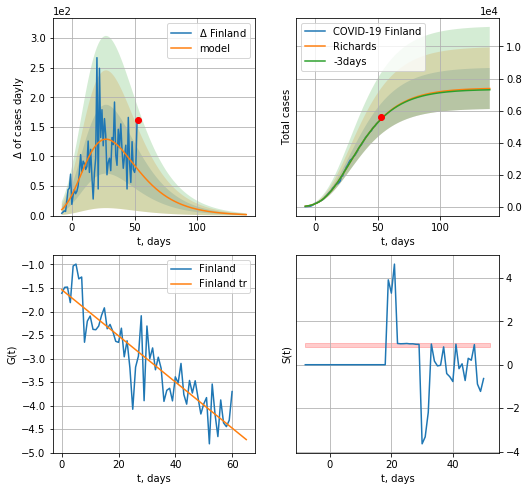

Finland data at: 2020-05-06
+3 day model MAPE: 0.003167
model: Richards
coeffs: [ 7.41255406e+03  2.63129422e+00 -5.61301910e+01  1.81631918e-02]
rational stdev: 0.173595
forecast at the end of period: +87 days
	 deltaDaycases: 1
	 total cases: 7377 ± 1280
	 total death: 333 ± 173
trend coefficient of determination: 0.811865
 intercept: -1.537419
 slope: -0.048973


In [270]:
x = forecastRR("Finland",dfFI[10:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


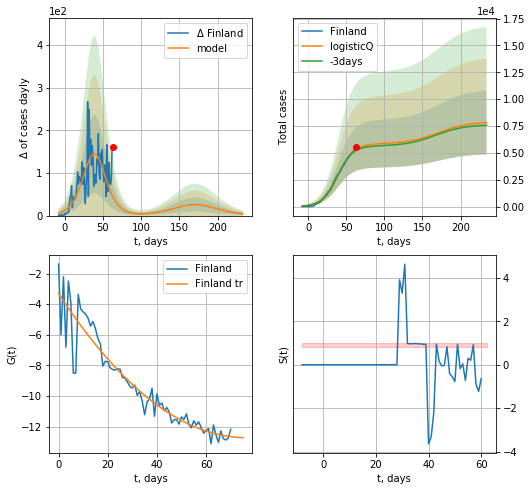

Finland data at: 2020-05-06
+3 day model MAPE: 0.022573
model: logisticQ
coeffs: [ 5.83801164e+03  1.23626620e-06  3.91549524e+01 -8.02025412e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379458
forecast at the end of period: +171 days
	 deltaDaycases: 4
	 total cases: 7821 ± 2967
	 total death: 353 ± 401
trend coefficient of determination: 0.887030
 intercept_: -3.300472719597952
 coeffs_: [ 0.         -0.24648612  0.00161235]


In [271]:
x = forecastRRR("Finland",dfFI[:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

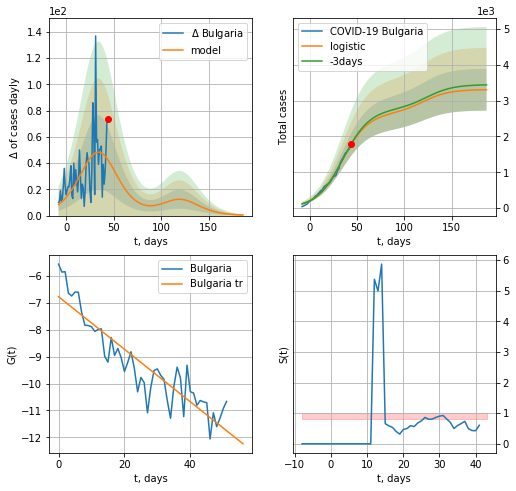

Bulgaria data at: 2020-05-06
+3 day model MAPE: 0.011839191012907063
model: logistic
coeffs:  [2.64589206e+03 7.29833632e-02 3.43879874e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.17680272805245706
forecast at the end of period: +143 days
	 deltaDaycases:  0
	 total cases:  3302 ± 583
	 total death:  156 ± 82
trend coefficient of determination: 0.832929
 intercept: -6.772045
 slope: -0.097610


In [272]:
x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


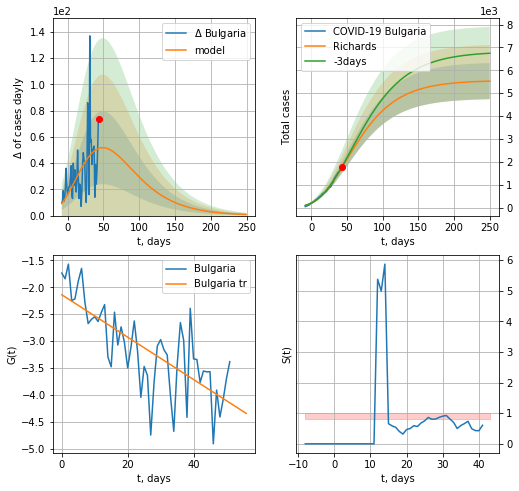

Bulgaria data at: 2020-05-06
+3 day model MAPE: 0.021088
model: Richards
coeffs: [ 5.56101403e+03  9.42321484e-01 -9.09110154e+01  2.72302013e-02]
rational stdev: 0.142950
forecast at the end of period: +206 days
	 deltaDaycases: 0
	 total cases: 5528 ± 790
	 total death: 261 ± 111
trend coefficient of determination: 0.546059
 intercept: -2.139388
 slope: -0.039390


In [273]:
x = forecastRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=False,xcoef=[0.25,1.,4.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


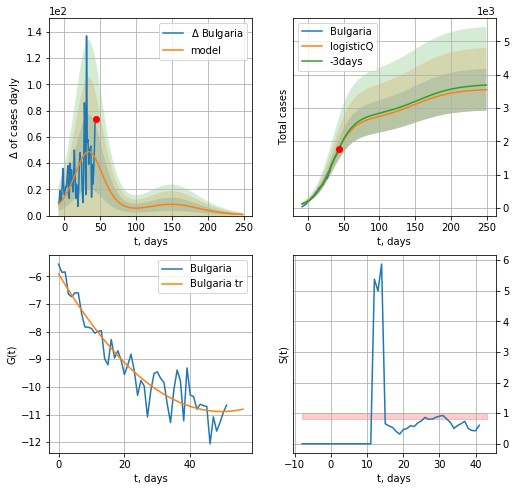

Bulgaria data at: 2020-05-06
+3 day model MAPE: 0.011215
model: logisticQ
coeffs: [ 2.63941887e+03  3.62424070e-06  3.43191130e+01 -2.01485544e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.176983
forecast at the end of period: +206 days
	 deltaDaycases: 0
	 total cases: 3551 ± 628
	 total death: 167 ± 88
trend coefficient of determination: 0.897995
 intercept_: -5.910330425394987
 coeffs_: [ 0.         -0.20105149  0.00202859]


In [274]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date  cases  active  death
65 2020-05-02   2969   176.0   54.0
66 2020-05-03   2987   193.0   54.0
67 2020-05-04   2988   187.0   54.0
68 2020-05-05   2989   173.0   55.0
69 2020-05-06   2992   165.0   55.0


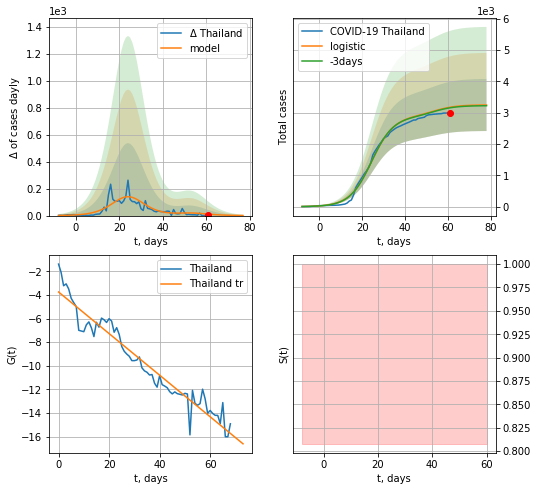

Thailand data at: 2020-05-06
+3 day model MAPE: 0.006106737137013538
model: logistic
coeffs:  [2.88767258e+03 1.94074403e-01 2.44794195e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.2560823766419951
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  3245 ± 831
	 total death:  59 ± 45
trend coefficient of determination: 0.933100
 intercept: -3.746399
 slope: -0.176165


In [275]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [276]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


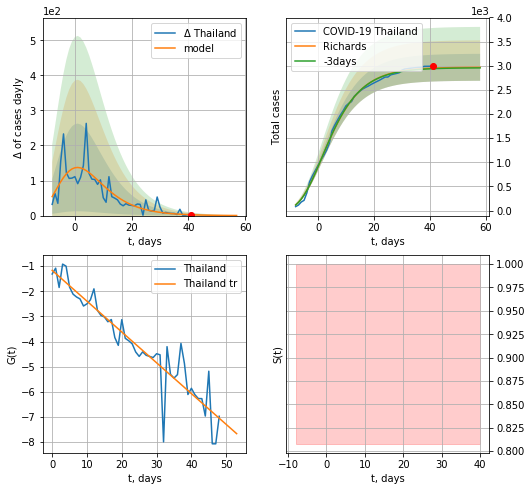

Thailand data at: 2020-05-06
+3 day model MAPE: 0.003784
model: Richards
coeffs: [ 2.96948784e+03  1.42902398e+01 -3.60417420e+01  8.84035189e-03]
rational stdev: 0.094013
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 2967 ± 278
	 total death: 54 ± 15
trend coefficient of determination: 0.870649
 intercept: -1.167505
 slope: -0.122661


In [277]:
x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/6,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


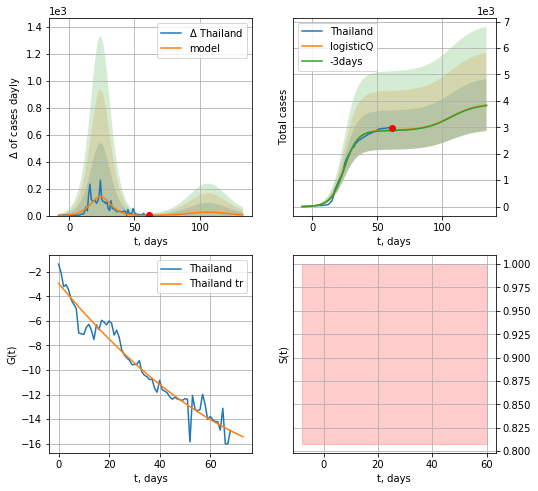

Thailand data at: 2020-05-06
+3 day model MAPE: 0.007545
model: logisticQ
coeffs: [ 2.88765245e+03  1.40186398e-06  2.44797631e+01 -1.38374684e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.256143
forecast at the end of period: +73 days
	 deltaDaycases: 6
	 total cases: 3843 ± 984
	 total death: 70 ± 53
trend coefficient of determination: 0.943582
 intercept_: -2.9520475948310247
 coeffs_: [ 0.         -0.2473198   0.00104652]


In [278]:
x = forecastRRR("Thailand",dfTH[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

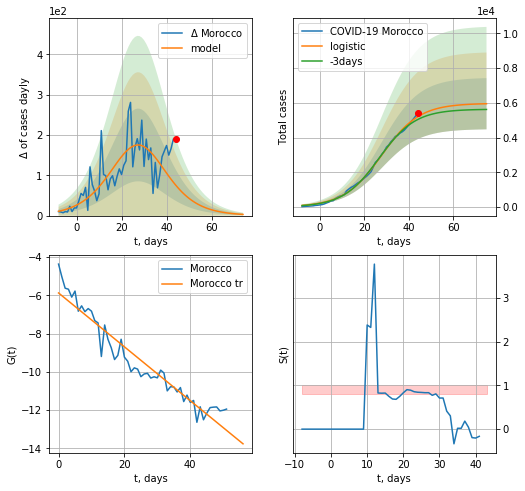

Morocco data at: 2020-05-06
+3 day model MAPE: 0.033798471362693185
model: logistic
coeffs:  [5.97098141e+03 1.17546133e-01 2.78543973e+01]
rational stdev:  0.24817236473686657
forecast at the end of period: +31 days
	 deltaDaycases:  2
	 total cases:  5947 ± 1476
	 total death:  201 ± 149
trend coefficient of determination: 0.922770
 intercept: -5.871094
 slope: -0.140982


In [279]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

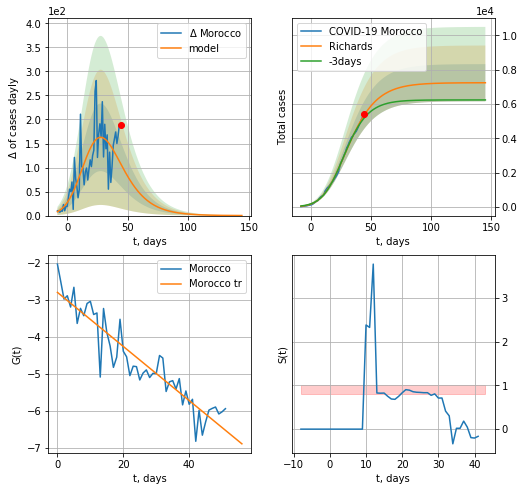

Morocco data at: 2020-05-06
+3 day model MAPE: 0.033653
model: Richards
coeffs: [7.23890083e+03 2.33813881e-01 1.09494940e+01 3.00071144e-01]
rational stdev: 0.149899
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 7236 ± 1084
	 total death: 244 ± 109
trend coefficient of determination: 0.868080
 intercept: -2.792553
 slope: -0.073031


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


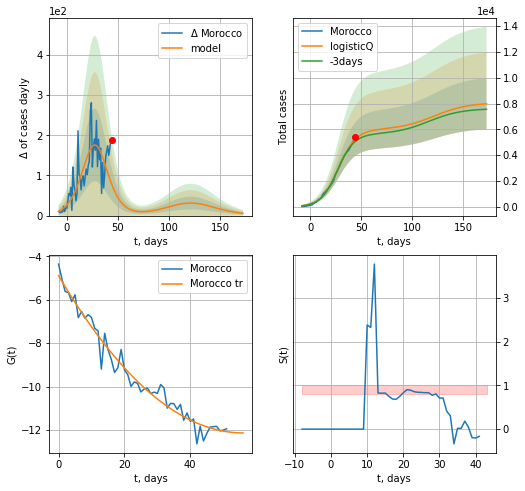

Morocco data at: 2020-05-06
+3 day model MAPE: 0.033703
model: logisticQ
coeffs: [ 5.96740344e+03  4.20950388e-06  2.78440548e+01 -2.79126622e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.248484
forecast at the end of period: +129 days
	 deltaDaycases: 5
	 total cases: 7985 ± 1984
	 total death: 270 ± 201
trend coefficient of determination: 0.967551
 intercept_: -4.890486231591478
 coeffs_: [ 0.         -0.25870082  0.00230864]


In [280]:
x = forecastRR("Morocco",dfMR[5:],d1,20*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1])
x = forecastRRR("Morocco",dfMR[5:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

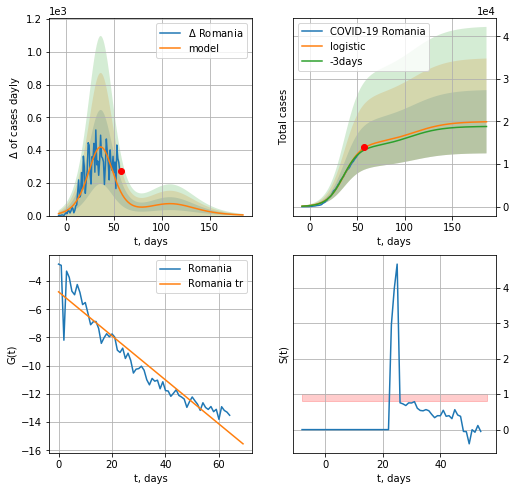

Romania data at: 2020-05-06
+3 day model MAPE: 0.0377513266943655
model: logistic
coeffs:  [1.48172041e+04 1.11925206e-01 3.64835320e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.37261897901516167
forecast at the end of period: +129 days
	 deltaDaycases:  4
	 total cases:  19932 ± 7427
	 total death:  1220 ± 1363
trend coefficient of determination: 0.909285
 intercept: -4.766149
 slope: -0.156021


In [281]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


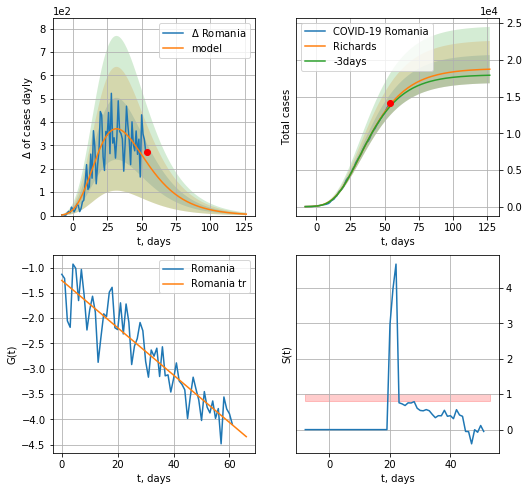

Romania data at: 2020-05-06
+3 day model MAPE: 0.016212
model: Richards
coeffs: [ 1.88412502e+04  3.64018885e+00 -4.57671625e+01  1.48327271e-02]
rational stdev: 0.102544
forecast at the end of period: +73 days
	 deltaDaycases: 6
	 total cases: 18728 ± 1920
	 total death: 1147 ± 352
trend coefficient of determination: 0.845728
 intercept: -1.255706
 slope: -0.046797


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


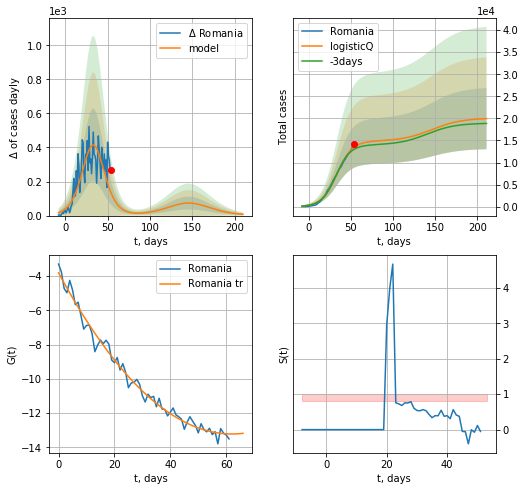

Romania data at: 2020-05-06
+3 day model MAPE: 0.038440
model: logisticQ
coeffs: [ 1.48234230e+04  1.37141480e-06  3.34941367e+01 -8.14790596e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347563
forecast at the end of period: +157 days
	 deltaDaycases: 7
	 total cases: 19941 ± 6930
	 total death: 1221 ± 1273
trend coefficient of determination: 0.985696
 intercept_: -3.8083532640018873
 coeffs_: [ 0.         -0.30354051  0.00244643]


In [282]:
x = forecastRR("Romania",dfRM[8:],d1,16*7-dT)
xx = forecastRRR("Romania",dfRM[8:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [283]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date    cases  active     death
84 2020-05-02  1031728  444169  107059.0
85 2020-05-03  1038173  444491  107861.0
86 2020-05-04  1044364  435371  108980.0
87 2020-05-05  1052341  434135  110111.0
88 2020-05-06  1064763  420214  111849.0


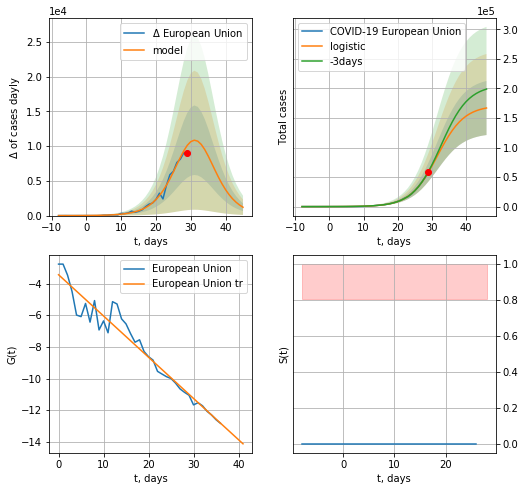

European Union data at: 2020-05-06
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +17 days
	 deltaDaycases:  1203
	 total cases:  166906 ± 45752
	 total death:  17532 ± 14417
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


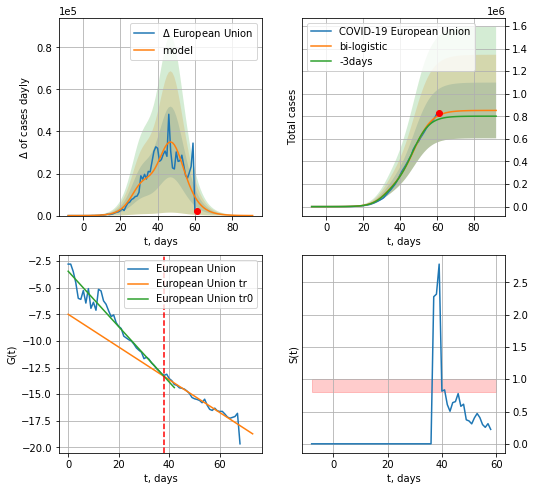

European Union data at: 2020-05-06
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +31 days
	 deltaDaycases:  19
	 total cases:  851665 ± 246575
	 total death:  89463 ± 77704
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


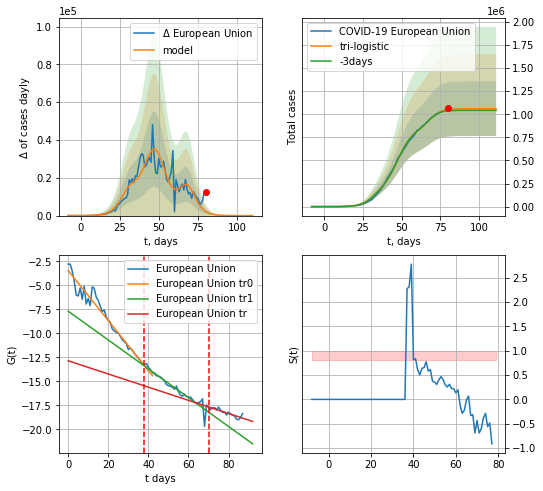

European Union data at: 2020-05-06
+3 day model MAPE: 0.013732299154940756
model: tri-logistic
coeffs:  [2.08219117e+05 2.77139492e-01 6.85273886e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.27863298340634324
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  1059969 ± 295342
	 total death:  111345 ± 93073
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.764410
 intercept: -12.844234
 slope: -0.068689


In [284]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


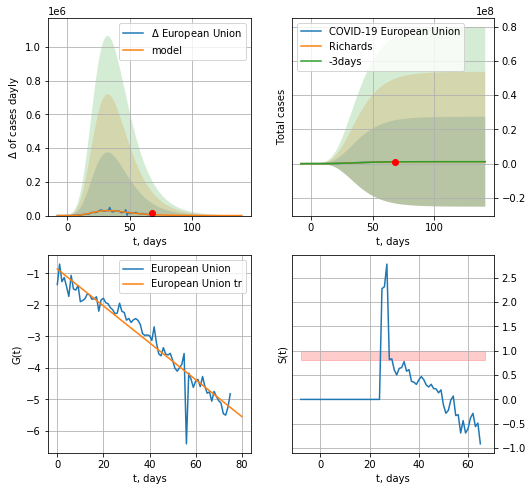

European Union data at: 2020-05-06
+3 day model MAPE: 0.003987
model: Richards
coeffs: [ 1.14165272e+06  2.68104625e+00 -1.71932242e+01  2.69278572e-02]
rational stdev: 22.997633
forecast at the end of period: +73 days
	 deltaDaycases: 34
	 total cases: 1141187 ± 26244620
	 total death: 119877 ± 8270661
trend coefficient of determination: 0.928174
 intercept: -0.866600
 slope: -0.058482


In [285]:
x = forecastRR("European Union",dfEU[12:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


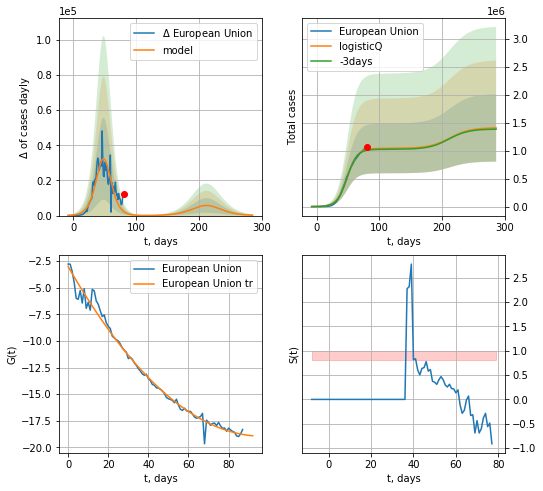

European Union data at: 2020-05-06
+3 day model MAPE: 0.014041
model: logisticQ
coeffs: [ 1.04359877e+06  1.06550591e-06  4.86446819e+01 -1.16357761e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428078
forecast at the end of period: +206 days
	 deltaDaycases: 230
	 total cases: 1409586 ± 603412
	 total death: 148071 ± 190157
trend coefficient of determination: 0.987176
 intercept_: -3.009107664880327
 coeffs_: [ 0.         -0.32871197  0.00169337]


In [286]:
x = forecastRRR("European Union",dfEU[:],d1,35*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


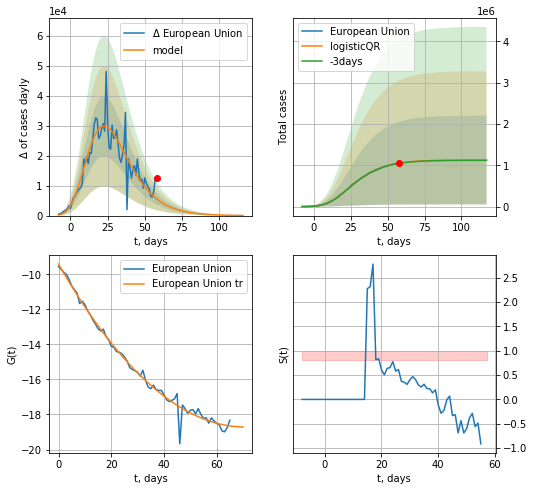

European Union data at: 2020-05-06
+3 day model MAPE: 0.003615552955582546
model: logisticQR
coeffs:  [ 1.12911184e+06  2.03631406e-02 -6.14789751e+01 -7.02289070e+02
  4.37663204e-03]
rational stdev:  0.9523150387007666
forecast at the end of period: +59 days
	 deltaDaycases:  52
	 total cases:  1128547 ± 1074732
	 total death:  118549 ± 338687
trend coefficient of determination: 0.987058
 intercept_: -9.413256882235975
 coeffs_: [ 0.         -0.26241     0.00185044]


In [287]:
x = forecastQR("European Union",dfEU[22:],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [722]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [723]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [724]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [725]:
#dfIC[:]

IC
          date    cases  active  death
62 2020-05-02  1798.01      82  10.06
63 2020-05-03  1799.00      72  10.00
64 2020-05-04  1799.50      66  10.00
65 2020-05-05  1799.70      56  10.00
66 2020-05-06  1799.80      39  10.00


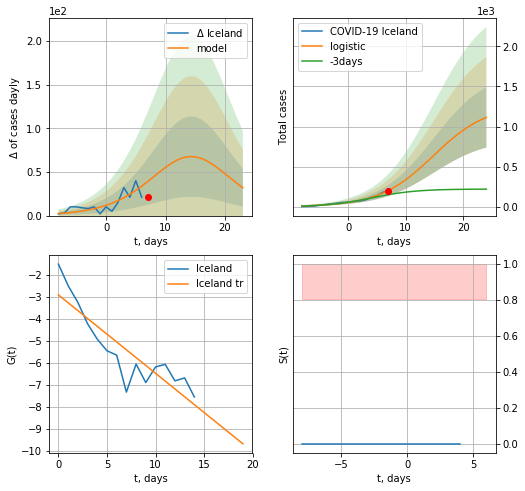

Iceland data at: 2020-05-06
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +17 days
	 deltaDaycases:  31
	 total cases:  1114 ± 376
	 total death:  6 ± 6
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


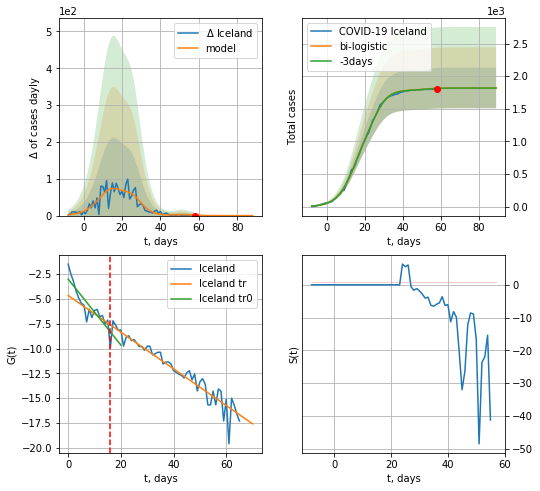

Iceland data at: 2020-05-06
+3 day model MAPE: 0.001235739100824062
model: bi-logistic
coeffs:  [5.15840662e+02 2.88694267e-01 2.61036561e+01] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.17124405069977597
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  1820 ± 311
	 total death:  10 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.902521
 intercept: -4.662754
 slope: -0.184624


In [289]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


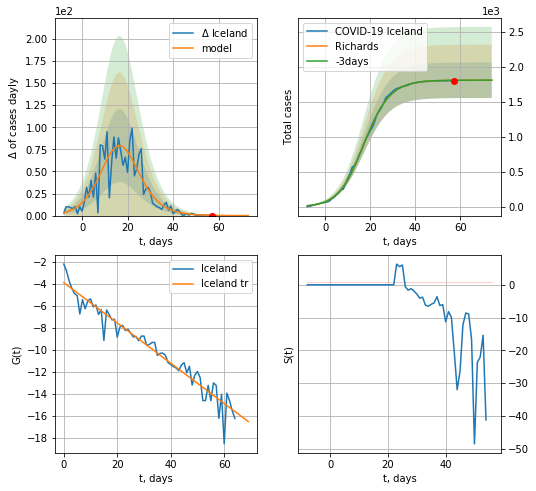

Iceland data at: 2020-05-06
+3 day model MAPE: 0.000527
model: Richards
coeffs: [1.80633139e+03 1.96073509e-01 1.60328675e+01 8.58291196e-01]
rational stdev: 0.140317
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 1806 ± 253
	 total death: 10 ± 4
trend coefficient of determination: 0.940030
 intercept: -3.912248
 slope: -0.182610


In [290]:
x = forecastRR("Iceland",dfIC[1:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


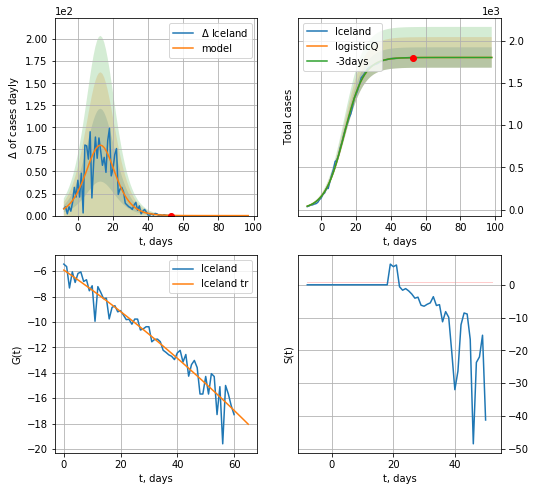

Iceland data at: 2020-05-06
+3 day model MAPE: 0.000035
model: logisticQ
coeffs: [ 1.80190721e+03  1.00440970e-05  1.33189954e+01 -1.76410779e+04]
rational stdev: 0.067017
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 1801 ± 120
	 total death: 10 ± 2
trend coefficient of determination: 0.941229
 intercept_: -5.91235306261035
 coeffs_: [ 0.         -0.15267196 -0.00052438]


In [291]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

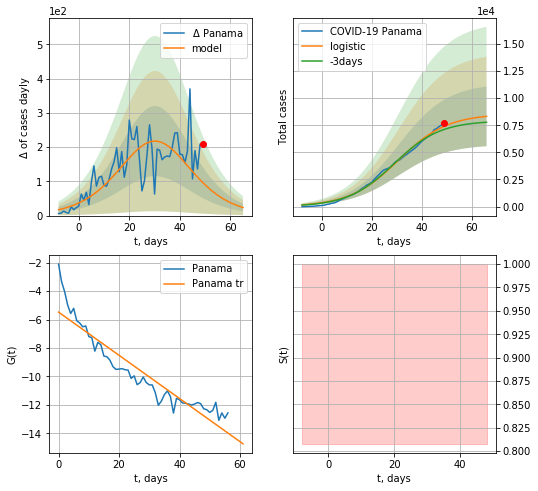

Panama data at: 2020-05-06
+3 day model MAPE: 0.04356773146413116
model: logistic
coeffs:  [8.54580557e+03 1.01828076e-01 3.06561174e+01]
rational stdev:  0.3305300336636307
forecast at the end of period: +17 days
	 deltaDaycases:  23
	 total cases:  8318 ± 2749
	 total death:  234 ± 232
trend coefficient of determination: 0.876434
 intercept: -5.476794
 slope: -0.151877


In [292]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


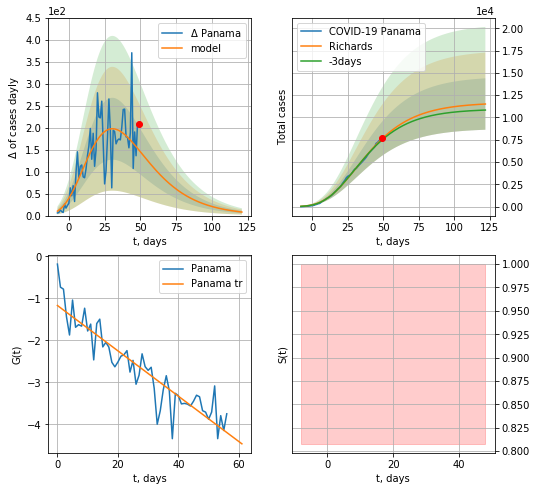

Panama data at: 2020-05-06
+3 day model MAPE: 0.018956
model: Richards
coeffs: [ 1.16738258e+04  3.17258948e+00 -6.04000904e+01  1.45906844e-02]
rational stdev: 0.250589
forecast at the end of period: +73 days
	 deltaDaycases: 8
	 total cases: 11502 ± 2882
	 total death: 324 ± 243
trend coefficient of determination: 0.844264
 intercept: -1.167615
 slope: -0.053989


In [293]:
x = forecastRR("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


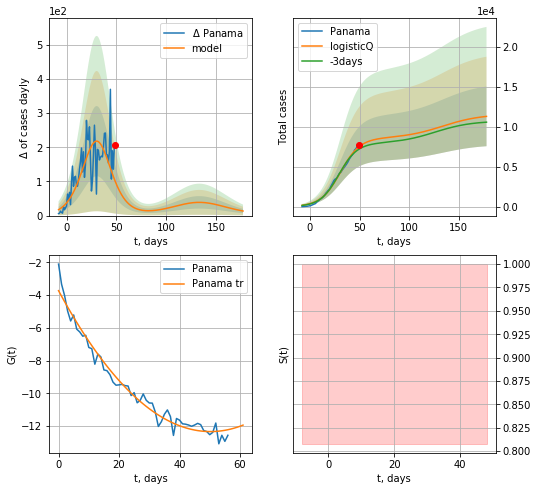

Panama data at: 2020-05-06
+3 day model MAPE: 0.043023
model: logisticQ
coeffs: [ 8.54341941e+03  1.30846923e-06  3.06504531e+01 -7.78030520e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330584
forecast at the end of period: +129 days
	 deltaDaycases: 13
	 total cases: 11287 ± 3731
	 total death: 318 ± 315
trend coefficient of determination: 0.972610
 intercept_: -3.7244590655496435
 coeffs_: [ 0.         -0.34308633  0.00341485]


In [294]:
x = forecastRRR("Panama",dfPM[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

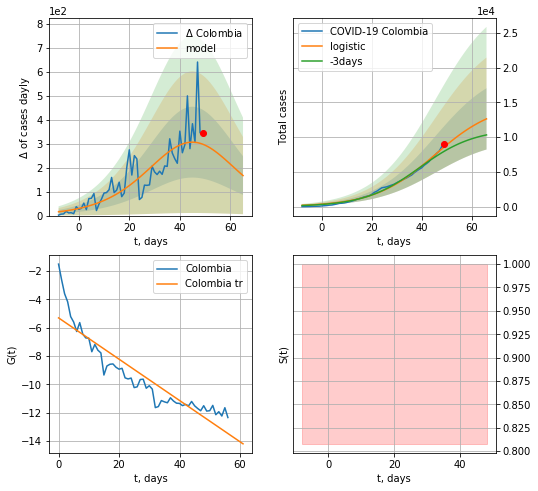

Colombia data at: 2020-05-06
+3 day model MAPE: 0.08718226069519075
model: logistic
coeffs:  [1.49983596e+04 8.16438305e-02 4.54355475e+01]
rational stdev:  0.3492142944362123
forecast at the end of period: +17 days
	 deltaDaycases:  166
	 total cases:  12640 ± 4414
	 total death:  560 ± 586
trend coefficient of determination: 0.840649
 intercept: -5.306149
 slope: -0.146028


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


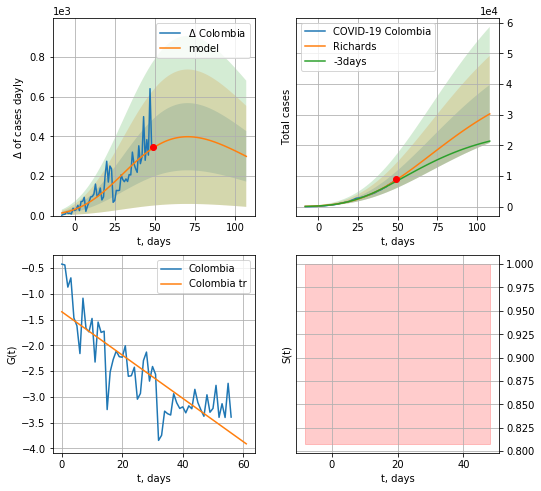

Colombia data at: 2020-05-06
+3 day model MAPE: 0.057719
model: Richards
coeffs: [ 4.57176565e+04  1.57938484e+00 -1.05021290e+02  1.50873789e-02]
rational stdev: 0.312708
forecast at the end of period: +59 days
	 deltaDaycases: 298
	 total cases: 30261 ± 9463
	 total death: 1340 ± 1257
trend coefficient of determination: 0.689801
 intercept: -1.347558
 slope: -0.042010


In [295]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


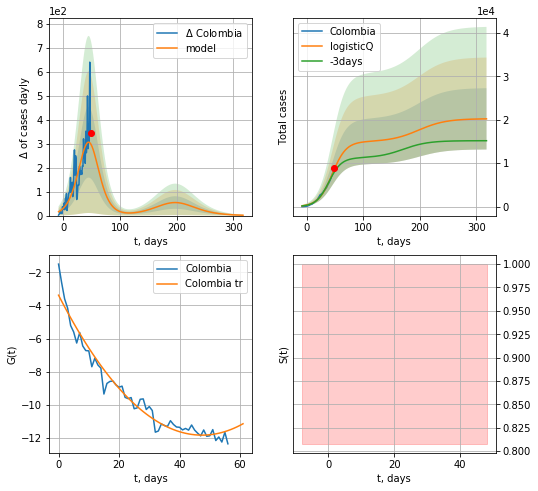

Colombia data at: 2020-05-06
+3 day model MAPE: 0.086747
model: logisticQ
coeffs: [ 1.49613481e+04  3.02985308e-06  4.53747897e+01 -2.69466279e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.349243
forecast at the end of period: +269 days
	 deltaDaycases: 1
	 total cases: 20222 ± 7062
	 total death: 896 ± 938
trend coefficient of determination: 0.961064
 intercept_: -3.3809674669038827
 coeffs_: [ 0.         -0.35609526  0.00375161]


In [298]:
x = forecastRRR("Colombia",dfCB[:],d1,44*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
59 2020-05-02  4295.0  1964.0  459.0
60 2020-05-03  4474.0  2075.0  463.0
61 2020-05-04  4648.0  2185.0  465.0
62 2020-05-05  4838.0  2301.0  470.0
63 2020-05-06  4997.0  2324.0  476.0


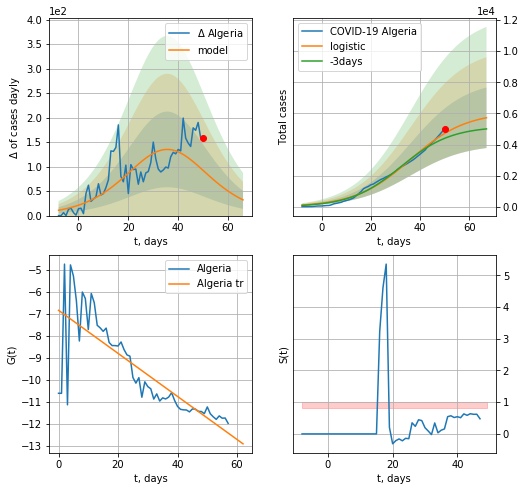

Algeria data at: 2020-05-06
+3 day model MAPE: 0.07707831856808584
model: logistic
coeffs:  [6.09670699e+03 8.85822841e-02 3.60982271e+01]
rational stdev:  0.3395352208287181
forecast at the end of period: +17 days
	 deltaDaycases:  32
	 total cases:  5725 ± 1944
	 total death:  545 ± 555
trend coefficient of determination: 0.655981
 intercept: -6.827211
 slope: -0.097842


In [299]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


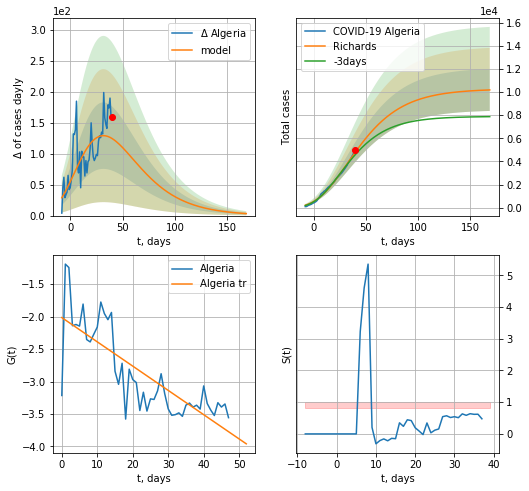

Algeria data at: 2020-05-06
+3 day model MAPE: 0.051015
model: Richards
coeffs: [ 1.02721354e+04  2.68673495e+00 -9.43562259e+01  1.28164792e-02]
rational stdev: 0.178460
forecast at the end of period: +129 days
	 deltaDaycases: 3
	 total cases: 10180 ± 1816
	 total death: 969 ± 518
trend coefficient of determination: 0.627833
 intercept: -2.014553
 slope: -0.037408


In [300]:
x = forecastRR("Algeria",dfAR[15:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


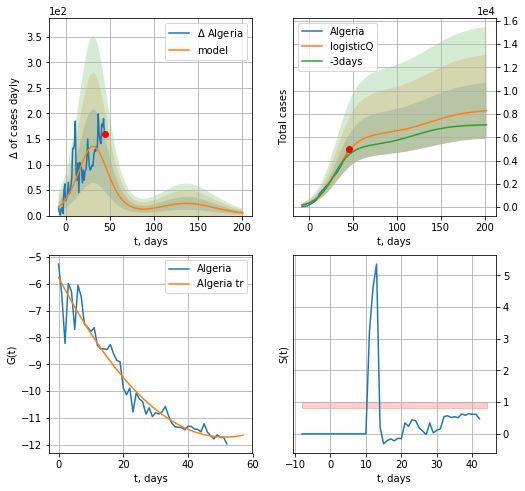

Algeria data at: 2020-05-06
+3 day model MAPE: 0.072739
model: logisticQ
coeffs: [ 6.20472536e+03  1.56562393e-06  3.15598410e+01 -5.54766435e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.290020
forecast at the end of period: +157 days
	 deltaDaycases: 5
	 total cases: 8278 ± 2400
	 total death: 788 ± 685
trend coefficient of determination: 0.943425
 intercept_: -5.761245427265177
 coeffs_: [ 0.         -0.23174035  0.00225547]


In [301]:
x = forecastRRR("Algeria",dfAR[10:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

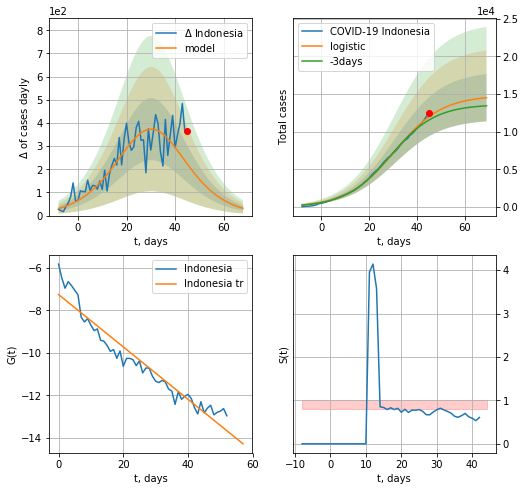

Indonesia data at: 2020-05-06
+3 day model MAPE: 0.04053656387677737
model: logistic
coeffs:  [1.48257543e+04 1.00747992e-01 3.06736827e+01]
rational stdev:  0.2158048608456683
forecast at the end of period: +24 days
	 deltaDaycases:  31
	 total cases:  14520 ± 3133
	 total death:  1044 ± 675
trend coefficient of determination: 0.929788
 intercept: -7.261235
 slope: -0.122925


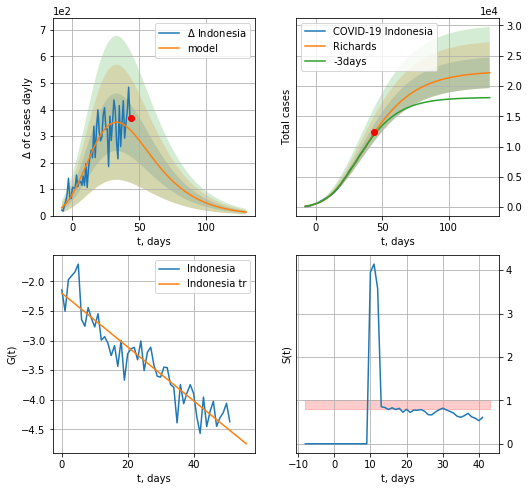

Indonesia data at: 2020-05-06
+3 day model MAPE: 0.026570
model: Richards
coeffs: [ 2.24759859e+04  4.94983739e-01 -2.08326946e+01  8.98509797e-02]
rational stdev: 0.113709
forecast at the end of period: +87 days
	 deltaDaycases: 13
	 total cases: 22185 ± 2522
	 total death: 1596 ± 544
trend coefficient of determination: 0.867684
 intercept: -2.199423
 slope: -0.045449


In [302]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


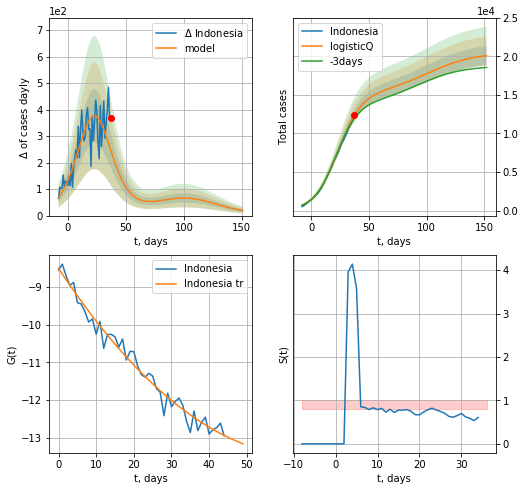

Indonesia data at: 2020-05-06
+3 day model MAPE: 0.034911
model: logisticQ
coeffs: [ 1.51470570e+04  1.02507192e-05  2.31864741e+01 -9.53618881e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.061695
forecast at the end of period: +115 days
	 deltaDaycases: 18
	 total cases: 20107 ± 1240
	 total death: 1446 ± 267
trend coefficient of determination: 0.973929
 intercept_: -8.504741604492688
 coeffs_: [ 0.         -0.15125814  0.00114583]


In [303]:
x = forecastRRR("Indonesia",dfIE[13:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


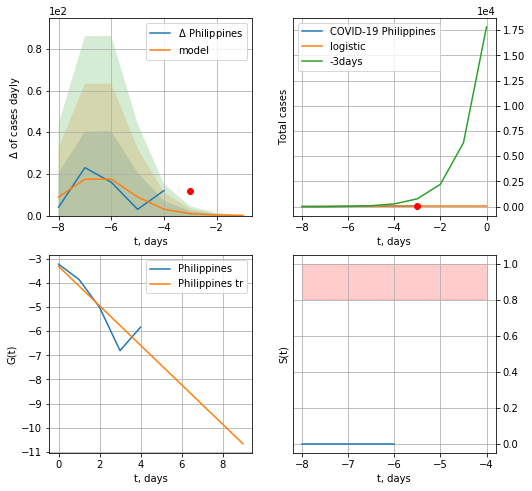

Philippines data at: 2020-05-06
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


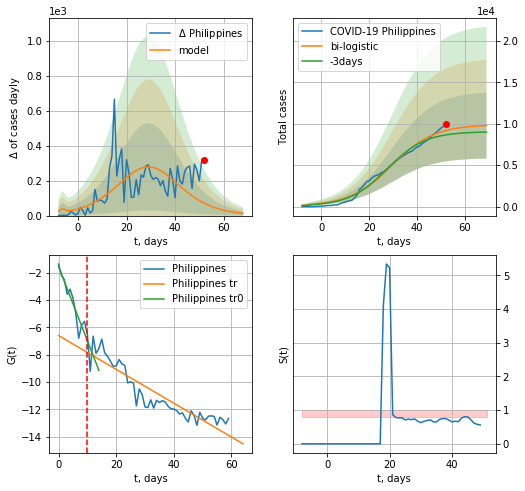

Philippines data at: 2020-05-06
+3 day model MAPE: 0.06388770655483937
model: bi-logistic
coeffs:  [9.82905271e+03 1.13714618e-01 2.95298889e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.40587983285844154
forecast at the end of period: +17 days
	 deltaDaycases:  12
	 total cases:  9781 ± 3970
	 total death:  643 ± 782
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.838055
 intercept: -6.602452
 slope: -0.123590


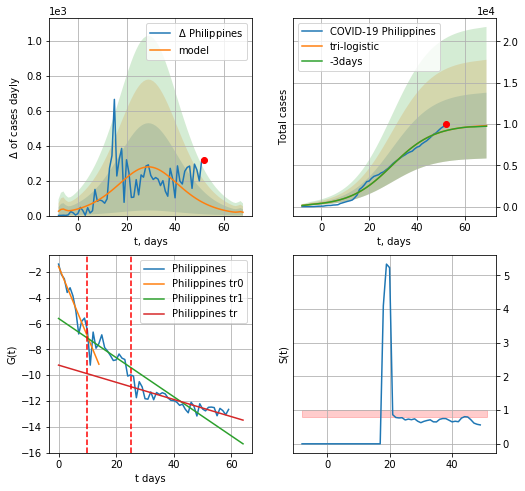

Philippines data at: 2020-05-06
+3 day model MAPE: 3.1651486677988256e-10
model: tri-logistic
coeffs:  [23.08970723  1.46924792 67.65954927] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  9.82905271e+03
  1.13714618e-01  2.95298889e+01]
forecast rational stdev:  0.40587983285843676
forecast at the end of period: +17 days
	 deltaDaycases:  18
	 total cases:  9801 ± 3978
	 total death:  644 ± 784
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.727164
 intercept: -9.218284
 slope: -0.066627


In [304]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,6*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


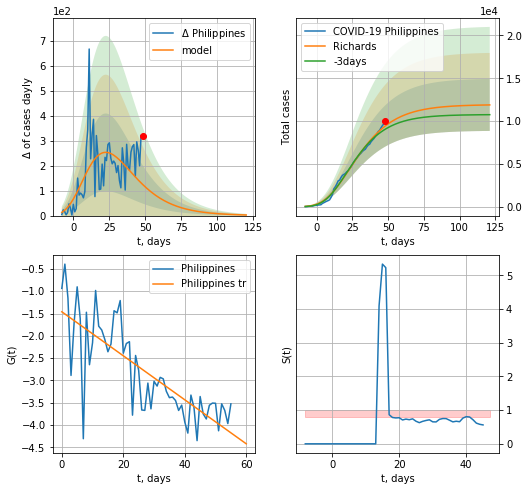

Philippines data at: 2020-05-06
+3 day model MAPE: 0.044252
model: Richards
coeffs: [ 1.19237105e+04  6.40298692e+00 -5.82471410e+01  9.04816271e-03]
rational stdev: 0.255591
forecast at the end of period: +73 days
	 deltaDaycases: 2
	 total cases: 11883 ± 3037
	 total death: 781 ± 598
trend coefficient of determination: 0.618090
 intercept: -1.461143
 slope: -0.049342


In [305]:
x = forecastRR("Philippines",dfPH[4:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


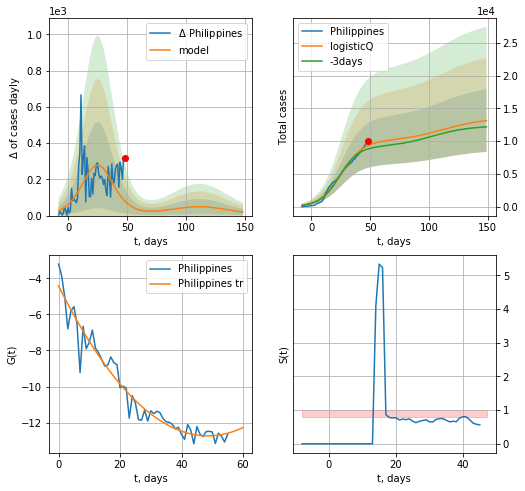

Philippines data at: 2020-05-06
+3 day model MAPE: 0.061104
model: logisticQ
coeffs: [ 9.96778361e+03  1.19331920e-06  2.55650852e+01 -9.29982625e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363503
forecast at the end of period: +101 days
	 deltaDaycases: 19
	 total cases: 13112 ± 4766
	 total death: 862 ± 940
trend coefficient of determination: 0.946887
 intercept_: -4.423261646607518
 coeffs_: [ 0.         -0.34190337  0.00352097]


In [306]:
x = forecastRRR("Philippines",dfPH[4:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
63 2020-05-02   2620    1103  143.0
64 2020-05-03   2626    1108  144.0
65 2020-05-04   2632    1112  146.0
66 2020-05-05   2642    1122  146.0
67 2020-05-06   2663    1142  147.0


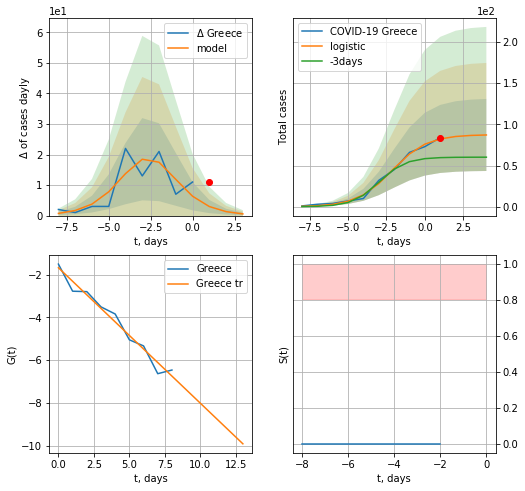

Greece data at: 2020-05-06
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


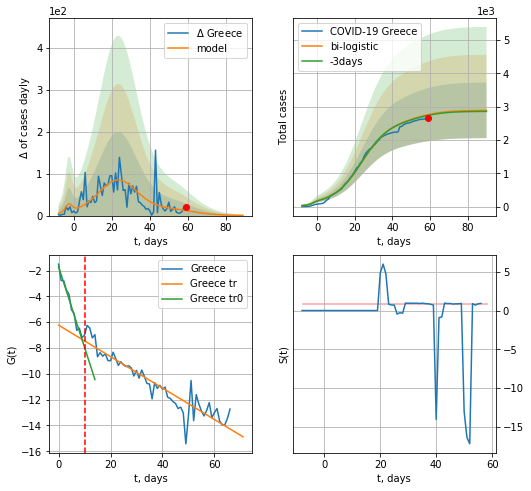

Greece data at: 2020-05-06
+3 day model MAPE: 0.008031792106335653
model: bi-logistic
coeffs:  [2.49620571e+03 1.35428484e-01 2.37714804e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.28871462902830064
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  2892 ± 835
	 total death:  159 ± 137
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.869156
 intercept: -6.232189
 slope: -0.121831


In [307]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,6*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

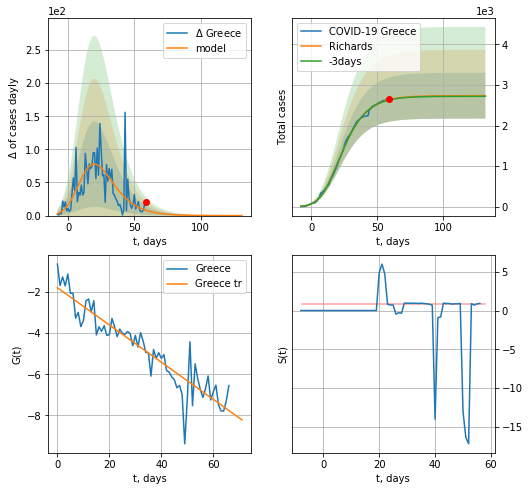

Greece data at: 2020-05-06
+3 day model MAPE: 0.003543
model: Richards
coeffs: [2.73533202e+03 3.95519892e-01 2.34187597e+00 2.16297167e-01]
rational stdev: 0.206668
forecast at the end of period: +73 days
	 deltaDaycases: 0
	 total cases: 2735 ± 565
	 total death: 150 ± 93
trend coefficient of determination: 0.857252
 intercept: -1.793818
 slope: -0.090436


In [308]:
x = forecastRR("Greece",dfGC[:],d1,16*7-dT,addpred=False,xcoef=[.35/4,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


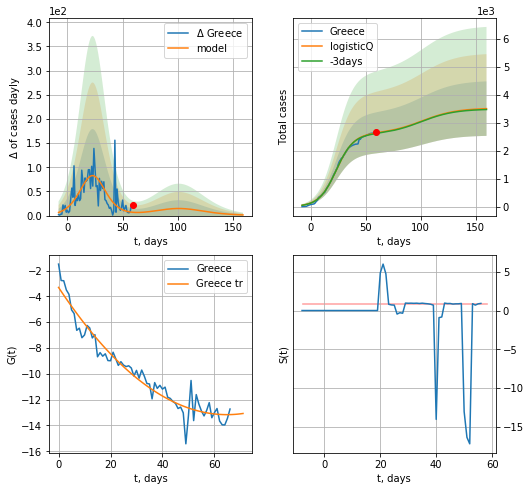

Greece data at: 2020-05-06
+3 day model MAPE: 0.008640
model: logisticQ
coeffs: [ 2.60343703e+03  1.24831139e-06  2.32418615e+01 -1.01401798e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277939
forecast at the end of period: +101 days
	 deltaDaycases: 1
	 total cases: 3504 ± 973
	 total death: 193 ± 160
trend coefficient of determination: 0.937900
 intercept_: -3.3089918691869133
 coeffs_: [ 0.         -0.3042079   0.00234725]


In [309]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
57 2020-05-02   2998    2029  340.0
58 2020-05-03   3035    2054  351.0
59 2020-05-04   3065    1993  363.0
60 2020-05-05   3111    1979  373.0
61 2020-05-06   3111    1979  373.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

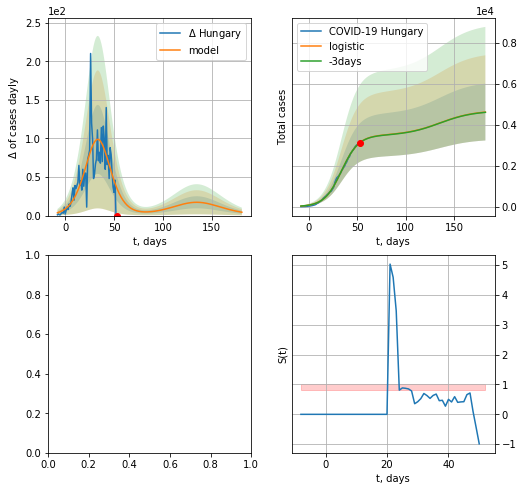

In [310]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,24*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


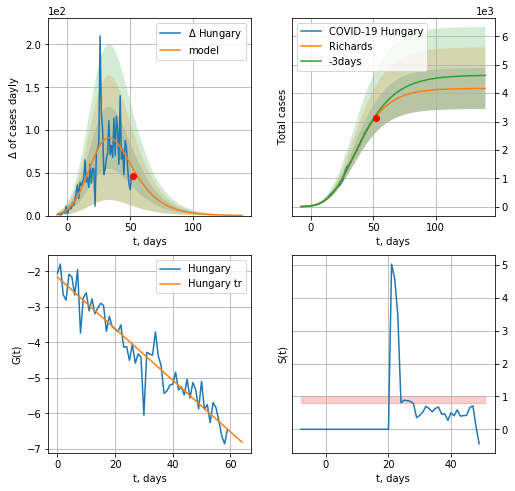

Hungary data at: 2020-05-05
+3 day model MAPE: 0.020603
model: Richards
coeffs: [4.16686702e+03 2.43041212e-01 1.46069218e+01 2.77708400e-01]
rational stdev: 0.173546
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 4163 ± 722
	 total death: 499 ± 259
trend coefficient of determination: 0.904814
 intercept: -2.158582
 slope: -0.072649


In [287]:
x = forecastRR("Hungary",dfHG[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


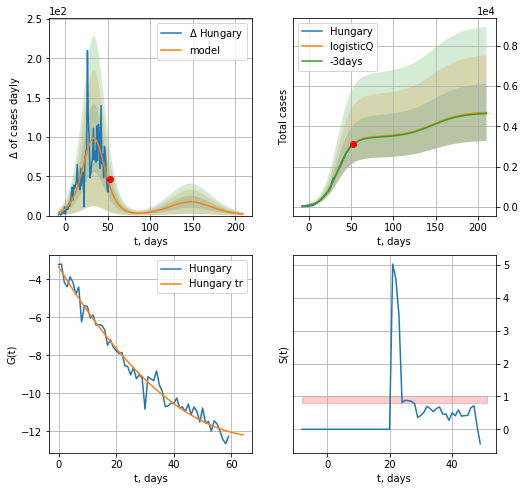

Hungary data at: 2020-05-05
+3 day model MAPE: 0.007322
model: logisticQ
coeffs: [ 3.49051413e+03  2.85866410e-06  3.38316389e+01 -3.94897402e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302468
forecast at the end of period: +158 days
	 deltaDaycases: 1
	 total cases: 4692 ± 1419
	 total death: 562 ± 509
trend coefficient of determination: 0.975824
 intercept_: -3.3323740965411393
 coeffs_: [ 0.         -0.24996813  0.00174464]


In [288]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


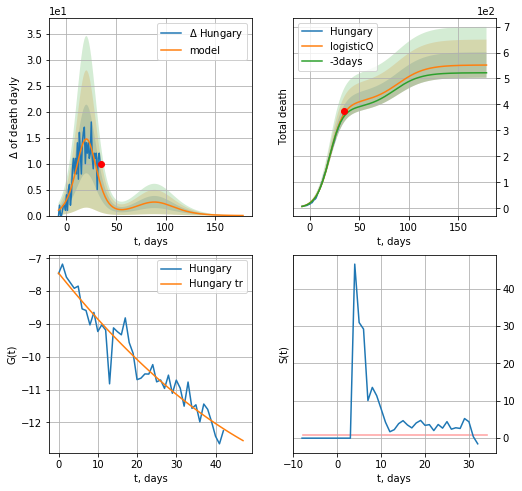

Hungary data at: 2020-05-05
+3 day model MAPE: 0.030257
model: logisticQ
coeffs: [ 4.07626605e+02  2.94695844e-05  2.04448425e+01 -4.86627455e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.088811
forecast at the end of period: +144 days
	 total death: 551 ± 49
trend coefficient of determination: 0.925986
 intercept_: -7.450204345379554
 coeffs_: [ 0.         -0.14885832  0.00085553]


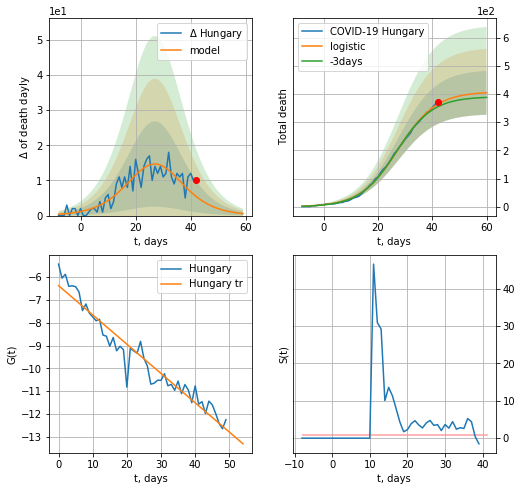

Hungary data at: 2020-05-05
+3 day model MAPE: 0.027111225330766826
model: logistic
coeffs:  [4.08120270e+02 1.43938429e-01 2.74568702e+01]
rational stdev:  0.19220365611720233
forecast at the end of period: +18 days
	 total death:  404 ± 77
trend coefficient of determination: 0.934516
 intercept: -6.370071
 slope: -0.128634


In [289]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
55 2020-05-02  468.0      85    4.0
56 2020-05-03  477.0      81    4.0
57 2020-05-04  480.0      77    4.0
58 2020-05-05  482.0      74    5.0
59 2020-05-06  484.0      72    5.0


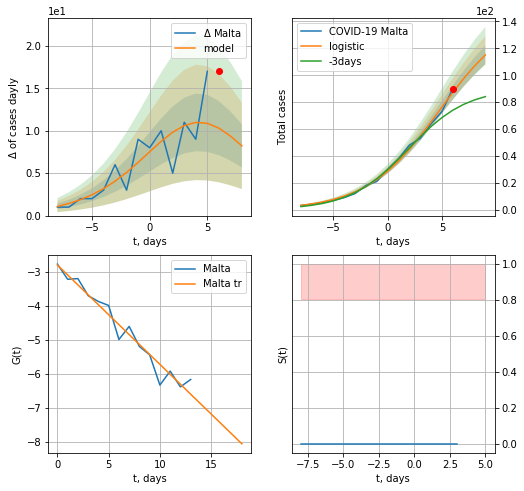

Malta data at: 2020-05-06
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  115 ± 6
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


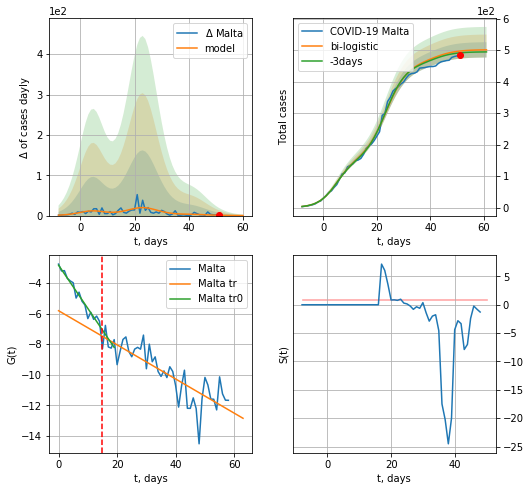

Malta data at: 2020-05-06
+3 day model MAPE: 0.012024139741261498
model: bi-logistic
coeffs:  [3.14398123e+02 2.49022734e-01 2.34422626e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.04849359681361832
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  501 ± 24
	 total death:  5 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.691918
 intercept: -5.816425
 slope: -0.111559


In [311]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,6*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


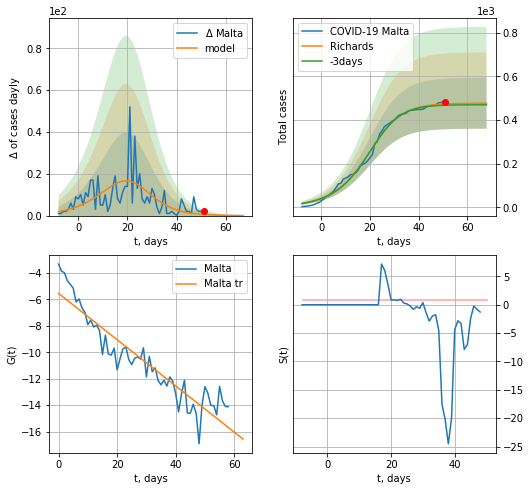

Malta data at: 2020-05-06
+3 day model MAPE: 0.012672
model: Richards
coeffs: [4.76723528e+02 1.12009990e-01 2.20823400e+01 1.39589871e+00]
rational stdev: 0.244594
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 476 ± 116
	 total death: 4 ± 2
trend coefficient of determination: 0.868326
 intercept: -5.541548
 slope: -0.175083


In [312]:
x = forecastRR("Malta",dfMT[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


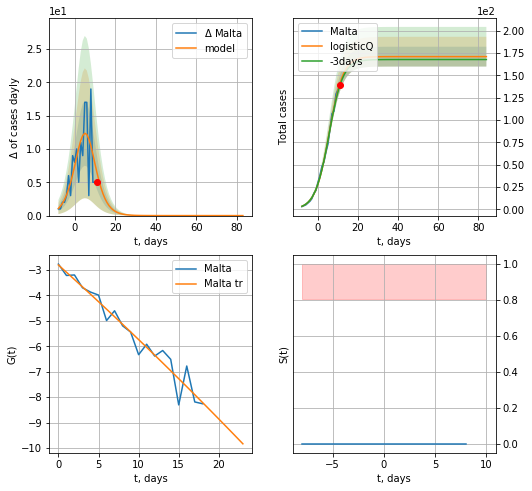

Malta data at: 2020-05-06
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +73 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


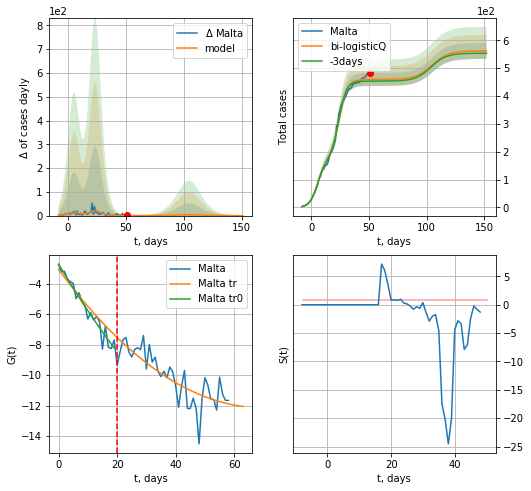

Malta data at: 2020-05-06
+3 day model MAPE: 0.013777
model: bi-logisticQ
coeffs: [ 2.88785959e+02  1.66134927e-06  2.40484726e+01 -1.69837227e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.051202
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 561 ± 28
	 total death: 5 ± 0
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.652125
 intercept_: -3.075545681939687
 coeffs_: [ 0.         -0.26030396  0.00186761]


In [313]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=20)

SL
          date  cases  active  death
53 2020-05-02   1407   775.0   24.0
54 2020-05-03   1408   765.0   24.0
55 2020-05-04   1413   745.0   25.0
56 2020-05-05   1421   655.0   25.0
57 2020-05-06   1429   642.0   25.0


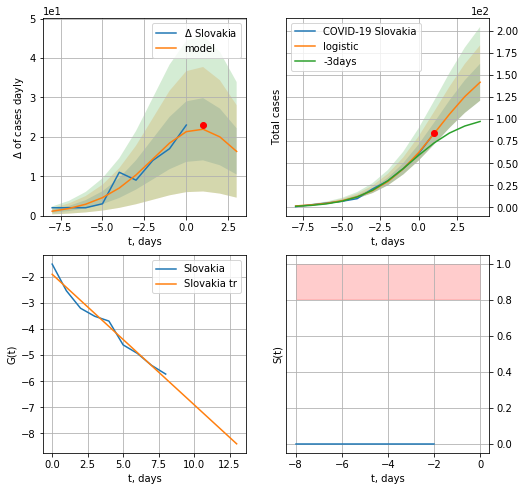

Slovakia data at: 2020-05-06
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +3 days
	 deltaDaycases:  16
	 total cases:  141 ± 20
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


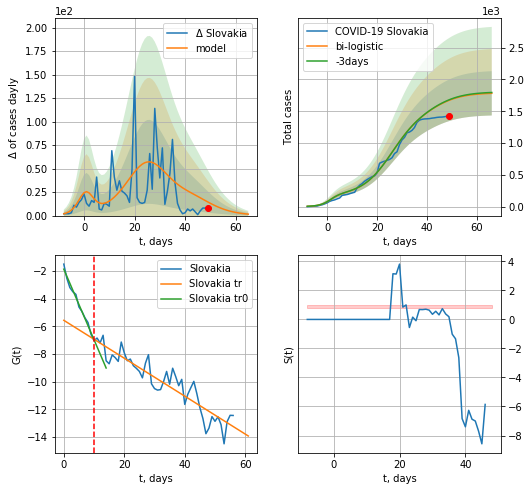

Slovakia data at: 2020-05-06
+3 day model MAPE: 0.004975004011255979
model: bi-logistic
coeffs:  [1.28992993e+03 1.69804652e-01 2.56699310e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.1953486479586483
forecast at the end of period: +17 days
	 deltaDaycases:  1
	 total cases:  1781 ± 347
	 total death:  31 ± 18
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.852076
 intercept: -5.568125
 slope: -0.137124


In [314]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
x = forecast("Slovakia",dfSL[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


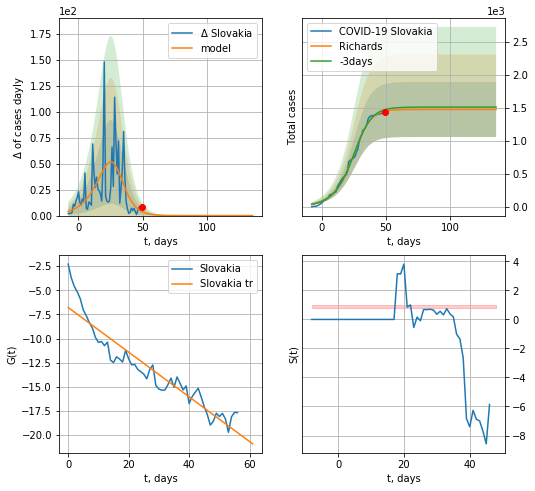

Slovakia data at: 2020-05-06
+3 day model MAPE: 0.016097
model: Richards
coeffs: [1.47362823e+03 9.94516739e-02 2.87166431e+01 1.71853205e+00]
rational stdev: 0.283114
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 1473 ± 417
	 total death: 25 ± 21
trend coefficient of determination: 0.886228
 intercept: -6.784997
 slope: -0.231440


In [315]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT)

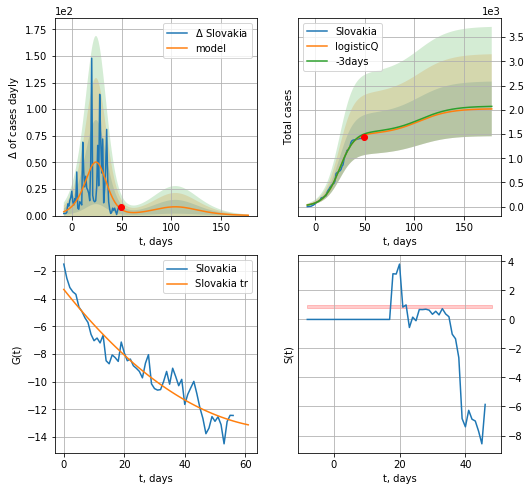

Slovakia data at: 2020-05-06
+3 day model MAPE: 0.016281
model: logisticQ
coeffs: [ 1.49428088e+03  5.10999034e-04  2.38848152e+01 -2.37831810e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.279675
forecast at the end of period: +129 days
	 deltaDaycases: 0
	 total cases: 2018 ± 564
	 total death: 35 ± 29
trend coefficient of determination: 0.909512
 intercept_: -3.336301391887657
 coeffs_: [ 0.         -0.27469299  0.00187201]


In [316]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
58 2020-05-02  1439.0  1106.0   94.0
59 2020-05-03  1439.5  1102.0   96.0
60 2020-05-04  1439.8  1101.0   97.0
61 2020-05-05  1445.0  1103.0   98.0
62 2020-05-06  1448.0  1103.0   99.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


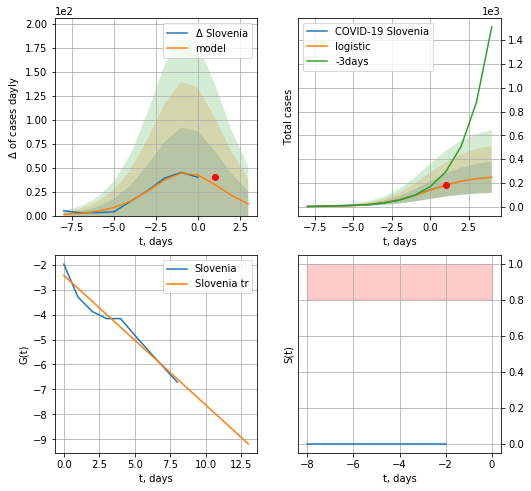

Slovenia data at: 2020-05-06
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +3 days
	 deltaDaycases:  12
	 total cases:  247 ± 131
	 total death:  16 ± 25
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


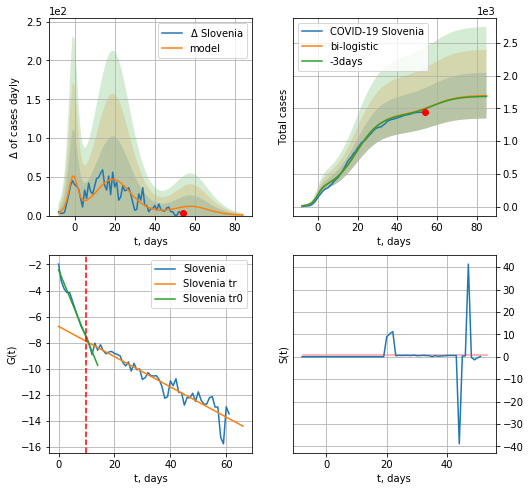

Slovenia data at: 2020-05-06
+3 day model MAPE: 0.004040091716689529
model: bi-logistic
coeffs:  [1.14975072e+03 1.62543154e-01 1.95345140e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.20624836691784956
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  1694 ± 349
	 total death:  115 ± 71
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.900534
 intercept: -6.747738
 slope: -0.115882


In [319]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
x = forecast("Slovenia",dfSV[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


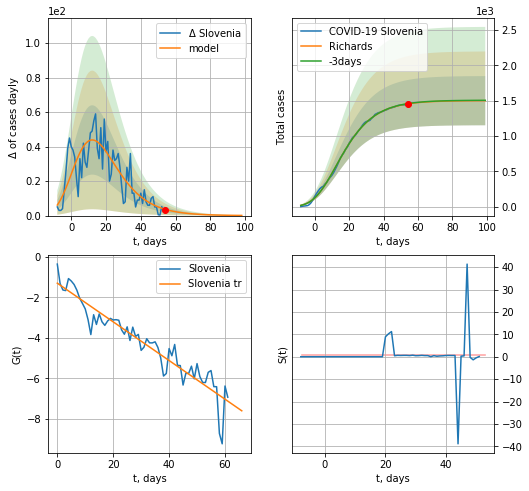

Slovenia data at: 2020-05-06
+3 day model MAPE: 0.002212
model: Richards
coeffs: [ 1.50089329e+03  8.13832837e-01 -1.46809077e+01  1.02684102e-01]
rational stdev: 0.231989
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 1499 ± 347
	 total death: 102 ± 70
trend coefficient of determination: 0.890438
 intercept: -1.305536
 slope: -0.095304


In [320]:
x = forecastRR("Slovenia",dfSV[:],d1,12*7-dT)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


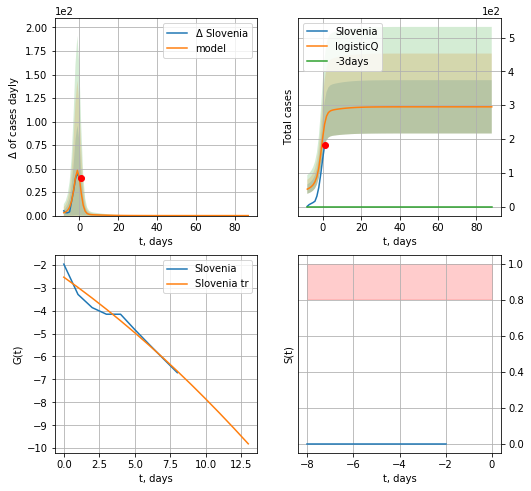

Slovenia data at: 2020-05-06
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 20 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


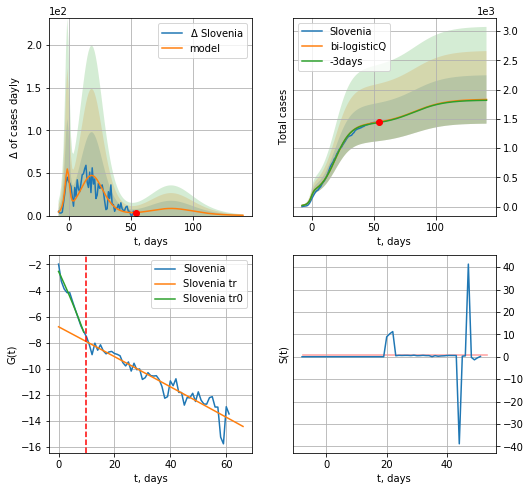

Slovenia data at: 2020-05-06
+3 day model MAPE: 0.006668
model: bi-logisticQ
coeffs: [ 1.19467928e+03  1.00242254e-06  1.89940787e+01 -1.56636414e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.225719
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 1831 ± 413
	 total death: 125 ± 84
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.900541
 intercept_: -6.7769313501791
 coeffs_: [ 0.00000000e+00 -1.13893777e-01 -2.78723201e-05]


In [321]:

print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
53 2020-05-02   9362  7747.0  189.0
54 2020-05-03   9464  7720.0  193.0
55 2020-05-04   9557  7786.0  197.0
56 2020-05-05   9677  7754.0  200.0
57 2020-05-06   9791  7617.0  203.0


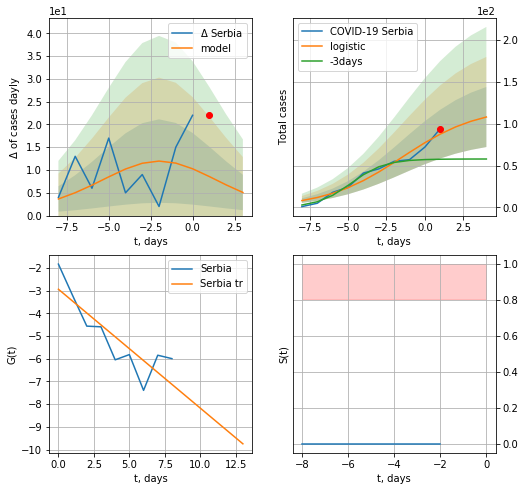

Serbia data at: 2020-05-06
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +3 days
	 deltaDaycases:  5
	 total cases:  107 ± 35
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


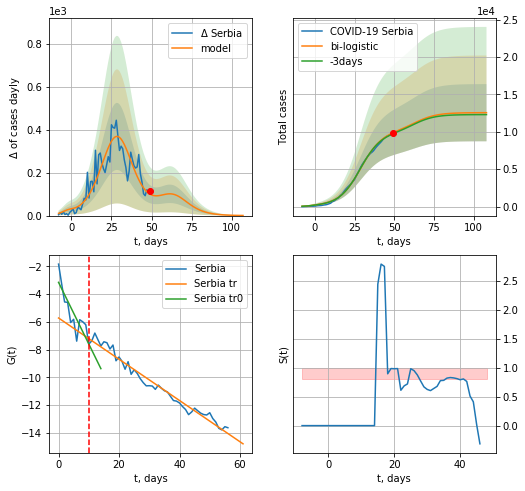

Serbia data at: 2020-05-06
+3 day model MAPE: 0.013752336933530939
model: bi-logistic
coeffs:  [9.95092504e+03 1.47867942e-01 2.88510937e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.30444891991930056
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  12555 ± 3822
	 total death:  260 ± 237
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.971728
 intercept: -5.721372
 slope: -0.148894


In [323]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


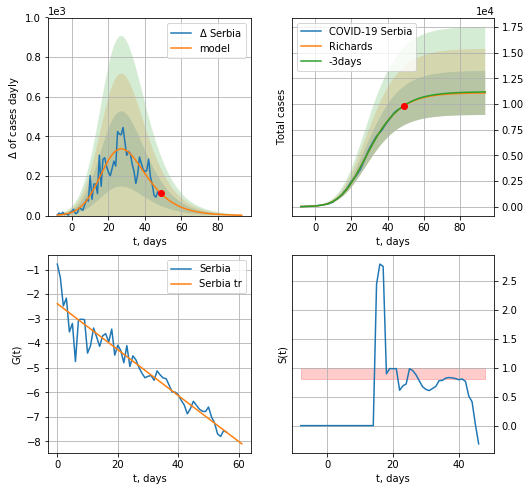

Serbia data at: 2020-05-06
+3 day model MAPE: 0.003307
model: Richards
coeffs: [1.10976151e+04 2.79101936e-01 1.65061258e+01 3.45884014e-01]
rational stdev: 0.193579
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 11079 ± 2144
	 total death: 229 ± 132
trend coefficient of determination: 0.914337
 intercept: -2.393328
 slope: -0.093574


In [324]:
x = forecastRR("Serbia",dfSB[:],d1,12*7-dT)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


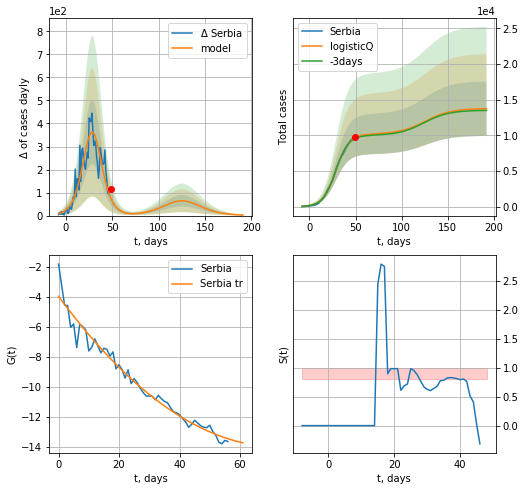

Serbia data at: 2020-05-06
+3 day model MAPE: 0.013215
model: logisticQ
coeffs: [ 1.01607028e+04  3.01132695e-06  2.87922532e+01 -4.72815540e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278511
forecast at the end of period: +143 days
	 deltaDaycases: 2
	 total cases: 13728 ± 3823
	 total death: 284 ± 237
trend coefficient of determination: 0.968077
 intercept_: -3.9718884855536176
 coeffs_: [ 0.         -0.27398708  0.00186854]


In [325]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date  cases  active  death
63 2020-05-02   2088   548.0   77.0
64 2020-05-03   2096   528.0   79.0
65 2020-05-04   2101   499.0   80.0
66 2020-05-05   2112   469.0   83.0
67 2020-05-06   2119   433.0   85.0


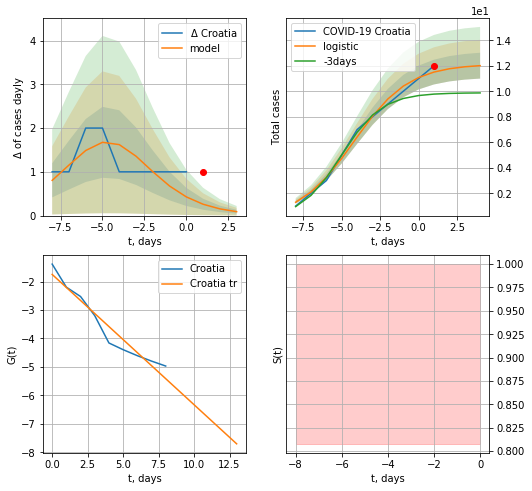

Croatia data at: 2020-05-06
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


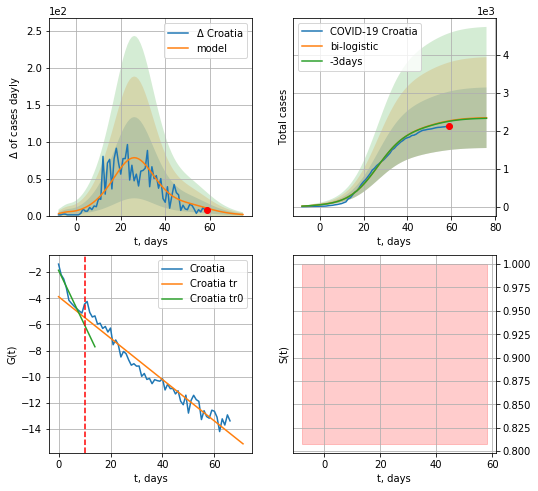

Croatia data at: 2020-05-06
+3 day model MAPE: 0.00521680122828077
model: bi-logistic
coeffs:  [2.07643496e+03 1.49354810e-01 2.64566009e+01] [12.13023855  0.55939634 -4.20963748]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.3404824101760434
forecast at the end of period: +17 days
	 deltaDaycases:  1
	 total cases:  2338 ± 796
	 total death:  93 ± 94
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.948867
 intercept: -3.874935
 slope: -0.158459


In [326]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


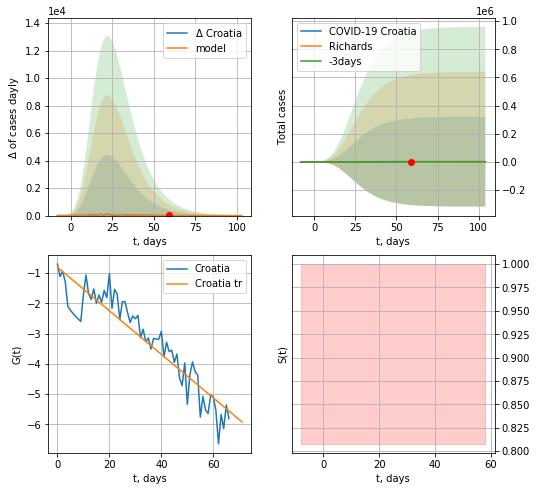

Croatia data at: 2020-05-06
+3 day model MAPE: 0.002384
model: Richards
coeffs: [ 2.21059090e+03  6.84920496e+00 -2.50139386e+01  1.32549153e-02]
rational stdev: 144.344669
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 2209 ± 318889
	 total death: 88 ± 38106
trend coefficient of determination: 0.857741
 intercept: -0.805027
 slope: -0.072042


In [327]:
x = forecastRR("Croatia",dfCT[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


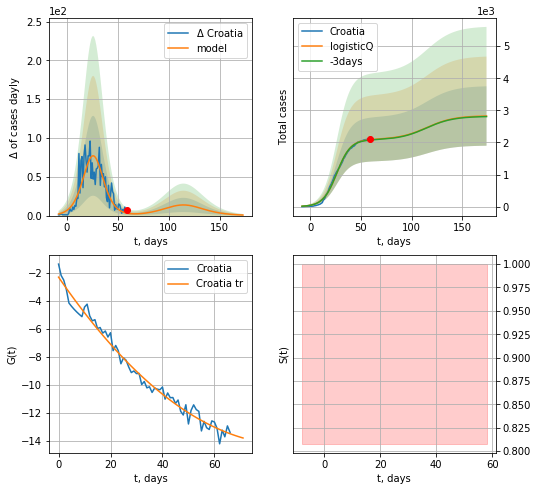

Croatia data at: 2020-05-06
+3 day model MAPE: 0.006123
model: logisticQ
coeffs: [ 2.09162538e+03  1.27007364e-06  2.63769372e+01 -1.16016975e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327760
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 2823 ± 925
	 total death: 113 ± 111
trend coefficient of determination: 0.981654
 intercept_: -2.3149967969654295
 coeffs_: [ 0.         -0.26917062  0.00151789]


In [328]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
57 2020-05-02   6193    4256  415.0
58 2020-05-03   6465    4474  429.0
59 2020-05-04   6813    4745  436.0
60 2020-05-05   7201    5019  452.0
61 2020-05-06   7588    5304  469.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


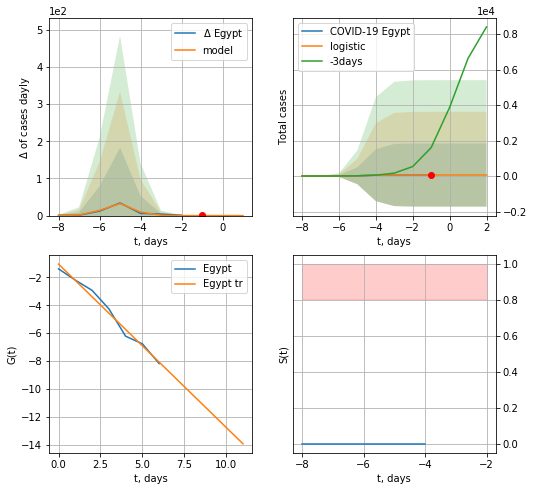

Egypt data at: 2020-05-06
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


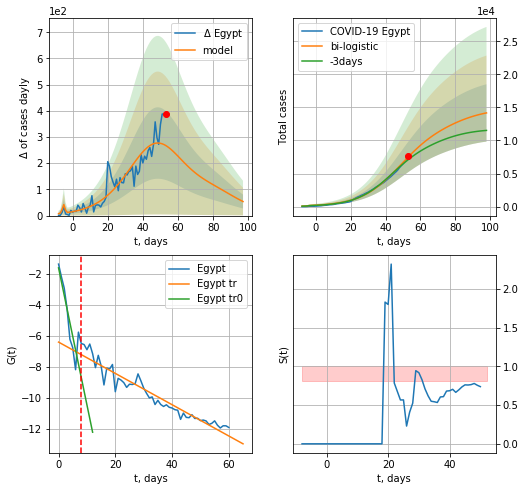

Egypt data at: 2020-05-06
+3 day model MAPE: 0.06349750500470301
model: bi-logistic
coeffs:  [1.18378722e+04 8.94801866e-02 4.79815018e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.30591750884449787
forecast at the end of period: +45 days
	 deltaDaycases:  53
	 total cases:  14169 ± 4334
	 total death:  875 ± 803
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.925195
 intercept: -6.410160
 slope: -0.100808


In [329]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,6*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


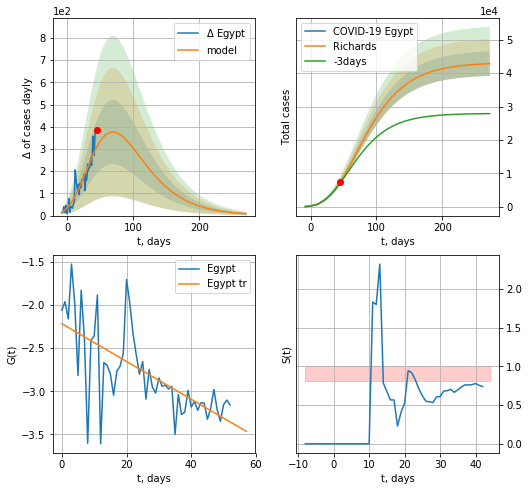

Egypt data at: 2020-05-06
+3 day model MAPE: 0.038259
model: Richards
coeffs: [ 4.31938150e+04  1.17266957e+00 -9.31490064e+01  2.04029481e-02]
rational stdev: 0.085490
forecast at the end of period: +227 days
	 deltaDaycases: 8
	 total cases: 42855 ± 3663
	 total death: 2648 ± 679
trend coefficient of determination: 0.456299
 intercept: -2.217009
 slope: -0.021877


In [331]:
x = forecastRR("Egypt",dfEG[8:],d1,38*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


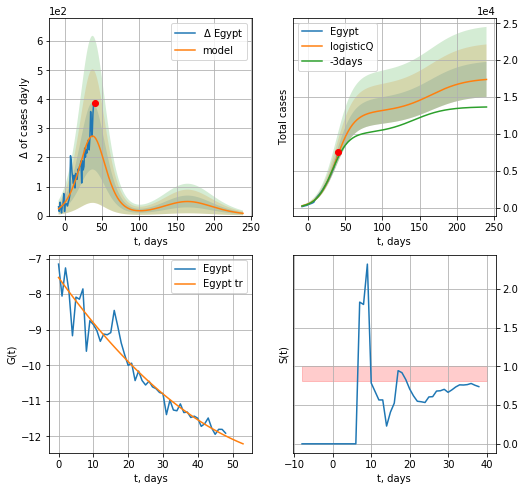

Egypt data at: 2020-05-06
+3 day model MAPE: 0.067241
model: logisticQ
coeffs: [ 1.29755016e+04  8.57575921e-06  3.79019567e+01 -9.77153064e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.136493
forecast at the end of period: +199 days
	 deltaDaycases: 7
	 total cases: 17383 ± 2372
	 total death: 1074 ± 439
trend coefficient of determination: 0.936931
 intercept_: -7.531489045201826
 coeffs_: [ 0.         -0.13635534  0.00090747]


In [332]:
x = forecastRRR("Egypt",dfEG[12:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
60 2020-05-02   2219   651.0   95.0
61 2020-05-03   2296   709.0   97.0
62 2020-05-04   2346   704.0   98.0
63 2020-05-05   2431   758.0  102.0
64 2020-05-06   2480   776.0  102.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


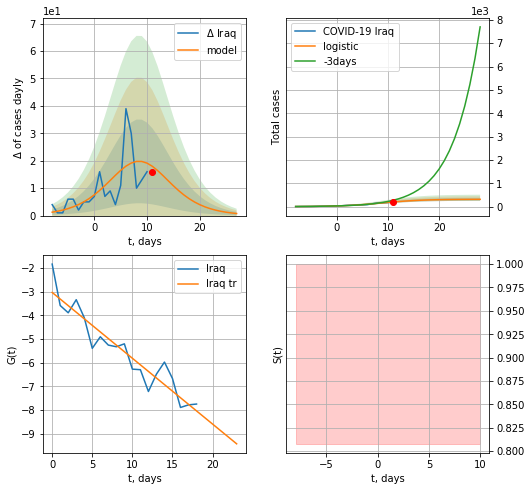

Iraq data at: 2020-05-06
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  314 ± 65
	 total death:  12 ± 7
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


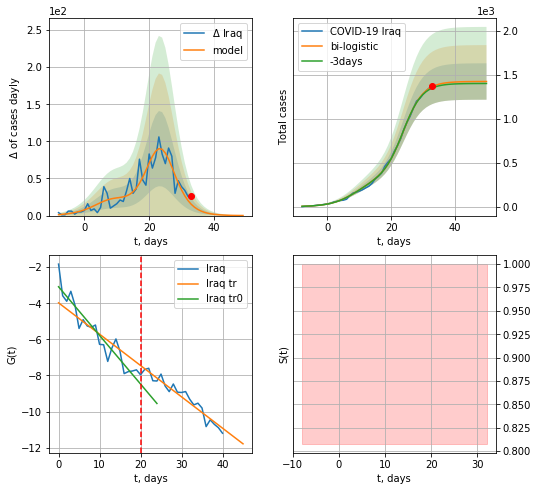

Iraq data at: 2020-05-06
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  58 ± 25
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


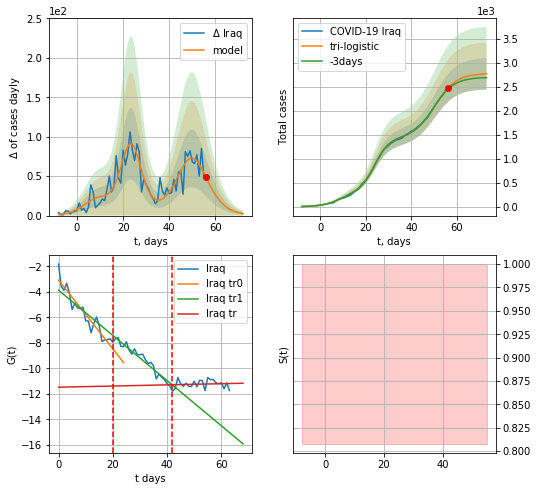

Iraq data at: 2020-05-06
+3 day model MAPE: 0.013189064296822366
model: tri-logistic
coeffs:  [1.35608297e+03 2.14800365e-01 5.03062543e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.11789649005725775
forecast at the end of period: +17 days
	 deltaDaycases:  2
	 total cases:  2771 ± 326
	 total death:  113 ± 39
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.008343
 intercept: -11.486452
 slope: 0.004601


In [333]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


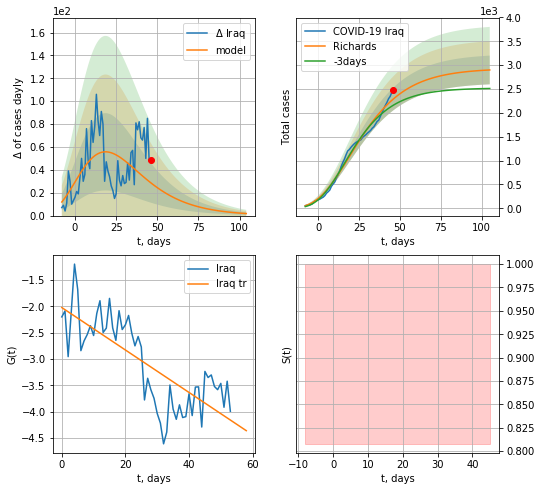

Iraq data at: 2020-05-06
+3 day model MAPE: 0.063894
model: Richards
coeffs: [ 2.93331670e+03  5.88423086e+00 -7.21413264e+01  8.81892488e-03]
rational stdev: 0.103794
forecast at the end of period: +59 days
	 deltaDaycases: 1
	 total cases: 2899 ± 300
	 total death: 119 ± 37
trend coefficient of determination: 0.587583
 intercept: -2.023975
 slope: -0.040292


In [334]:
x = forecastRR("Iraq",dfIQ[10:],d1,14*7-dT)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


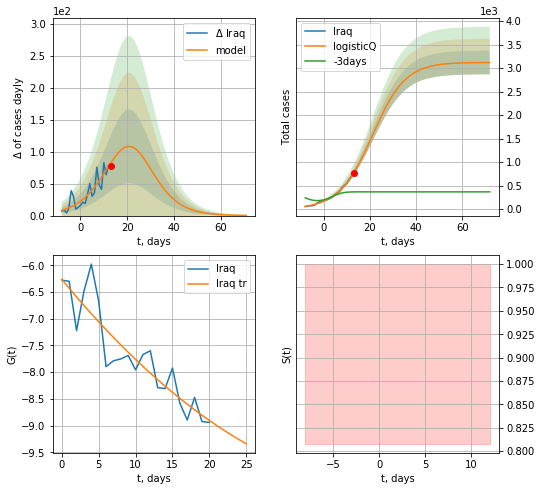

Iraq data at: 2020-05-06
+3 day model MAPE: 1.325310
model: logisticQ
coeffs: [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev: 0.080850
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 3118 ± 252
	 total death: 128 ± 31
trend coefficient of determination: 0.824005
 intercept_: -6.262912434952875
 coeffs_: [ 0.         -0.16770647  0.00178172]


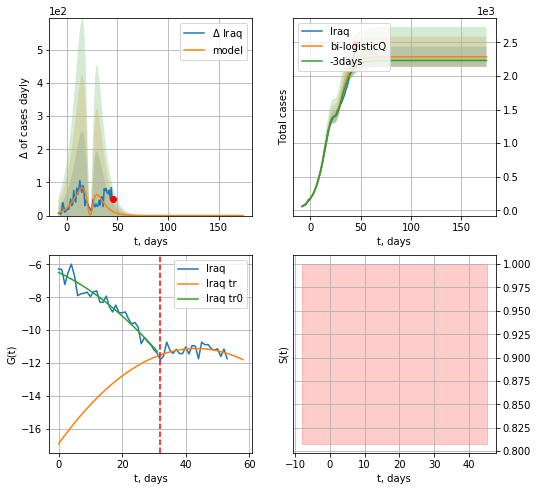

Iraq data at: 2020-05-06
+3 day model MAPE: 0.025153
model: bi-logisticQ
coeffs: [-8.35707149e+02  6.21773816e-03  2.33324922e+01 -5.72328085e+01]
rational stdev: 0.064994
forecast at the end of period: +129 days
	 deltaDaycases: 0
	 total cases: 2284 ± 148
	 total death: 93 ± 18
bi-logisticQ approximation splitting point: 32
trend coefficient of determination: 0.943011
 intercept_: -6.485709272215987
 coeffs_: [ 0.         -0.09183938 -0.00203399]
trend coefficient of determination: 0.193998
 intercept_: -16.926733767695588
 coeffs_: [ 0.          0.2689808  -0.00311393]


In [335]:
x = forecastRRR("Iraq",dfIQ[10:32],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=32)

In [336]:
#len(dfAR)

AR
          date   cases  active  death
59 2020-05-02  4295.0  1964.0  459.0
60 2020-05-03  4474.0  2075.0  463.0
61 2020-05-04  4648.0  2185.0  465.0
62 2020-05-05  4838.0  2301.0  470.0
63 2020-05-06  4997.0  2324.0  476.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


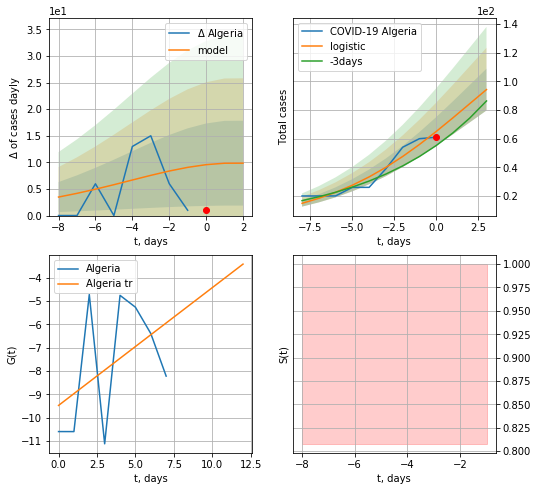

Algeria data at: 2020-05-06
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +3 days
	 deltaDaycases:  9
	 total cases:  94 ± 14
	 total death:  8 ± 3
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


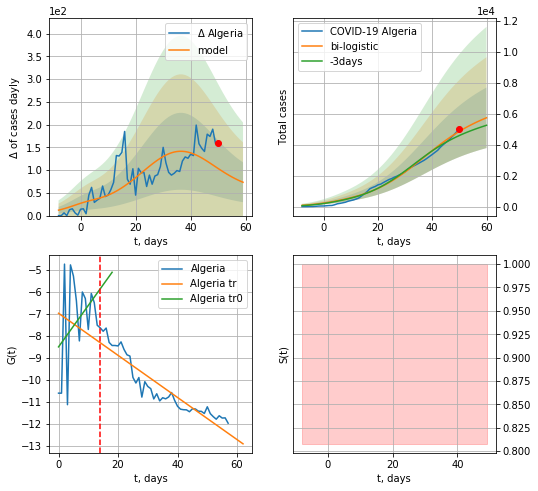

Algeria data at: 2020-05-06
+3 day model MAPE: 0.06315085046312448
model: bi-logistic
coeffs:  [5.79436188e+03 9.47116921e-02 3.62983300e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3398079934333212
forecast at the end of period: +10 days
	 deltaDaycases:  73
	 total cases:  5746 ± 1952
	 total death:  547 ± 557
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.867069
 intercept: -6.962561
 slope: -0.095789


In [337]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,6*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


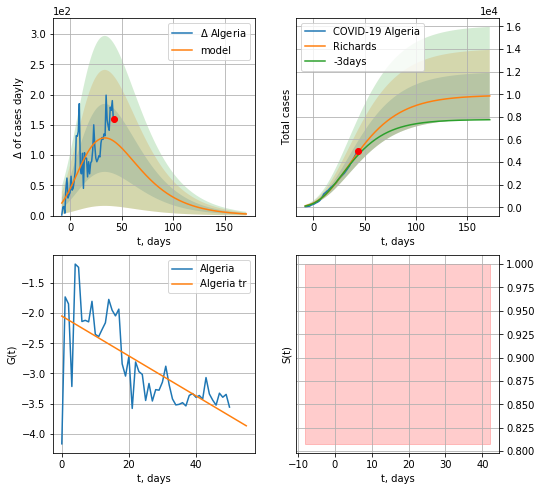

Algeria data at: 2020-05-06
+3 day model MAPE: 0.051162
model: Richards
coeffs: [ 9.92991341e+03  2.76826478e+00 -8.90446491e+01  1.27817962e-02]
rational stdev: 0.206641
forecast at the end of period: +129 days
	 deltaDaycases: 2
	 total cases: 9854 ± 2036
	 total death: 938 ± 581
trend coefficient of determination: 0.490006
 intercept: -2.050012
 slope: -0.033003


In [338]:
x = forecastRR("Algeria",dfAR[12:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


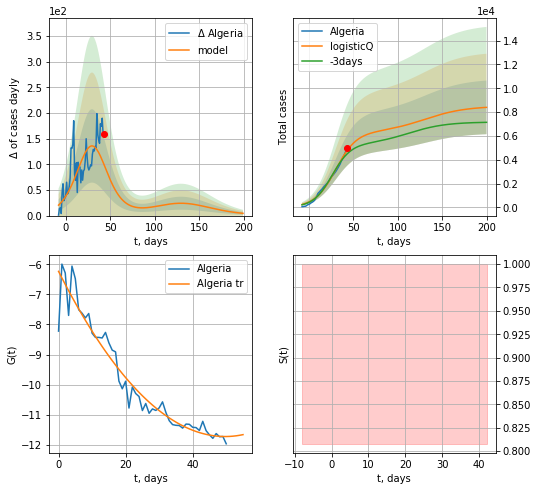

Algeria data at: 2020-05-06
+3 day model MAPE: 0.070318
model: logisticQ
coeffs: [ 6.27806646e+03  1.39263287e-06  2.98694520e+01 -6.16136908e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268376
forecast at the end of period: +157 days
	 deltaDaycases: 4
	 total cases: 8397 ± 2253
	 total death: 799 ± 643
trend coefficient of determination: 0.934141
 intercept_: -6.237057217580488
 coeffs_: [ 0.         -0.22081066  0.00222219]


In [339]:
x = forecastRRR("Algeria",dfAR[12:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
51 2020-05-02  864.0   553.0   15.0
52 2020-05-03  872.0   561.0   15.0
53 2020-05-04  874.0   563.0   15.0
54 2020-05-05  878.0   567.0   15.0
55 2020-05-06  883.0   572.0   15.0


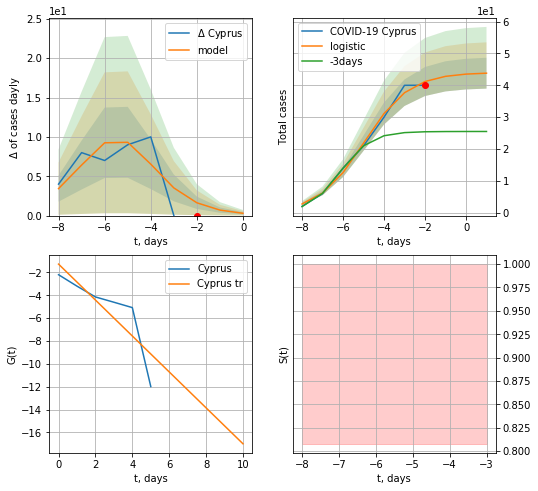

Cyprus data at: 2020-05-06
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


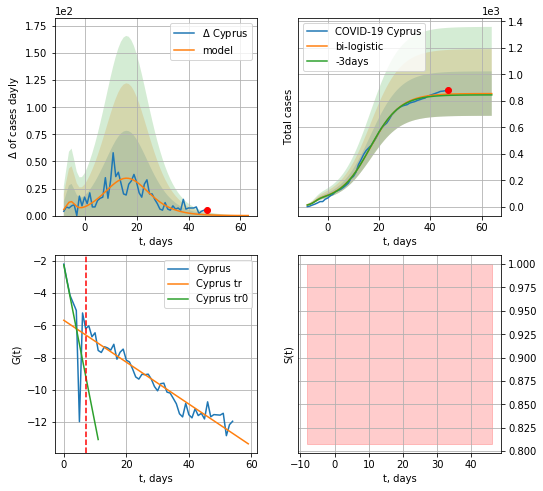

Cyprus data at: 2020-05-06
+3 day model MAPE: 0.011013682800014286
model: bi-logistic
coeffs:  [8.11542923e+02 1.70347148e-01 1.66605873e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19625629445132792
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  855 ± 167
	 total death:  14 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.937873
 intercept: -5.685777
 slope: -0.130055


In [340]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,6*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


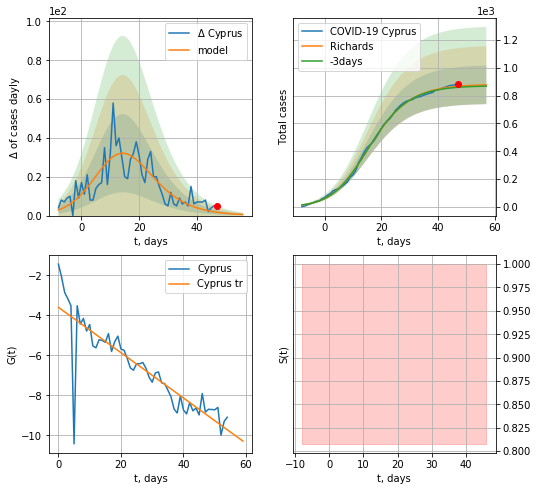

Cyprus data at: 2020-05-06
+3 day model MAPE: 0.009020
model: Richards
coeffs: [8.81689572e+02 2.19149892e-01 1.04451286e+01 5.78329280e-01]
rational stdev: 0.158182
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 877 ± 138
	 total death: 14 ± 6
trend coefficient of determination: 0.755399
 intercept: -3.603517
 slope: -0.113344


In [341]:
x = forecastRR("Cyprus",dfCP[:],d1,7*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


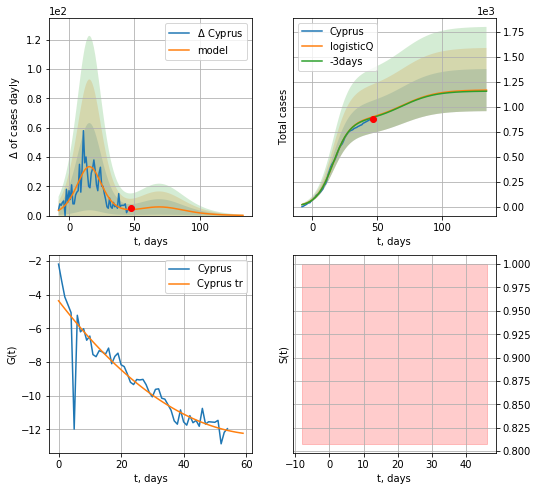

Cyprus data at: 2020-05-06
+3 day model MAPE: 0.007502
model: logisticQ
coeffs: [ 8.64986567e+02  2.77392496e-06  1.59789140e+01 -5.51304067e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.180479
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 1169 ± 211
	 total death: 19 ± 10
trend coefficient of determination: 0.835178
 intercept_: -4.370254106244324
 coeffs_: [ 0.         -0.24119629  0.00183094]


In [342]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active   death
56 2020-05-02  42534  28900.0  1200.0
57 2020-05-03  45928  31092.0  1286.0
58 2020-05-04  47372  31601.0  1344.0
59 2020-05-05  51189  34332.0  1444.0
60 2020-05-06  54817  35757.0  1533.0


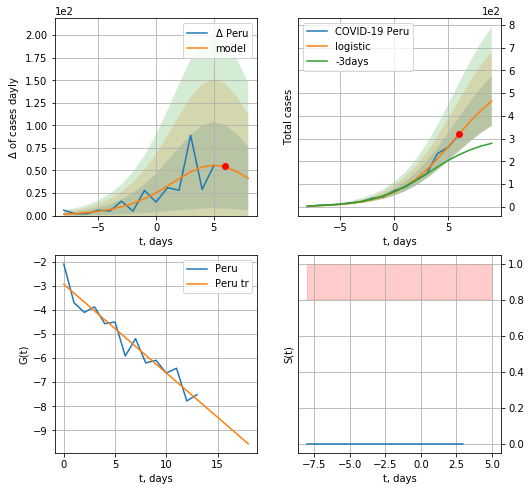

Peru data at: 2020-05-06
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +3 days
	 deltaDaycases:  41
	 total cases:  465 ± 108
	 total death:  13 ± 9
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


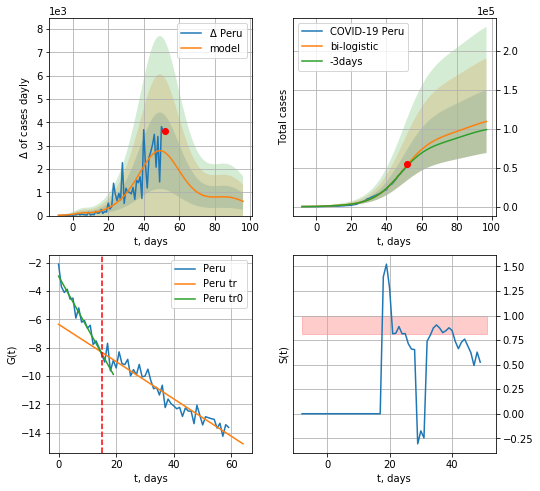

Peru data at: 2020-05-06
+3 day model MAPE: 0.0324734091705331
model: bi-logistic
coeffs:  [9.24629318e+04 1.19376342e-01 4.94847189e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.37022320121087393
forecast at the end of period: +45 days
	 deltaDaycases:  610
	 total cases:  109386 ± 40497
	 total death:  3059 ± 3397
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.923466
 intercept: -6.348134
 slope: -0.131888


In [343]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,6*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


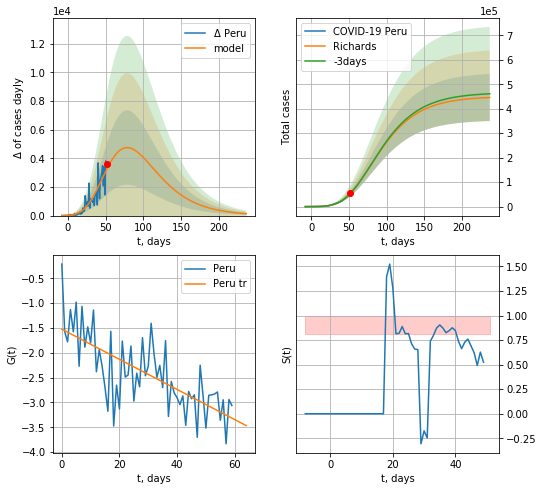

Peru data at: 2020-05-06
+3 day model MAPE: 0.002311
model: Richards
coeffs: [ 4.50454462e+05  9.18083298e-01 -3.95982911e+01  3.17277819e-02]
rational stdev: 0.215667
forecast at the end of period: +185 days
	 deltaDaycases: 131
	 total cases: 445978 ± 96183
	 total death: 12472 ± 8069
trend coefficient of determination: 0.499314
 intercept: -1.524945
 slope: -0.030327


In [344]:
x = forecastRR("Peru",dfPU[:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


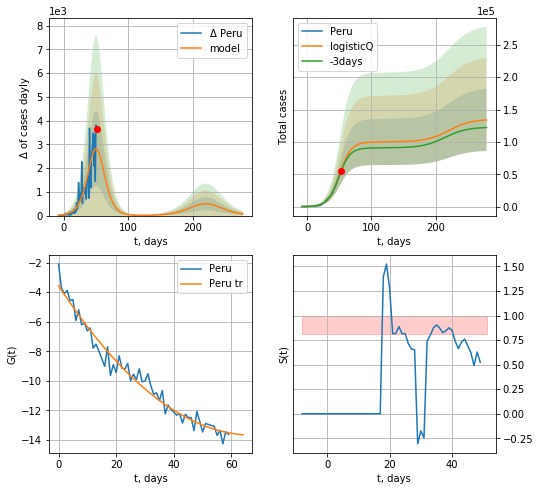

Peru data at: 2020-05-06
+3 day model MAPE: 0.023702
model: logisticQ
coeffs: [ 9.99340096e+04  5.95513828e-06  5.06134129e+01 -1.89094562e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357164
forecast at the end of period: +227 days
	 deltaDaycases: 69
	 total cases: 134081 ± 47889
	 total death: 3749 ± 4017
trend coefficient of determination: 0.966820
 intercept_: -3.5601379025946693
 coeffs_: [ 0.         -0.29921705  0.00221326]


In [345]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date  cases   active   death
63 2020-05-02  39980  27838.0  1323.0
64 2020-05-03  42533  29367.0  1391.0
65 2020-05-04  46437  32024.0  1566.0
66 2020-05-05  49436  33558.0  1695.0
67 2020-05-06  53025  35909.0  1785.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


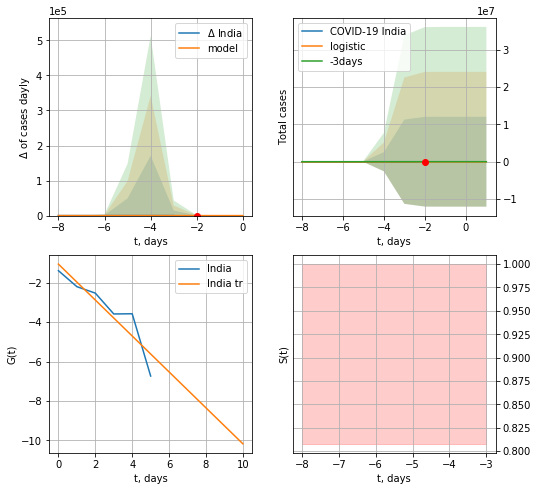

India data at: 2020-05-06
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


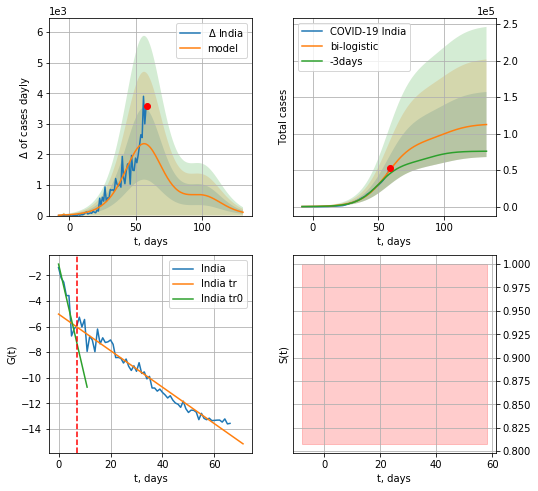

India data at: 2020-05-06
+3 day model MAPE: 0.13113617716468912
model: bi-logistic
coeffs:  [9.07911336e+04 1.02744331e-01 5.67731775e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3964819413028182
forecast at the end of period: +73 days
	 deltaDaycases:  108
	 total cases:  112464 ± 44590
	 total death:  3785 ± 4502
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.960232
 intercept: -5.024503
 slope: -0.142885


In [346]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,6*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


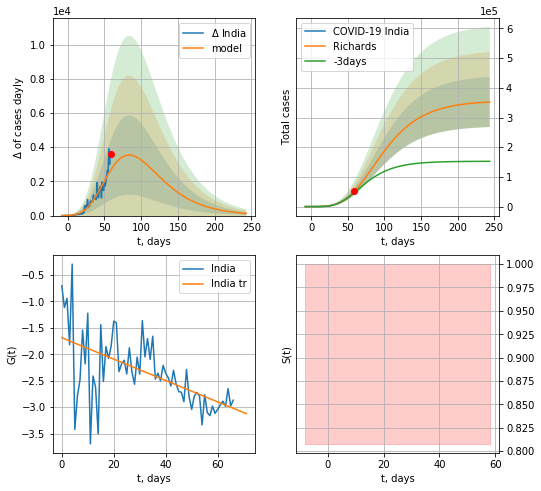

India data at: 2020-05-06
+3 day model MAPE: 0.083428
model: Richards
coeffs: [ 3.56990106e+05  1.67920688e+00 -6.77748592e+01  1.61746606e-02]
rational stdev: 0.239099
forecast at the end of period: +185 days
	 deltaDaycases: 125
	 total cases: 352383 ± 84254
	 total death: 11862 ± 8508
trend coefficient of determination: 0.334864
 intercept: -1.687496
 slope: -0.020222


In [347]:
x = forecastRR("India",dfID[:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


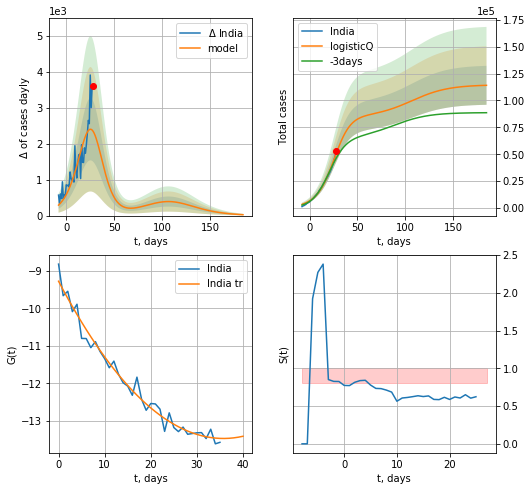

India data at: 2020-05-06
+3 day model MAPE: 0.109770
model: logisticQ
coeffs: [ 8.45751297e+04  4.41207967e-04  2.44207164e+01 -2.29010208e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.158551
forecast at the end of period: +157 days
	 deltaDaycases: 25
	 total cases: 114069 ± 18085
	 total death: 3839 ± 1826
trend coefficient of determination: 0.976610
 intercept_: -9.280671108158051
 coeffs_: [ 0.         -0.23422467  0.00327504]


In [348]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date   cases  active  death
59 2020-05-02  4681.0  3124.0  237.0
60 2020-05-03  4783.0  3183.0  246.0
61 2020-05-04  4887.0  3185.0  260.0
62 2020-05-05  5020.0  3284.0  264.0
63 2020-05-06  5208.0  3411.0  273.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


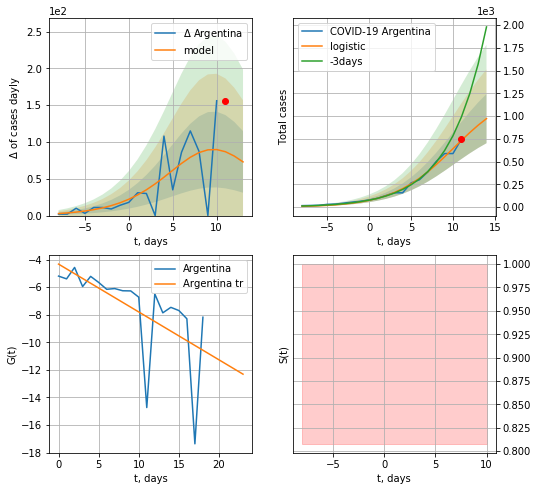

Argentina data at: 2020-05-06
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +3 days
	 deltaDaycases:  72
	 total cases:  972 ± 270
	 total death:  51 ± 42
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


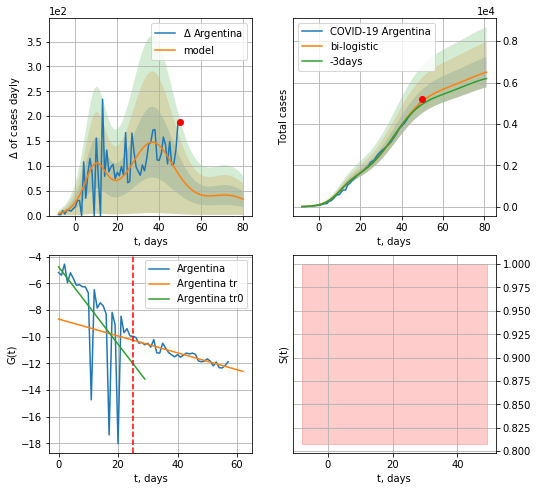

Argentina data at: 2020-05-06
+3 day model MAPE: 0.03091474820977454
model: bi-logistic
coeffs:  [4.42346793e+03 1.32516782e-01 3.71344808e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.11185094876764318
forecast at the end of period: +31 days
	 deltaDaycases:  32
	 total cases:  6500 ± 727
	 total death:  340 ± 114
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.862356
 intercept: -8.679305
 slope: -0.063280


In [349]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,6*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


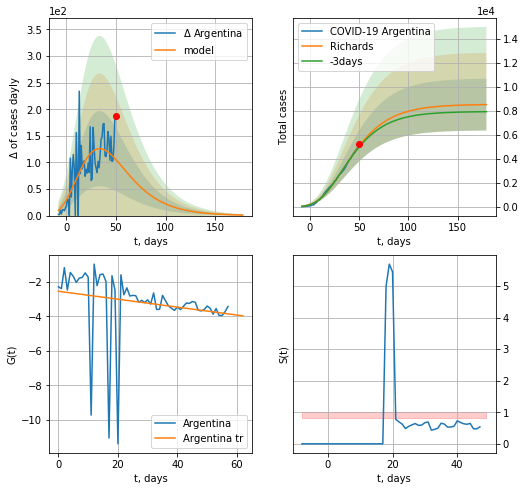

Argentina data at: 2020-05-06
+3 day model MAPE: 0.018405
model: Richards
coeffs: [ 8.55279331e+03  3.46319250e+00 -7.67799014e+01  1.16178804e-02]
rational stdev: 0.253325
forecast at the end of period: +129 days
	 deltaDaycases: 1
	 total cases: 8527 ± 2160
	 total death: 447 ± 339
trend coefficient of determination: 0.039483
 intercept: -2.541900
 slope: -0.022998


In [350]:
x = forecastRR('Argentina',dfAG[5:].fillna(0),d1,24*7-dT,1.0)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


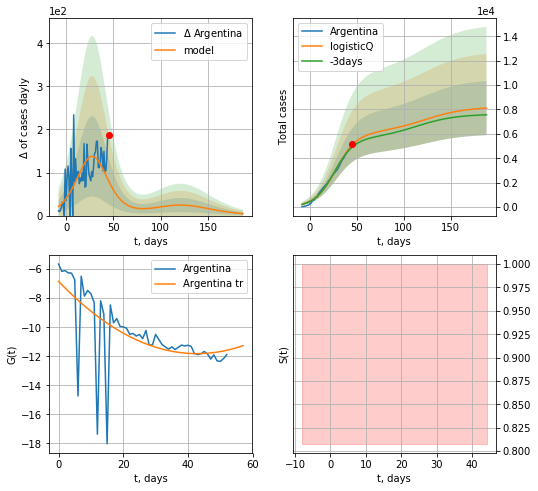

Argentina data at: 2020-05-06
+3 day model MAPE: 0.034599
model: logisticQ
coeffs: [ 6.06720337e+03  1.66825482e-06  2.79100684e+01 -5.38194270e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.273232
forecast at the end of period: +143 days
	 deltaDaycases: 4
	 total cases: 8113 ± 2216
	 total death: 425 ± 348
trend coefficient of determination: 0.370488
 intercept_: -6.83763110695755
 coeffs_: [ 0.         -0.23269503  0.00271959]


In [351]:
x = forecastRRR('Argentina',dfAG[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


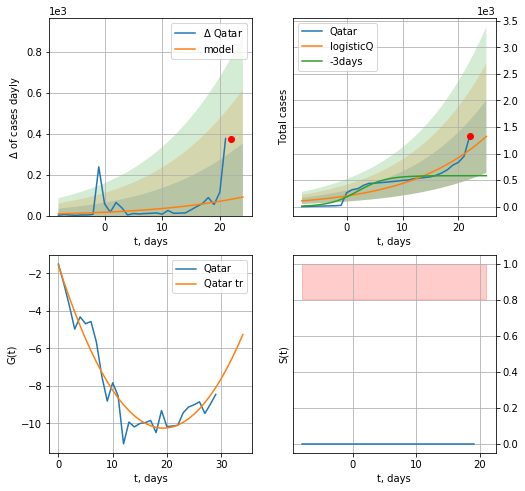

Qatar data at: 2020-05-06
+3 day model MAPE: 0.969413
model: logisticQ
coeffs: [ 1.17152185e+04  1.38701641e-05  5.07935568e+01 -5.73629534e+03]
rational stdev: 0.519403
forecast at the end of period: +3 days
	 deltaDaycases: 90
	 total cases: 1322 ± 687
	 total death: 0 ± 0
trend coefficient of determination: 0.927713
 intercept_: -1.5731660703847918
 coeffs_: [ 0.         -0.89771885  0.02321841]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


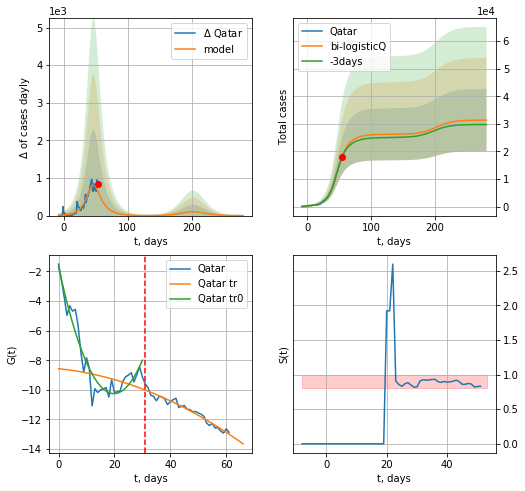

Qatar data at: 2020-05-06
+3 day model MAPE: 0.015360
model: bi-logisticQ
coeffs: [ 1.45142693e+04  4.42414608e-05  4.64647587e+01 -3.57200542e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359399
forecast at the end of period: +227 days
	 deltaDaycases: 0
	 total cases: 31360 ± 11270
	 total death: 20 ± 21
bi-logisticQ approximation splitting point: 31
trend coefficient of determination: 0.919409
 intercept_: -1.6852707465713292
 coeffs_: [ 0.         -0.86529683  0.02183056]
trend coefficient of determination: 0.953577
 intercept_: -8.572258833997205
 coeffs_: [ 0.         -0.01962807 -0.00086816]


In [352]:
vL=31
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,6*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


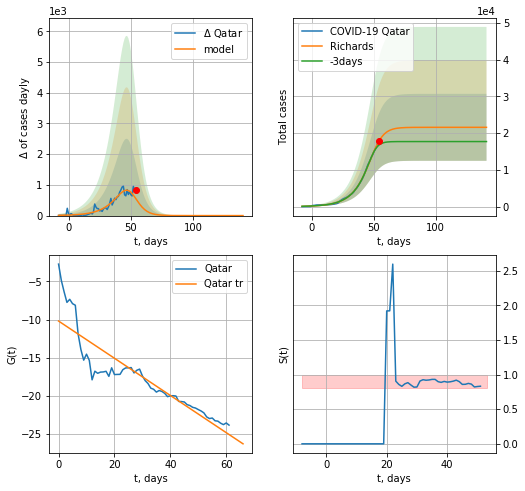

Qatar data at: 2020-05-06
+3 day model MAPE: 0.078022
model: Richards
coeffs: [2.15650681e+04 9.65101905e-02 5.07585900e+01 2.11958757e+00]
rational stdev: 0.422178
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 21565 ± 9104
	 total death: 14 ± 17
trend coefficient of determination: 0.809212
 intercept: -10.196520
 slope: -0.243839


In [353]:
x = forecastRR('Qatar',dfQR[:].fillna(0),d1,18*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])

In [354]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
          date    cases  active  death
77 2020-05-02  13599.0   10816  119.0
78 2020-05-03  14163.0   11274  126.0
79 2020-05-04  14730.0   11627  137.0
80 2020-05-05  15192.0   11893  146.0
81 2020-05-06  15738.0   12222  157.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


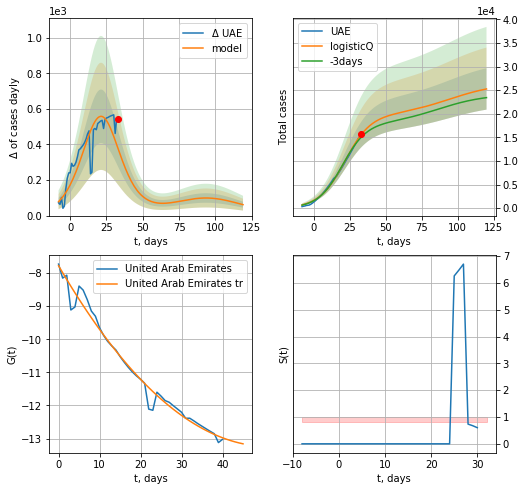

UAE data at: 2020-05-06
+3 day model MAPE: 0.040551
model: logisticQ
coeffs: [ 1.96255916e+04  3.05465619e-06  2.16505359e+01 -3.68490185e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.173436
forecast at the end of period: +87 days
	 deltaDaycases: 61
	 total cases: 25257 ± 4380
	 total death: 251 ± 130
trend coefficient of determination: 0.978135
 intercept_: -7.779161500437466
 coeffs_: [ 0.         -0.21304993  0.00207767]


In [355]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


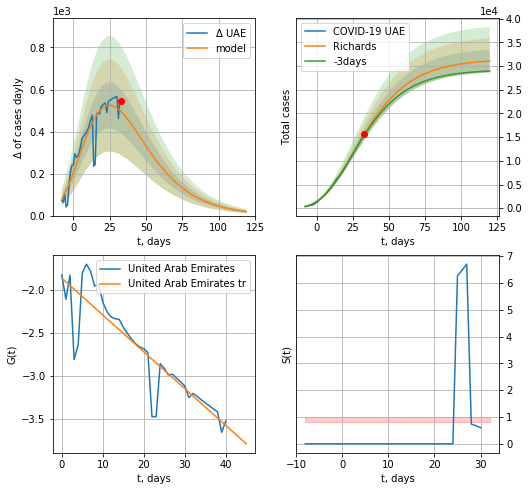

UAE data at: 2020-05-06
+3 day model MAPE: 0.014685
model: Richards
coeffs: [ 3.14777075e+04  2.76452905e+00 -6.44126899e+01  1.65304786e-02]
rational stdev: 0.077385
forecast at the end of period: +87 days
	 deltaDaycases: 19
	 total cases: 31063 ± 2403
	 total death: 309 ± 71
trend coefficient of determination: 0.801813
 intercept: -1.861960
 slope: -0.042756


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


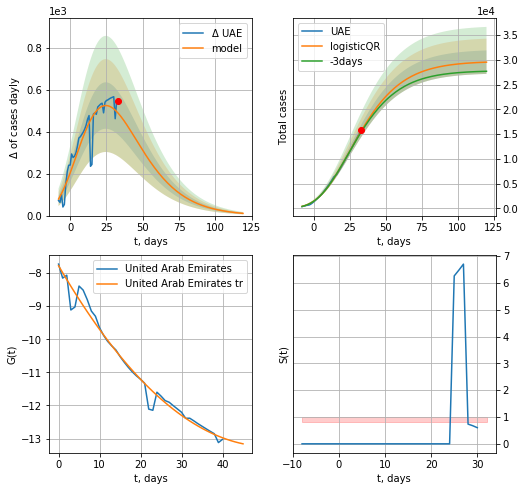

UAE data at: 2020-05-06
+3 day model MAPE: 0.01538864306009502
model: logisticQR
coeffs:  [ 2.96945643e+04  8.60071322e-03 -9.79077916e+01 -7.28235032e+02
  6.40460672e-03]
rational stdev:  0.08042053741615039
forecast at the end of period: +87 days
	 deltaDaycases:  10
	 total cases:  29519 ± 2373
	 total death:  294 ± 70
trend coefficient of determination: 0.978135
 intercept_: -7.779161500437466
 coeffs_: [ 0.         -0.21304993  0.00207767]


In [356]:
x = forecastRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [357]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
60 2020-05-02  25459.0   21518  176.0
61 2020-05-03  27011.0   22693  184.0
62 2020-05-04  28656.0   23989  191.0
63 2020-05-05  30251.0   24620  200.0
64 2020-05-06  31938.0   24946  209.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


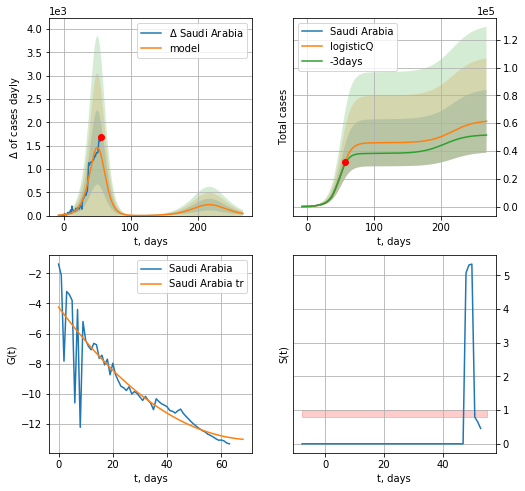

Saudi Arabia data at: 2020-05-06
+3 day model MAPE: 0.053633
model: logisticQ
coeffs: [ 4.58996369e+04  3.25616115e-04  4.99882012e+01 -3.41315416e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.368612
forecast at the end of period: +213 days
	 deltaDaycases: 45
	 total cases: 61366 ± 22620
	 total death: 401 ± 443
trend coefficient of determination: 0.804511
 intercept_: -4.23685319001318
 coeffs_: [ 0.         -0.24290744  0.00167428]


In [358]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


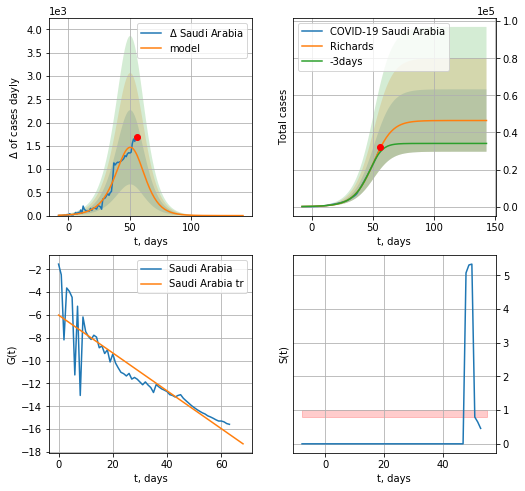

Saudi Arabia data at: 2020-05-06
+3 day model MAPE: 0.083999
model: Richards
coeffs: [4.64263056e+04 1.10791401e-01 5.22849269e+01 1.21911086e+00]
rational stdev: 0.362456
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 46426 ± 16827
	 total death: 303 ± 329
trend coefficient of determination: 0.818291
 intercept: -6.008762
 slope: -0.165968


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


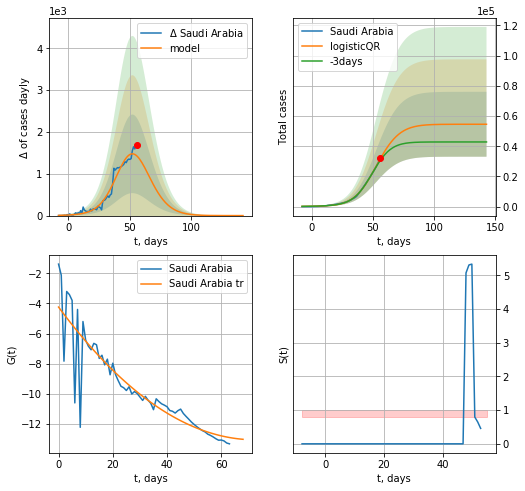

Saudi Arabia data at: 2020-05-06
+3 day model MAPE: 0.0427660262862242
model: logisticQR
coeffs:  [ 5.45537575e+04  2.36919080e-03  3.04492336e+01 -6.16962070e+01
  2.62676847e-01]
rational stdev:  0.39403292928219574
forecast at the end of period: +87 days
	 deltaDaycases:  0
	 total cases:  54553 ± 21495
	 total death:  356 ± 420
trend coefficient of determination: 0.804511
 intercept_: -4.23685319001318
 coeffs_: [ 0.         -0.24290744  0.00167428]


In [359]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date  cases  active  death
49 2020-04-28  619.0       0      0
50 2020-04-29  649.0       0      0
51 2020-04-30  663.0       0      0
52 2020-05-01  690.0       0      0
53 2020-05-02  702.0       0      0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


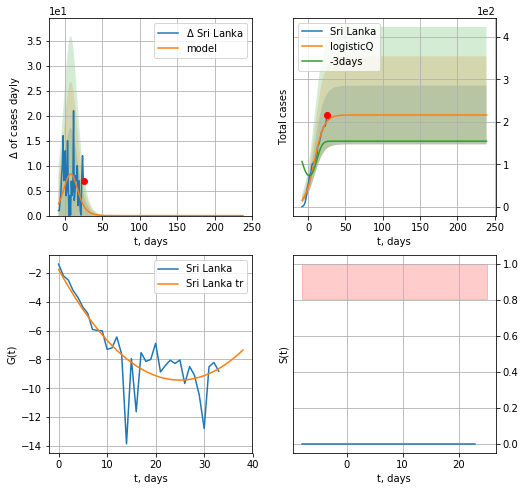

Sri Lanka data at: 2020-05-06
+3 day model MAPE: 0.324795
model: logisticQ
coeffs: [ 2.16378650e+02  6.51099157e-05  8.63891239e+00 -2.35705824e+03]
rational stdev: 0.318765
forecast at the end of period: +213 days
	 deltaDaycases: 0
	 total cases: 216 ± 68
	 total death: 2 ± 1
trend coefficient of determination: 0.700492
 intercept_: -1.7495743977322356
 coeffs_: [ 0.         -0.61543768  0.0123203 ]


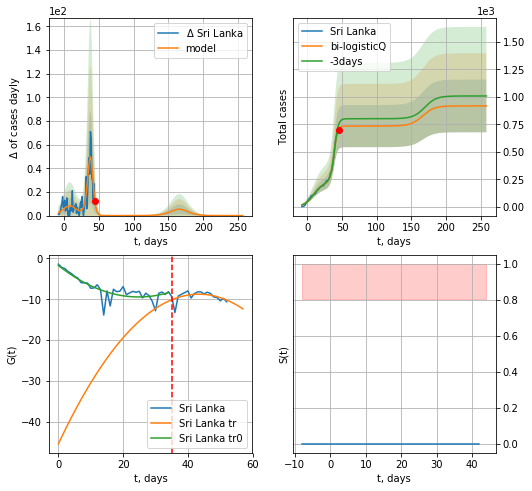

Sri Lanka data at: 2020-05-06
+3 day model MAPE: 0.062838
model: bi-logisticQ
coeffs: [ 5.18033887e+02  4.95277952e-03  3.80543331e+01 -3.87676409e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261390
forecast at the end of period: +213 days
	 deltaDaycases: 0
	 total cases: 917 ± 239
	 total death: 10 ± 7
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.700900
 intercept_: -1.7291427146735243
 coeffs_: [ 0.         -0.62059696  0.01251448]
trend coefficient of determination: 0.356970
 intercept_: -45.35102800084556
 coeffs_: [ 0.          1.68688112 -0.01943157]


In [360]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 35
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,36*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

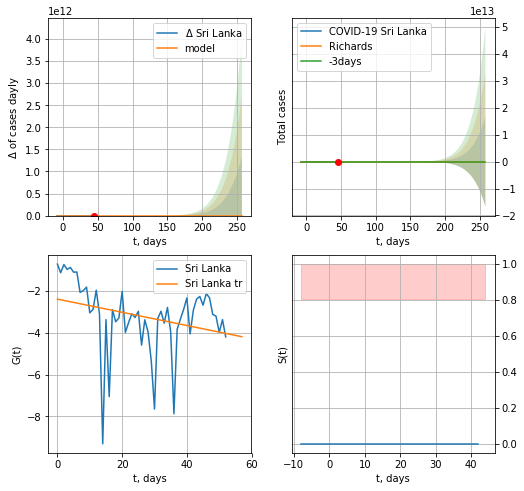

Sri Lanka data at: 2020-05-06
+3 day model MAPE: 1.000000
model: Richards
coeffs: [4.46105073e+02 3.48947501e-01 1.30751802e-01 1.91221241e-02]
rational stdev: 205193802976327.718750
forecast at the end of period: +213 days
	 deltaDaycases: 0
	 total cases: 0 ± 16701926115845
	 total death: 0 ± 0
trend coefficient of determination: 0.080211
 intercept: -2.384018
 slope: -0.031605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


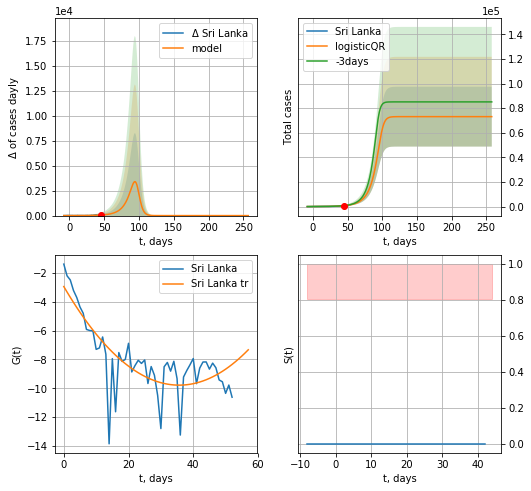

Sri Lanka data at: 2020-05-06
+3 day model MAPE: 0.05518169076740634
model: logisticQR
coeffs:  [ 7.31338913e+04  3.14273708e-04  9.79417920e+01 -2.30767672e+02
  2.83954838e+00]
rational stdev:  0.33242925378994026
forecast at the end of period: +213 days
	 deltaDaycases:  0
	 total cases:  73133 ± 24311
	 total death:  825 ± 822
trend coefficient of determination: 0.612466
 intercept_: -2.9436925942027994
 coeffs_: [ 0.         -0.38378893  0.00538271]


In [361]:
x = forecastRR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
          date    cases  active  death
64 2020-05-01  18092.0   11207  417.0
65 2020-05-02  19022.0   11813  437.0
66 2020-05-03  20084.0   12443  457.0
67 2020-05-04  20941.0   13047  476.0
68 2020-05-05  22049.0   13714  514.0


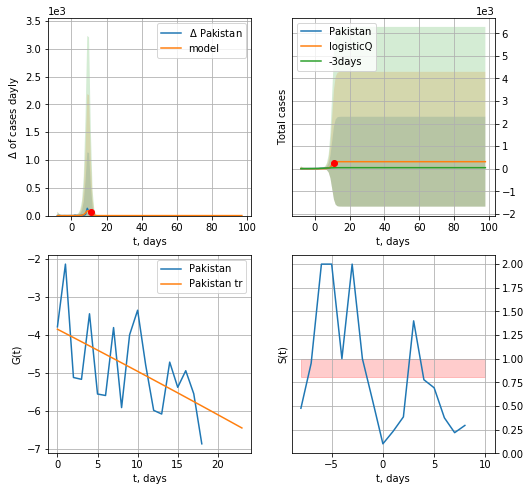

Pakistan data at: 2020-05-06
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 7 ± 134
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


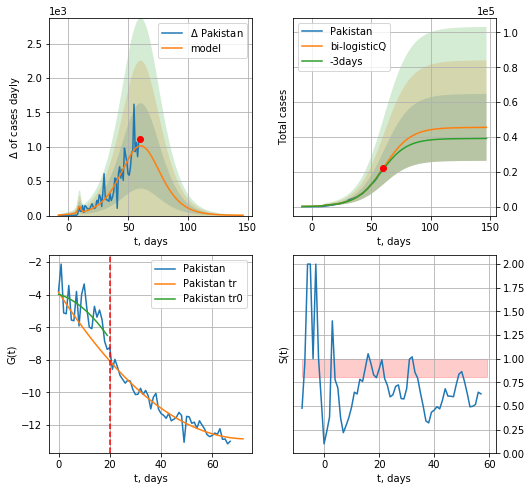

Pakistan data at: 2020-05-06
+3 day model MAPE: 0.033918
model: bi-logisticQ
coeffs: [ 4.51325915e+04  5.22299699e-06  6.10158487e+01 -1.71298715e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422516
forecast at the end of period: +87 days
	 deltaDaycases: 5
	 total cases: 45498 ± 19223
	 total death: 1065 ± 1349
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.936260
 intercept_: -3.856647542116999
 coeffs_: [ 0.         -0.24367244  0.00165147]


In [362]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


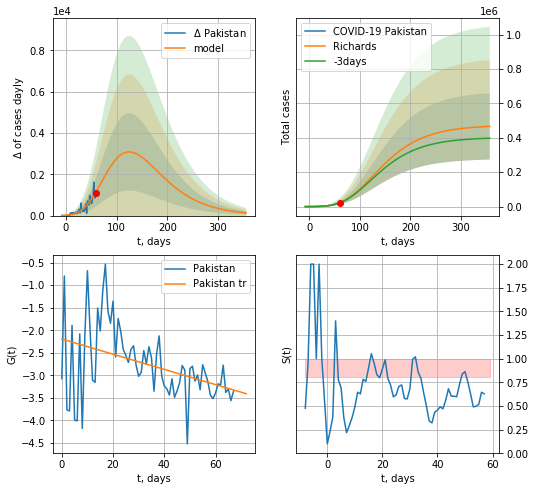

Pakistan data at: 2020-05-06
+3 day model MAPE: 0.010298
model: Richards
coeffs: [ 4.73826893e+05  4.89052373e-01 -5.79454179e+01  3.68149466e-02]
rational stdev: 0.413337
forecast at the end of period: +297 days
	 deltaDaycases: 131
	 total cases: 466556 ± 192845
	 total death: 10930 ± 13553
trend coefficient of determination: 0.166507
 intercept: -2.193701
 slope: -0.016865


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


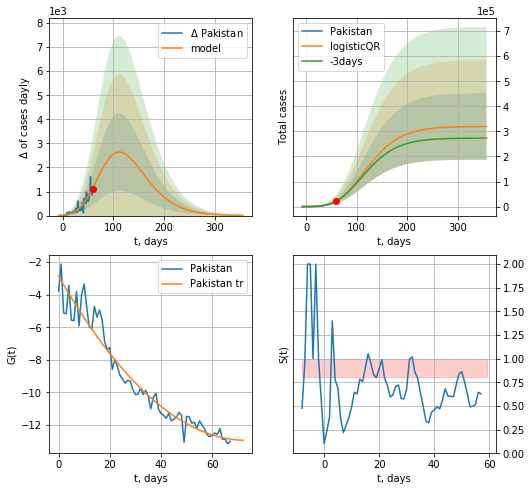

Pakistan data at: 2020-05-06
+3 day model MAPE: 0.009863654797638451
model: logisticQR
coeffs:  [ 3.19689653e+05  2.08656275e-03 -2.01471109e+02 -4.07580892e+02
  1.30756770e-02]
rational stdev:  0.41470182955252466
forecast at the end of period: +297 days
	 deltaDaycases:  7
	 total cases:  319476 ± 132487
	 total death:  7484 ± 9310
trend coefficient of determination: 0.943285
 intercept_: -2.866456132174452
 coeffs_: [ 0.         -0.27440734  0.00187034]


In [363]:
x = forecastRR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [378]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [5]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

/usr/local/lib/python3.5/dist-packages/requests/__init__.py:83: RequestsDependencyWarning: Old version of cryptography ([1, 2, 3]) may cause slowdown.
  warnings.warn(warning, RequestsDependencyWarning)


[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]


In [6]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"1,030,875",North America,\nNorth America\n,,"+2,201",221,"17,016",,"1,378,102","82,648","264,579",,
1,"782,006",Europe,\nEurope\n,,,,"15,843",,"1,524,904","146,631","596,267",,
2,"255,711",Asia,\nAsia\n,,930,21,"5,229",,"603,995","20,827","327,457",,
3,"150,511",South America,\nSouth America\n,,84,5,"9,958",,"251,695","12,830","88,354",,
4,"32,412",Africa,\nAfrica\n,,,,128,,"52,713","2,015","18,286",,
5,902,Australia/Oceania,\nOceania\n,,20,,30,,"8,487",118,"7,467",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,252,478",All,World,34.0,"+3,235",247,"48,208",,"3,820,617","265,084","1,303,055",,490
8,"975,292",North America,USA,226,91,8,"15,827","24,186","1,263,183","74,807","213,084","8,005,589","3,816"
9,"68,466",Europe,Spain,553,,,"2,075","41,332","253,682","25,857","159,359","1,932,455","5,426"


In [7]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,030,875",North America,\nNorth America\n,,"+2,201",221,"17,016",,"1,378,102","82,648","264,579",,
1,"782,006",Europe,\nEurope\n,,,,"15,843",,"1,524,904","146,631","596,267",,
2,"255,711",Asia,\nAsia\n,,930,21,"5,229",,"603,995","20,827","327,457",,
3,"150,511",South America,\nSouth America\n,,84,5,"9,958",,"251,695","12,830","88,354",,
4,"32,412",Africa,\nAfrica\n,,,,128,,"52,713","2,015","18,286",,


In [8]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
93,662,Europe,Lithuania,18,,,17,"57,486","1,428",48,718,"156,493",525
324,662,Europe,Lithuania,18,5,2,17,"57,486","1,428",48,718,"156,493",525


In [9]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

230


In [10]:
df.head(24)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,030,875",North America,\nNorth America\n,,"+2,201",221,"17,016",,"1,378,102","82,648","264,579",,
1,"782,006",Europe,\nEurope\n,,,,"15,843",,"1,524,904","146,631","596,267",,
2,"255,711",Asia,\nAsia\n,,930,21,"5,229",,"603,995","20,827","327,457",,
3,"150,511",South America,\nSouth America\n,,84,5,"9,958",,"251,695","12,830","88,354",,
4,"32,412",Africa,\nAfrica\n,,,,128,,"52,713","2,015","18,286",,
5,902,Australia/Oceania,\nOceania\n,,20,,30,,"8,487",118,"7,467",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,252,478",All,World,34.0,"+3,235",247,"48,208",,"3,820,617","265,084","1,303,055",,490
8,"975,292",North America,USA,226,91,8,"15,827","24,186","1,263,183","74,807","213,084","8,005,589","3,816"
9,"68,466",Europe,Spain,553,,,"2,075","41,332","253,682","25,857","159,359","1,932,455","5,426"


In [11]:
df.at[11, 'TotalRecovered'] = 0
df.at[22, 'TotalRecovered'] = 0
#df.at[12, 'TotalRecovered'] = 0


In [12]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1030875,North America,\nNorth America\n,NaN,2201.0,221.0,17016.0,NaN,1378102,82648.0,264579.0,NaN,NaN
1,782006,Europe,\nEurope\n,NaN,NaN,NaN,15843.0,NaN,1524904,146631.0,596267.0,NaN,NaN
2,255711,Asia,\nAsia\n,NaN,930.0,21.0,5229.0,NaN,603995,20827.0,327457.0,NaN,NaN
3,150511,South America,\nSouth America\n,NaN,84.0,5.0,9958.0,NaN,251695,12830.0,88354.0,NaN,NaN
4,32412,Africa,\nAfrica\n,NaN,NaN,NaN,128.0,NaN,52713,2015.0,18286.0,NaN,NaN
5,902,Australia/Oceania,\nOceania\n,NaN,20.0,NaN,30.0,NaN,8487,118.0,7467.0,NaN,NaN
6,61,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
7,2252478,All,World,34.0,3235.0,247.0,48208.0,NaN,3820617,265084.0,1303055.0,NaN,490.0
8,975292,North America,USA,226.0,91.0,8.0,15827.0,24186.0,1263183,74807.0,213084.0,8005589.0,3816.0
9,68466,Europe,Spain,553.0,NaN,NaN,2075.0,41332.0,253682,25857.0,159359.0,1932455.0,5426.0


In [13]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,150511,South America,Total:,NaN,84.0,5.0,9958.0,NaN,251695,12830.0,88354.0,NaN,NaN
226,32412,Africa,Total:,NaN,NaN,NaN,128.0,NaN,52713,2015.0,18286.0,NaN,NaN
227,902,Australia/Oceania,Total:,NaN,20.0,NaN,30.0,NaN,8487,118.0,7467.0,NaN,NaN
228,61,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
229,420214,Europe,European Union,251.204651,0.0,0.0,11232.0,27170.445894,1064763,111849.0,532450.0,12097655.0,2391.379609


In [14]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1030875,North America,North America,NaN,2201.0,221.0,17016.0,NaN,1378102,82648.0,264579.0,NaN,NaN
1,782006,Europe,Europe,NaN,NaN,NaN,15843.0,NaN,1524904,146631.0,596267.0,NaN,NaN
2,255711,Asia,Asia,NaN,930.0,21.0,5229.0,NaN,603995,20827.0,327457.0,NaN,NaN
3,150511,South America,South America,NaN,84.0,5.0,9958.0,NaN,251695,12830.0,88354.0,NaN,NaN
4,32412,Africa,Africa,NaN,NaN,NaN,128.0,NaN,52713,2015.0,18286.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [15]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1030875,North America,North America,NaN,2201.0,221.0,17016.0,NaN,1378102,82648.0,264579.0,NaN,NaN
1,782006,Europe,Europe,NaN,NaN,NaN,15843.0,NaN,1524904,146631.0,596267.0,NaN,NaN
2,255711,Asia,Asia,NaN,930.0,21.0,5229.0,NaN,603995,20827.0,327457.0,NaN,NaN
3,150511,South America,South America,NaN,84.0,5.0,9958.0,NaN,251695,12830.0,88354.0,NaN,NaN
4,32412,Africa,Africa,NaN,NaN,NaN,128.0,NaN,52713,2015.0,18286.0,NaN,NaN
5,902,Australia/Oceania,Oceania,NaN,20.0,NaN,30.0,NaN,8487,118.0,7467.0,NaN,NaN
7,2252478,All,World,34.0,3235.0,247.0,48208.0,NaN,3820617,265084.0,1303055.0,NaN,490.0
8,975292,North America,USA,226.0,91.0,8.0,15827.0,24186.0,1263183,74807.0,213084.0,8005589.0,3816.0
9,68466,Europe,Spain,553.0,NaN,NaN,2075.0,41332.0,253682,25857.0,159359.0,1932455.0,5426.0
10,91528,Europe,Italy,491.0,NaN,NaN,1333.0,38221.0,214457,29684.0,93245.0,2310929.0,3547.0


In [16]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [17]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Canada CA
Hungary HG
Japan JP
Saudi Arabia SA
UAE UAE
Pakistan PK
Austria AT
Russia RS
Morocco MR
Serbia SB
Panama PM
Bulgaria BL
Egypt EG
Singapore SG
Qatar QR
Colombia CB
Greece GC
Belgium BG
USA US
Slovenia SV
Argentina AG
Philippines PH
Chile CL
Latvia LV
Finland FI
Iraq IQ
Malta MT
World World
Romania RM
Mexico MX
Switzerland SZ
Indonesia IE
Denmark DK
Australia AS
Turkey TR
Algeria AR
Brazil BZ
Iceland IC
Ukraine Ukr
China CN
Portugal PT
France FR
Estonia ES
New Zealand ZL
Croatia CT
Germany GR
Luxembourg LX
Israel IS
Poland PL
Peru PU
Spain SP
UK GB
Ecuador ED
Malaysia ML
Slovakia SL
Lithuania LT
Ireland IR
Thailand TH
Czechia CH
Iran IN
Italy IT
India ID
Norway NG
S. Korea KR
Belarus BR
European Union EU
Cyprus CP
Sweden SW
Netherlands NL


In [18]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-06,1378102,1030875,82648.0
Europe
Europe 2020-05-06,1524904,782006,146631.0
Asia
Asia 2020-05-06,603995,255711,20827.0
South America
South America 2020-05-06,251695,150511,12830.0
Africa
Africa 2020-05-06,52713,32412,2015.0
Oceania
Oceania 2020-05-06,8487,902,118.0
World
World 2020-05-06,3820617,2252478,265084.0
USA
USA 2020-05-06,1263183,975292,74807.0
Spain
Spain 2020-05-06,253682,68466,25857.0
Italy
Italy 2020-05-06,214457,91528,29684.0
UK
UK 2020-05-06,201101,170681,30076.0
France
France 2020-05-06,174191,94410,25809.0
Germany
Germany 2020-05-06,168162,20987,7275.0
Russia
Russia 2020-05-06,165929,143065,1537.0
Turkey
Turkey 2020-05-06,131744,49958,3584.0
Brazil
Brazil 2020-05-06,126611,66653,8588.0
Iran
Iran 2020-05-06,101650,13645,6418.0
Canada
Canada 2020-05-06,63496,31093,4232.0
Peru
Peru 2020-05-06,54817,35757,1533.0
India
India 2020-05-06,53025,35909,1785.0
Belgium
Belgium 2020-05-06,50781,29711,8339.0
Netherlands
Netherlands 2020-05-06,4131

MS Zaandam
MS Zaandam 2020-05-06,9,7,2.0
Comoros
Comoros 2020-05-06,8,7,1.0
Mauritania
Mauritania 2020-05-06,8,1,1.0
Papua New Guinea
Papua New Guinea 2020-05-06,8,0,nan
British Virgin Islands
British Virgin Islands 2020-05-06,7,3,1.0
Bhutan
Bhutan 2020-05-06,7,2,nan
Caribbean Netherlands
Caribbean Netherlands 2020-05-06,6,6,nan
St. Barth
St. Barth 2020-05-06,6,0,nan
Western Sahara
Western Sahara 2020-05-06,6,1,nan
Anguilla
Anguilla 2020-05-06,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-06,1,1,nan
China
China 2020-05-06,82885,295,4633.0
Total:
Total: 2020-05-06,1378102,1030875,82648.0
Total:
Total: 2020-05-06,1378102,1030875,82648.0
Total:
Total: 2020-05-06,1378102,1030875,82648.0
Total:
Total: 2020-05-06,1378102,1030875,82648.0
Total:
Total: 2020-05-06,1378102,1030875,82648.0
Total:
Total: 2020-05-06,1378102,1030875,82648.0
Total:
Total: 2020-05-06,1378102,1030875,82648.0
European Union
European Union 2020-05-06,1064763,420214,111849.0


In [19]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [20]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaCA.csv 2020-05-06,63496,31093,4232.0

append data/coronaHG.csv 2020-05-06,3111,1979,373.0

append data/coronaJP.csv 2020-05-06,15253,10201,556.0

append data/coronaSA.csv 2020-05-06,31938,24946,209.0

append data/coronaUAE.csv 2020-05-06,15738,12222,157.0

append data/coronaPK.csv 2020-05-06,24073,17045,564.0

append data/coronaAT.csv 2020-05-06,15684,1437,608.0

append data/coronaRS.csv 2020-05-06,165929,143065,1537.0

append data/coronaMR.csv 2020-05-06,5408,3208,183.0

append data/coronaSB.csv 2020-05-06,9791,7617,203.0

append data/coronaPM.csv 2020-05-06,7731,6654,218.0

append data/coronaBL.csv 2020-05-06,1778,1334,84.0

append data/coronaEG.csv 2020-05-06,7588,5304,469.0

append data/coronaSG.csv 2020-05-06,20198,18544,20.0

append data/coronaQR.csv 2020-05-06,17972,15890,12.0

append data/coronaCB.csv 2020-05-06,8959,6414,397.0

append data/coronaGC.csv 2020-05-06,2663,1142,147.0

append data/coronaBG.csv 2020-05-06,50781,29711,8339.0

append data/coronaUS.csv

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [364]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

39345941.0 5058.879474387986


In [365]:
TT/7.7776e3

5058.879474387986

In [366]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [371]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

26309.595680781178

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [381]:
#dfAll

In [372]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

5522.903104821114

In [132]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta"
]

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

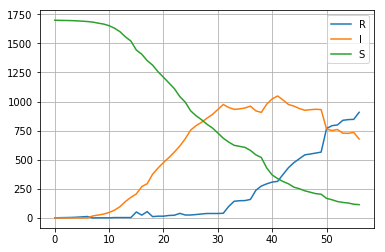

In [798]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

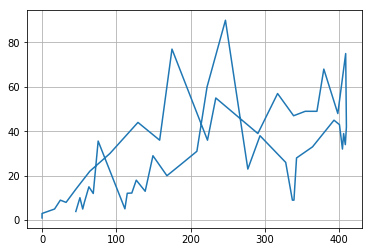

In [799]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

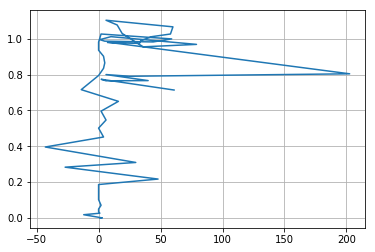

In [800]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

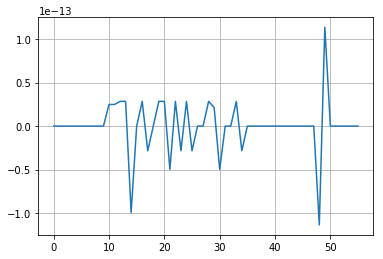

In [801]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [978]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [1044]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

[ 42.58270028 912.65637216]


In [1045]:
55*19

1045

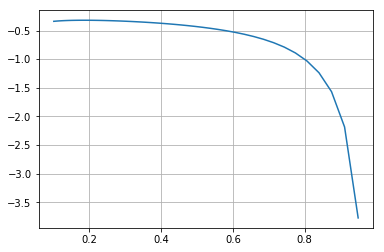

In [1046]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

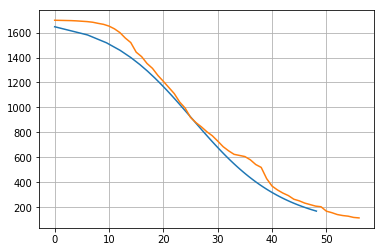

In [1059]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

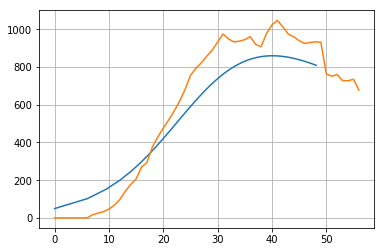

In [1058]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

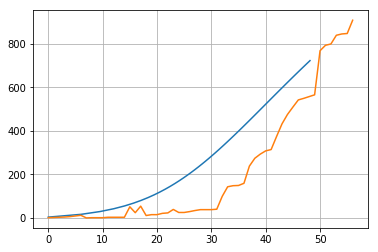

In [1060]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [992]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [824]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [995]:
gamma/(beta*x0)*55*4

45.5529411764706

In [1006]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

array([0.12589254, 0.16378937, 0.2130941 , 0.2772408 , 0.36069727,
       0.46927625, 0.61054023, 0.79432823])

In [1005]:
10**0.1

1.2589254117941673

In [1058]:
np.multiply(I,S)[1:].shape

(54,)

In [1056]:
np.diff(S).shape

(54,)

In [1063]:
50./400

0.125